# Experiments on Complete Dataset

## Prep
### Load Packages and Data 

In [7]:
# regular package 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re 
import os
import string

%matplotlib inline

import nltk 
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer, PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
lemmatizer = WordNetLemmatizer()
nltk.download('stopwords')


# sklearn
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import classification_report
from sklearn.linear_model import SGDClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from xgboost import XGBClassifier

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/Doylism/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
# read data
data = pd.read_csv('../../clean_data/token_voc.csv', index_col=0)

/anaconda3/lib/python3.7/site-packages/numpy/lib/arraysetops.py:568: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [3]:
data.head()

,MBTI,comments_lemma
0,INFP,lol leave
1,INTP,post try tell people time always joke unless s...
2,INFP,first thought pepsi something probably alcohol
3,ENTP,formula something like every time say add bpm ...
4,INTP,imply five


### Drop Null Values

In [4]:
# remember to drop na
data = data.dropna()

In [5]:
data.isna().sum()

MBTI              0
comments_lemma    0
dtype: int64

### Split dataset to 2 files 

In [10]:
# Split train and set dataframes and save as separate files 
train_data, test_data = train_test_split(data, test_size=0.1, random_state=42, stratify=data.MBTI)

In [11]:
# Look at the shape of the separate datasets
print(train_data.shape)
print(test_data.shape)

(2665071, 2)
(296119, 2)


In [12]:
train_data.to_csv('train_data.csv')
test_data.to_csv('test_data.csv')

In [14]:
# From this moment on, we will only deal with train dataset, and will not touch test data until it's time 
# to evaluate the performance of the models, so we set train data as df 
df = train_data

In [15]:
df.head(10)

,MBTI,comments_lemma
1166243,ENTP,like boss get shitbag estj even bad esfj real ...
1521404,ISTJ,netflix use downloaded version chromecast chro...
261951,ENTJ,dude sit next bus lot double seat leave edit w...
758217,INFJ,connect parent trans folk important
945670,ENFJ,c users yourname appdata local packages micros...
556009,ENTP,cheese melty bite hard messy
958092,INFP,lebron close elite skip bayless
17866,ESTP,one rectify something
3928,ISFP,see issue base trailer border good seem hard f...
1500654,INFP,joke tall woman welcome club


## Balancing the Data 

In [24]:
# overview of data distribution 
df['MBTI'].value_counts()

INFP    276739
INTP    266706
INFJ    242212
ENTJ    228588
ISTP    201421
ENTP    199207
ENFP    183483
ENFJ    161366
INTJ    157322
ESTP    142569
ISFJ    140225
ISTJ    138619
ISFP    126794
ESTJ     86058
ESFP     59558
ESFJ     54204
Name: MBTI, dtype: int64

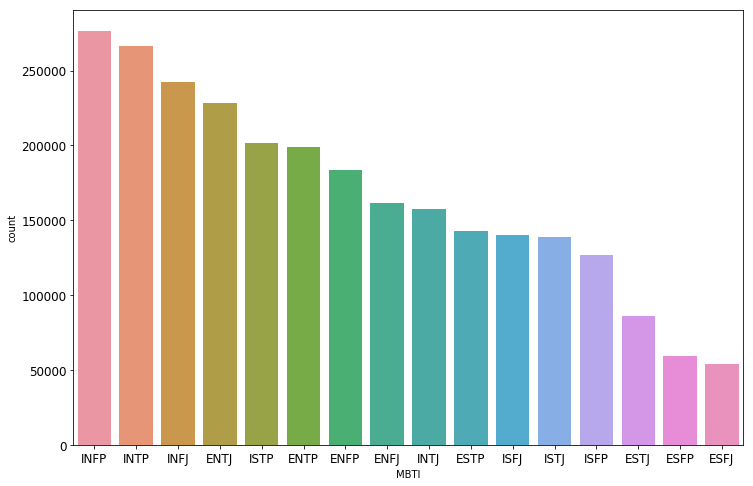

In [23]:
# plot out the distribution of data 
plt.figure(figsize=(12,8))
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12, rotation=0)
sns.countplot(data=df, x=df['MBTI'],order=df['MBTI'].value_counts().index)
plt.show()

From the above graph we can see that the classes are highly imbalanced and they are causing a big problem to the classification models. Although the distribution reflects the personalities' distribution among the population, for this project's sake, I will have to introduce some bias - manually balancing the data. I will undersample the majorities to the same level as the minority class.

A much reduced dataset will also help with the computation time.

In [25]:
# use imblearn's randomundersampler 
from imblearn.under_sampling import RandomUnderSampler

rus = RandomUnderSampler()

X = df['comments_lemma']
y = df['MBTI']

X_resampled, y_resampled = rus.fit_resample(X,y)


ValueError: Expected 2D array, got 1D array instead:
array=['like boss get shitbag estj even bad esfj real world dad esfj never get along rebel kid authority follower try skip school force go absolutely hate super religious atheist keep try force back religion ugh'
 'netflix use downloaded version chromecast chromecast work basically browser phone tell webpage go case netflix basically web player whatever video watch'
 'dude sit next bus lot double seat leave edit wow trigger know seating strategy public transport vital part identity right'
 ...
 'get usual haircut yesterday top fade neckline sideburn square line front sadly forget regular barber close tuesdays go different place nearby first time'
 'understand algeria concern perhaps would support egypt mere observer could help cool relation two nation'
 'l automobile est non sens conomique absolument non soutenable alors pourquoi en une tente dan doute gt la prolif ration l auto provoque l talement urbain donc saffection transport commun pense occasionn e par bagnole pousse les salaire hausse avec des effets vastateurs pour comp titivit internationale okay allons gt la prolif ration l auto mot prolif ration applique que pour biologie suis pas contre tournement cr atif des mots nom une taphore mais c est pas tellement que fais les gen ach tent des autos volontairement leur prend pas comme une grippe peste taphore fonctionne pas l talement urbain donc saffection transport commun saisis pas rapport entre ce deux l talement urbain est une politique nagement territoire tant que tel obsol te dan repr sentation saffection transport urbain voque rien con ois pas que l noue r seau pour aucune raison que soit passe peut tre cot propos gt la pense occasionn e par bagnole pousse les salaire hausse avec des effets vastateurs pour comp titivit internationale c est non sen personne paiera plus parce que plus pense sais comment marche planification budg taire moin beurre raie comp titivit pour tas excellentes raisons id ologique raison que ressen pas besoin tailler donnes l impression pas savoir quoi parle gt des pense publique sur quelque cennie amortit planifie bien sans compter que con ois planification sur mod le conomique alternatif co des externalit que vous passez sous silence bien r parce que co est nul n gligeable pas sous traitance les importations mat riaux minimum suis protectionniste dessus l un des points principaux planification sera r duire les distances transport maximum quitte devoir rajouter mat riel parce qu une qualit plus lev e est indisponible peut faire des tonnes conomies sur tout tas domaines projet cette fa'].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [8]:
##### Encode each type to an int

from sklearn.preprocessing import LabelEncoder

unique_type_list = ['INFJ', 'ENTP', 'INTP', 'INTJ', 'ENTJ', 'ENFJ', 'INFP', 'ENFP',
       'ISFP', 'ISTP', 'ISFJ', 'ISTJ', 'ESTP', 'ESFP', 'ESTJ', 'ESFJ']
lab_encoder = LabelEncoder().fit(unique_type_list)

/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


In [306]:
# convert columns to list 

list_personality = data_test['MBTI'].tolist()
list_posts = data_test['comments_lemma'].apply(lambda x: ' '.join(x))

In [307]:
# Vectorize with count and tf-idf
# keep the words appearing in 10 to 50% of the posts.

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

#cntizer = CountVectorizer(analyzer="word", tokenizer=None, preprocessor=None, stop_words=None, ngram_range=(1,1), max_df=0.5, min_df=0.1) 

tfidfizer = TfidfVectorizer(tokenizer=None,    
                             preprocessor=None, 
                             stop_words=None,  
#                             ngram_range=(1,1),
                             max_df=0.9,
                             min_df=1000) 

#X_cnt = cntizer.fit_transform(list_posts).toarray()                                 
X_tfidf = tfidfizer.fit_transform(list_posts).toarray()

In [46]:
tfidfizer.vocabulary_

{'lol': 2527,
 'that': 4327,
 'be': 383,
 'why': 4756,
 'leave': 2452,
 'just': 2368,
 'about': 4,
 'to': 4396,
 'post': 3244,
 'try': 4483,
 'tell': 4292,
 'people': 3106,
 'all': 128,
 'the': 4328,
 'time': 4383,
 'always': 149,
 'joke': 2346,
 'unless': 4552,
 'say': 3732,
 'serious': 3808,
 'right': 3639,
 'now': 2912,
 'and': 175,
 'still': 4113,
 'do': 1262,
 'not': 2904,
 'catch': 650,
 'on': 2966,
 'but': 588,
 'here': 1997,
 'have': 1969,
 'already': 139,
 'figure': 1653,
 'out': 3014,
 'secret': 3773,
 'like': 2492,
 'know': 2398,
 'first': 1669,
 'thought': 4357,
 'or': 2994,
 'something': 3994,
 'probably': 3318,
 'alcohol': 119,
 'if': 2101,
 'formula': 1726,
 'every': 1496,
 'add': 56,
 'then': 4333,
 'would': 4813,
 'this': 4351,
 'imply': 2133,
 'five': 1675,
 'well': 4726,
 'think': 4347,
 'there': 4339,
 'lot': 2544,
 'of': 2951,
 'potential': 3248,
 'technology': 4286,
 'develop': 1168,
 'in': 2148,
 'image': 2115,
 'awareness': 329,
 'can': 612,
 'camera': 608,
 'de

## LDA

In [40]:
import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# spacy for lemmatization
import spacy

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

## Gensim

### 1. Create a Dictionary 

In [27]:
# Separate a df ESFJ & INTP for LDA topic modelling
df_esfj = df[df['MBTI']=='ESFJ']

In [28]:
df_esfj.shape

(54204, 2)

In [29]:
df_esfj.head(20)

,MBTI,comments_lemma
56111,ESFJ,enjoy ridiculous article affordable watch one ...
192676,ESFJ,yup exactly story grow mom would cook one mayb...
12276,ESFJ,unfortunately
1338,ESFJ,wow time change back release match ghz believe...
60520,ESFJ,annoy want keep reading journal
53478,ESFJ,would go around northeast usa visit big city
8201,ESFJ,lewis write bit believe screwtape letters some...
26125,ESFJ,would runaway groom anything
25194,ESFJ,refuse work chrome work fine safari
6037,ESFJ,part reason one kid everyone else around like ...


In [30]:
import gensim
from gensim import corpora
from pprint import pprint

# How to create a dictionary from a list of sentences
documents = df_esfj['comments_lemma'].tolist( )

# Tokenize(split) the sentences into words
texts = [[text for text in doc.split()] for doc in documents]

# Create dictionary
dictionary = corpora.Dictionary(texts)

# Get information about the dictionary
print(dictionary)

Dictionary(30936 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...)


In [31]:
print(dictionary.token2id)

{'affordable': 0, 'article': 1, 'enjoy': 2, 'gaudy': 3, 'gold': 4, 'one': 5, 'ridiculous': 6, 'watch': 7, 'actually': 8, 'ask': 9, 'away': 10, 'bet': 11, 'big': 12, 'boil': 13, 'bowl': 14, 'busy': 15, 'cook': 16, 'corn': 17, 'could': 18, 'country': 19, 'ear': 20, 'eat': 21, 'exactly': 22, 'first': 23, 'four': 24, 'front': 25, 'give': 26, 'go': 27, 'good': 28, 'grain': 29, 'grow': 30, 'handle': 31, 'happen': 32, 'hear': 33, 'horrify': 34, 'insult': 35, 'keep': 36, 'later': 37, 'leave': 38, 'leftover': 39, 'look': 40, 'maybe': 41, 'meal': 42, 'mom': 43, 'per': 44, 'puzzled': 45, 'really': 46, 'rest': 47, 'rice': 48, 'roommate': 49, 'see': 50, 'shocked': 51, 'starve': 52, 'story': 53, 'third': 54, 'throw': 55, 'time': 56, 'turn': 57, 'two': 58, 'week': 59, 'work': 60, 'world': 61, 'would': 62, 'yup': 63, 'unfortunately': 64, 'amd': 65, 'back': 66, 'beat': 67, 'believe': 68, 'change': 69, 'clock': 70, 'editon': 71, 'ghz': 72, 'guess': 73, 'help': 74, 'high': 75, 'match': 76, 'nvidia': 77, 

### Create a Corpus 

In [35]:
# Tokenize the docs
tokenized_list = [simple_preprocess(doc) for doc in documents]

# Create the Corpus
mydict = corpora.Dictionary()
mycorpus = [mydict.doc2bow(doc, allow_update=True) for doc in tokenized_list]

In [36]:
# print out the word count of first 6 comments
word_counts = [[(mydict[id], count) for id, count in line] for line in mycorpus]
pprint(word_counts[:5])

[[('affordable', 1),
  ('article', 1),
  ('enjoy', 1),
  ('gaudy', 1),
  ('gold', 1),
  ('one', 1),
  ('ridiculous', 1),
  ('watch', 1)],
 [('one', 3),
  ('watch', 1),
  ('actually', 1),
  ('ask', 1),
  ('away', 2),
  ('bet', 1),
  ('big', 1),
  ('boil', 1),
  ('bowl', 1),
  ('busy', 1),
  ('cook', 1),
  ('corn', 3),
  ('could', 2),
  ('country', 1),
  ('ear', 1),
  ('eat', 1),
  ('exactly', 1),
  ('first', 1),
  ('four', 1),
  ('front', 1),
  ('give', 1),
  ('go', 1),
  ('good', 1),
  ('grain', 1),
  ('grow', 2),
  ('handle', 1),
  ('happen', 1),
  ('hear', 1),
  ('horrify', 1),
  ('insult', 1),
  ('keep', 1),
  ('later', 1),
  ('leave', 1),
  ('leftover', 3),
  ('look', 1),
  ('maybe', 1),
  ('meal', 1),
  ('mom', 2),
  ('per', 1),
  ('puzzled', 1),
  ('really', 1),
  ('rest', 1),
  ('rice', 1),
  ('roommate', 1),
  ('see', 2),
  ('shocked', 1),
  ('starve', 1),
  ('story', 1),
  ('third', 1),
  ('throw', 2),
  ('time', 1),
  ('turn', 1),
  ('two', 1),
  ('week', 2),
  ('work', 2),
 

### Save Dictionary and Corpus

In [37]:
# Save the Dict and Corpus
mydict.save('mydict.dict')  # save dict to disk
corpora.MmCorpus.serialize('my_corpus.mm', mycorpus)  # save corpus to disk

### Show TF-IDF weights 

In [38]:
from gensim import models
import numpy as np

# Create the TF-IDF model
tfidf = models.TfidfModel(mycorpus, smartirs='ntc')

# Show the TF-IDF weights of all the words - avoid for large dataset 
for doc in tfidf[mycorpus]:
    print([[mydict[id], np.around(freq, decimals=2)] for id, freq in doc])

[['affordable', 0.44], ['article', 0.31], ['enjoy', 0.23], ['gaudy', 0.6], ['gold', 0.34], ['one', 0.11], ['ridiculous', 0.36], ['watch', 0.21]]
[['one', 0.11], ['watch', 0.07], ['actually', 0.05], ['ask', 0.06], ['away', 0.14], ['bet', 0.11], ['big', 0.07], ['boil', 0.13], ['bowl', 0.13], ['busy', 0.11], ['cook', 0.11], ['corn', 0.49], ['could', 0.1], ['country', 0.09], ['ear', 0.12], ['eat', 0.08], ['exactly', 0.08], ['first', 0.06], ['four', 0.1], ['front', 0.09], ['give', 0.06], ['go', 0.04], ['good', 0.04], ['grain', 0.14], ['grow', 0.16], ['handle', 0.09], ['happen', 0.06], ['hear', 0.07], ['horrify', 0.15], ['insult', 0.12], ['keep', 0.07], ['later', 0.08], ['leave', 0.07], ['leftover', 0.42], ['look', 0.05], ['maybe', 0.06], ['meal', 0.11], ['mom', 0.14], ['per', 0.11], ['puzzled', 0.18], ['really', 0.04], ['rest', 0.09], ['rice', 0.12], ['roommate', 0.11], ['see', 0.09], ['shocked', 0.13], ['starve', 0.15], ['story', 0.07], ['third', 0.11], ['throw', 0.18], ['time', 0.04], ['t

[['ask', 0.06], ['go', 0.03], ['good', 0.07], ['hear', 0.06], ['really', 0.03], ['week', 0.06], ['work', 0.04], ['would', 0.06], ['bad', 0.05], ['ever', 0.06], ['like', 0.05], ['say', 0.11], ['thing', 0.04], ['think', 0.03], ['anything', 0.05], ['everyone', 0.06], ['old', 0.06], ['part', 0.06], ['color', 0.07], ['completely', 0.07], ['feel', 0.08], ['though', 0.04], ['also', 0.08], ['become', 0.07], ['choose', 0.08], ['day', 0.05], ['either', 0.06], ['everything', 0.06], ['experience', 0.06], ['great', 0.05], ['hand', 0.15], ['love', 0.09], ['never', 0.05], ['normal', 0.08], ['question', 0.07], ['truly', 0.09], ['use', 0.09], ['without', 0.06], ['active', 0.09], ['free', 0.08], ['fit', 0.08], ['speak', 0.08], ['choice', 0.08], ['phone', 0.59], ['pick', 0.07], ['awesome', 0.07], ['last', 0.06], ['user', 0.09], ['useful', 0.09], ['moto', 0.41], ['compare', 0.09], ['voice', 0.09], ['activation', 0.15], ['assist', 0.12], ['battery', 0.1], ['camera', 0.1], ['comfortably', 0.13], ['controls'

[['work', 0.17], ['must', 0.31], ['thank', 0.18], ['glass', 0.34], ['dichromat', 0.85]]
[['url', 0.14], ['snoop', 0.39], ['feat', 0.36], ['dogg', 0.55], ['hangover', 0.43], ['psy', 0.46]]
[['time', 0.11], ['year', 0.14], ['like', 0.08], ['need', 0.15], ['use', 0.14], ['ago', 0.21], ['decide', 0.23], ['act', 0.23], ['smoke', 0.3], ['quit', 0.32], ['cig', 0.51], ['straighten', 0.43], ['weed', 0.36]]
[['maybe', 0.18], ['probably', 0.18], ['ever', 0.2], ['try', 0.15], ['anything', 0.18], ['definitely', 0.2], ['get', 0.09], ['notice', 0.23], ['slow', 0.3], ['interesting', 0.22], ['fire', 0.32], ['cashier', 0.43], ['hurry', 0.43], ['target', 0.35]]
[['know', 0.22], ['sell', 0.58], ['canada', 0.78]]
[['time', 0.26], ['long', 0.42], ['lol', 0.42], ['basically', 0.54], ['listen', 0.54]]
[['really', 0.07], ['want', 0.08], ['especially', 0.13], ['life', 0.11], ['thing', 0.08], ['everyone', 0.12], ['people', 0.07], ['know', 0.14], ['esfj', 0.15], ['yes', 0.13], ['definitely', 0.13], ['also', 0.08]

[['ask', 0.08], ['could', 0.13], ['first', 0.07], ['give', 0.07], ['go', 0.05], ['keep', 0.08], ['really', 0.05], ['time', 0.05], ['work', 0.19], ['want', 0.11], ['hope', 0.09], ['life', 0.08], ['like', 0.04], ['mention', 0.1], ['something', 0.07], ['talk', 0.08], ['think', 0.09], ['need', 0.14], ['space', 0.13], ['feel', 0.06], ['since', 0.08], ['make', 0.15], ['long', 0.08], ['ready', 0.26], ['kind', 0.09], ['love', 0.06], ['perspective', 0.12], ['present', 0.25], ['rather', 0.1], ['relationship', 0.19], ['someone', 0.07], ['sure', 0.14], ['tell', 0.22], ['term', 0.12], ['option', 0.12], ['thank', 0.07], ['figure', 0.2], ['care', 0.09], ['open', 0.11], ['minute', 0.11], ['assure', 0.17], ['okay', 0.11], ['last', 0.09], ['able', 0.09], ['invite', 0.14], ['function', 0.11], ['isfp', 0.12], ['emotionally', 0.14], ['call', 0.09], ['together', 0.1], ['input', 0.16], ['along', 0.11], ['statement', 0.14], ['mentally', 0.15], ['moment', 0.11], ['confused', 0.14], ['text', 0.13], ['build', 0.

[['ask', 0.09], ['bet', 0.16], ['look', 0.07], ['see', 0.06], ['part', 0.09], ['color', 0.11], ['haha', 0.1], ['post', 0.1], ['personally', 0.12], ['already', 0.1], ['love', 0.15], ['possibility', 0.15], ['someone', 0.08], ['wedding', 0.26], ['thank', 0.08], ['taste', 0.15], ['less', 0.1], ['check', 0.12], ['style', 0.29], ['dolce', 0.22], ['fiance', 0.19], ['forward', 0.15], ['rec', 0.19], ['cake', 0.16], ['danbury', 0.27], ['definite', 0.21], ['fmil', 0.21], ['moody', 0.25], ['overedited', 0.3], ['photographer', 0.2], ['planning', 0.19], ['tamper', 0.26]]
[['first', 0.19], ['hear', 0.24], ['bad', 0.2], ['think', 0.12], ['know', 0.13], ['objectively', 0.44], ['ewww', 0.61], ['logo', 0.51]]
[['ask', 0.05], ['go', 0.03], ['keep', 0.05], ['look', 0.04], ['rest', 0.07], ['see', 0.03], ['work', 0.04], ['would', 0.03], ['year', 0.25], ['reading', 0.08], ['want', 0.07], ['life', 0.05], ['like', 0.02], ['mention', 0.06], ['negativity', 0.11], ['think', 0.08], ['well', 0.03], ['write', 0.06], 

[['could', 0.06], ['mom', 0.08], ['time', 0.09], ['would', 0.04], ['probably', 0.07], ['ton', 0.1], ['around', 0.07], ['visit', 0.11], ['bad', 0.13], ['even', 0.05], ['thing', 0.05], ['try', 0.06], ['make', 0.09], ['enough', 0.08], ['every', 0.07], ['least', 0.08], ['often', 0.09], ['get', 0.03], ['pretty', 0.06], ['though', 0.06], ['become', 0.09], ['huge', 0.1], ['present', 0.23], ['whether', 0.1], ['put', 0.07], ['shit', 0.09], ['room', 0.2], ['bring', 0.09], ['quickly', 0.11], ['holiday', 0.15], ['recently', 0.1], ['gift', 0.24], ['anyway', 0.09], ['stand', 0.1], ['emotionally', 0.13], ['birthday', 0.25], ['son', 0.1], ['send', 0.1], ['attach', 0.14], ['otherwise', 0.1], ['cleaning', 0.17], ['disaster', 0.17], ['mil', 0.14], ['donate', 0.15], ['giant', 0.13], ['anticipation', 0.2], ['bag', 0.14], ['censor', 0.36], ['clutter', 0.18], ['intercept', 0.2], ['mail', 0.15], ['nightmare', 0.14], ['periodic', 0.21], ['pile', 0.16]]
[['win', 0.32], ['great', 0.2], ['game', 0.26], ['card', 0

[['hear', 0.36], ['hope', 0.38], ['make', 0.2], ['decision', 0.49], ['alone', 0.42], ['right', 0.29], ['glad', 0.44]]
[['point', 0.22], ['either', 0.24], ['problem', 0.24], ['sound', 0.23], ['depression', 0.37], ['clinical', 0.46], ['thyroid', 0.66]]
[['one', 0.06], ['ask', 0.05], ['could', 0.04], ['front', 0.07], ['go', 0.06], ['look', 0.07], ['really', 0.03], ['see', 0.03], ['time', 0.03], ['would', 0.03], ['year', 0.04], ['book', 0.16], ['even', 0.04], ['ever', 0.05], ['happy', 0.06], ['however', 0.13], ['much', 0.04], ['say', 0.03], ['start', 0.05], ['talk', 0.05], ['try', 0.04], ['people', 0.03], ['let', 0.05], ['allow', 0.07], ['every', 0.05], ['month', 0.11], ['outside', 0.07], ['end', 0.05], ['imagine', 0.07], ['love', 0.04], ['past', 0.06], ['without', 0.05], ['list', 0.07], ['preferred', 0.24], ['venue', 0.72], ['wedding', 0.07], ['mine', 0.07], ['bring', 0.06], ['provide', 0.08], ['weird', 0.06], ['source', 0.08], ['supply', 0.1], ['vendor', 0.21], ['inform', 0.1], ['cake', 

[['could', 0.04], ['first', 0.05], ['give', 0.05], ['go', 0.03], ['good', 0.03], ['happen', 0.05], ['really', 0.1], ['see', 0.04], ['work', 0.04], ['would', 0.03], ['want', 0.04], ['another', 0.24], ['life', 0.05], ['like', 0.05], ['real', 0.06], ['say', 0.03], ['something', 0.04], ['start', 0.05], ['thing', 0.04], ['try', 0.12], ['need', 0.05], ['part', 0.05], ['people', 0.03], ['reason', 0.17], ['feel', 0.04], ['know', 0.1], ['make', 0.03], ['heart', 0.08], ['find', 0.04], ['least', 0.11], ['month', 0.12], ['get', 0.08], ['already', 0.06], ['family', 0.06], ['freak', 0.09], ['hand', 0.07], ['huge', 0.07], ['immediate', 0.11], ['level', 0.22], ['tell', 0.05], ['way', 0.08], ['word', 0.14], ['safe', 0.09], ['almost', 0.06], ['angle', 0.1], ['young', 0.14], ['risk', 0.09], ['difference', 0.07], ['sad', 0.07], ['acquire', 0.1], ['lastly', 0.11], ['apart', 0.08], ['btw', 0.1], ['via', 0.09], ['yea', 0.08], ['drop', 0.08], ['importantly', 0.12], ['protect', 0.1], ['damage', 0.09], ['weapon

[['four', 0.21], ['go', 0.08], ['good', 0.09], ['lot', 0.1], ['right', 0.12], ['include', 0.2], ['finger', 0.24], ['exchange', 0.55], ['crafting', 0.45], ['cramp', 0.31], ['entwife', 0.38], ['monday', 0.28]]
[['bet', 0.12], ['give', 0.06], ['go', 0.04], ['see', 0.05], ['two', 0.07], ['would', 0.04], ['back', 0.2], ['want', 0.05], ['even', 0.1], ['happy', 0.08], ['like', 0.06], ['think', 0.04], ['write', 0.08], ['anything', 0.14], ['know', 0.04], ['since', 0.07], ['make', 0.04], ['let', 0.07], ['sorry', 0.09], ['every', 0.07], ['post', 0.08], ['sleep', 0.1], ['though', 0.06], ['read', 0.13], ['complete', 0.11], ['everything', 0.08], ['fact', 0.08], ['light', 0.1], ['problem', 0.08], ['seem', 0.07], ['sure', 0.06], ['way', 0.05], ['put', 0.14], ['girl', 0.16], ['move', 0.08], ['room', 0.19], ['agree', 0.08], ['open', 0.1], ['boyfriend', 0.09], ['solve', 0.13], ['sound', 0.07], ['thread', 0.09], ['last', 0.08], ['issue', 0.09], ['response', 0.32], ['comfortable', 0.11], ['together', 0.09]

[['one', 0.08], ['give', 0.12], ['look', 0.1], ['really', 0.08], ['two', 0.14], ['mention', 0.17], ['think', 0.08], ['write', 0.32], ['space', 0.21], ['know', 0.08], ['sorry', 0.17], ['post', 0.3], ['though', 0.11], ['end', 0.13], ['follow', 0.19], ['line', 0.19], ['man', 0.16], ['question', 0.16], ['seem', 0.13], ['way', 0.11], ['wrong', 0.15], ['body', 0.19], ['comment', 0.16], ['style', 0.22], ['dr', 0.25], ['tl', 0.26], ['troll', 0.27], ['fishy', 0.33]]
[['would', 0.04], ['wow', 0.1], ['like', 0.07], ['think', 0.04], ['people', 0.09], ['win', 0.11], ['root', 0.14], ['either', 0.08], ['fact', 0.08], ['favorite', 0.09], ['lot', 0.06], ['power', 0.23], ['count', 0.11], ['song', 0.11], ['genre', 0.29], ['listen', 0.1], ['female', 0.22], ['sing', 0.14], ['upset', 0.11], ['jordan', 0.16], ['dislike', 0.37], ['season', 0.1], ['performance', 0.14], ['ballad', 0.48], ['frontrunner', 0.21], ['reliably', 0.22], ['underdog', 0.39]]
[['actually', 0.15], ['good', 0.06], ['year', 0.07], ['reading

[['stupid', 1.0]]
[['one', 0.05], ['go', 0.05], ['would', 0.05], ['probably', 0.09], ['hope', 0.1], ['say', 0.06], ['sorry', 0.11], ['already', 0.1], ['day', 0.08], ['god', 0.13], ['great', 0.09], ['matter', 0.12], ['may', 0.16], ['seem', 0.08], ['thank', 0.08], ['gt', 0.12], ['figure', 0.11], ['disorder', 0.28], ['treat', 0.13], ['super', 0.1], ['sit', 0.12], ['cause', 0.24], ['lead', 0.13], ['helpful', 0.14], ['sincerely', 0.2], ['stupid', 0.13], ['cure', 0.55], ['closer', 0.18], ['autoimmune', 0.21], ['genetic', 0.18], ['psoriasis', 0.22], ['remission', 0.22], ['supremely', 0.25]]
[['really', 0.1], ['see', 0.11], ['would', 0.08], ['change', 0.17], ['guess', 0.18], ['thing', 0.22], ['different', 0.16], ['use', 0.13], ['thank', 0.14], ['curious', 0.25], ['phone', 0.21], ['reply', 0.27], ['issue', 0.21], ['constantly', 0.25], ['email', 0.29], ['detailed', 0.31], ['exchange', 0.33], ['ics', 0.48]]
[['one', 0.11], ['ask', 0.19], ['leave', 0.21], ['want', 0.27], ['stuff', 0.19], ['kid', 0

[['get', 0.08], ['always', 0.15], ['pretzel', 0.98]]
[['one', 0.12], ['would', 0.11], ['life', 0.2], ['try', 0.17], ['man', 0.24], ['sure', 0.19], ['online', 0.63], ['must', 0.31], ['suck', 0.29], ['carry', 0.37], ['store', 0.31]]
[['right', 0.53], ['yeah', 0.58], ['sound', 0.62]]
[['big', 0.1], ['really', 0.05], ['see', 0.06], ['would', 0.09], ['happy', 0.1], ['much', 0.06], ['say', 0.11], ['something', 0.14], ['thing', 0.06], ['reddit', 0.11], ['avoid', 0.13], ['consider', 0.11], ['end', 0.08], ['general', 0.11], ['use', 0.07], ['word', 0.11], ['group', 0.11], ['note', 0.12], ['deal', 0.1], ['tie', 0.15], ['fill', 0.14], ['side', 0.11], ['value', 0.12], ['lace', 0.38], ['shoe', 0.3], ['minority', 0.17], ['restrict', 0.19], ['trend', 0.17], ['dysgrapia', 0.23], ['motor', 0.21], ['ableism', 0.28], ['disparage', 0.25], ['fashionable', 0.23], ['slur', 0.22], ['untied', 0.28]]
[['actually', 0.09], ['go', 0.06], ['hear', 0.11], ['really', 0.06], ['would', 0.05], ['prefer', 0.14], ['talk', 

[['front', 0.35], ['look', 0.18], ['high', 0.26], ['thing', 0.16], ['many', 0.24], ['amazing', 0.32], ['different', 0.24], ['love', 0.19], ['shape', 0.41], ['fantastic', 0.43], ['pattern', 0.39]]
[['later', 0.24], ['year', 0.16], ['ever', 0.21], ['like', 0.09], ['people', 0.12], ['black', 0.26], ['pink', 0.33], ['lot', 0.15], ['cool', 0.24], ['wear', 0.25], ['cooler', 0.46], ['eyeshadow', 0.4], ['eyeliner', 0.41]]
[['give', 0.08], ['would', 0.05], ['believe', 0.11], ['probably', 0.09], ['want', 0.06], ['bit', 0.1], ['like', 0.04], ['say', 0.06], ['think', 0.05], ['people', 0.11], ['definitely', 0.1], ['middle', 0.13], ['get', 0.04], ['though', 0.07], ['experience', 0.1], ['great', 0.09], ['hand', 0.12], ['individual', 0.14], ['kind', 0.1], ['lot', 0.07], ['require', 0.14], ['sure', 0.08], ['thought', 0.12], ['fast', 0.13], ['depend', 0.12], ['ground', 0.16], ['necessarily', 0.14], ['skill', 0.13], ['fill', 0.14], ['impact', 0.17], ['default', 0.19], ['anyone', 0.1], ['powerful', 0.17],

[['one', 0.06], ['actually', 0.03], ['ask', 0.05], ['could', 0.02], ['first', 0.03], ['give', 0.03], ['go', 0.05], ['good', 0.06], ['happen', 0.03], ['hear', 0.05], ['look', 0.01], ['maybe', 0.01], ['really', 0.1], ['rest', 0.02], ['see', 0.02], ['time', 0.1], ['turn', 0.02], ['two', 0.02], ['world', 0.02], ['would', 0.06], ['back', 0.01], ['change', 0.03], ['guess', 0.1], ['help', 0.06], ['year', 0.01], ['want', 0.04], ['around', 0.01], ['bad', 0.03], ['bit', 0.03], ['character', 0.02], ['happy', 0.02], ['life', 0.04], ['like', 0.12], ['much', 0.08], ['play', 0.02], ['prepare', 0.03], ['realistic', 0.03], ['say', 0.08], ['something', 0.08], ['sort', 0.02], ['start', 0.01], ['stuff', 0.02], ['talk', 0.07], ['thing', 0.11], ['think', 0.14], ['try', 0.12], ['well', 0.08], ['fine', 0.02], ['else', 0.03], ['emotional', 0.04], ['need', 0.11], ['part', 0.02], ['people', 0.13], ['reason', 0.03], ['space', 0.05], ['feel', 0.06], ['know', 0.03], ['haha', 0.02], ['make', 0.02], ['school', 0.02],

[['could', 0.09], ['match', 0.17], ['bit', 0.12], ['much', 0.08], ['think', 0.06], ['light', 0.15], ['may', 0.1], ['lovely', 0.2], ['thank', 0.1], ['stay', 0.14], ['fair', 0.17], ['winter', 0.21], ['matte', 0.26], ['whereas', 0.19], ['ivory', 0.57], ['revlon', 0.29], ['rimmel', 0.33], ['colourstay', 0.37]]
[['guess', 0.23], ['even', 0.16], ['thing', 0.14], ['know', 0.13], ['make', 0.13], ['though', 0.17], ['sense', 0.26], ['huh', 0.36], ['tape', 0.45], ['toupee', 0.66]]
[['ask', 0.07], ['hear', 0.15], ['rest', 0.2], ['week', 0.24], ['unfortunately', 0.11], ['support', 0.1], ['visit', 0.21], ['bit', 0.07], ['like', 0.06], ['much', 0.05], ['say', 0.05], ['something', 0.06], ['start', 0.07], ['feel', 0.05], ['make', 0.08], ['sorry', 0.09], ['get', 0.03], ['answer', 0.09], ['follow', 0.1], ['love', 0.11], ['past', 0.09], ['show', 0.07], ['group', 0.09], ['put', 0.14], ['guy', 0.13], ['please', 0.1], ['order', 0.08], ['must', 0.1], ['wait', 0.09], ['note', 0.1], ['recommend', 0.1], ['awesom

[['really', 0.22], ['hope', 0.42], ['family', 0.43], ['someone', 0.31], ['crazy', 0.53], ['true', 0.46]]
[['affordable', 0.25], ['really', 0.07], ['see', 0.08], ['time', 0.07], ['two', 0.11], ['would', 0.06], ['guess', 0.12], ['year', 0.09], ['fine', 0.13], ['people', 0.07], ['place', 0.12], ['friend', 0.09], ['personally', 0.15], ['end', 0.11], ['hate', 0.12], ['live', 0.35], ['lot', 0.09], ['nice', 0.12], ['still', 0.09], ['walk', 0.29], ['campus', 0.2], ['location', 0.21], ['mind', 0.13], ['room', 0.15], ['side', 0.14], ['decent', 0.18], ['freshman', 0.2], ['share', 0.15], ['apartment', 0.19], ['dorm', 0.24], ['buckley', 0.26], ['bedroom', 0.23], ['luxurious', 0.33]]
[['world', 0.36], ['like', 0.13], ['need', 0.27], ['people', 0.18], ['responsible', 0.59], ['mistake', 0.46], ['thank', 0.26], ['learn', 0.34]]
[['away', 0.47], ['go', 0.24], ['like', 0.19], ['cancer', 0.83]]
[['actually', 0.14], ['good', 0.1], ['two', 0.16], ['ever', 0.16], ['like', 0.07], ['thing', 0.1], ['definitely'

[['could', 0.12], ['go', 0.09], ['see', 0.11], ['bad', 0.14], ['ever', 0.17], ['happy', 0.19], ['get', 0.15], ['reddit', 0.21], ['day', 0.14], ['yay', 0.28], ['decide', 0.21], ['bed', 0.24], ['inbox', 0.36], ['message', 0.25], ['cheer', 0.66]]
[['actually', 0.16], ['would', 0.05], ['bad', 0.17], ['thing', 0.06], ['try', 0.07], ['kid', 0.18], ['eye', 0.12], ['make', 0.06], ['college', 0.12], ['etc', 0.13], ['everything', 0.1], ['sign', 0.14], ['pay', 0.12], ['include', 0.13], ['learn', 0.11], ['uncle', 0.19], ['car', 0.13], ['credit', 0.31], ['terrible', 0.13], ['history', 0.29], ['cash', 0.18], ['source', 0.15], ['screw', 0.16], ['rent', 0.18], ['loan', 0.36], ['aunt', 0.2], ['discover', 0.16], ['lender', 0.29], ['lpt', 0.29], ['prospect', 0.25]]
[['one', 0.07], ['probably', 0.12], ['make', 0.08], ['post', 0.28], ['get', 0.06], ['man', 0.15], ['never', 0.11], ['relationship', 0.15], ['woman', 0.15], ['mind', 0.15], ['downvote', 0.22], ['cheat', 0.43], ['red', 0.17], ['comment', 0.15], 

[['give', 0.1], ['stuff', 0.11], ['need', 0.1], ['people', 0.07], ['absolutely', 0.15], ['new', 0.12], ['normal', 0.15], ['right', 0.19], ['sad', 0.15], ['resource', 0.2], ['medical', 0.18], ['oral', 0.24], ['bag', 0.21], ['trend', 0.22], ['nationwide', 0.32], ['tolerate', 0.24], ['shortage', 0.27], ['intake', 0.28], ['hotkarly', 0.34], ['misuse', 0.31], ['saline', 0.33]]
[['city', 0.36], ['like', 0.05], ['something', 0.1], ['definitely', 0.13], ['already', 0.14], ['etc', 0.16], ['great', 0.12], ['walk', 0.16], ['church', 0.2], ['pack', 0.22], ['statue', 0.29], ['fountain', 0.31], ['stumble', 0.26], ['hidden', 0.29], ['itinerary', 0.35], ['piazza', 0.37], ['rome', 0.28]]
[['jeffery', 1.0]]
[['would', 0.1], ['shit', 0.24], ['pick', 0.26], ['buy', 0.25], ['vacuum', 0.46], ['bend', 0.46], ['gdi', 0.61]]
[['bad', 0.15], ['people', 0.05], ['possibly', 0.14], ['space', 0.13], ['make', 0.05], ['enough', 0.09], ['favorite', 0.1], ['hard', 0.08], ['idea', 0.09], ['nice', 0.09], ['thought', 0.11

[['think', 0.12], ['safe', 0.37], ['sub', 0.32], ['husband', 0.26], ['hang', 0.31], ['marriage', 0.36], ['league', 0.44], ['rocket', 0.51]]
[['lazy', 0.7], ['course', 0.52], ['name', 0.5]]
[['first', 0.14], ['keep', 0.16], ['want', 0.11], ['much', 0.12], ['start', 0.15], ['talk', 0.15], ['old', 0.17], ['know', 0.1], ['friend', 0.25], ['important', 0.21], ['still', 0.13], ['tell', 0.14], ['always', 0.14], ['lol', 0.17], ['mind', 0.19], ['age', 0.21], ['surprised', 0.25], ['track', 0.26], ['info', 0.51], ['share', 0.22], ['straightforward', 0.37]]
[['wow', 0.38], ['like', 0.12], ['part', 0.27], ['completely', 0.32], ['totally', 0.32], ['every', 0.26], ['kind', 0.28], ['relationship', 0.31], ['single', 0.37], ['girl', 0.3], ['agree', 0.3]]
[['one', 0.04], ['busy', 0.07], ['could', 0.03], ['first', 0.03], ['good', 0.02], ['hear', 0.04], ['keep', 0.04], ['really', 0.05], ['time', 0.05], ['week', 0.04], ['help', 0.07], ['probably', 0.07], ['strong', 0.05], ['reading', 0.06], ['even', 0.03], 

[['first', 0.1], ['another', 0.12], ['character', 0.15], ['like', 0.05], ['talk', 0.11], ['feel', 0.08], ['definitely', 0.12], ['may', 0.1], ['show', 0.11], ['thought', 0.15], ['wonder', 0.15], ['crazy', 0.16], ['thank', 0.1], ['although', 0.17], ['style', 0.18], ['traditional', 0.2], ['clue', 0.21], ['begin', 0.19], ['dog', 0.18], ['belong', 0.22], ['cartooning', 0.36], ['doug', 0.65]]
[['wonder', 0.62], ['huh', 0.79]]
[['sorry', 0.28], ['url', 0.2], ['disagree', 0.35], ['png', 0.44], ['fgqxonr', 0.75]]
[['ohhh', 0.58], ['seeeee', 0.81]]
[['get', 0.11], ['new', 0.24], ['day', 0.19], ['spend', 0.27], ['grandma', 0.43], ['today', 0.31], ['bed', 0.33], ['swimsuit', 0.65]]
[['big', 0.12], ['really', 0.19], ['would', 0.06], ['help', 0.1], ['say', 0.14], ['talk', 0.21], ['try', 0.08], ['point', 0.11], ['let', 0.11], ['friend', 0.09], ['long', 0.11], ['get', 0.05], ['actively', 0.19], ['hell', 0.16], ['lot', 0.08], ['rather', 0.13], ['still', 0.09], ['thought', 0.14], ['use', 0.09], ['put', 

[['long', 0.3], ['matter', 0.38], ['american', 0.47], ['worth', 0.4], ['pie', 0.62]]
[['maybe', 0.07], ['northeast', 0.19], ['like', 0.03], ['think', 0.04], ['place', 0.08], ['green', 0.2], ['shade', 0.14], ['also', 0.05], ['love', 0.12], ['seem', 0.07], ['lol', 0.08], ['edit', 0.09], ['cool', 0.09], ['grass', 0.3], ['heat', 0.15], ['literally', 0.11], ['yellow', 0.11], ['brown', 0.12], ['soft', 0.14], ['amount', 0.1], ['us', 0.11], ['water', 0.11], ['whereas', 0.12], ['harsh', 0.15], ['variation', 0.16], ['retain', 0.17], ['ca', 0.28], ['texture', 0.15], ['delicate', 0.16], ['england', 0.29], ['drought', 0.16], ['sheer', 0.16], ['foliage', 0.45], ['ninja', 0.18], ['waxy', 0.23]]
[['url', 1.0]]
[['like', 0.09], ['thank', 0.18], ['url', 0.17], ['smile', 0.34], ['lt', 0.26], ['png', 0.39], ['idiot', 0.4], ['wmjyydm', 0.66]]
[['go', 0.06], ['good', 0.07], ['change', 0.11], ['life', 0.1], ['talk', 0.1], ['think', 0.06], ['try', 0.08], ['mean', 0.1], ['people', 0.06], ['know', 0.06], ['make

[['ask', 0.09], ['could', 0.14], ['eat', 0.11], ['go', 0.05], ['maybe', 0.08], ['want', 0.12], ['something', 0.07], ['thing', 0.06], ['think', 0.05], ['well', 0.06], ['mean', 0.25], ['people', 0.11], ['know', 0.05], ['post', 0.19], ['get', 0.04], ['read', 0.08], ['different', 0.09], ['either', 0.09], ['hate', 0.1], ['way', 0.14], ['right', 0.15], ['suck', 0.12], ['realize', 0.11], ['edit', 0.11], ['fault', 0.15], ['cop', 0.16], ['excuse', 0.16], ['differently', 0.16], ['anyone', 0.1], ['dress', 0.13], ['suggest', 0.14], ['teach', 0.13], ['result', 0.13], ['boy', 0.29], ['addition', 0.17], ['commentary', 0.2], ['intimidate', 0.61]]
[['actually', 0.07], ['later', 0.11], ['reading', 0.14], ['book', 0.09], ['prefer', 0.12], ['start', 0.08], ['three', 0.12], ['read', 0.08], ['end', 0.08], ['follow', 0.12], ['love', 0.07], ['personal', 0.12], ['way', 0.07], ['order', 0.2], ['url', 0.07], ['agree', 0.1], ['algernon', 0.19], ['asimov', 0.36], ['robot', 0.17], ['foundation', 0.16], ['finish', 0

[['one', 0.08], ['could', 0.11], ['eat', 0.33], ['happily', 0.29], ['like', 0.06], ['mention', 0.33], ['thing', 0.18], ['definitely', 0.14], ['never', 0.12], ['someone', 0.12], ['food', 0.18], ['cold', 0.64], ['fondue', 0.4]]
[['creativity', 0.24], ['authenticity', 0.3], ['honesty', 0.26], ['top', 0.5], ['openness', 0.25], ['respect', 0.19], ['knowledge', 0.2], ['autonomy', 0.33], ['determination', 0.31], ['wisdom', 0.28], ['compassion', 0.34]]
[['could', 0.06], ['eat', 0.1], ['give', 0.07], ['good', 0.11], ['look', 0.31], ['really', 0.1], ['see', 0.06], ['time', 0.11], ['would', 0.04], ['even', 0.06], ['like', 0.04], ['much', 0.06], ['well', 0.06], ['mean', 0.08], ['part', 0.08], ['color', 0.1], ['make', 0.05], ['least', 0.09], ['picture', 0.11], ['post', 0.09], ['awful', 0.12], ['also', 0.06], ['base', 0.1], ['difficult', 0.12], ['great', 0.08], ['idea', 0.09], ['little', 0.08], ['tell', 0.07], ['use', 0.07], ['always', 0.07], ['literal', 0.19], ['shit', 0.1], ['difference', 0.11], [

[['one', 0.02], ['actually', 0.03], ['exactly', 0.05], ['good', 0.05], ['story', 0.05], ['time', 0.02], ['would', 0.04], ['change', 0.04], ['bad', 0.03], ['like', 0.02], ['something', 0.06], ['sort', 0.05], ['talk', 0.04], ['thing', 0.08], ['think', 0.11], ['try', 0.03], ['well', 0.05], ['mean', 0.07], ['people', 0.05], ['feel', 0.03], ['know', 0.12], ['make', 0.02], ['let', 0.04], ['friend', 0.06], ['annoying', 0.06], ['find', 0.03], ['get', 0.04], ['pretty', 0.03], ['afraid', 0.06], ['appreciate', 0.06], ['base', 0.05], ['complete', 0.06], ['difficult', 0.06], ['due', 0.05], ['end', 0.04], ['general', 0.05], ['generally', 0.06], ['great', 0.11], ['hate', 0.04], ['idea', 0.08], ['lot', 0.03], ['master', 0.07], ['quite', 0.05], ['relationship', 0.05], ['show', 0.04], ['someone', 0.07], ['use', 0.03], ['way', 0.03], ['whole', 0.05], ['word', 0.05], ['apply', 0.06], ['yet', 0.05], ['infp', 0.21], ['person', 0.04], ['put', 0.04], ['always', 0.03], ['entp', 0.18], ['type', 0.08], ['speak',

[['one', 0.19], ['see', 0.11], ['believe', 0.2], ['well', 0.11], ['mean', 0.16], ['assume', 0.24], ['literally', 0.24], ['soon', 0.24], ['jump', 0.27], ['top', 0.23], ['becca', 0.35], ['bag', 0.32], ['garrett', 0.42], ['incline', 0.42]]
[['eat', 0.17], ['would', 0.07], ['want', 0.1], ['like', 0.06], ['pretty', 0.12], ['though', 0.11], ['without', 0.15], ['prob', 0.31], ['game', 0.18], ['fuck', 0.18], ['awesome', 0.17], ['trip', 0.22], ['video', 0.21], ['whatever', 0.18], ['chill', 0.25], ['hangover', 0.36], ['playing', 0.3], ['vegas', 0.34], ['roofy', 0.43]]
[['like', 0.07], ['know', 0.09], ['school', 0.16], ['post', 0.17], ['girl', 0.35], ['full', 0.21], ['entire', 0.23], ['certainly', 0.24], ['troll', 0.3], ['sorority', 0.75]]
[['watch', 0.32], ['go', 0.17], ['look', 0.23], ['haha', 0.32], ['reference', 0.49], ['solid', 0.53], ['episode', 0.45]]
[['first', 0.09], ['go', 0.12], ['even', 0.08], ['movie', 0.14], ['something', 0.09], ['everyone', 0.11], ['end', 0.1], ['girl', 0.12], ['lo

[['one', 0.04], ['go', 0.04], ['really', 0.05], ['see', 0.05], ['guess', 0.08], ['want', 0.11], ['especially', 0.08], ['even', 0.05], ['thing', 0.05], ['mean', 0.14], ['people', 0.14], ['feel', 0.05], ['know', 0.05], ['come', 0.12], ['esfj', 0.1], ['every', 0.07], ['find', 0.06], ['either', 0.08], ['fact', 0.09], ['may', 0.07], ['seem', 0.07], ['setting', 0.14], ['show', 0.08], ['tell', 0.07], ['type', 0.08], ['close', 0.09], ['professional', 0.14], ['likely', 0.1], ['case', 0.09], ['cold', 0.12], ['sit', 0.1], ['crowd', 0.14], ['bias', 0.13], ['outwardly', 0.17], ['insensitive', 0.18], ['rude', 0.26], ['dislike', 0.13], ['aloof', 0.18], ['encounter', 0.14], ['confirmation', 0.16], ['outright', 0.16], ['exfj', 0.57], ['contempt', 0.2], ['isolated', 0.2], ['oblivious', 0.18], ['spirited', 0.2]]
[['one', 0.02], ['give', 0.04], ['good', 0.05], ['handle', 0.06], ['really', 0.05], ['time', 0.03], ['would', 0.04], ['probably', 0.04], ['even', 0.09], ['like', 0.13], ['say', 0.03], ['thing', 0

[['go', 0.21], ['good', 0.24], ['enough', 0.4], ['girl', 0.41], ['dump', 0.76]]
[['look', 0.25], ['know', 0.2], ['familiar', 0.61], ['aha', 0.73]]
[['two', 0.1], ['much', 0.07], ['nothing', 0.12], ['say', 0.2], ['also', 0.07], ['great', 0.1], ['personal', 0.14], ['company', 0.17], ['catholic', 0.34], ['job', 0.12], ['theology', 0.21], ['medium', 0.17], ['source', 0.16], ['spin', 0.21], ['benedict', 0.25], ['nearly', 0.16], ['practice', 0.16], ['degree', 0.17], ['confidently', 0.25], ['pope', 0.45], ['soooooo', 0.25], ['charisma', 0.24], ['francis', 0.25]]
[['ask', 0.41], ['haha', 0.43], ['please', 0.59], ['interested', 0.55]]
[['bomb', 0.57], ['butter', 0.53], ['foam', 0.62]]
[['could', 0.06], ['exactly', 0.1], ['give', 0.07], ['good', 0.11], ['story', 0.1], ['work', 0.07], ['hope', 0.09], ['like', 0.04], ['mention', 0.1], ['something', 0.14], ['thing', 0.05], ['class', 0.1], ['find', 0.13], ['get', 0.08], ['line', 0.22], ['may', 0.08], ['science', 0.26], ['still', 0.07], ['sure', 0.07

[['enjoy', 0.13], ['one', 0.06], ['go', 0.06], ['keep', 0.23], ['time', 0.07], ['two', 0.11], ['help', 0.11], ['support', 0.16], ['like', 0.05], ['much', 0.08], ['say', 0.07], ['talk', 0.11], ['thing', 0.15], ['know', 0.07], ['make', 0.07], ['definitely', 0.12], ['get', 0.05], ['new', 0.12], ['decision', 0.17], ['freak', 0.18], ['lot', 0.09], ['may', 0.1], ['take', 0.08], ['tell', 0.1], ['put', 0.11], ['guy', 0.1], ['slow', 0.18], ['date', 0.13], ['usually', 0.12], ['similar', 0.15], ['egg', 0.21], ['whatever', 0.14], ['sane', 0.25], ['anxiety', 0.18], ['basket', 0.27], ['profile', 0.2], ['anxious', 0.21], ['breath', 0.22], ['lessen', 0.29], ['monogamously', 0.36]]
[['one', 0.05], ['actually', 0.08], ['give', 0.08], ['look', 0.07], ['really', 0.1], ['turn', 0.1], ['change', 0.09], ['guess', 0.09], ['year', 0.07], ['annoy', 0.15], ['book', 0.19], ['character', 0.23], ['like', 0.08], ['say', 0.06], ['something', 0.07], ['stuff', 0.09], ['try', 0.07], ['well', 0.06], ['completely', 0.1], 

[['could', 0.08], ['really', 0.06], ['well', 0.07], ['mean', 0.09], ['color', 0.37], ['eye', 0.13], ['know', 0.06], ['make', 0.06], ['get', 0.05], ['light', 0.14], ['line', 0.14], ['little', 0.29], ['tell', 0.09], ['tough', 0.17], ['without', 0.11], ['purple', 0.16], ['yeah', 0.1], ['cheat', 0.17], ['easy', 0.12], ['issue', 0.13], ['thin', 0.2], ['surround', 0.18], ['name', 0.25], ['yellow', 0.3], ['brown', 0.16], ['distinguish', 0.19], ['tool', 0.38], ['assistant', 0.22], ['sorta', 0.19], ['colorblind', 0.18]]
[['good', 0.37], ['would', 0.1], ['usa', 0.41], ['type', 0.41], ['organize', 0.34], ['estj', 0.34], ['determine', 0.35], ['hella', 0.42]]
[['good', 0.16], ['look', 0.37], ['high', 0.53], ['think', 0.13], ['enough', 0.26], ['self', 0.32], ['sure', 0.22], ['fuck', 0.31], ['sexy', 0.48]]
[['article', 0.11], ['watch', 0.08], ['busy', 0.12], ['could', 0.06], ['eat', 0.17], ['first', 0.06], ['go', 0.04], ['keep', 0.07], ['maybe', 0.14], ['meal', 0.12], ['starve', 0.17], ['time', 0.05]

[['keep', 0.13], ['later', 0.15], ['look', 0.09], ['work', 0.1], ['help', 0.12], ['want', 0.17], ['bad', 0.11], ['life', 0.11], ['like', 0.05], ['talk', 0.12], ['need', 0.11], ['know', 0.07], ['make', 0.14], ['come', 0.1], ['get', 0.06], ['expose', 0.23], ['great', 0.12], ['take', 0.09], ['without', 0.13], ['person', 0.12], ['guy', 0.11], ['deserve', 0.4], ['sound', 0.12], ['awesome', 0.14], ['anyway', 0.15], ['action', 0.18], ['possible', 0.17], ['ugh', 0.19], ['dump', 0.25], ['trust', 0.17], ['sooner', 0.25], ['association', 0.27], ['revenge', 0.27], ['chin', 0.27]]
[['really', 0.09], ['like', 0.07], ['tint', 0.32], ['decent', 0.26], ['sweat', 0.35], ['coverage', 0.36], ['moisturizer', 0.33], ['bare', 0.36], ['minerals', 0.44], ['concealer', 0.36]]
[['one', 0.15], ['least', 0.28], ['interested', 0.35], ['nah', 0.44], ['melisandre', 0.77]]
[['year', 0.14], ['much', 0.12], ['yes', 0.19], ['get', 0.08], ['blue', 0.23], ['put', 0.17], ['weight', 0.25], ['chocolate', 0.3], ['mint', 0.38],

[['need', 0.17], ['read', 0.18], ['appreciate', 0.28], ['put', 0.19], ['comment', 0.22], ['apologize', 0.34], ['amount', 0.27], ['debate', 0.34], ['solely', 0.42], ['spark', 0.42], ['section', 0.35]]
[['go', 0.09], ['believe', 0.19], ['support', 0.23], ['people', 0.1], ['know', 0.1], ['get', 0.08], ['christian', 0.32], ['god', 0.23], ['lot', 0.12], ['matter', 0.21], ['may', 0.15], ['sure', 0.14], ['tell', 0.14], ['community', 0.24], ['possible', 0.22], ['ally', 0.38], ['lgbt', 0.34], ['soapbox', 0.49]]
[['leave', 0.26], ['really', 0.14], ['would', 0.12], ['want', 0.17], ['think', 0.13], ['well', 0.16], ['know', 0.14], ['pretty', 0.2], ['great', 0.23], ['honestly', 0.3], ['lose', 0.29], ['way', 0.18], ['alcohol', 0.43], ['heartbeat', 0.57]]
[['later', 0.32], ['look', 0.2], ['week', 0.3], ['pretty', 0.22], ['weather', 0.49], ['forward', 0.43], ['swim', 0.55]]
[['could', 0.06], ['would', 0.04], ['thing', 0.05], ['make', 0.05], ['many', 0.24], ['long', 0.08], ['different', 0.16], ['experie

[['enjoy', 0.17], ['one', 0.04], ['big', 0.08], ['happen', 0.15], ['really', 0.04], ['want', 0.05], ['like', 0.07], ['much', 0.05], ['say', 0.1], ['sort', 0.1], ['think', 0.08], ['anything', 0.07], ['space', 0.11], ['point', 0.07], ['friend', 0.06], ['often', 0.18], ['get', 0.07], ['certain', 0.1], ['honestly', 0.09], ['lay', 0.13], ['man', 0.17], ['vast', 0.15], ['whether', 0.1], ['always', 0.07], ['girl', 0.08], ['guy', 0.28], ['yeah', 0.07], ['woman', 0.35], ['shit', 0.09], ['act', 0.1], ['deal', 0.09], ['near', 0.11], ['seriously', 0.1], ['majority', 0.13], ['call', 0.08], ['authority', 0.15], ['anywhere', 0.12], ['male', 0.13], ['worried', 0.13], ['report', 0.13], ['ass', 0.12], ['involve', 0.11], ['trouble', 0.12], ['charge', 0.13], ['invade', 0.18], ['consequence', 0.14], ['underestimate', 0.16], ['assault', 0.15], ['aggressively', 0.17], ['inappropriately', 0.18], ['slap', 0.16], ['acquaintance', 0.15], ['handsy', 0.23], ['manhandle', 0.23]]
[['actually', 0.09], ['busy', 0.09],

[['anything', 0.15], ['post', 0.35], ['read', 0.15], ['barely', 0.25], ['comment', 0.36], ['confirm', 0.27], ['isfj', 0.26], ['result', 0.23], ['besides', 0.28], ['bff', 0.37], ['occasional', 0.32], ['quiz', 0.35]]
[['actually', 0.05], ['big', 0.07], ['could', 0.09], ['grow', 0.08], ['happen', 0.12], ['hear', 0.13], ['time', 0.08], ['world', 0.07], ['around', 0.06], ['even', 0.09], ['movie', 0.15], ['something', 0.05], ['everyone', 0.06], ['people', 0.14], ['place', 0.13], ['three', 0.08], ['feel', 0.13], ['know', 0.11], ['friend', 0.1], ['many', 0.12], ['throughout', 0.11], ['though', 0.05], ['also', 0.04], ['culture', 0.1], ['honest', 0.09], ['lose', 0.07], ['lot', 0.18], ['matter', 0.08], ['someone', 0.05], ['still', 0.05], ['right', 0.05], ['sense', 0.07], ['thank', 0.05], ['speak', 0.08], ['difference', 0.08], ['shoot', 0.21], ['mile', 0.11], ['next', 0.07], ['travel', 0.21], ['near', 0.09], ['whenever', 0.17], ['instance', 0.11], ['concern', 0.1], ['attack', 0.1], ['easily', 0.09

[['ask', 0.06], ['go', 0.03], ['hear', 0.06], ['really', 0.03], ['turn', 0.06], ['probably', 0.05], ['bit', 0.06], ['especially', 0.06], ['place', 0.06], ['many', 0.06], ['detail', 0.08], ['favorite', 0.07], ['nice', 0.06], ['piece', 0.09], ['quote', 0.09], ['someone', 0.05], ['recite', 0.14], ['url', 0.05], ['forget', 0.07], ['curious', 0.08], ['easy', 0.06], ['midnight', 0.11], ['upon', 0.09], ['door', 0.09], ['weak', 0.1], ['tap', 0.12], ['structure', 0.21], ['creepy', 0.1], ['respond', 0.09], ['ponder', 0.12], ['beginning', 0.1], ['common', 0.08], ['poem', 0.52], ['lore', 0.14], ['volume', 0.11], ['dreary', 0.15], ['raven', 0.48], ['chamber', 0.14], ['halloween', 0.12], ['er', 0.15], ['weary', 0.15], ['nevermore', 0.17], ['parody', 0.15], ['poet', 0.14], ['quaint', 0.16], ['rhyming', 0.17]]
[['eat', 0.12], ['good', 0.06], ['really', 0.12], ['much', 0.14], ['well', 0.07], ['emotional', 0.14], ['get', 0.09], ['also', 0.07], ['little', 0.18], ['lose', 0.24], ['nice', 0.1], ['normally'

[['good', 0.09], ['hear', 0.16], ['want', 0.1], ['say', 0.1], ['know', 0.09], ['let', 0.15], ['may', 0.13], ['run', 0.17], ['date', 0.17], ['easy', 0.16], ['remember', 0.16], ['information', 0.22], ['across', 0.22], ['resource', 0.26], ['gimp', 0.36], ['export', 0.38], ['photoshop', 0.35], ['texturing', 0.47]]
[['could', 0.09], ['go', 0.07], ['would', 0.06], ['kid', 0.22], ['school', 0.23], ['pretty', 0.1], ['though', 0.09], ['day', 0.1], ['expose', 0.23], ['live', 0.25], ['night', 0.14], ['process', 0.17], ['still', 0.1], ['pick', 0.15], ['parent', 0.14], ['treat', 0.17], ['source', 0.18], ['warn', 0.24], ['meh', 0.21], ['inform', 0.23], ['spread', 0.23], ['unlikely', 0.24], ['bug', 0.21], ['policy', 0.22], ['lice', 0.26], ['trace', 0.27], ['nit', 0.27]]
[['return', 0.39], ['frey', 0.64], ['walder', 0.66]]
[['away', 0.12], ['hear', 0.11], ['later', 0.13], ['really', 0.06], ['see', 0.07], ['turn', 0.12], ['two', 0.11], ['year', 0.17], ['around', 0.1], ['another', 0.12], ['book', 0.12],

[['one', 0.07], ['actually', 0.02], ['give', 0.03], ['go', 0.08], ['good', 0.07], ['see', 0.06], ['time', 0.13], ['help', 0.14], ['slightly', 0.05], ['strong', 0.04], ['want', 0.04], ['around', 0.03], ['another', 0.06], ['even', 0.02], ['like', 0.03], ['mention', 0.03], ['much', 0.1], ['nothing', 0.03], ['prefer', 0.04], ['say', 0.02], ['something', 0.05], ['stuff', 0.14], ['talk', 0.03], ['thing', 0.02], ['think', 0.02], ['well', 0.02], ['write', 0.03], ['else', 0.03], ['emotional', 0.04], ['mean', 0.03], ['need', 0.13], ['old', 0.03], ['people', 0.07], ['social', 0.15], ['feel', 0.04], ['know', 0.02], ['make', 0.05], ['totally', 0.03], ['friend', 0.16], ['find', 0.02], ['least', 0.03], ['post', 0.03], ['many', 0.03], ['long', 0.09], ['get', 0.17], ['reddit', 0.04], ['though', 0.02], ['read', 0.03], ['day', 0.02], ['distract', 0.1], ['end', 0.05], ['everything', 0.03], ['focus', 0.04], ['gain', 0.05], ['hard', 0.03], ['honestly', 0.04], ['idea', 0.06], ['introvert', 0.22], ['little', 

[['go', 0.06], ['really', 0.06], ['want', 0.07], ['like', 0.09], ['know', 0.06], ['friend', 0.08], ['god', 0.14], ['may', 0.09], ['take', 0.08], ['bring', 0.12], ['phone', 0.26], ['grab', 0.18], ['uhh', 0.21], ['kayak', 0.75], ['flip', 0.18], ['selfie', 0.2], ['toast', 0.23], ['dock', 0.28]]
[['one', 0.22], ['leave', 0.2], ['maybe', 0.18], ['work', 0.15], ['something', 0.16], ['class', 0.43], ['make', 0.11], ['wrong', 0.21], ['understand', 0.21], ['style', 0.29], ['majority', 0.32], ['material', 0.33], ['teaching', 0.35], ['minority', 0.36]]
[['enjoy', 0.14], ['actually', 0.11], ['eat', 0.15], ['time', 0.08], ['would', 0.06], ['something', 0.1], ['start', 0.12], ['anything', 0.12], ['kid', 0.11], ['completely', 0.15], ['pretty', 0.1], ['though', 0.1], ['new', 0.13], ['hate', 0.14], ['instead', 0.15], ['take', 0.09], ['truly', 0.19], ['lol', 0.13], ['yeah', 0.12], ['food', 0.16], ['agree', 0.14], ['coconut', 0.25], ['fully', 0.19], ['dinner', 0.2], ['diverse', 0.26], ['cater', 0.28], ['

[['one', 0.03], ['could', 0.03], ['exactly', 0.06], ['go', 0.05], ['good', 0.06], ['look', 0.03], ['really', 0.05], ['see', 0.15], ['help', 0.04], ['reading', 0.14], ['want', 0.03], ['bit', 0.05], ['especially', 0.05], ['hope', 0.05], ['life', 0.04], ['like', 0.06], ['much', 0.03], ['say', 0.06], ['thing', 0.03], ['think', 0.07], ['well', 0.03], ['fine', 0.05], ['need', 0.04], ['place', 0.05], ['know', 0.03], ['point', 0.04], ['make', 0.03], ['come', 0.07], ['let', 0.05], ['enough', 0.05], ['every', 0.04], ['find', 0.04], ['least', 0.05], ['many', 0.04], ['throughout', 0.08], ['also', 0.09], ['answer', 0.06], ['concerned', 0.08], ['either', 0.05], ['everything', 0.05], ['example', 0.06], ['feeling', 0.06], ['focus', 0.06], ['framework', 0.1], ['funny', 0.06], ['great', 0.04], ['hell', 0.06], ['individual', 0.07], ['little', 0.08], ['may', 0.08], ['naturally', 0.08], ['personal', 0.12], ['personality', 0.06], ['present', 0.07], ['process', 0.06], ['question', 0.05], ['quite', 0.06], ['s

[['time', 0.08], ['would', 0.13], ['want', 0.09], ['adopt', 0.25], ['happily', 0.26], ['hope', 0.14], ['however', 0.16], ['mean', 0.11], ['reason', 0.13], ['know', 0.07], ['school', 0.12], ['friend', 0.2], ['get', 0.12], ['ready', 0.39], ['already', 0.14], ['miss', 0.16], ['never', 0.21], ['baby', 0.18], ['glad', 0.16], ['last', 0.13], ['bleed', 0.28], ['pain', 0.18], ['magical', 0.26], ['crotch', 0.32], ['tampon', 0.3]]
[['two', 0.23], ['like', 0.1], ['color', 0.27], ['kind', 0.24], ['light', 0.3], ['way', 0.17], ['dark', 0.3], ['brow', 0.5], ['gimme', 0.59]]
[['good', 0.05], ['guess', 0.09], ['bit', 0.09], ['especially', 0.09], ['mention', 0.1], ['place', 0.18], ['know', 0.05], ['friend', 0.07], ['get', 0.04], ['throughout', 0.15], ['green', 0.23], ['pretty', 0.07], ['associate', 0.15], ['seem', 0.08], ['still', 0.07], ['truly', 0.13], ['url', 0.07], ['lake', 0.19], ['mine', 0.13], ['close', 0.1], ['far', 0.1], ['holy', 0.15], ['solid', 0.15], ['fairly', 0.13], ['hour', 0.1], ['gorge

[['really', 0.1], ['story', 0.2], ['week', 0.19], ['want', 0.12], ['fact', 0.19], ['short', 0.23], ['note', 0.24], ['realize', 0.2], ['lazy', 0.29], ['response', 0.25], ['writing', 0.28], ['chapter', 0.32], ['annotation', 0.43], ['cornell', 0.45]]
[['really', 0.04], ['around', 0.07], ['like', 0.03], ['mention', 0.08], ['much', 0.05], ['play', 0.08], ['stuff', 0.07], ['thing', 0.05], ['well', 0.05], ['fine', 0.08], ['class', 0.08], ['know', 0.04], ['hit', 0.19], ['enough', 0.07], ['every', 0.07], ['lack', 0.1], ['list', 0.19], ['creature', 0.15], ['expect', 0.09], ['mind', 0.08], ['door', 0.11], ['range', 0.12], ['dice', 0.17], ['mess', 0.2], ['ability', 0.1], ['beguiler', 0.59], ['effect', 0.1], ['medium', 0.11], ['fly', 0.12], ['rely', 0.12], ['restrict', 0.15], ['immune', 0.16], ['spell', 0.49], ['dimension', 0.18]]
[['enjoy', 0.11], ['ask', 0.09], ['hear', 0.1], ['work', 0.07], ['would', 0.1], ['want', 0.07], ['book', 0.21], ['something', 0.08], ['well', 0.06], ['know', 0.11], ['sin

[['look', 0.15], ['like', 0.09], ['personally', 0.27], ['new', 0.22], ['miss', 0.26], ['still', 0.17], ['thank', 0.18], ['image', 0.33], ['although', 0.31], ['cast', 0.38], ['member', 0.33], ['sleek', 0.52]]
[['maybe', 0.05], ['really', 0.06], ['would', 0.03], ['change', 0.06], ['strong', 0.07], ['want', 0.04], ['even', 0.07], ['however', 0.14], ['much', 0.04], ['say', 0.03], ['talk', 0.05], ['think', 0.06], ['well', 0.04], ['kid', 0.14], ['need', 0.05], ['since', 0.05], ['make', 0.03], ['hit', 0.07], ['find', 0.04], ['get', 0.02], ['pretty', 0.04], ['new', 0.11], ['also', 0.04], ['create', 0.08], ['family', 0.06], ['great', 0.05], ['hard', 0.05], ['little', 0.05], ['silly', 0.09], ['take', 0.08], ['use', 0.04], ['way', 0.08], ['favourite', 0.1], ['plus', 0.08], ['decide', 0.07], ['bond', 0.1], ['easy', 0.06], ['pick', 0.07], ['mother', 0.08], ['although', 0.08], ['last', 0.33], ['quality', 0.08], ['name', 0.7], ['worried', 0.09], ['document', 0.1], ['share', 0.07], ['admit', 0.08], ['

[['one', 0.05], ['maybe', 0.08], ['see', 0.06], ['work', 0.13], ['would', 0.04], ['match', 0.12], ['want', 0.06], ['even', 0.06], ['much', 0.12], ['negativity', 0.19], ['think', 0.04], ['well', 0.11], ['else', 0.09], ['emotional', 0.12], ['everyone', 0.08], ['come', 0.13], ['many', 0.08], ['get', 0.04], ['awful', 0.12], ['read', 0.15], ['describe', 0.12], ['individual', 0.13], ['question', 0.1], ['way', 0.06], ['understand', 0.09], ['order', 0.1], ['fit', 0.11], ['type', 0.34], ['expect', 0.11], ['close', 0.1], ['necessarily', 0.12], ['test', 0.1], ['description', 0.51], ['across', 0.12], ['function', 0.11], ['stack', 0.16], ['whenever', 0.12], ['mere', 0.22], ['together', 0.1], ['result', 0.12], ['none', 0.13], ['perfectly', 0.14], ['surprise', 0.14], ['conventional', 0.2], ['took', 0.25]]
[['much', 0.2], ['attractive', 0.44], ['opinion', 0.38], ['sure', 0.24], ['photo', 0.46], ['flattering', 0.59]]
[['really', 0.18], ['love', 0.24], ['mario', 0.74], ['sexy', 0.59]]
[['rest', 0.33], [

[['one', 0.03], ['ridiculous', 0.11], ['could', 0.05], ['go', 0.03], ['hear', 0.06], ['turn', 0.07], ['would', 0.03], ['character', 0.08], ['say', 0.04], ['people', 0.04], ['class', 0.07], ['make', 0.04], ['friend', 0.09], ['get', 0.03], ['french', 0.22], ['idea', 0.06], ['laugh', 0.18], ['guy', 0.06], ['lol', 0.06], ['woman', 0.14], ['minute', 0.08], ['anyway', 0.07], ['kick', 0.1], ['whisper', 0.14], ['call', 0.06], ['listen', 0.08], ['voice', 0.27], ['actual', 0.09], ['send', 0.08], ['record', 0.21], ['teacher', 0.09], ['hall', 0.11], ['prior', 0.13], ['retrospect', 0.13], ['sock', 0.14], ['transvestite', 0.16], ['tolerate', 0.13], ['laughter', 0.14], ['dialogue', 0.38], ['backstory', 0.15], ['vinyl', 0.33], ['uncontrollable', 0.16], ['puppet', 0.15], ['falsetto', 0.17], ['fifi', 0.36], ['monsieur', 0.18]]
[['could', 0.11], ['time', 0.09], ['like', 0.06], ['nothing', 0.16], ['talk', 0.13], ['mean', 0.13], ['get', 0.07], ['kind', 0.3], ['still', 0.23], ['take', 0.11], ['woman', 0.17]

[['year', 0.35], ['class', 0.24], ['fail', 0.32], ['friend', 0.17], ['great', 0.2], ['entire', 0.32], ['horrible', 0.35], ['glad', 0.28], ['nearly', 0.34], ['depress', 0.47]]
[['go', 0.09], ['good', 0.1], ['really', 0.09], ['would', 0.08], ['want', 0.11], ['try', 0.12], ['make', 0.09], ['get', 0.07], ['though', 0.12], ['rather', 0.18], ['save', 0.22], ['thank', 0.13], ['mind', 0.18], ['phone', 0.4], ['buy', 0.19], ['suggestion', 0.27], ['upgrade', 0.32], ['contract', 0.63]]
[['bet', 0.36], ['want', 0.15], ['else', 0.45], ['everything', 0.22], ['love', 0.33], ['perspective', 0.3], ['project', 0.35], ['someone', 0.18], ['yeah', 0.2], ['secondary', 0.44]]
[['one', 0.04], ['good', 0.04], ['per', 0.11], ['would', 0.03], ['like', 0.03], ['much', 0.1], ['need', 0.06], ['friend', 0.05], ['get', 0.09], ['cost', 0.31], ['either', 0.07], ['idea', 0.07], ['nice', 0.07], ['notice', 0.08], ['quote', 0.11], ['small', 0.08], ['way', 0.05], ['person', 0.06], ['caterer', 0.14], ['food', 0.25], ['almost'

[['go', 0.05], ['look', 0.07], ['see', 0.06], ['want', 0.2], ['life', 0.09], ['something', 0.08], ['talk', 0.18], ['thing', 0.06], ['think', 0.05], ['point', 0.09], ['come', 0.08], ['friend', 0.08], ['definitely', 0.1], ['least', 0.1], ['attractive', 0.15], ['etc', 0.13], ['experience', 0.11], ['may', 0.09], ['way', 0.07], ['guy', 0.09], ['lol', 0.1], ['must', 0.14], ['woman', 0.11], ['date', 0.11], ['sex', 0.13], ['easy', 0.11], ['appearance', 0.17], ['comment', 0.11], ['across', 0.14], ['mutual', 0.2], ['whatever', 0.25], ['wear', 0.12], ['interested', 0.13], ['send', 0.26], ['creepy', 0.33], ['share', 0.13], ['interest', 0.14], ['compliment', 0.34], ['condition', 0.17], ['message', 0.3], ['conversely', 0.25]]
[['talk', 0.15], ['right', 0.55], ['fire', 0.27], ['buy', 0.2], ['vote', 0.27], ['arm', 0.3], ['citizen', 0.36], ['constitutional', 0.52]]
[['go', 0.19], ['week', 0.38], ['would', 0.17], ['back', 0.31], ['another', 0.38], ['say', 0.22], ['still', 0.28], ['hey', 0.47], ['worth',

[['big', 0.14], ['grow', 0.08], ['mom', 0.07], ['week', 0.21], ['work', 0.1], ['like', 0.03], ['say', 0.04], ['think', 0.04], ['well', 0.04], ['people', 0.04], ['know', 0.04], ['half', 0.09], ['get', 0.03], ['day', 0.06], ['lot', 0.05], ['never', 0.05], ['night', 0.08], ['small', 0.08], ['put', 0.13], ['food', 0.58], ['usually', 0.07], ['plan', 0.08], ['fill', 0.1], ['last', 0.07], ['able', 0.07], ['sometimes', 0.07], ['finish', 0.1], ['freeze', 0.13], ['accordingly', 0.15], ['chuck', 0.15], ['fridge', 0.29], ['bag', 0.12], ['freezer', 0.16], ['plastic', 0.14], ['container', 0.3], ['poisoning', 0.16], ['tupperware', 0.16], ['potato', 0.13], ['cooked', 0.34]]
[['one', 0.06], ['watch', 0.05], ['ask', 0.05], ['go', 0.06], ['good', 0.03], ['grow', 0.06], ['time', 0.06], ['week', 0.05], ['work', 0.04], ['help', 0.14], ['ton', 0.07], ['year', 0.04], ['life', 0.04], ['much', 0.07], ['start', 0.05], ['child', 0.06], ['mean', 0.05], ['people', 0.03], ['know', 0.03], ['since', 0.05], ['hit', 0.0

[['watch', 0.19], ['front', 0.13], ['go', 0.1], ['happen', 0.09], ['really', 0.05], ['see', 0.06], ['story', 0.11], ['would', 0.05], ['like', 0.04], ['naive', 0.19], ['think', 0.05], ['part', 0.09], ['get', 0.04], ['correct', 0.13], ['different', 0.09], ['whole', 0.11], ['wrong', 0.1], ['please', 0.13], ['right', 0.08], ['difference', 0.12], ['necessarily', 0.14], ['assume', 0.13], ['dance', 0.32], ['touch', 0.27], ['okay', 0.12], ['former', 0.17], ['strip', 0.18], ['club', 0.15], ['porn', 0.18], ['latter', 0.18], ['lap', 0.41], ['presumably', 0.2], ['stripper', 0.44]]
[['even', 0.12], ['know', 0.1], ['least', 0.18], ['pretty', 0.14], ['likely', 0.23], ['call', 0.18], ['recognize', 0.26], ['spanish', 0.31], ['bold', 0.39], ['virtually', 0.4], ['bitch', 0.29], ['puta', 0.52]]
[['way', 0.56], ['easy', 0.83]]
[['eat', 0.22], ['think', 0.1], ['know', 0.11], ['partly', 0.38], ['still', 0.15], ['cat', 0.3], ['joke', 0.26], ['dead', 0.31], ['aware', 0.29], ['owner', 0.35], ['dog', 0.3], ['uns

[['enjoy', 0.06], ['one', 0.03], ['away', 0.06], ['big', 0.06], ['give', 0.04], ['go', 0.03], ['maybe', 0.05], ['throw', 0.07], ['two', 0.05], ['work', 0.04], ['would', 0.03], ['believe', 0.06], ['probably', 0.05], ['want', 0.11], ['like', 0.02], ['say', 0.1], ['sort', 0.14], ['start', 0.05], ['thing', 0.03], ['think', 0.03], ['well', 0.03], ['write', 0.06], ['anything', 0.15], ['child', 0.27], ['everyone', 0.05], ['kid', 0.28], ['need', 0.09], ['people', 0.06], ['feel', 0.07], ['haha', 0.05], ['make', 0.06], ['school', 0.05], ['let', 0.05], ['friend', 0.04], ['multiple', 0.08], ['often', 0.06], ['many', 0.05], ['get', 0.05], ['pretty', 0.04], ['read', 0.09], ['answer', 0.06], ['best', 0.09], ['decision', 0.08], ['different', 0.05], ['either', 0.05], ['family', 0.24], ['great', 0.1], ['little', 0.05], ['lot', 0.04], ['love', 0.04], ['never', 0.04], ['perspective', 0.07], ['small', 0.06], ['still', 0.04], ['whether', 0.07], ['wrong', 0.06], ['person', 0.05], ['benefit', 0.08], ['meet', 

[['one', 0.02], ['ask', 0.04], ['cook', 0.07], ['give', 0.07], ['go', 0.02], ['look', 0.11], ['really', 0.05], ['time', 0.02], ['work', 0.03], ['would', 0.04], ['guess', 0.04], ['help', 0.11], ['probably', 0.04], ['especially', 0.08], ['life', 0.04], ['like', 0.02], ['much', 0.08], ['say', 0.03], ['something', 0.06], ['sort', 0.05], ['stuff', 0.04], ['thing', 0.1], ['well', 0.1], ['people', 0.02], ['place', 0.04], ['class', 0.09], ['color', 0.27], ['come', 0.03], ['friend', 0.03], ['annoying', 0.12], ['enough', 0.04], ['find', 0.03], ['least', 0.04], ['get', 0.05], ['green', 0.05], ['outside', 0.05], ['pink', 0.06], ['pretty', 0.03], ['read', 0.07], ['also', 0.08], ['appreciate', 0.06], ['art', 0.06], ['avoid', 0.11], ['blank', 0.08], ['blend', 0.07], ['blue', 0.05], ['choose', 0.05], ['confidence', 0.07], ['different', 0.04], ['draw', 0.06], ['dull', 0.07], ['end', 0.04], ['experience', 0.04], ['follow', 0.05], ['fun', 0.04], ['hard', 0.04], ['huge', 0.05], ['light', 0.1], ['line', 0.

[['actually', 0.18], ['awesome', 0.25], ['spice', 0.47], ['drug', 0.37], ['deliver', 0.44], ['kotor', 0.59]]
[['think', 0.11], ['basic', 0.34], ['honestly', 0.25], ['tell', 0.18], ['girl', 0.22], ['easy', 0.23], ['apart', 0.32], ['hair', 0.28], ['blond', 0.48], ['wavy', 0.52]]
[['look', 0.16], ['well', 0.14], ['love', 0.16], ['lol', 0.21], ['test', 0.26], ['depth', 0.39], ['forward', 0.33], ['sat', 0.51], ['standardized', 0.54]]
[['one', 0.08], ['big', 0.08], ['give', 0.06], ['would', 0.04], ['change', 0.08], ['high', 0.08], ['say', 0.05], ['talk', 0.07], ['thing', 0.09], ['everyone', 0.07], ['mean', 0.13], ['people', 0.04], ['know', 0.04], ['friend', 0.06], ['least', 0.07], ['many', 0.07], ['get', 0.07], ['outside', 0.1], ['take', 0.05], ['wonder', 0.28], ['group', 0.19], ['infp', 0.1], ['online', 0.11], ['meet', 0.09], ['yeah', 0.07], ['note', 0.1], ['intuitive', 0.35], ['test', 0.27], ['low', 0.09], ['sensor', 0.23], ['istj', 0.12], ['majority', 0.12], ['chance', 0.1], ['thus', 0.11

[['good', 0.11], ['stuff', 0.17], ['usually', 0.19], ['store', 0.25], ['price', 0.28], ['mad', 0.29], ['local', 0.28], ['stock', 0.34], ['skyrocket', 0.49], ['gpus', 0.51]]
[['good', 0.42], ['hurt', 0.91]]
[['feel', 0.13], ['long', 0.18], ['awful', 0.26], ['though', 0.14], ['god', 0.25], ['afterwards', 0.3], ['blame', 0.29], ['cautious', 0.39], ['tighten', 0.47], ['sooooooo', 0.51]]
[['exactly', 0.29], ['would', 0.12], ['want', 0.16], ['try', 0.18], ['though', 0.18], ['still', 0.19], ['figure', 0.28], ['veil', 0.53], ['beautiful', 0.35], ['incorporate', 0.54]]
[['could', 0.17], ['happen', 0.21], ['guess', 0.23], ['even', 0.15], ['know', 0.13], ['girl', 0.24], ['realize', 0.26], ['late', 0.31], ['orgasm', 0.47], ['bloomer', 0.63]]
[['around', 0.11], ['like', 0.05], ['talk', 0.11], ['need', 0.1], ['people', 0.07], ['make', 0.26], ['fail', 0.17], ['get', 0.05], ['emotion', 0.16], ['express', 0.17], ['feeling', 0.14], ['general', 0.14], ['imagine', 0.15], ['perspective', 0.16], ['process',

[['happen', 0.09], ['really', 0.05], ['time', 0.05], ['would', 0.22], ['fall', 0.23], ['life', 0.08], ['say', 0.11], ['stuff', 0.08], ['think', 0.05], ['well', 0.12], ['kid', 0.16], ['need', 0.3], ['feel', 0.13], ['know', 0.26], ['make', 0.05], ['come', 0.07], ['get', 0.04], ['though', 0.07], ['great', 0.17], ['kind', 0.09], ['opinion', 0.12], ['quite', 0.11], ['relationship', 0.1], ['sure', 0.15], ['way', 0.07], ['spend', 0.1], ['understand', 0.1], ['put', 0.08], ['guy', 0.08], ['situation', 0.11], ['figure', 0.11], ['pregnant', 0.15], ['agree', 0.1], ['husband', 0.2], ['couple', 0.12], ['wish', 0.22], ['apart', 0.28], ['comfortable', 0.13], ['together', 0.11], ['voice', 0.13], ['communication', 0.16], ['communicate', 0.16], ['badly', 0.15], ['firm', 0.2], ['recession', 0.2], ['communicator', 0.24]]
[['year', 0.32], ['end', 0.19], ['freshman', 0.69], ['sucked', 0.63]]
[['eat', 0.15], ['want', 0.09], ['like', 0.06], ['people', 0.07], ['make', 0.07], ['friend', 0.1], ['close', 0.3], ['d

[['actually', 0.18], ['even', 0.15], ['study', 0.29], ['take', 0.16], ['hobby', 0.37], ['engineering', 0.43], ['obsessive', 0.45], ['fucker', 0.55]]
[['lee', 0.69], ['lorenna', 0.72]]
[['could', 0.12], ['world', 0.36], ['would', 0.08], ['need', 0.13], ['find', 0.12], ['take', 0.11], ['spend', 0.36], ['money', 0.19], ['peace', 0.55], ['cure', 0.3], ['militarily', 0.49]]
[['first', 0.7], ['like', 0.71]]
[['look', 0.06], ['time', 0.05], ['want', 0.06], ['even', 0.06], ['much', 0.06], ['talk', 0.08], ['thing', 0.06], ['know', 0.1], ['find', 0.07], ['awful', 0.13], ['already', 0.1], ['add', 0.11], ['base', 0.21], ['everything', 0.09], ['tell', 0.08], ['spend', 0.1], ['understand', 0.1], ['meet', 0.11], ['pay', 0.11], ['afford', 0.15], ['venue', 0.16], ['price', 0.28], ['system', 0.13], ['budget', 0.16], ['twice', 0.15], ['bar', 0.14], ['frustrating', 0.15], ['willing', 0.13], ['bride', 0.34], ['vendor', 0.19], ['chair', 0.18], ['toast', 0.2], ['awkwardly', 0.2], ['seafood', 0.19], ['raw', 0

[['time', 0.17], ['gym', 0.48], ['add', 0.36], ['lot', 0.21], ['problem', 0.29], ['way', 0.21], ['spend', 0.33], ['yeah', 0.26], ['cope', 0.52]]
[['one', 0.13], ['first', 0.19], ['think', 0.12], ['mean', 0.2], ['ugly', 0.4], ['day', 0.19], ['show', 0.22], ['move', 0.26], ['house', 0.29], ['lt', 0.29], ['fat', 0.39], ['bff', 0.51]]
[['good', 0.1], ['friend', 0.13], ['multiple', 0.24], ['brother', 0.52], ['choose', 0.44], ['favorite', 0.19], ['man', 0.18], ['way', 0.12], ['always', 0.14], ['married', 0.27], ['groomsman', 0.44], ['sibling', 0.3]]
[['one', 0.1], ['come', 0.15], ['hate', 0.2], ['show', 0.18], ['nick', 0.73], ['kaitlyn', 0.35], ['season', 0.24], ['tanner', 0.44]]
[['one', 0.1], ['go', 0.05], ['maybe', 0.08], ['see', 0.06], ['time', 0.05], ['high', 0.09], ['support', 0.12], ['life', 0.15], ['mean', 0.08], ['need', 0.07], ['people', 0.1], ['know', 0.1], ['school', 0.08], ['sorry', 0.1], ['friend', 0.07], ['get', 0.04], ['different', 0.08], ['family', 0.1], ['hard', 0.08], ['ki

[['one', 0.06], ['good', 0.07], ['look', 0.08], ['even', 0.08], ['like', 0.15], ['much', 0.16], ['reality', 0.17], ['thing', 0.07], ['think', 0.06], ['people', 0.07], ['know', 0.07], ['point', 0.11], ['make', 0.06], ['sorry', 0.13], ['least', 0.11], ['get', 0.05], ['god', 0.15], ['present', 0.17], ['seem', 0.2], ['self', 0.14], ['small', 0.14], ['use', 0.09], ['way', 0.08], ['sense', 0.13], ['welcome', 0.18], ['plus', 0.16], ['wanna', 0.18], ['assure', 0.22], ['dumb', 0.18], ['stress', 0.16], ['user', 0.16], ['argument', 0.17], ['analysis', 0.2], ['analytical', 0.26], ['six', 0.19], ['invalidate', 0.25], ['obviously', 0.16], ['expert', 0.23], ['childish', 0.23], ['guise', 0.28]]
[['happen', 0.1], ['really', 0.06], ['would', 0.05], ['know', 0.06], ['hit', 0.13], ['tea', 0.18], ['small', 0.12], ['sure', 0.09], ['whether', 0.13], ['large', 0.15], ['amazon', 0.19], ['north', 0.18], ['jasmine', 0.2], ['buy', 0.12], ['last', 0.1], ['store', 0.14], ['near', 0.15], ['area', 0.13], ['supermarke

[['away', 0.12], ['go', 0.06], ['keep', 0.11], ['later', 0.13], ['look', 0.08], ['story', 0.26], ['work', 0.09], ['would', 0.06], ['ton', 0.15], ['however', 0.14], ['like', 0.05], ['play', 0.12], ['something', 0.09], ['try', 0.17], ['write', 0.13], ['part', 0.22], ['people', 0.07], ['know', 0.07], ['let', 0.11], ['get', 0.05], ['blank', 0.23], ['certain', 0.15], ['describe', 0.16], ['detail', 0.31], ['exist', 0.17], ['kind', 0.12], ['minor', 0.2], ['speak', 0.15], ['better', 0.14], ['figure', 0.13], ['care', 0.12], ['realize', 0.13], ['interesting', 0.26], ['fill', 0.17], ['issue', 0.14], ['action', 0.17], ['relevant', 0.18], ['chip', 0.22], ['gardening', 0.3]]
[['one', 0.08], ['turn', 0.16], ['year', 0.11], ['around', 0.39], ['city', 0.2], ['even', 0.1], ['people', 0.08], ['place', 0.15], ['feel', 0.1], ['know', 0.08], ['find', 0.11], ['get', 0.06], ['god', 0.19], ['head', 0.18], ['live', 0.14], ['never', 0.11], ['way', 0.21], ['without', 0.14], ['sense', 0.16], ['thank', 0.12], ['alm

[['affordable', 0.36], ['good', 0.1], ['maybe', 0.15], ['really', 0.1], ['guess', 0.17], ['year', 0.13], ['completely', 0.2], ['mile', 0.29], ['lucky', 0.27], ['altima', 0.46], ['doable', 0.37], ['mechanic', 0.33], ['repair', 0.37]]
[['make', 0.38], ['sense', 0.75], ['thank', 0.54]]
[['first', 0.07], ['get', 0.04], ['choose', 0.23], ['uncle', 0.17], ['gift', 0.14], ['buy', 0.1], ['birthday', 0.14], ['guitar', 0.7], ['buck', 0.2], ['cobain', 0.26], ['kurt', 0.24], ['bicycle', 0.23], ['henrix', 0.27], ['jimi', 0.27]]
[['back', 0.11], ['like', 0.05], ['child', 0.15], ['three', 0.16], ['become', 0.14], ['hell', 0.17], ['right', 0.1], ['longer', 0.18], ['easy', 0.13], ['predict', 0.23], ['fool', 0.25], ['eyed', 0.28], ['survive', 0.23], ['underestimate', 0.25], ['raven', 0.25], ['bran', 0.3], ['ned', 0.53], ['starks', 0.3]]
[['one', 0.03], ['first', 0.05], ['would', 0.09], ['want', 0.04], ['around', 0.06], ['bit', 0.06], ['especially', 0.06], ['however', 0.08], ['like', 0.08], ['start', 0.0

[['one', 0.03], ['first', 0.05], ['would', 0.09], ['want', 0.04], ['around', 0.06], ['bit', 0.06], ['especially', 0.06], ['however', 0.08], ['like', 0.08], ['start', 0.06], ['think', 0.06], ['well', 0.04], ['people', 0.14], ['place', 0.06], ['eye', 0.08], ['feel', 0.04], ['know', 0.04], ['esfj', 0.37], ['friend', 0.09], ['every', 0.06], ['get', 0.03], ['awful', 0.09], ['personally', 0.08], ['read', 0.05], ['correct', 0.09], ['everything', 0.06], ['family', 0.07], ['general', 0.07], ['lot', 0.04], ['may', 0.05], ['rather', 0.14], ['seem', 0.05], ['study', 0.08], ['take', 0.04], ['thought', 0.08], ['apply', 0.09], ['theory', 0.17], ['always', 0.1], ['meet', 0.07], ['lol', 0.06], ['internet', 0.09], ['type', 0.18], ['break', 0.07], ['less', 0.13], ['close', 0.07], ['sub', 0.08], ['stick', 0.08], ['recently', 0.08], ['hang', 0.08], ['description', 0.18], ['likely', 0.24], ['mbti', 0.17], ['faulty', 0.14], ['doubt', 0.19], ['analyze', 0.21], ['behavior', 0.17], ['via', 0.1], ['true', 0.07],

[['actually', 0.06], ['ask', 0.06], ['first', 0.06], ['go', 0.04], ['really', 0.04], ['time', 0.12], ['even', 0.05], ['happy', 0.08], ['like', 0.06], ['nothing', 0.08], ['something', 0.16], ['start', 0.12], ['talk', 0.12], ['thing', 0.09], ['well', 0.04], ['anything', 0.06], ['need', 0.06], ['people', 0.04], ['place', 0.07], ['feel', 0.33], ['make', 0.04], ['friend', 0.05], ['get', 0.03], ['awful', 0.1], ['difficult', 0.09], ['either', 0.07], ['emotion', 0.09], ['example', 0.09], ['experience', 0.07], ['express', 0.3], ['feeling', 0.08], ['hard', 0.13], ['process', 0.19], ['use', 0.05], ['wrong', 0.07], ['alone', 0.17], ['enfp', 0.1], ['spend', 0.08], ['company', 0.11], ['break', 0.16], ['situation', 0.08], ['figure', 0.16], ['realize', 0.08], ['assume', 0.09], ['able', 0.3], ['anger', 0.12], ['excited', 0.1], ['sadness', 0.14], ['sometimes', 0.07], ['attention', 0.09], ['extrovert', 0.23], ['ignore', 0.1], ['internally', 0.13], ['cry', 0.28], ['recent', 0.11], ['upset', 0.1], ['approp

[['one', 0.14], ['go', 0.14], ['time', 0.16], ['would', 0.13], ['like', 0.11], ['need', 0.22], ['etc', 0.33], ['maintain', 0.46], ['mile', 0.45], ['top', 0.34], ['regularly', 0.46]]
[['really', 0.14], ['much', 0.17], ['thing', 0.15], ['think', 0.12], ['answer', 0.28], ['appreciate', 0.33], ['perspective', 0.32], ['put', 0.44], ['thank', 0.2], ['clarity', 0.51], ['effort', 0.36]]
[['hear', 0.19], ['want', 0.25], ['around', 0.17], ['something', 0.15], ['stuff', 0.18], ['think', 0.1], ['get', 0.08], ['idea', 0.19], ['sure', 0.16], ['christmas', 0.31], ['gift', 0.3], ['oil', 0.32], ['buy', 0.22], ['anyone', 0.21], ['essential', 0.36], ['spa', 0.48]]
[['first', 0.24], ['would', 0.14], ['even', 0.2], ['place', 0.3], ['hate', 0.31], ['show', 0.28], ['party', 0.78]]
[['actually', 0.22], ['time', 0.16], ['life', 0.23], ['get', 0.24], ['hour', 0.32], ['battery', 0.46], ['decrease', 0.57], ['screen', 0.42]]
[['back', 0.22], ['though', 0.19], ['girl', 0.27], ['engage', 0.42], ['conversation', 0.34

[['one', 0.05], ['eat', 0.1], ['front', 0.13], ['give', 0.08], ['go', 0.05], ['two', 0.09], ['week', 0.1], ['work', 0.14], ['help', 0.08], ['however', 0.11], ['much', 0.06], ['talk', 0.08], ['thing', 0.06], ['well', 0.06], ['mean', 0.08], ['completely', 0.1], ['since', 0.17], ['make', 0.05], ['come', 0.07], ['totally', 0.1], ['definitely', 0.09], ['post', 0.09], ['get', 0.04], ['ugly', 0.16], ['gain', 0.14], ['key', 0.14], ['lose', 0.1], ['lot', 0.07], ['someone', 0.07], ['sure', 0.08], ['take', 0.06], ['active', 0.14], ['understand', 0.09], ['pregnant', 0.3], ['baby', 0.26], ['body', 0.12], ['recommend', 0.12], ['pound', 0.17], ['necessarily', 0.13], ['weight', 0.25], ['stay', 0.11], ['flat', 0.15], ['concern', 0.15], ['account', 0.13], ['true', 0.11], ['weigh', 0.17], ['patient', 0.16], ['birth', 0.14], ['physician', 0.19], ['clinic', 0.21], ['conventional', 0.21], ['saying', 0.2], ['delivery', 0.19], ['belly', 0.19]]
[['diet', 0.33], ['even', 0.14], ['get', 0.09], ['crazy', 0.28], [

[['wtf', 0.52], ['finger', 0.53], ['raw', 0.67]]
[['actually', 0.16], ['like', 0.16], ['well', 0.12], ['reason', 0.2], ['feel', 0.13], ['pretty', 0.15], ['require', 0.28], ['thought', 0.24], ['adventure', 0.35], ['fairly', 0.28], ['careful', 0.34], ['addict', 0.4], ['capitalist', 0.5]]
[['work', 0.14], ['class', 0.2], ['definitely', 0.19], ['get', 0.08], ['though', 0.14], ['never', 0.15], ['use', 0.14], ['english', 0.28], ['grade', 0.27], ['attendance', 0.47], ['lecture', 0.36], ['clicker', 0.58]]
[['probably', 0.17], ['year', 0.15], ['need', 0.16], ['already', 0.2], ['also', 0.13], ['way', 0.13], ['almost', 0.21], ['ten', 0.31], ['across', 0.54], ['round', 0.32], ['california', 0.33], ['town', 0.29], ['quarter', 0.36]]
[['totally', 0.41], ['take', 0.26], ['offer', 0.53], ['awesome', 0.41], ['omg', 0.57]]
[['first', 0.1], ['happen', 0.11], ['time', 0.07], ['like', 0.15], ['think', 0.06], ['anything', 0.11], ['class', 0.13], ['feel', 0.08], ['since', 0.11], ['come', 0.09], ['enough', 0.

[['bring', 0.32], ['camping', 0.61], ['trip', 0.41], ['vacuum', 0.6]]
[['look', 0.15], ['love', 0.16], ['simple', 0.33], ['classic', 0.37], ['ring', 0.35], ['plain', 0.4], ['band', 0.36], ['solitaire', 0.55]]
[['would', 0.1], ['another', 0.21], ['like', 0.08], ['well', 0.13], ['win', 0.29], ['least', 0.2], ['also', 0.14], ['appreciate', 0.28], ['fact', 0.22], ['great', 0.18], ['lose', 0.23], ['sure', 0.17], ['take', 0.29], ['way', 0.15], ['girl', 0.21], ['guy', 0.18], ['pride', 0.35], ['attitude', 0.33], ['chicken', 0.34]]
[['go', 0.08], ['get', 0.13], ['already', 0.15], ['correct', 0.2], ['tell', 0.24], ['yeah', 0.13], ['close', 0.32], ['mile', 0.49], ['minute', 0.18], ['mph', 0.33], ['road', 0.24], ['stay', 0.17], ['lane', 0.27], ['arrrggghhhhh', 0.44]]
[['happen', 0.2], ['get', 0.09], ['mutually', 0.45], ['decide', 0.26], ['stop', 0.22], ['wing', 0.38], ['cuddle', 0.39], ['dummy', 0.58]]
[['like', 0.09], ['say', 0.13], ['expect', 0.26], ['fully', 0.3], ['trust', 0.55], ['anecdote', 

[['ask', 0.07], ['hear', 0.08], ['work', 0.06], ['would', 0.04], ['probably', 0.14], ['bad', 0.06], ['like', 0.06], ['say', 0.19], ['thing', 0.05], ['trap', 0.14], ['try', 0.11], ['people', 0.04], ['feel', 0.16], ['know', 0.04], ['make', 0.09], ['friend', 0.17], ['different', 0.14], ['laugh', 0.11], ['lot', 0.06], ['problem', 0.23], ['tell', 0.06], ['use', 0.06], ['alone', 0.18], ['yeah', 0.07], ['less', 0.08], ['mine', 0.11], ['deal', 0.08], ['complain', 0.11], ['therapist', 0.64], ['able', 0.08], ['accomplish', 0.14], ['wtf', 0.13], ['patient', 0.26], ['shitty', 0.12], ['upset', 0.11], ['psychiatrist', 0.13], ['technique', 0.15], ['overcome', 0.16], ['mindful', 0.19]]
[['hit', 0.34], ['piece', 0.41], ['false', 0.47], ['prove', 0.41], ['accusation', 0.57]]
[['first', 0.15], ['four', 0.26], ['work', 0.13], ['book', 0.19], ['fine', 0.21], ['get', 0.08], ['present', 0.26], ['mass', 0.31], ['santa', 0.37], ['market', 0.32], ['complaint', 0.32], ['set', 0.23], ['secret', 0.3], ['paperback'

[['ask', 0.1], ['see', 0.14], ['time', 0.07], ['another', 0.11], ['like', 0.05], ['much', 0.08], ['think', 0.17], ['need', 0.09], ['people', 0.12], ['feel', 0.3], ['friend', 0.08], ['rarely', 0.16], ['get', 0.05], ['also', 0.07], ['base', 0.13], ['different', 0.1], ['emotion', 0.44], ['hard', 0.1], ['kind', 0.11], ['love', 0.16], ['may', 0.09], ['never', 0.09], ['question', 0.12], ['show', 0.1], ['way', 0.08], ['person', 0.1], ['claim', 0.17], ['thank', 0.09], ['care', 0.11], ['caring', 0.22], ['intp', 0.16], ['action', 0.16], ['impossible', 0.17], ['true', 0.13], ['admit', 0.17], ['thoughtful', 0.24], ['protective', 0.25], ['hide', 0.16], ['comprehend', 0.26]]
[['like', 0.08], ['favorite', 0.21], ['move', 0.61], ['pick', 0.22], ['spot', 0.27], ['pet', 0.31], ['rock', 0.3], ['physically', 0.31], ['incapable', 0.42]]
[['would', 0.12], ['get', 0.11], ['lot', 0.17], ['free', 0.3], ['pant', 0.42], ['secret', 0.4], ['yoga', 0.47], ['victoria', 0.54]]
[['bet', 0.05], ['could', 0.02], ['look'

[['possibility', 0.33], ['almost', 0.24], ['deserve', 0.33], ['gif', 0.4], ['times', 0.5], ['frighten', 0.56]]
[['really', 0.17], ['like', 0.13], ['social', 0.37], ['also', 0.2], ['kind', 0.3], ['seem', 0.27], ['yet', 0.36], ['meet', 0.36], ['skill', 0.42], ['poor', 0.42]]
[['ask', 0.12], ['really', 0.07], ['want', 0.09], ['currently', 0.19], ['find', 0.1], ['great', 0.12], ['use', 0.1], ['whether', 0.16], ['wedding', 0.51], ['mind', 0.14], ['dress', 0.17], ['vs', 0.25], ['debate', 0.22], ['band', 0.64], ['jealous', 0.21]]
[['ear', 0.23], ['good', 0.16], ['change', 0.26], ['annoy', 0.21], ['like', 0.05], ['say', 0.08], ['talk', 0.23], ['thing', 0.08], ['friend', 0.19], ['annoying', 0.19], ['non', 0.17], ['problem', 0.13], ['understand', 0.13], ['order', 0.14], ['must', 0.18], ['majorly', 0.28], ['subject', 0.41], ['solve', 0.21], ['sound', 0.12], ['stop', 0.14], ['listen', 0.16], ['pain', 0.18], ['sympathetic', 0.27], ['token', 0.31]]
[['go', 0.08], ['week', 0.46], ['play', 0.31], ['st

[['ask', 0.13], ['time', 0.24], ['like', 0.06], ['much', 0.09], ['need', 0.11], ['people', 0.08], ['feel', 0.09], ['know', 0.08], ['let', 0.13], ['friend', 0.3], ['appreciate', 0.19], ['love', 0.1], ['tell', 0.11], ['always', 0.11], ['care', 0.14], ['realize', 0.15], ['check', 0.16], ['infj', 0.4], ['tip', 0.2], ['smother', 0.32], ['huhu', 0.41], ['smothered', 0.41]]
[['big', 0.11], ['good', 0.06], ['look', 0.07], ['annoy', 0.17], ['even', 0.07], ['like', 0.04], ['thing', 0.13], ['friend', 0.08], ['get', 0.14], ['pull', 0.14], ['rather', 0.11], ['require', 0.15], ['small', 0.12], ['still', 0.08], ['yeah', 0.09], ['power', 0.15], ['note', 0.14], ['mine', 0.14], ['close', 0.11], ['navigation', 0.23], ['steal', 0.17], ['app', 0.16], ['swipe', 0.26], ['moto', 0.17], ['along', 0.13], ['complaint', 0.18], ['home', 0.12], ['bar', 0.16], ['extra', 0.14], ['screen', 0.32], ['separate', 0.17], ['widget', 0.42], ['touchwiz', 0.24], ['toggles', 0.25]]
[['amazing', 0.68], ['crazy', 0.74]]
[['let', 

[['would', 0.04], ['even', 0.06], ['think', 0.05], ['need', 0.07], ['reason', 0.09], ['least', 0.09], ['cost', 0.13], ['special', 0.13], ['distance', 0.14], ['hold', 0.12], ['top', 0.11], ['us', 0.12], ['build', 0.13], ['parish', 0.34], ['permission', 0.19], ['impede', 0.22], ['cemetery', 0.69], ['complexity', 0.21], ['columbarium', 0.27], ['urn', 0.26]]
[['good', 0.16], ['color', 0.3], ['make', 0.15], ['new', 0.26], ['decision', 0.37], ['honest', 0.39], ['sure', 0.22], ['right', 0.21], ['thank', 0.21], ['assure', 0.51], ['hair', 0.34]]
[['look', 0.35], ['think', 0.25], ['mean', 0.43], ['end', 0.45], ['personality', 0.65]]
[['kind', 0.59], ['literally', 0.8]]
[['one', 0.12], ['could', 0.16], ['time', 0.39], ['want', 0.14], ['start', 0.19], ['feel', 0.15], ['find', 0.16], ['room', 0.27], ['occasion', 0.42], ['cry', 0.29], ['destroy', 0.39], ['nearly', 0.33], ['clothe', 0.34]]
[['fine', 0.33], ['little', 0.26], ['seem', 0.26], ['right', 0.24], ['shake', 0.53], ['cage', 0.65]]
[['see', 0.

[['see', 0.15], ['story', 0.26], ['bring', 0.27], ['excited', 0.33], ['excellent', 0.39], ['forward', 0.36], ['common', 0.32], ['consumption', 0.58]]
[['one', 0.07], ['really', 0.07], ['probably', 0.11], ['like', 0.05], ['talk', 0.11], ['thing', 0.15], ['mean', 0.11], ['know', 0.14], ['point', 0.22], ['take', 0.09], ['lol', 0.12], ['hour', 0.14], ['istp', 0.4], ['seriously', 0.15], ['intp', 0.18], ['apart', 0.18], ['stereotype', 0.39], ['belong', 0.22], ['huuuge', 0.33], ['adrenaline', 0.29], ['stylish', 0.27], ['intps', 0.32]]
[['one', 0.08], ['think', 0.07], ['kid', 0.13], ['reason', 0.15], ['come', 0.11], ['get', 0.06], ['great', 0.13], ['hand', 0.35], ['hell', 0.2], ['never', 0.11], ['fast', 0.2], ['milk', 0.25], ['block', 0.24], ['fat', 0.24], ['duct', 0.37], ['pump', 0.3], ['overactive', 0.39], ['letdown', 0.39]]
[['time', 0.11], ['know', 0.1], ['long', 0.18], ['scientist', 0.37], ['accord', 0.27], ['url', 0.15], ['fair', 0.26], ['mystery', 0.34], ['bee', 0.4], ['fly', 0.3], ['ae

[['type', 0.44], ['curious', 0.63], ['wife', 0.65]]
[['want', 0.12], ['eye', 0.21], ['make', 0.3], ['lot', 0.13], ['smile', 0.28], ['minute', 0.22], ['count', 0.26], ['within', 0.25], ['dress', 0.24], ['wear', 0.21], ['impression', 0.29], ['contact', 0.28], ['cologne', 0.41], ['nicer', 0.39]]
[['eat', 0.27], ['lol', 0.23], ['candy', 0.41], ['brush', 0.44], ['cavity', 0.6], ['afterwards', 0.4]]
[['single', 0.48], ['sti', 0.88]]
[['ever', 0.11], ['write', 0.13], ['since', 0.11], ['make', 0.07], ['fact', 0.13], ['question', 0.13], ['shame', 0.2], ['seriously', 0.14], ['stand', 0.14], ['constantly', 0.17], ['sharleen', 0.23], ['sexual', 0.18], ['season', 0.15], ['tweet', 0.25], ['judgment', 0.21], ['chris', 0.2], ['jade', 0.23], ['disgusting', 0.24], ['assault', 0.23], ['ashley', 0.23], ['slut', 0.24], ['collaborate', 0.3], ['misogynist', 0.29], ['spivey', 0.33]]
[['one', 0.07], ['eat', 0.07], ['go', 0.03], ['good', 0.16], ['time', 0.12], ['want', 0.04], ['another', 0.07], ['much', 0.04], 

[['one', 0.04], ['would', 0.04], ['believe', 0.09], ['however', 0.09], ['thing', 0.05], ['well', 0.05], ['come', 0.06], ['many', 0.15], ['also', 0.05], ['directly', 0.13], ['everything', 0.08], ['idea', 0.08], ['instead', 0.09], ['kind', 0.08], ['present', 0.11], ['alone', 0.09], ['catholic', 0.12], ['url', 0.12], ['learn', 0.08], ['carry', 0.13], ['advice', 0.11], ['recommend', 0.1], ['friendship', 0.25], ['easy', 0.08], ['sexuality', 0.15], ['prayer', 0.13], ['traditional', 0.13], ['blog', 0.14], ['brilliant', 0.13], ['cross', 0.12], ['insight', 0.27], ['spiritual', 0.14], ['teaching', 0.14], ['practice', 0.12], ['among', 0.13], ['refer', 0.12], ['gay', 0.13], ['eve', 0.18], ['explore', 0.14], ['christians', 0.16], ['queer', 0.19], ['vow', 0.16], ['calling', 0.19], ['humble', 0.17], ['partnership', 0.2], ['melinda', 0.19], ['blogger', 0.19], ['tushnet', 0.2], ['rewriting', 0.24], ['selmys', 0.19]]
[['heart', 0.36], ['live', 0.24], ['mike', 0.56], ['bigggggg', 0.71]]
[['go', 0.06], ['

[['first', 0.1], ['throw', 0.17], ['time', 0.08], ['high', 0.13], ['like', 0.05], ['think', 0.07], ['kid', 0.11], ['since', 0.12], ['school', 0.12], ['yes', 0.13], ['get', 0.06], ['awful', 0.18], ['also', 0.09], ['suppose', 0.17], ['bunch', 0.17], ['catch', 0.36], ['ugh', 0.19], ['adult', 0.18], ['virus', 0.26], ['stomach', 0.23], ['croup', 0.68]]
[['world', 0.3], ['bad', 0.23], ['happy', 0.3], ['something', 0.21], ['else', 0.28], ['know', 0.15], ['make', 0.3], ['feeling', 0.32], ['someone', 0.22], ['whatever', 0.33], ['unhappy', 0.52]]
[['want', 0.23], ['picture', 0.42], ['post', 0.35], ['awful', 0.48], ['consider', 0.4], ['quality', 0.51]]
[['one', 0.05], ['first', 0.07], ['look', 0.12], ['maybe', 0.08], ['time', 0.1], ['help', 0.08], ['like', 0.07], ['much', 0.06], ['think', 0.04], ['need', 0.07], ['feel', 0.06], ['totally', 0.09], ['every', 0.08], ['example', 0.22], ['freak', 0.13], ['introvert', 0.12], ['lot', 0.12], ['process', 0.11], ['rather', 0.09], ['take', 0.06], ['thought',

[['ask', 0.09], ['could', 0.07], ['really', 0.05], ['strong', 0.12], ['think', 0.05], ['nice', 0.09], ['still', 0.07], ['order', 0.1], ['fucking', 0.15], ['gt', 0.12], ['expect', 0.23], ['curious', 0.13], ['hilarious', 0.15], ['complain', 0.14], ['cream', 0.15], ['customer', 0.16], ['finish', 0.13], ['lady', 0.15], ['cheese', 0.16], ['sauce', 0.18], ['privately', 0.2], ['truffle', 0.43], ['spicy', 0.2], ['bagel', 0.23], ['idiot', 0.17], ['chagrined', 0.24], ['jalape', 0.49]]
[['much', 0.14], ['well', 0.13], ['come', 0.15], ['sorry', 0.23], ['take', 0.14], ['boyfriend', 0.24], ['flow', 0.35], ['across', 0.29], ['hey', 0.26], ['douchey', 0.47], ['qualifi', 0.57]]
[['see', 0.38], ['dog', 0.92]]
[['url', 1.0]]
[['would', 0.07], ['year', 0.11], ['say', 0.17], ['billion', 0.28], ['old', 0.13], ['get', 0.06], ['day', 0.22], ['lose', 0.16], ['matter', 0.16], ['tell', 0.11], ['understand', 0.14], ['career', 0.22], ['dad', 0.17], ['buy', 0.16], ['explain', 0.18], ['asap', 0.27], ['dollar', 0.25]

[['anything', 0.48], ['recommend', 0.68], ['anyone', 0.29], ['demand', 0.47]]
[['article', 0.14], ['need', 0.08], ['feel', 0.06], ['honestly', 0.11], ['show', 0.09], ['understand', 0.1], ['url', 0.08], ['sex', 0.12], ['blood', 0.15], ['soak', 0.2], ['mental', 0.13], ['shirt', 0.15], ['vagina', 0.19], ['female', 0.27], ['period', 0.14], ['shopper', 0.24], ['american', 0.14], ['link', 0.13], ['html', 0.16], ['brand', 0.16], ['nipple', 0.43], ['censor', 0.21], ['hyper', 0.2], ['bug', 0.15], ['disturbing', 0.22], ['apparel', 0.24], ['vile', 0.24], ['femail', 0.29]]
[['even', 0.24], ['close', 0.4], ['yesss', 0.88]]
[['go', 0.12], ['would', 0.11], ['get', 0.1], ['cool', 0.25], ['burlesque', 0.67], ['shows', 0.67]]
[['would', 0.13], ['push', 0.38], ['business', 0.42], ['kmart', 0.81]]
[['ask', 0.17], ['leave', 0.18], ['normal', 0.23], ['way', 0.13], ['room', 0.23], ['burst', 0.35], ['suggest', 0.26], ['politely', 0.38], ['perfectly', 0.28], ['friendly', 0.27], ['projection', 0.41], ['firmly',

[['work', 0.13], ['anything', 0.15], ['definitely', 0.17], ['etc', 0.22], ['important', 0.22], ['job', 0.2], ['towards', 0.24], ['hah', 0.32], ['industry', 0.31], ['smart', 0.25], ['offense', 0.34], ['medical', 0.26], ['degree', 0.27], ['genius', 0.35], ['nurse', 0.32]]
[['cook', 0.12], ['go', 0.04], ['good', 0.14], ['see', 0.1], ['time', 0.05], ['work', 0.17], ['change', 0.15], ['strong', 0.09], ['wow', 0.1], ['much', 0.05], ['say', 0.05], ['well', 0.05], ['else', 0.08], ['enough', 0.08], ['month', 0.08], ['long', 0.07], ['get', 0.07], ['outside', 0.1], ['pretty', 0.06], ['day', 0.06], ['hand', 0.09], ['immediate', 0.14], ['light', 0.19], ['notice', 0.09], ['someone', 0.06], ['take', 0.11], ['fast', 0.1], ['woman', 0.08], ['situation', 0.09], ['minute', 0.1], ['job', 0.09], ['deficiency', 0.14], ['deutan', 0.11], ['red', 0.09], ['hour', 0.09], ['provide', 0.12], ['super', 0.08], ['okay', 0.09], ['within', 0.11], ['powerful', 0.14], ['effect', 0.21], ['mild', 0.48], ['factor', 0.12], [

[['really', 0.12], ['talk', 0.19], ['appreciate', 0.29], ['generally', 0.3], ['idea', 0.21], ['still', 0.16], ['person', 0.19], ['true', 0.25], ['recognize', 0.3], ['irritate', 0.39], ['criticizing', 0.6]]
[['first', 0.09], ['give', 0.09], ['go', 0.06], ['two', 0.1], ['generally', 0.15], ['nice', 0.11], ['equal', 0.19], ['awkward', 0.16], ['care', 0.11], ['super', 0.12], ['health', 0.16], ['sit', 0.13], ['response', 0.15], ['dinner', 0.16], ['style', 0.16], ['conversation', 0.14], ['state', 0.15], ['interview', 0.33], ['boy', 0.16], ['chill', 0.18], ['applicant', 0.21], ['interest', 0.15], ['pre', 0.18], ['resident', 0.4], ['access', 0.19], ['ensure', 0.23], ['monopolize', 0.28], ['vested', 0.31]]
[['one', 0.08], ['watch', 0.15], ['strike', 0.26], ['gain', 0.22], ['mind', 0.16], ['sex', 0.19], ['bring', 0.17], ['video', 0.2], ['uncomfortable', 0.24], ['factor', 0.24], ['pain', 0.2], ['insight', 0.25], ['spring', 0.26], ['discrimination', 0.3], ['valuable', 0.28], ['redeem', 0.33], ['lg

[['give', 0.03], ['third', 0.06], ['work', 0.09], ['help', 0.04], ['support', 0.06], ['like', 0.05], ['play', 0.09], ['say', 0.08], ['stuff', 0.08], ['talk', 0.04], ['anything', 0.07], ['emotional', 0.06], ['need', 0.03], ['space', 0.06], ['feel', 0.08], ['make', 0.21], ['esfj', 0.05], ['let', 0.08], ['pretty', 0.03], ['also', 0.11], ['detail', 0.05], ['emotion', 0.11], ['hard', 0.04], ['hate', 0.08], ['important', 0.05], ['key', 0.06], ['opinion', 0.05], ['past', 0.05], ['personal', 0.05], ['tell', 0.27], ['enfp', 0.06], ['infp', 0.05], ['memory', 0.06], ['lack', 0.06], ['entp', 0.06], ['suck', 0.16], ['laziness', 0.09], ['care', 0.04], ['wheel', 0.08], ['easy', 0.04], ['remember', 0.04], ['job', 0.05], ['game', 0.05], ['side', 0.05], ['istp', 0.07], ['bash', 0.53], ['intj', 0.06], ['infj', 0.06], ['esfp', 0.07], ['isfp', 0.06], ['intp', 0.06], ['istj', 0.13], ['action', 0.06], ['ignore', 0.06], ['uncomfortable', 0.07], ['estp', 0.07], ['weak', 0.07], ['unimportant', 0.09], ['isfj', 0

[['go', 0.06], ['really', 0.07], ['two', 0.12], ['work', 0.09], ['believe', 0.14], ['year', 0.09], ['much', 0.08], ['nothing', 0.13], ['say', 0.07], ['people', 0.13], ['know', 0.07], ['totally', 0.13], ['friend', 0.09], ['get', 0.11], ['pretty', 0.09], ['experience', 0.13], ['pay', 0.14], ['fix', 0.17], ['computer', 0.18], ['sit', 0.14], ['couple', 0.15], ['true', 0.14], ['laptop', 0.23], ['goof', 0.31], ['huskytech', 0.73]]
[['prepare', 0.45], ['well', 0.17], ['haha', 0.26], ['definitely', 0.26], ['right', 0.21], ['egg', 0.46], ['rotten', 0.62]]
[['know', 0.1], ['totally', 0.19], ['month', 0.19], ['somewhere', 0.26], ['get', 0.15], ['shit', 0.2], ['drive', 0.22], ['ring', 0.28], ['nuts', 0.31], ['apartment', 0.27], ['propose', 0.35], ['vent', 0.34], ['twox', 0.5]]
[['think', 0.14], ['key', 0.44], ['word', 0.34], ['type', 0.28], ['sensor', 0.42], ['tend', 0.36], ['openness', 0.54]]
[['actually', 0.06], ['could', 0.05], ['first', 0.06], ['look', 0.16], ['really', 0.04], ['see', 0.09], [

[['big', 0.13], ['give', 0.05], ['look', 0.04], ['rest', 0.08], ['want', 0.04], ['much', 0.04], ['stuff', 0.06], ['thing', 0.04], ['well', 0.12], ['fine', 0.07], ['yes', 0.06], ['concept', 0.1], ['correct', 0.08], ['describe', 0.08], ['everything', 0.06], ['example', 0.08], ['meaningful', 0.12], ['question', 0.07], ['scientific', 0.23], ['self', 0.07], ['silly', 0.1], ['simply', 0.1], ['take', 0.04], ['term', 0.08], ['version', 0.09], ['wrong', 0.13], ['bear', 0.09], ['agree', 0.06], ['sub', 0.17], ['skip', 0.1], ['official', 0.11], ['trait', 0.18], ['former', 0.1], ['mbti', 0.25], ['function', 0.3], ['system', 0.09], ['cognitive', 0.2], ['result', 0.08], ['useful', 0.09], ['compare', 0.09], ['link', 0.08], ['valid', 0.11], ['astrology', 0.27], ['identify', 0.09], ['contain', 0.11], ['sooo', 0.12], ['unrelated', 0.12], ['trend', 0.11], ['dive', 0.12], ['quadra', 0.14], ['dichotomy', 0.24], ['validity', 0.13], ['descriptive', 0.3], ['rave', 0.13], ['scientifically', 0.15], ['handsofgrac

[['actually', 0.09], ['mom', 0.12], ['really', 0.06], ['time', 0.07], ['clock', 0.23], ['bit', 0.11], ['like', 0.05], ['play', 0.12], ['think', 0.06], ['kid', 0.2], ['point', 0.1], ['haha', 0.11], ['let', 0.11], ['win', 0.16], ['end', 0.1], ['hard', 0.11], ['normal', 0.14], ['right', 0.09], ['face', 0.14], ['rule', 0.16], ['dad', 0.14], ['prove', 0.18], ['parent', 0.12], ['kick', 0.19], ['whoop', 0.24], ['remind', 0.16], ['classic', 0.19], ['assert', 0.27], ['dominance', 0.28], ['determine', 0.19], ['ball', 0.2], ['soccer', 0.24], ['drool', 0.27], ['goalie', 0.32]]
[['keep', 0.13], ['much', 0.09], ['add', 0.17], ['great', 0.12], ['use', 0.1], ['clean', 0.2], ['wash', 0.23], ['cover', 0.2], ['shower', 0.23], ['cologne', 0.62], ['clothe', 0.21], ['appreciated', 0.38], ['smidge', 0.41]]
[['big', 0.07], ['go', 0.07], ['rest', 0.08], ['throw', 0.08], ['would', 0.03], ['high', 0.13], ['around', 0.06], ['another', 0.07], ['even', 0.17], ['like', 0.08], ['say', 0.04], ['thing', 0.04], ['well',

[['favorite', 0.52], ['song', 0.62], ['moment', 0.59]]
[['one', 0.06], ['ask', 0.11], ['first', 0.1], ['would', 0.06], ['bad', 0.1], ['even', 0.08], ['like', 0.05], ['think', 0.12], ['know', 0.13], ['long', 0.34], ['get', 0.15], ['ready', 0.53], ['lot', 0.08], ['man', 0.12], ['take', 0.25], ['person', 0.11], ['put', 0.11], ['guy', 0.1], ['speak', 0.15], ['awkward', 0.18], ['date', 0.26], ['appearance', 0.2], ['complain', 0.17], ['server', 0.21], ['clearly', 0.17], ['relatively', 0.19], ['effort', 0.18], ['rope', 0.24]]
[['one', 0.11], ['see', 0.12], ['even', 0.13], ['well', 0.12], ['also', 0.13], ['general', 0.23], ['hate', 0.2], ['live', 0.39], ['bother', 0.27], ['awesome', 0.22], ['music', 0.26], ['album', 0.33], ['band', 0.32], ['goats', 0.39], ['mountain', 0.36]]
[['go', 0.16], ['guess', 0.29], ['well', 0.19], ['make', 0.33], ['instead', 0.34], ['cake', 0.46], ['cupcake', 0.65]]
[['one', 0.05], ['first', 0.07], ['go', 0.09], ['maybe', 0.08], ['really', 0.05], ['see', 0.05], ['time'

[['actually', 0.12], ['would', 0.07], ['thing', 0.09], ['think', 0.15], ['anything', 0.13], ['class', 0.16], ['normally', 0.24], ['take', 0.11], ['without', 0.15], ['right', 0.12], ['yeah', 0.13], ['thank', 0.12], ['learn', 0.16], ['reminder', 0.28], ['med', 0.21], ['interact', 0.24], ['medication', 0.24], ['pharmacology', 0.35], ['herb', 0.36], ['otc', 0.38], ['vitamin', 0.32]]
[['url', 1.0]]
[['one', 0.04], ['could', 0.06], ['exactly', 0.04], ['first', 0.03], ['give', 0.03], ['good', 0.02], ['work', 0.08], ['would', 0.02], ['high', 0.08], ['support', 0.05], ['year', 0.03], ['reading', 0.11], ['bit', 0.04], ['even', 0.03], ['like', 0.02], ['mention', 0.09], ['much', 0.03], ['reality', 0.06], ['start', 0.07], ['thing', 0.02], ['try', 0.03], ['well', 0.02], ['kid', 0.03], ['part', 0.04], ['place', 0.08], ['reason', 0.04], ['class', 0.04], ['know', 0.04], ['point', 0.07], ['make', 0.04], ['school', 0.04], ['come', 0.03], ['esfj', 0.18], ['allow', 0.05], ['find', 0.03], ['get', 0.02], ['t

[['go', 0.11], ['really', 0.11], ['especially', 0.21], ['happy', 0.22], ['come', 0.15], ['complete', 0.29], ['lol', 0.19], ['learn', 0.21], ['function', 0.25], ['thinking', 0.31], ['mastery', 0.47], ['satisfying', 0.37], ['mysterious', 0.41]]
[['guess', 0.23], ['need', 0.19], ['someone', 0.18], ['take', 0.16], ['lol', 0.22], ['wild', 0.38], ['exfiltrate', 0.57], ['rezidentura', 0.58]]
[['go', 0.1], ['maybe', 0.17], ['think', 0.1], ['thank', 0.15], ['amazon', 0.34], ['gift', 0.59], ['card', 0.59], ['route', 0.34]]
[['read', 0.15], ['nature', 0.27], ['check', 0.21], ['mother', 0.27], ['interested', 0.22], ['worth', 0.22], ['thanks', 0.28], ['sarah', 0.38], ['blaffer', 0.48], ['hrdy', 0.48]]
[['actually', 0.16], ['year', 0.15], ['mean', 0.17], ['old', 0.19], ['school', 0.18], ['post', 0.2], ['read', 0.17], ['tell', 0.16], ['girl', 0.2], ['agree', 0.21], ['insane', 0.36], ['counselor', 0.38], ['trans', 0.64]]
[['like', 0.17], ['point', 0.37], ['sorry', 0.45], ['short', 0.51], ['asshole', 0

[['story', 0.34], ['around', 0.14], ['bit', 0.15], ['get', 0.07], ['flesh', 0.31], ['head', 0.19], ['matter', 0.19], ['never', 0.12], ['quite', 0.38], ['put', 0.14], ['entire', 0.22], ['plan', 0.19], ['sometimes', 0.15], ['paper', 0.24], ['pen', 0.34], ['outlines', 0.45]]
[['actually', 0.06], ['away', 0.07], ['could', 0.05], ['really', 0.04], ['see', 0.04], ['turn', 0.08], ['would', 0.03], ['year', 0.05], ['like', 0.03], ['say', 0.04], ['try', 0.05], ['child', 0.09], ['people', 0.04], ['jerk', 0.12], ['sorry', 0.08], ['half', 0.09], ['least', 0.07], ['sleep', 0.18], ['imagine', 0.09], ['lot', 0.05], ['man', 0.07], ['problem', 0.07], ['reasonable', 0.12], ['responsible', 0.13], ['scare', 0.12], ['someone', 0.06], ['take', 0.05], ['tell', 0.11], ['girl', 0.07], ['guy', 0.06], ['meet', 0.08], ['right', 0.06], ['break', 0.08], ['joke', 0.09], ['date', 0.08], ['decide', 0.08], ['irresponsible', 0.16], ['sex', 0.09], ['solve', 0.11], ['husband', 0.08], ['step', 0.1], ['able', 0.07], ['future

[['one', 0.08], ['watch', 0.14], ['time', 0.08], ['even', 0.09], ['try', 0.1], ['make', 0.08], ['every', 0.13], ['matter', 0.17], ['take', 0.1], ['use', 0.1], ['connect', 0.21], ['wait', 0.16], ['entire', 0.2], ['video', 0.2], ['train', 0.23], ['arrive', 0.27], ['station', 0.26], ['network', 0.29], ['wifi', 0.67]]
[['look', 0.1], ['time', 0.09], ['wow', 0.2], ['make', 0.08], ['get', 0.07], ['love', 0.11], ['nice', 0.15], ['wrong', 0.16], ['food', 0.36], ['indian', 0.59], ['job', 0.17], ['somehow', 0.23], ['manage', 0.22], ['delicious', 0.26], ['terribly', 0.29], ['photograph', 0.34]]
[['give', 0.23], ['time', 0.08], ['life', 0.12], ['thing', 0.09], ['well', 0.09], ['people', 0.08], ['hit', 0.18], ['long', 0.13], ['get', 0.12], ['pretty', 0.11], ['matter', 0.17], ['may', 0.12], ['small', 0.17], ['still', 0.11], ['take', 0.1], ['way', 0.1], ['apparently', 0.2], ['fit', 0.18], ['ago', 0.16], ['shit', 0.16], ['fairly', 0.2], ['heavy', 0.23], ['manage', 0.21], ['yep', 0.24], ['heck', 0.24],

[['one', 0.11], ['eat', 0.12], ['go', 0.06], ['really', 0.06], ['third', 0.17], ['much', 0.07], ['thing', 0.07], ['write', 0.12], ['find', 0.08], ['get', 0.05], ['also', 0.14], ['end', 0.1], ['little', 0.19], ['love', 0.08], ['always', 0.09], ['crazy', 0.14], ['free', 0.13], ['tasting', 0.48], ['almost', 0.12], ['sad', 0.14], ['glad', 0.13], ['cancel', 0.2], ['schedule', 0.16], ['cake', 0.67]]
[['actually', 0.16], ['think', 0.1], ['base', 0.23], ['location', 0.34], ['super', 0.21], ['excited', 0.27], ['concern', 0.31], ['besides', 0.33], ['upset', 0.28], ['medspouse', 0.52], ['fianc', 0.36]]
[['especially', 0.18], ['say', 0.11], ['pretty', 0.14], ['though', 0.13], ['key', 0.28], ['sad', 0.23], ['low', 0.21], ['racist', 0.31], ['area', 0.45], ['california', 0.31], ['bay', 0.59]]
[['article', 0.18], ['really', 0.07], ['especially', 0.13], ['every', 0.11], ['light', 0.16], ['truly', 0.18], ['woman', 0.14], ['interesting', 0.14], ['count', 0.18], ['comment', 0.13], ['anyway', 0.14], ['call

[['give', 0.13], ['want', 0.1], ['start', 0.14], ['everyone', 0.14], ['class', 0.17], ['since', 0.14], ['school', 0.14], ['get', 0.07], ['also', 0.1], ['may', 0.13], ['marry', 0.22], ['wedding', 0.2], ['choice', 0.21], ['engage', 0.25], ['plan', 0.19], ['weekend', 0.45], ['graduation', 0.3], ['residency', 0.3], ['medical', 0.47]]
[['one', 0.08], ['actually', 0.12], ['see', 0.09], ['guess', 0.15], ['ton', 0.19], ['want', 0.1], ['even', 0.1], ['like', 0.06], ['mean', 0.13], ['people', 0.17], ['friend', 0.11], ['get', 0.13], ['lot', 0.11], ['self', 0.18], ['take', 0.11], ['person', 0.14], ['situation', 0.18], ['comment', 0.16], ['attention', 0.41], ['somehow', 0.23], ['flirt', 0.29], ['photo', 0.23], ['compliment', 0.5], ['conscious', 0.27]]
[['handle', 0.35], ['come', 0.19], ['jerk', 0.45], ['sorry', 0.28], ['honest', 0.37], ['behavior', 0.35], ['hey', 0.33], ['justify', 0.44]]
[['week', 0.48], ['guess', 0.23], ['well', 0.15], ['kid', 0.2], ['early', 0.3], ['lol', 0.22], ['bottom', 0.37]

[['go', 0.1], ['ever', 0.18], ['try', 0.13], ['find', 0.14], ['get', 0.08], ['already', 0.19], ['problem', 0.18], ['phone', 0.22], ['address', 0.31], ['thread', 0.22], ['issue', 0.22], ['sometimes', 0.18], ['suggest', 0.27], ['solution', 0.59], ['alarm', 0.39]]
[['tuesday', 1.0]]
[['look', 0.17], ['really', 0.14], ['guess', 0.24], ['bad', 0.2], ['make', 0.14], ['fact', 0.26], ['combine', 0.4], ['grey', 0.34], ['pale', 0.44], ['super', 0.26], ['lighting', 0.47]]
[['though', 0.28], ['favorite', 0.43], ['quite', 0.46], ['sure', 0.31], ['hmm', 0.65]]
[['see', 0.15], ['work', 0.17], ['book', 0.24], ['part', 0.22], ['come', 0.18], ['totally', 0.26], ['find', 0.18], ['read', 0.2], ['best', 0.36], ['age', 0.29], ['imo', 0.31], ['redeemable', 0.6]]
[['gold', 0.36], ['later', 0.25], ['story', 0.25], ['bad', 0.19], ['make', 0.12], ['hell', 0.3], ['matter', 0.27], ['tell', 0.18], ['right', 0.18], ['date', 0.25], ['reaction', 0.35], ['comedic', 0.53]]
[['really', 0.13], ['bad', 0.19], ['place', 0.2

[['maybe', 0.08], ['would', 0.04], ['year', 0.06], ['like', 0.03], ['much', 0.06], ['think', 0.04], ['well', 0.05], ['social', 0.1], ['feel', 0.06], ['point', 0.08], ['sorry', 0.09], ['get', 0.04], ['lot', 0.12], ['never', 0.07], ['problem', 0.08], ['question', 0.09], ['someone', 0.07], ['take', 0.06], ['yet', 0.1], ['person', 0.08], ['yeah', 0.07], ['better', 0.1], ['advice', 0.11], ['date', 0.09], ['worry', 0.11], ['regular', 0.12], ['sometimes', 0.08], ['weirdo', 0.18], ['late', 0.11], ['comfortable', 0.12], ['entirely', 0.13], ['call', 0.08], ['alcohol', 0.14], ['receive', 0.14], ['drink', 0.35], ['grant', 0.13], ['basis', 0.15], ['practical', 0.14], ['drinking', 0.16], ['catholics', 0.16], ['abuse', 0.14], ['vice', 0.16], ['loudly', 0.17], ['sketch', 0.19], ['circle', 0.15], ['sympathy', 0.17], ['hypothetical', 0.17], ['affirmation', 0.17], ['declare', 0.19], ['hospitable', 0.22], ['quasi', 0.22], ['lone', 0.22], ['drunkenness', 0.26]]
[['think', 0.18], ['judge', 0.51], ['rule', 0

[['go', 0.04], ['would', 0.07], ['back', 0.06], ['guess', 0.22], ['help', 0.07], ['another', 0.08], ['even', 0.05], ['life', 0.13], ['something', 0.06], ['sort', 0.09], ['thing', 0.14], ['well', 0.05], ['mean', 0.06], ['need', 0.06], ['feel', 0.05], ['personally', 0.09], ['though', 0.05], ['also', 0.05], ['everything', 0.07], ['experience', 0.08], ['extremely', 0.1], ['important', 0.09], ['lot', 0.11], ['painting', 0.14], ['personal', 0.39], ['way', 0.05], ['group', 0.09], ['connect', 0.11], ['depend', 0.09], ['curious', 0.32], ['usually', 0.08], ['deal', 0.08], ['game', 0.09], ['wave', 0.14], ['issue', 0.09], ['case', 0.08], ['context', 0.12], ['conflict', 0.12], ['lead', 0.1], ['depression', 0.11], ['tend', 0.19], ['writing', 0.12], ['understanding', 0.12], ['interested', 0.28], ['moment', 0.19], ['guide', 0.13], ['interest', 0.1], ['drawing', 0.14], ['roleplay', 0.15], ['relevant', 0.12], ['connection', 0.12], ['wide', 0.14], ['gravity', 0.17], ['expert', 0.14], ['tabletop', 0.16], 

[['first', 0.38], ['later', 0.53], ['maybe', 0.42], ['time', 0.28], ['life', 0.4], ['come', 0.36], ['get', 0.2]]
[['one', 0.1], ['look', 0.25], ['thing', 0.11], ['think', 0.09], ['well', 0.11], ['wait', 0.2], ['almost', 0.19], ['url', 0.28], ['literally', 0.24], ['call', 0.18], ['png', 0.32], ['identical', 0.31], ['eggshell', 0.41], ['ead', 0.54]]
[['really', 0.06], ['play', 0.11], ['part', 0.1], ['class', 0.33], ['currently', 0.15], ['difficult', 0.14], ['great', 0.09], ['hard', 0.1], ['show', 0.1], ['take', 0.15], ['morning', 0.15], ['easy', 0.11], ['last', 0.1], ['final', 0.35], ['partner', 0.15], ['grade', 0.15], ['score', 0.16], ['vs', 0.2], ['semester', 0.17], ['involve', 0.14], ['midterm', 0.24], ['instructor', 0.22], ['correlate', 0.2], ['volleyball', 0.24], ['badminton', 0.49]]
[['could', 0.1], ['give', 0.11], ['happen', 0.13], ['see', 0.09], ['would', 0.07], ['like', 0.06], ['point', 0.13], ['since', 0.13], ['find', 0.11], ['get', 0.06], ['hate', 0.14], ['kind', 0.14], ['lot'

[['leave', 0.09], ['really', 0.05], ['see', 0.05], ['would', 0.08], ['want', 0.06], ['bad', 0.07], ['especially', 0.09], ['even', 0.17], ['nothing', 0.09], ['something', 0.13], ['thing', 0.05], ['well', 0.05], ['anything', 0.08], ['else', 0.09], ['mean', 0.07], ['people', 0.1], ['know', 0.05], ['make', 0.05], ['though', 0.06], ['day', 0.07], ['feeling', 0.1], ['instead', 0.1], ['little', 0.08], ['seem', 0.23], ['wrong', 0.09], ['nyc', 0.15], ['bother', 0.12], ['joke', 0.23], ['care', 0.09], ['address', 0.15], ['girlfriend', 0.12], ['trait', 0.13], ['embarrassed', 0.16], ['partner', 0.13], ['react', 0.15], ['drunk', 0.28], ['beg', 0.16], ['awareness', 0.16], ['embarrassing', 0.17], ['acknowledge', 0.16], ['empathy', 0.14], ['hugely', 0.17], ['forgiveness', 0.19], ['apologetic', 0.22], ['regrettable', 0.49]]
[['keep', 0.42], ['classy', 0.91]]
[['kentucky', 1.0]]
[['actually', 0.07], ['good', 0.1], ['happen', 0.08], ['leave', 0.08], ['look', 0.06], ['really', 0.09], ['see', 0.16], ['world

[['one', 0.04], ['watch', 0.16], ['actually', 0.07], ['big', 0.08], ['go', 0.09], ['really', 0.09], ['see', 0.05], ['time', 0.1], ['week', 0.51], ['would', 0.04], ['bad', 0.07], ['like', 0.07], ['much', 0.06], ['thing', 0.05], ['think', 0.08], ['feel', 0.11], ['find', 0.06], ['many', 0.08], ['end', 0.07], ['funny', 0.1], ['hard', 0.08], ['laugh', 0.12], ['burn', 0.26], ['guy', 0.07], ['meet', 0.1], ['sense', 0.09], ['dark', 0.1], ['slow', 0.24], ['seat', 0.15], ['next', 0.09], ['hilarious', 0.13], ['resolve', 0.15], ['tend', 0.1], ['edge', 0.15], ['humor', 0.13], ['binge', 0.14], ['stan', 0.16], ['tempt', 0.17], ['oleg', 0.19], ['cliffhanger', 0.4], ['episodic', 0.2]]
[['love', 0.15], ['purple', 0.31], ['company', 0.32], ['glad', 0.26], ['awesome', 0.23], ['sharp', 0.4], ['buy', 0.24], ['stone', 0.4], ['grinder', 0.53]]
[['happen', 0.14], ['time', 0.09], ['week', 0.15], ['back', 0.12], ['like', 0.06], ['feel', 0.2], ['point', 0.14], ['since', 0.14], ['least', 0.14], ['picture', 0.18], 

[['enjoy', 0.07], ['go', 0.03], ['time', 0.07], ['around', 0.05], ['bit', 0.06], ['even', 0.04], ['like', 0.03], ['philosophy', 0.11], ['prefer', 0.08], ['something', 0.05], ['thing', 0.04], ['well', 0.04], ['write', 0.07], ['kid', 0.05], ['class', 0.13], ['make', 0.03], ['esfj', 0.07], ['friend', 0.05], ['daily', 0.09], ['find', 0.09], ['often', 0.07], ['though', 0.04], ['form', 0.08], ['read', 0.11], ['art', 0.17], ['consider', 0.21], ['create', 0.09], ['day', 0.1], ['fantasy', 0.2], ['favorite', 0.07], ['fun', 0.06], ['little', 0.05], ['lose', 0.07], ['lot', 0.04], ['love', 0.22], ['paint', 0.2], ['science', 0.27], ['take', 0.04], ['spend', 0.07], ['theory', 0.17], ['dark', 0.08], ['fit', 0.08], ['wait', 0.07], ['copy', 0.11], ['highly', 0.08], ['open', 0.08], ['usually', 0.06], ['sport', 0.1], ['wild', 0.1], ['description', 0.09], ['hour', 0.07], ['okay', 0.08], ['sit', 0.07], ['future', 0.08], ['minded', 0.11], ['dress', 0.08], ['thinking', 0.09], ['genre', 0.11], ['weird', 0.07],

[['one', 0.07], ['go', 0.07], ['really', 0.07], ['time', 0.08], ['change', 0.13], ['guess', 0.13], ['want', 0.08], ['like', 0.05], ['well', 0.08], ['old', 0.13], ['get', 0.06], ['day', 0.1], ['instead', 0.15], ['love', 0.09], ['quite', 0.16], ['single', 0.17], ['sure', 0.11], ['use', 0.1], ['yeah', 0.11], ['shit', 0.15], ['deal', 0.14], ['next', 0.15], ['flow', 0.22], ['sometimes', 0.13], ['beer', 0.23], ['worth', 0.16], ['evaluate', 0.25], ['priority', 0.51], ['lifestyle', 0.24], ['hemiataxia', 0.33], ['readjust', 0.3]]
[['jealous', 0.37], ['corgi', 0.64], ['torbie', 0.68]]
[['enjoy', 0.11], ['go', 0.05], ['maybe', 0.09], ['see', 0.06], ['want', 0.07], ['even', 0.07], ['like', 0.04], ['feel', 0.07], ['make', 0.06], ['enough', 0.1], ['every', 0.09], ['great', 0.09], ['man', 0.22], ['relationship', 0.11], ['require', 0.14], ['sign', 0.14], ['sure', 0.08], ['way', 0.07], ['girl', 0.11], ['agree', 0.11], ['act', 0.13], ['sex', 0.13], ['fuck', 0.12], ['future', 0.14], ['table', 0.15], ['fa

[['maybe', 0.36], ['especially', 0.21], ['child', 0.25], ['make', 0.11], ['let', 0.2], ['also', 0.14], ['live', 0.4], ['gushy', 0.51], ['respect', 0.29], ['outlier', 0.43]]
[['kind', 0.22], ['natural', 0.34], ['normal', 0.28], ['right', 0.18], ['butter', 0.41], ['peanut', 0.46], ['pantry', 0.59]]
[['one', 0.05], ['another', 0.1], ['bit', 0.09], ['stuff', 0.09], ['place', 0.1], ['feel', 0.06], ['small', 0.11], ['sure', 0.08], ['right', 0.08], ['muscle', 0.35], ['recently', 0.12], ['roll', 0.15], ['side', 0.11], ['tight', 0.17], ['dynamic', 0.18], ['spot', 0.28], ['knee', 0.19], ['degree', 0.15], ['bend', 0.2], ['stretch', 0.17], ['butt', 0.18], ['foam', 0.21], ['glute', 0.24], ['hamstring', 0.54], ['lunge', 0.25]]
[['look', 0.3], ['talk', 0.38], ['cheap', 0.64], ['action', 0.6]]
[['turn', 0.2], ['year', 0.14], ['hope', 0.19], ['think', 0.09], ['anything', 0.16], ['end', 0.16], ['funny', 0.23], ['still', 0.14], ['use', 0.14], ['guy', 0.16], ['lol', 0.18], ['thank', 0.15], ['edit', 0.21],

[['ask', 0.08], ['go', 0.04], ['good', 0.02], ['look', 0.03], ['maybe', 0.11], ['mom', 0.04], ['see', 0.03], ['story', 0.04], ['time', 0.1], ['work', 0.09], ['world', 0.05], ['change', 0.04], ['probably', 0.04], ['year', 0.12], ['reading', 0.06], ['want', 0.03], ['book', 0.08], ['especially', 0.04], ['even', 0.03], ['like', 0.05], ['play', 0.04], ['prefer', 0.05], ['say', 0.02], ['thing', 0.07], ['think', 0.06], ['well', 0.03], ['write', 0.04], ['anything', 0.04], ['place', 0.04], ['social', 0.05], ['three', 0.05], ['class', 0.13], ['know', 0.02], ['school', 0.15], ['every', 0.04], ['many', 0.04], ['awful', 0.11], ['pretty', 0.03], ['read', 0.11], ['also', 0.03], ['become', 0.05], ['brain', 0.06], ['day', 0.03], ['deep', 0.06], ['end', 0.04], ['etc', 0.05], ['fun', 0.04], ['great', 0.07], ['idea', 0.04], ['instead', 0.05], ['logic', 0.07], ['lot', 0.03], ['may', 0.1], ['problem', 0.08], ['question', 0.09], ['seem', 0.04], ['still', 0.03], ['student', 0.17], ['sure', 0.03], ['way', 0.06

[['haha', 0.33], ['remember', 0.36], ['awesome', 0.37], ['preview', 0.79]]
[['happen', 0.07], ['look', 0.1], ['really', 0.08], ['would', 0.04], ['strong', 0.09], ['even', 0.1], ['start', 0.07], ['try', 0.05], ['part', 0.07], ['place', 0.07], ['color', 0.41], ['feel', 0.05], ['many', 0.14], ['get', 0.1], ['though', 0.05], ['blue', 0.37], ['different', 0.21], ['example', 0.19], ['light', 0.09], ['little', 0.06], ['notice', 0.09], ['suppose', 0.2], ['tell', 0.06], ['right', 0.12], ['dark', 0.19], ['reference', 0.11], ['almost', 0.08], ['url', 0.06], ['close', 0.08], ['difference', 0.09], ['quick', 0.11], ['wheel', 0.14], ['similar', 0.09], ['nearby', 0.13], ['orange', 0.1], ['side', 0.09], ['dress', 0.1], ['call', 0.07], ['result', 0.1], ['weird', 0.08], ['confusion', 0.12], ['yellow', 0.1], ['hair', 0.1], ['suit', 0.13], ['sampling', 0.18], ['sock', 0.16], ['spectrum', 0.14], ['fur', 0.17], ['trim', 0.16], ['differen', 0.2], ['fphq', 0.2]]
[['write', 0.47], ['suppose', 0.57], ['paper', 0

[['fan', 0.43], ['vice', 0.62], ['archer', 0.66]]
[['relief', 0.45], ['itch', 0.56], ['oooo', 0.69]]
[['eat', 0.14], ['go', 0.13], ['time', 0.07], ['bad', 0.1], ['else', 0.13], ['everyone', 0.12], ['people', 0.07], ['enough', 0.12], ['least', 0.12], ['post', 0.13], ['also', 0.08], ['general', 0.15], ['hate', 0.13], ['love', 0.09], ['single', 0.16], ['spend', 0.14], ['better', 0.15], ['unless', 0.15], ['money', 0.15], ['bill', 0.21], ['split', 0.2], ['cash', 0.22], ['tip', 0.19], ['piss', 0.21], ['amount', 0.16], ['indignant', 0.3], ['approximately', 0.28], ['wallet', 0.28], ['moocher', 0.31], ['conveniently', 0.33]]
[['enjoy', 0.1], ['keep', 0.09], ['strong', 0.12], ['want', 0.06], ['bad', 0.08], ['even', 0.06], ['stuff', 0.09], ['try', 0.07], ['anything', 0.08], ['old', 0.09], ['since', 0.09], ['friend', 0.07], ['least', 0.09], ['hormone', 0.17], ['complete', 0.14], ['little', 0.08], ['lot', 0.2], ['problem', 0.09], ['rather', 0.1], ['seem', 0.08], ['use', 0.14], ['yet', 0.11], ['high

[['good', 0.23], ['really', 0.21], ['world', 0.43], ['like', 0.16], ['movie', 0.45], ['lot', 0.27], ['war', 0.64]]
[['look', 0.28], ['much', 0.27], ['feel', 0.27], ['haha', 0.39], ['though', 0.29], ['person', 0.36], ['heavy', 0.64]]
[['watch', 0.09], ['actually', 0.07], ['first', 0.07], ['go', 0.05], ['time', 0.05], ['probably', 0.08], ['want', 0.12], ['life', 0.08], ['like', 0.04], ['much', 0.06], ['play', 0.09], ['think', 0.05], ['everyone', 0.16], ['know', 0.05], ['make', 0.05], ['school', 0.08], ['month', 0.1], ['many', 0.08], ['get', 0.04], ['also', 0.06], ['art', 0.13], ['crisis', 0.18], ['design', 0.15], ['existential', 0.21], ['fun', 0.09], ['laugh', 0.12], ['student', 0.12], ['meme', 0.16], ['decide', 0.11], ['next', 0.1], ['engineer', 0.16], ['secretly', 0.17], ['game', 0.11], ['fill', 0.13], ['parent', 0.1], ['treat', 0.12], ['accept', 0.12], ['drop', 0.12], ['application', 0.16], ['ironically', 0.35], ['semester', 0.15], ['accidentally', 0.16], ['stupid', 0.12], ['inventor'

[['big', 0.21], ['bad', 0.17], ['play', 0.21], ['someone', 0.16], ['sound', 0.19], ['chance', 0.26], ['height', 0.37], ['tall', 0.35], ['role', 0.31], ['attract', 0.64]]
[['yeah', 0.16], ['woman', 0.2], ['yay', 0.3], ['learn', 0.19], ['summer', 0.25], ['call', 0.18], ['device', 0.34], ['blind', 0.31], ['willow', 0.42], ['literary', 0.39], ['sleeping', 0.4]]
[['nothing', 0.19], ['pic', 0.33], ['take', 0.12], ['smoke', 0.29], ['lonely', 0.3], ['wood', 0.64], ['boring', 0.27], ['bored', 0.29], ['redditor', 0.33]]
[['kind', 0.15], ['question', 0.17], ['thank', 0.13], ['include', 0.21], ['quick', 0.47], ['amp', 0.21], ['awesome', 0.17], ['respond', 0.22], ['product', 0.25], ['goody', 0.37], ['extra', 0.22], ['mail', 0.29], ['seller', 0.34], ['package', 0.31]]
[['book', 0.15], ['outside', 0.19], ['may', 0.13], ['put', 0.27], ['always', 0.12], ['christmas', 0.24], ['less', 0.16], ['inside', 0.23], ['dad', 0.19], ['wine', 0.26], ['receive', 0.24], ['suspect', 0.25], ['bottle', 0.25], ['effort'

[['maybe', 0.15], ['see', 0.11], ['bit', 0.17], ['well', 0.11], ['need', 0.14], ['point', 0.16], ['post', 0.18], ['everything', 0.17], ['word', 0.2], ['sense', 0.19], ['cut', 0.22], ['vague', 0.31], ['tend', 0.22], ['drown', 0.38], ['stupid', 0.24], ['message', 0.25], ['spell', 0.29], ['barrage', 0.45]]
[['actually', 0.15], ['go', 0.1], ['good', 0.11], ['grow', 0.22], ['look', 0.13], ['really', 0.1], ['right', 0.15], ['power', 0.26], ['cute', 0.27], ['sometimes', 0.18], ['thin', 0.33], ['hair', 0.23], ['shave', 0.36], ['facial', 0.36], ['patchy', 0.51]]
[['one', 0.06], ['leave', 0.11], ['throw', 0.14], ['time', 0.12], ['would', 0.05], ['back', 0.09], ['like', 0.04], ['much', 0.07], ['start', 0.09], ['thing', 0.06], ['people', 0.06], ['friend', 0.16], ['long', 0.1], ['get', 0.05], ['either', 0.1], ['event', 0.16], ['show', 0.1], ['someone', 0.08], ['take', 0.07], ['use', 0.08], ['without', 0.1], ['early', 0.14], ['wait', 0.12], ['decide', 0.13], ['insane', 0.19], ['drive', 0.13], ['limi

[['could', 0.17], ['tell', 0.2], ['whether', 0.3], ['girl', 0.25], ['lol', 0.23], ['name', 0.27], ['boy', 0.36], ['ofc', 0.72]]
[['tag', 1.0]]
[['recipe', 1.0]]
[['would', 0.07], ['like', 0.12], ['say', 0.09], ['think', 0.08], ['make', 0.08], ['find', 0.11], ['love', 0.11], ['take', 0.1], ['wait', 0.17], ['car', 0.19], ['drive', 0.56], ['computer', 0.22], ['weird', 0.17], ['diving', 0.34], ['mechanic', 0.28], ['underwater', 0.37], ['rattle', 0.37]]
[['work', 0.09], ['probably', 0.11], ['life', 0.11], ['know', 0.07], ['pretty', 0.1], ['blue', 0.16], ['take', 0.09], ['way', 0.09], ['dry', 0.21], ['job', 0.15], ['parent', 0.28], ['mostly', 0.17], ['store', 0.17], ['gangster', 0.34], ['liquor', 0.25], ['abandon', 0.24], ['collar', 0.32], ['ordinary', 0.26], ['retire', 0.28], ['cleaner', 0.31], ['takeout', 0.35]]
[['would', 0.14], ['anything', 0.26], ['answer', 0.34], ['honest', 0.42], ['lot', 0.2], ['personal', 0.37], ['information', 0.4], ['reveal', 0.54]]
[['url', 0.72], ['rotate', 0.54]

[['actually', 0.08], ['give', 0.08], ['go', 0.05], ['good', 0.11], ['leave', 0.2], ['look', 0.07], ['maybe', 0.09], ['work', 0.07], ['want', 0.25], ['another', 0.1], ['life', 0.08], ['like', 0.08], ['say', 0.06], ['thing', 0.06], ['think', 0.05], ['people', 0.05], ['know', 0.22], ['least', 0.09], ['get', 0.04], ['damn', 0.13], ['day', 0.16], ['self', 0.12], ['take', 0.07], ['way', 0.07], ['alone', 0.11], ['understand', 0.1], ['thank', 0.08], ['mind', 0.11], ['random', 0.14], ['hello', 0.31], ['buy', 0.11], ['customer', 0.16], ['response', 0.13], ['basically', 0.12], ['neither', 0.16], ['ugh', 0.14], ['chat', 0.15], ['crap', 0.16], ['ticket', 0.17], ['employee', 0.17], ['geez', 0.18], ['exchange', 0.18], ['cafe', 0.16], ['museum', 0.18], ['douchebag', 0.22], ['acknowledgement', 0.27], ['chit', 0.26]]
[['one', 0.06], ['see', 0.06], ['would', 0.2], ['probably', 0.09], ['else', 0.1], ['make', 0.06], ['esfj', 0.12], ['win', 0.29], ['least', 0.1], ['die', 0.13], ['end', 0.09], ['gain', 0.15]

[['time', 0.06], ['would', 0.05], ['want', 0.07], ['think', 0.06], ['try', 0.08], ['least', 0.11], ['long', 0.1], ['belief', 0.17], ['freak', 0.16], ['may', 0.09], ['suppose', 0.14], ['church', 0.17], ['vague', 0.2], ['disagree', 0.16], ['priest', 0.36], ['intention', 0.2], ['otherwise', 0.14], ['frustrating', 0.18], ['terrifying', 0.21], ['ehh', 0.25], ['sufficient', 0.23], ['assess', 0.23], ['flexible', 0.22], ['intent', 0.24], ['validity', 0.23], ['disbelieve', 0.31], ['consecrate', 0.3]]
[['enjoy', 0.15], ['one', 0.07], ['hope', 0.15], ['write', 0.15], ['everyone', 0.13], ['feel', 0.09], ['make', 0.08], ['choose', 0.18], ['decision', 0.19], ['favorite', 0.16], ['personal', 0.18], ['agree', 0.15], ['track', 0.42], ['album', 0.47], ['review', 0.23], ['pitchfork', 0.32], ['dense', 0.3], ['cohesive', 0.34]]
[['brother', 0.76], ['hey', 0.65]]
[['actually', 0.28], ['see', 0.43], ['try', 0.25], ['get', 0.15], ['never', 0.27], ['type', 0.34], ['wanna', 0.54], ['face', 0.42]]
[['ask', 0.05]

[['age', 1.0]]
[['one', 0.04], ['go', 0.25], ['leave', 0.16], ['maybe', 0.07], ['see', 0.05], ['time', 0.09], ['two', 0.08], ['work', 0.06], ['change', 0.16], ['bit', 0.08], ['like', 0.03], ['movie', 0.1], ['much', 0.05], ['start', 0.07], ['try', 0.06], ['completely', 0.09], ['feel', 0.16], ['point', 0.07], ['since', 0.07], ['make', 0.04], ['friend', 0.24], ['definitely', 0.08], ['middle', 0.11], ['somewhere', 0.12], ['long', 0.15], ['get', 0.04], ['pretty', 0.06], ['consider', 0.09], ['describe', 0.11], ['event', 0.12], ['hate', 0.08], ['little', 0.07], ['may', 0.07], ['night', 0.09], ['notice', 0.09], ['question', 0.09], ['show', 0.08], ['single', 0.21], ['use', 0.06], ['way', 0.06], ['alone', 0.1], ['spend', 0.09], ['girl', 0.08], ['meet', 0.09], ['early', 0.1], ['depend', 0.1], ['bring', 0.09], ['girlfriend', 0.12], ['stick', 0.1], ['skip', 0.26], ['stay', 0.09], ['game', 0.1], ['hang', 0.1], ['occasionally', 0.12], ['relax', 0.14], ['hour', 0.09], ['sometimes', 0.16], ['catch', 0.

[['know', 0.1], ['little', 0.16], ['may', 0.15], ['night', 0.21], ['cat', 0.56], ['thank', 0.15], ['christmas', 0.58], ['lead', 0.24], ['booty', 0.4]]
[['could', 0.86], ['get', 0.52]]
[['school', 0.21], ['religion', 0.42], ['name', 0.26], ['usual', 0.4], ['parish', 0.43], ['abbreviation', 0.61]]
[['two', 0.09], ['world', 0.1], ['help', 0.08], ['year', 0.07], ['real', 0.11], ['think', 0.05], ['class', 0.1], ['gym', 0.15], ['make', 0.05], ['friend', 0.07], ['every', 0.08], ['basic', 0.15], ['defend', 0.15], ['design', 0.15], ['great', 0.17], ['love', 0.07], ['night', 0.11], ['take', 0.07], ['group', 0.11], ['meet', 0.11], ['large', 0.13], ['move', 0.1], ['highly', 0.13], ['learn', 0.1], ['recommend', 0.12], ['credit', 0.14], ['teach', 0.12], ['brown', 0.14], ['pm', 0.18], ['belt', 0.19], ['semester', 0.15], ['practical', 0.15], ['graduate', 0.15], ['rank', 0.18], ['jujutsu', 0.4], ['beginner', 0.19], ['tuesdays', 0.23], ['thursdays', 0.24], ['armory', 0.23], ['hawley', 0.23], ['senseis',

[['go', 0.17], ['throw', 0.4], ['like', 0.13], ['feel', 0.21], ['picture', 0.38], ['hard', 0.29], ['laugh', 0.44], ['last', 0.31], ['omg', 0.48]]
[['would', 0.09], ['part', 0.18], ['sexuality', 0.35], ['mostly', 0.25], ['subreddit', 0.3], ['thus', 0.28], ['gender', 0.28], ['irrelevant', 0.37], ['hesitancy', 0.45], ['suited', 0.44]]
[['one', 0.15], ['exactly', 0.11], ['good', 0.17], ['see', 0.06], ['year', 0.07], ['ever', 0.09], ['play', 0.19], ['think', 0.05], ['write', 0.1], ['child', 0.12], ['old', 0.09], ['people', 0.05], ['class', 0.1], ['point', 0.09], ['sorry', 0.11], ['new', 0.09], ['answer', 0.11], ['concerned', 0.16], ['either', 0.09], ['project', 0.15], ['question', 0.1], ['seem', 0.08], ['yet', 0.11], ['situation', 0.11], ['eight', 0.2], ['rant', 0.17], ['comment', 0.2], ['last', 0.09], ['ice', 0.15], ['tired', 0.15], ['overly', 0.15], ['among', 0.31], ['six', 0.16], ['player', 0.16], ['private', 0.16], ['massively', 0.2], ['parenting', 0.18], ['hockey', 0.18], ['league', 0.

[['actually', 0.08], ['look', 0.07], ['really', 0.11], ['like', 0.04], ['much', 0.14], ['eye', 0.12], ['haha', 0.1], ['definitely', 0.1], ['get', 0.04], ['though', 0.07], ['appreciate', 0.14], ['basic', 0.16], ['lot', 0.07], ['thank', 0.08], ['better', 0.12], ['offer', 0.14], ['check', 0.12], ['limit', 0.15], ['response', 0.14], ['wear', 0.12], ['hey', 0.13], ['obsess', 0.18], ['matte', 0.21], ['suggestion', 0.16], ['palette', 0.41], ['detailed', 0.17], ['shadow', 0.18], ['variety', 0.18], ['mua', 0.24], ['intrigue', 0.21], ['kvd', 0.27], ['hood', 0.45]]
[['good', 0.18], ['well', 0.19], ['friend', 0.22], ['url', 0.24], ['jpg', 0.39], ['nhdwx', 0.82]]
[['one', 0.09], ['good', 0.1], ['look', 0.12], ['really', 0.09], ['help', 0.15], ['like', 0.07], ['much', 0.11], ['everyone', 0.15], ['know', 0.09], ['long', 0.16], ['funny', 0.21], ['matter', 0.2], ['personality', 0.21], ['problem', 0.16], ['guy', 0.29], ['easy', 0.17], ['secretly', 0.31], ['weirdo', 0.34], ['nerd', 0.32], ['yep', 0.28], 

[['front', 0.18], ['time', 0.08], ['get', 0.06], ['light', 0.16], ['run', 0.14], ['woman', 0.14], ['terrible', 0.17], ['red', 0.16], ['plan', 0.32], ['hospital', 0.21], ['whatever', 0.16], ['extra', 0.18], ['dunno', 0.22], ['mil', 0.46], ['driver', 0.23], ['defensive', 0.25], ['bone', 0.25], ['scrap', 0.32], ['cart', 0.3]]
[['also', 0.15], ['average', 0.34], ['dull', 0.41], ['singer', 0.47], ['rock', 0.37], ['jake', 0.58]]
[['actually', 0.04], ['away', 0.05], ['later', 0.05], ['look', 0.07], ['see', 0.06], ['time', 0.08], ['turn', 0.05], ['world', 0.1], ['guess', 0.09], ['strong', 0.12], ['around', 0.04], ['bad', 0.04], ['character', 0.06], ['even', 0.19], ['like', 0.06], ['something', 0.04], ['thing', 0.09], ['think', 0.05], ['try', 0.07], ['well', 0.06], ['people', 0.03], ['place', 0.09], ['completely', 0.11], ['make', 0.05], ['come', 0.07], ['annoying', 0.07], ['find', 0.04], ['middle', 0.12], ['get', 0.1], ['awful', 0.06], ['green', 0.24], ['pink', 0.07], ['though', 0.07], ['also',

[['well', 0.13], ['consider', 0.24], ['trait', 0.32], ['super', 0.22], ['fully', 0.31], ['stress', 0.29], ['warm', 0.33], ['cuddly', 0.47], ['medicate', 0.52]]
[['could', 0.05], ['look', 0.05], ['really', 0.04], ['see', 0.09], ['week', 0.07], ['change', 0.07], ['life', 0.06], ['like', 0.03], ['thing', 0.04], ['well', 0.05], ['kid', 0.06], ['color', 0.16], ['get', 0.03], ['black', 0.09], ['green', 0.45], ['blue', 0.26], ['honestly', 0.08], ['lot', 0.05], ['notice', 0.08], ['tell', 0.06], ['purple', 0.11], ['white', 0.18], ['dark', 0.09], ['lake', 0.15], ['realize', 0.16], ['difference', 0.09], ['plate', 0.12], ['acquire', 0.13], ['red', 0.09], ['grey', 0.2], ['sky', 0.12], ['last', 0.07], ['kinda', 0.09], ['weird', 0.08], ['yellow', 0.4], ['water', 0.1], ['encyclopedia', 0.16], ['enchromas', 0.13], ['colorblindness', 0.27], ['tbh', 0.12], ['colorblind', 0.12], ['section', 0.12], ['desaturate', 0.17], ['flip', 0.12], ['thorugh', 0.2]]
[['time', 0.22], ['life', 0.32], ['light', 0.47], ['l

[['sup', 0.8], ['bby', 0.6]]
[['week', 0.26], ['sorry', 0.28], ['lose', 0.29], ['loss', 0.39], ['grandmother', 0.47], ['last', 0.25], ['step', 0.35], ['cancer', 0.46]]
[['believe', 0.28], ['help', 0.23], ['esfj', 0.3], ['astrology', 0.56], ['gemini', 0.69]]
[['one', 0.05], ['ask', 0.08], ['first', 0.07], ['give', 0.07], ['go', 0.14], ['happen', 0.08], ['mom', 0.18], ['time', 0.05], ['year', 0.07], ['want', 0.06], ['bad', 0.07], ['like', 0.04], ['say', 0.05], ['something', 0.07], ['talk', 0.23], ['thing', 0.05], ['think', 0.13], ['kid', 0.15], ['old', 0.09], ['people', 0.05], ['know', 0.05], ['make', 0.1], ['pretty', 0.14], ['detail', 0.11], ['honest', 0.13], ['tell', 0.14], ['without', 0.17], ['mind', 0.09], ['curious', 0.12], ['clear', 0.24], ['parent', 0.09], ['anyone', 0.09], ['five', 0.13], ['listen', 0.11], ['adult', 0.12], ['trust', 0.12], ['clever', 0.16], ['graphic', 0.18], ['confused', 0.14], ['stranger', 0.41], ['suggestion', 0.14], ['strange', 0.15], ['consequence', 0.16], [

[['one', 0.06], ['eat', 0.07], ['first', 0.05], ['give', 0.1], ['good', 0.04], ['really', 0.07], ['see', 0.04], ['work', 0.09], ['would', 0.09], ['strong', 0.07], ['main', 0.08], ['thing', 0.04], ['think', 0.12], ['well', 0.07], ['space', 0.08], ['feel', 0.08], ['make', 0.07], ['find', 0.04], ['get', 0.05], ['pretty', 0.05], ['consider', 0.07], ['detail', 0.08], ['fact', 0.06], ['feeling', 0.07], ['focus', 0.08], ['idea', 0.06], ['individual', 0.09], ['key', 0.09], ['little', 0.05], ['lot', 0.04], ['love', 0.04], ['possibility', 0.09], ['seem', 0.05], ['suddenly', 0.09], ['sure', 0.05], ['way', 0.04], ['community', 0.08], ['fit', 0.07], ['imo', 0.08], ['worry', 0.08], ['control', 0.08], ['able', 0.06], ['health', 0.26], ['inferior', 0.09], ['infj', 0.09], ['future', 0.24], ['stress', 0.08], ['uncomfortable', 0.1], ['concern', 0.09], ['isfj', 0.09], ['drink', 0.08], ['overall', 0.09], ['clearly', 0.09], ['infjs', 0.11], ['paragraph', 0.11], ['preachy', 0.14], ['dominant', 0.1], ['anxiet

[['ask', 0.03], ['first', 0.03], ['four', 0.05], ['go', 0.02], ['good', 0.06], ['look', 0.05], ['story', 0.08], ['throw', 0.04], ['two', 0.03], ['would', 0.02], ['unfortunately', 0.05], ['probably', 0.09], ['year', 0.03], ['want', 0.04], ['visit', 0.05], ['bad', 0.03], ['book', 0.17], ['hope', 0.04], ['like', 0.03], ['mention', 0.04], ['much', 0.07], ['play', 0.04], ['something', 0.03], ['sort', 0.04], ['start', 0.03], ['stuff', 0.03], ['thing', 0.02], ['think', 0.03], ['write', 0.04], ['anything', 0.03], ['everyone', 0.03], ['place', 0.07], ['three', 0.04], ['color', 0.08], ['feel', 0.02], ['know', 0.08], ['come', 0.03], ['let', 0.03], ['friend', 0.05], ['yes', 0.03], ['series', 0.05], ['amazing', 0.08], ['pretty', 0.11], ['already', 0.04], ['read', 0.21], ['also', 0.09], ['best', 0.05], ['everything', 0.03], ['family', 0.04], ['favorite', 0.04], ['great', 0.09], ['instead', 0.04], ['lay', 0.05], ['live', 0.03], ['love', 0.03], ['may', 0.03], ['past', 0.04], ['run', 0.04], ['short', 0

[['go', 0.02], ['good', 0.05], ['look', 0.03], ['really', 0.03], ['see', 0.03], ['want', 0.06], ['another', 0.05], ['however', 0.06], ['like', 0.08], ['something', 0.04], ['stuff', 0.13], ['thing', 0.03], ['view', 0.06], ['well', 0.03], ['people', 0.03], ['know', 0.03], ['make', 0.03], ['friend', 0.07], ['enough', 0.05], ['picture', 0.33], ['post', 0.19], ['unfollowe', 0.12], ['pretty', 0.04], ['though', 0.03], ['add', 0.06], ['also', 0.06], ['content', 0.15], ['either', 0.05], ['lot', 0.07], ['past', 0.06], ['rather', 0.05], ['still', 0.04], ['use', 0.1], ['version', 0.06], ['way', 0.1], ['feature', 0.07], ['pay', 0.11], ['barely', 0.07], ['edit', 0.05], ['easy', 0.05], ['far', 0.05], ['page', 0.07], ['recently', 0.12], ['com', 0.15], ['available', 0.07], ['provide', 0.07], ['control', 0.06], ['hence', 0.09], ['app', 0.07], ['basically', 0.06], ['tend', 0.06], ['true', 0.05], ['course', 0.05], ['management', 0.09], ['specific', 0.14], ['instagram', 0.17], ['photo', 0.14], ['double', 0

[['first', 0.05], ['go', 0.03], ['hear', 0.06], ['two', 0.06], ['would', 0.03], ['year', 0.15], ['book', 0.52], ['much', 0.04], ['thing', 0.08], ['try', 0.05], ['class', 0.07], ['find', 0.19], ['many', 0.06], ['get', 0.06], ['lot', 0.14], ['major', 0.08], ['may', 0.11], ['require', 0.09], ['save', 0.17], ['still', 0.05], ['use', 0.09], ['group', 0.08], ['order', 0.07], ['cheap', 0.09], ['type', 0.06], ['wait', 0.07], ['join', 0.1], ['amazon', 0.34], ['depend', 0.08], ['waste', 0.1], ['special', 0.09], ['english', 0.09], ['senior', 0.11], ['money', 0.08], ['buy', 0.15], ['last', 0.06], ['whatever', 0.08], ['besides', 0.1], ['library', 0.12], ['code', 0.11], ['site', 0.1], ['thousand', 0.12], ['syllabus', 0.16], ['attend', 0.11], ['browse', 0.12], ['workbook', 0.16], ['dollar', 0.12], ['access', 0.11], ['facebook', 0.1], ['homer', 0.15], ['edition', 0.12], ['exchange', 0.12], ['hundred', 0.12], ['resort', 0.13], ['textbook', 0.13], ['hometown', 0.15], ['uconn', 0.12], ['mandatory', 0.14]

[['bet', 0.12], ['city', 0.1], ['say', 0.18], ['think', 0.04], ['space', 0.11], ['point', 0.14], ['enough', 0.07], ['half', 0.09], ['live', 0.07], ['still', 0.06], ['take', 0.1], ['without', 0.07], ['yeah', 0.13], ['commute', 0.14], ['unless', 0.09], ['less', 0.08], ['close', 0.08], ['check', 0.26], ['drive', 0.09], ['minute', 0.19], ['stick', 0.1], ['trip', 0.11], ['hour', 0.51], ['price', 0.11], ['computer', 0.11], ['stand', 0.09], ['technically', 0.13], ['account', 0.11], ['whatever', 0.09], ['area', 0.1], ['tiny', 0.12], ['meaning', 0.13], ['bay', 0.12], ['map', 0.14], ['rent', 0.13], ['lt', 0.09], ['google', 0.22], ['traffic', 0.13], ['rush', 0.26], ['cram', 0.19], ['furth', 0.18], ['milpitas', 0.21]]
[['exactly', 0.12], ['good', 0.06], ['time', 0.06], ['around', 0.09], ['bad', 0.08], ['positive', 0.15], ['well', 0.06], ['completely', 0.11], ['feel', 0.07], ['though', 0.07], ['base', 0.12], ['deep', 0.14], ['emotion', 0.14], ['feeling', 0.47], ['may', 0.09], ['understand', 0.21], 

[['thank', 0.18], ['job', 0.26], ['hoo', 0.49], ['woo', 0.42], ['aliencricket', 0.69]]
[['know', 0.11], ['let', 0.19], ['black', 0.25], ['decision', 0.27], ['still', 0.15], ['yeah', 0.18], ['available', 0.3], ['mark', 0.35], ['kittens', 0.5], ['pende', 0.54]]
[['ask', 0.09], ['big', 0.31], ['want', 0.07], ['bad', 0.08], ['like', 0.04], ['stuff', 0.09], ['well', 0.06], ['kid', 0.09], ['mean', 0.09], ['old', 0.2], ['let', 0.1], ['middle', 0.13], ['get', 0.13], ['choose', 0.13], ['family', 0.11], ['seem', 0.09], ['small', 0.12], ['always', 0.08], ['lol', 0.1], ['room', 0.5], ['young', 0.25], ['age', 0.12], ['cool', 0.11], ['parent', 0.11], ['anyway', 0.11], ['second', 0.11], ['true', 0.12], ['course', 0.12], ['bright', 0.15], ['home', 0.11], ['trouble', 0.15], ['office', 0.16], ['sibling', 0.18], ['justify', 0.17], ['responsibility', 0.18], ['formerly', 0.25], ['hierarchy', 0.23]]
[['look', 0.14], ['time', 0.11], ['stuff', 0.18], ['anything', 0.17], ['may', 0.16], ['sure', 0.16], ['necess

[['yes', 0.3], ['soft', 0.52], ['warm', 0.46], ['comforting', 0.66]]
[['haha', 0.2], ['pretty', 0.16], ['either', 0.21], ['option', 0.28], ['idk', 0.27], ['wanna', 0.32], ['special', 0.3], ['lazy', 0.33], ['lucky', 0.32], ['ugh', 0.3], ['weird', 0.23], ['hahaha', 0.31], ['program', 0.31]]
[['one', 0.06], ['watch', 0.11], ['good', 0.13], ['week', 0.12], ['want', 0.07], ['even', 0.07], ['life', 0.1], ['like', 0.05], ['well', 0.07], ['people', 0.12], ['friend', 0.25], ['definitely', 0.11], ['get', 0.05], ['personally', 0.14], ['new', 0.11], ['hate', 0.11], ['love', 0.08], ['nice', 0.11], ['break', 0.13], ['join', 0.18], ['deserve', 0.17], ['date', 0.12], ['grandfather', 0.22], ['grandmother', 0.2], ['stay', 0.13], ['split', 0.18], ['except', 0.14], ['dinner', 0.17], ['anymore', 0.14], ['divorce', 0.19], ['grandma', 0.2], ['grandpa', 0.22], ['wife', 0.16], ['account', 0.16], ['town', 0.17], ['dog', 0.34], ['remain', 0.19], ['ex', 0.24], ['scumbag', 0.24]]
[['go', 0.05], ['mom', 0.29], ['st

[['actually', 0.04], ['good', 0.06], ['happen', 0.05], ['hear', 0.05], ['maybe', 0.09], ['really', 0.03], ['time', 0.06], ['world', 0.11], ['guess', 0.1], ['year', 0.04], ['annoy', 0.08], ['want', 0.13], ['especially', 0.05], ['even', 0.03], ['life', 0.09], ['like', 0.1], ['much', 0.03], ['nothing', 0.05], ['real', 0.11], ['say', 0.03], ['something', 0.12], ['stuff', 0.14], ['thing', 0.12], ['think', 0.1], ['well', 0.22], ['need', 0.04], ['people', 0.17], ['social', 0.06], ['make', 0.06], ['come', 0.04], ['annoying', 0.07], ['find', 0.04], ['often', 0.06], ['rarely', 0.07], ['many', 0.05], ['get', 0.02], ['new', 0.1], ['also', 0.03], ['base', 0.06], ['become', 0.17], ['consider', 0.06], ['exception', 0.09], ['fun', 0.05], ['great', 0.09], ['honestly', 0.06], ['idea', 0.1], ['live', 0.1], ['matter', 0.18], ['opinion', 0.07], ['past', 0.06], ['present', 0.07], ['relationship', 0.05], ['seem', 0.04], ['simple', 0.07], ['somewhat', 0.08], ['theorize', 0.11], ['way', 0.14], ['person', 0.05]

[['people', 0.25], ['pass', 0.59], ['gross', 0.77]]
[['could', 0.08], ['country', 0.08], ['good', 0.07], ['later', 0.07], ['see', 0.04], ['time', 0.1], ['work', 0.04], ['would', 0.06], ['high', 0.06], ['bit', 0.06], ['even', 0.08], ['try', 0.04], ['well', 0.04], ['need', 0.09], ['know', 0.03], ['point', 0.11], ['make', 0.1], ['many', 0.05], ['get', 0.05], ['pretty', 0.04], ['actively', 0.09], ['afraid', 0.17], ['hard', 0.05], ['lot', 0.04], ['run', 0.13], ['use', 0.34], ['pay', 0.53], ['sense', 0.06], ['move', 0.06], ['break', 0.07], ['better', 0.07], ['figure', 0.07], ['less', 0.06], ['realize', 0.06], ['establish', 0.11], ['expense', 0.11], ['interesting', 0.06], ['limit', 0.09], ['ten', 0.09], ['used', 0.1], ['credit', 0.27], ['bunch', 0.08], ['immediately', 0.09], ['cash', 0.21], ['paranoid', 0.1], ['period', 0.08], ['useless', 0.1], ['card', 0.09], ['cross', 0.09], ['bank', 0.11], ['thousand', 0.11], ['pointless', 0.11], ['debt', 0.21], ['extra', 0.08], ['dollar', 0.11], ['rack', 

[['time', 0.21], ['work', 0.26], ['would', 0.17], ['bad', 0.29], ['much', 0.24], ['think', 0.18], ['feel', 0.24], ['whole', 0.39], ['fit', 0.43], ['better', 0.41], ['remember', 0.37]]
[['ask', 0.09], ['bet', 0.16], ['big', 0.1], ['two', 0.09], ['guess', 0.1], ['around', 0.09], ['start', 0.09], ['enough', 0.1], ['get', 0.04], ['different', 0.09], ['way', 0.07], ['size', 0.46], ['pick', 0.12], ['instance', 0.17], ['call', 0.1], ['bra', 0.18], ['sister', 0.14], ['band', 0.33], ['measurement', 0.2], ['sized', 0.19], ['dd', 0.22], ['cup', 0.35], ['adjacent', 0.24], ['hedge', 0.27], ['ribcage', 0.3]]
[['like', 0.06], ['people', 0.08], ['perfect', 0.18], ['wrong', 0.14], ['equal', 0.24], ['catholicism', 0.28], ['church', 0.22], ['act', 0.17], ['ought', 0.29], ['cause', 0.17], ['recognize', 0.2], ['harm', 0.24], ['error', 0.25], ['traditionalist', 0.32], ['liberal', 0.25], ['trad', 0.37], ['traditionalism', 0.4]]
[['look', 0.22], ['even', 0.21], ['color', 0.35], ['eye', 0.38], ['haha', 0.31], 

[['everyone', 0.24], ['must', 0.35], ['congrat', 0.41], ['compatible', 0.51], ['genetically', 0.63]]
[['work', 0.1], ['would', 0.07], ['happy', 0.15], ['like', 0.06], ['kid', 0.12], ['feel', 0.1], ['get', 0.12], ['general', 0.17], ['never', 0.11], ['community', 0.2], ['parent', 0.15], ['health', 0.2], ['area', 0.18], ['center', 0.23], ['rotation', 0.27], ['shot', 0.23], ['anti', 0.24], ['pediatrician', 0.3], ['affluent', 0.34], ['ped', 0.31], ['nightmare', 0.26], ['vax', 0.37]]
[['turn', 0.36], ['back', 0.14], ['well', 0.1], ['make', 0.09], ['get', 0.07], ['setting', 0.28], ['sure', 0.13], ['roam', 0.39], ['europe', 0.28], ['charge', 0.27], ['datum', 0.56], ['data', 0.33]]
[['look', 0.12], ['especially', 0.18], ['like', 0.07], ['perfect', 0.44], ['colour', 0.33], ['put', 0.15], ['amount', 0.22], ['sparkle', 0.38], ['lid', 0.36], ['shine', 0.36], ['centre', 0.41]]
[['good', 0.08], ['handle', 0.19], ['even', 0.09], ['like', 0.06], ['think', 0.07], ['try', 0.1], ['kid', 0.12], ['make', 0.

[['go', 0.2], ['time', 0.11], ['every', 0.17], ['get', 0.08], ['someone', 0.15], ['right', 0.15], ['wait', 0.21], ['minute', 0.23], ['coffee', 0.28], ['within', 0.26], ['cold', 0.27], ['finally', 0.26], ['five', 0.27], ['drink', 0.25], ['temperature', 0.4], ['lukewarm', 0.44]]
[['would', 0.11], ['much', 0.16], ['amazing', 0.29], ['choose', 0.3], ['day', 0.19], ['love', 0.17], ['sound', 0.22], ['foster', 0.43], ['cake', 0.37], ['bananas', 0.58]]
[['could', 0.12], ['movie', 0.19], ['three', 0.2], ['totally', 0.18], ['perfect', 0.21], ['pull', 0.22], ['still', 0.12], ['romantic', 0.27], ['sushi', 0.35], ['special', 0.23], ['cream', 0.25], ['roll', 0.25], ['wine', 0.27], ['sit', 0.19], ['ice', 0.26], ['couch', 0.32], ['candle', 0.34]]
[['go', 0.11], ['well', 0.13], ['perfect', 0.27], ['explain', 0.27], ['routine', 0.34], ['search', 0.32], ['skincare', 0.49], ['mission', 0.4], ['hunt', 0.46]]
[['could', 0.26], ['get', 0.16], ['girl', 0.37], ['worry', 0.46], ['rape', 0.61], ['wish', 0.42]]
[

[['would', 0.16], ['like', 0.14], ['try', 0.12], ['feel', 0.12], ['many', 0.16], ['someone', 0.14], ['wonder', 0.21], ['always', 0.14], ['risk', 0.26], ['count', 0.25], ['disorder', 0.24], ['episode', 0.24], ['psychotic', 0.61], ['psychedelic', 0.44]]
[['one', 0.07], ['could', 0.05], ['first', 0.06], ['good', 0.04], ['keep', 0.07], ['really', 0.08], ['two', 0.13], ['work', 0.05], ['would', 0.07], ['want', 0.04], ['even', 0.05], ['ever', 0.07], ['however', 0.08], ['like', 0.03], ['much', 0.05], ['say', 0.04], ['thing', 0.04], ['think', 0.03], ['try', 0.05], ['mean', 0.06], ['need', 0.11], ['place', 0.07], ['feel', 0.28], ['make', 0.11], ['come', 0.05], ['jerk', 0.12], ['friend', 0.15], ['yes', 0.07], ['definitely', 0.07], ['find', 0.1], ['picture', 0.16], ['day', 0.05], ['instead', 0.08], ['may', 0.06], ['never', 0.05], ['relationship', 0.15], ['save', 0.09], ['sure', 0.06], ['use', 0.05], ['wrong', 0.07], ['alone', 0.08], ['girl', 0.14], ['please', 0.27], ['right', 0.16], ['business', 

[['look', 0.06], ['bad', 0.07], ['like', 0.04], ['think', 0.04], ['refuse', 0.13], ['part', 0.08], ['know', 0.05], ['make', 0.1], ['get', 0.04], ['decision', 0.24], ['express', 0.13], ['fact', 0.09], ['little', 0.08], ['opinion', 0.11], ['take', 0.06], ['tell', 0.07], ['whether', 0.11], ['spend', 0.1], ['right', 0.07], ['woman', 0.1], ['speak', 0.22], ['boyfriend', 0.21], ['wise', 0.15], ['sound', 0.08], ['blow', 0.14], ['disagree', 0.13], ['button', 0.31], ['grown', 0.17], ['ring', 0.28], ['piercing', 0.19], ['rent', 0.15], ['trust', 0.12], ['broke', 0.18], ['blame', 0.13], ['owe', 0.18], ['aggressive', 0.16], ['volume', 0.17], ['passive', 0.16], ['ownership', 0.21], ['belly', 0.37], ['obligate', 0.18]]
[['watch', 0.13], ['actually', 0.04], ['cook', 0.07], ['first', 0.04], ['go', 0.02], ['meal', 0.07], ['really', 0.08], ['see', 0.03], ['third', 0.07], ['work', 0.03], ['back', 0.08], ['believe', 0.05], ['help', 0.04], ['ton', 0.06], ['reading', 0.14], ['book', 0.37], ['even', 0.03], ['

[['go', 0.21], ['really', 0.08], ['back', 0.11], ['year', 0.1], ['want', 0.18], ['life', 0.23], ['try', 0.1], ['point', 0.12], ['school', 0.13], ['let', 0.13], ['get', 0.06], ['afraid', 0.6], ['experience', 0.14], ['live', 0.13], ['pay', 0.16], ['wait', 0.15], ['hold', 0.17], ['parent', 0.15], ['debt', 0.25], ['europe', 0.23], ['settle', 0.24], ['overseas', 0.33]]
[['say', 0.08], ['something', 0.1], ['get', 0.06], ['quite', 0.16], ['take', 0.09], ['clear', 0.18], ['comment', 0.14], ['sweet', 0.18], ['seriously', 0.16], ['vote', 0.21], ['manipulation', 0.26], ['shocking', 0.28], ['admin', 0.32], ['brigade', 0.64], ['aaaaaaand', 0.37]]
[['lol', 0.5], ['tbh', 0.87]]
[['bowl', 0.31], ['since', 0.15], ['least', 0.16], ['use', 0.12], ['favourite', 0.57], ['right', 0.13], ['inside', 0.25], ['smoke', 0.26], ['lt', 0.19], ['build', 0.24], ['mug', 0.35], ['librarian', 0.39]]
[['fall', 0.43], ['talk', 0.31], ['think', 0.18], ['asleep', 0.63], ['yeah', 0.31], ['dad', 0.44]]
[['post', 0.49], ['trol

[['good', 0.11], ['mom', 0.2], ['time', 0.11], ['like', 0.23], ['think', 0.19], ['well', 0.12], ['everyone', 0.17], ['know', 0.11], ['tell', 0.15], ['whole', 0.21], ['lol', 0.18], ['yeah', 0.17], ['stay', 0.22], ['immediately', 0.28], ['paige', 0.73]]
[['could', 0.23], ['even', 0.11], ['come', 0.12], ['definitely', 0.16], ['post', 0.16], ['break', 0.18], ['check', 0.18], ['anymore', 0.21], ['acne', 0.29], ['shake', 0.29], ['genius', 0.32], ['bitch', 0.26], ['dairy', 0.33], ['protein', 0.32], ['whey', 0.45]]
[['say', 0.18], ['think', 0.08], ['may', 0.25], ['proof', 0.24], ['wrong', 0.31], ['right', 0.12], ['url', 0.12], ['image', 0.22], ['serve', 0.25], ['user', 0.21], ['disagree', 0.21], ['alcohol', 0.25], ['jpg', 0.19], ['asset', 0.34], ['diagram', 0.36], ['sizes', 0.42]]
[['see', 0.06], ['time', 0.06], ['family', 0.11], ['whole', 0.11], ['person', 0.09], ['bring', 0.11], ['preview', 0.23], ['brilliant', 0.16], ['classic', 0.16], ['smith', 0.59], ['review', 0.16], ['instant', 0.19], [

[['url', 1.0]]
[['least', 0.35], ['thank', 0.29], ['respond', 0.52], ['worth', 0.44], ['shot', 0.57]]
[['happy', 0.6], ['like', 0.23], ['much', 0.37], ['make', 0.3], ['love', 0.4], ['thank', 0.44]]
[['much', 0.13], ['well', 0.12], ['refuse', 0.29], ['take', 0.14], ['plan', 0.24], ['hospital', 0.32], ['local', 0.29], ['med', 0.28], ['president', 0.35], ['politician', 0.42], ['assassinate', 0.5]]
[['year', 0.17], ['three', 0.28], ['make', 0.12], ['sense', 0.25], ['ago', 0.25], ['check', 0.26], ['buy', 0.26], ['disappear', 0.4], ['ikea', 0.49], ['sticker', 0.47]]
[['good', 0.09], ['see', 0.1], ['think', 0.08], ['color', 0.35], ['include', 0.21], ['awesome', 0.18], ['mode', 0.27], ['quality', 0.23], ['lock', 0.28], ['dev', 0.35], ['accessibility', 0.34], ['variance', 0.39], ['tvs', 0.43]]
[['good', 0.14], ['thank', 0.19], ['aww', 0.4], ['tip', 0.36], ['cap', 0.47], ['madam', 0.47], ['sir', 0.46]]
[['yes', 0.28], ['lololololol', 0.76], ['lurk', 0.59]]
[['get', 0.37], ['date', 0.93]]
[['work

[['good', 0.06], ['see', 0.06], ['time', 0.06], ['two', 0.09], ['want', 0.06], ['especially', 0.1], ['life', 0.08], ['stuff', 0.18], ['fine', 0.11], ['everyone', 0.09], ['part', 0.09], ['know', 0.05], ['friend', 0.07], ['every', 0.09], ['also', 0.06], ['honestly', 0.11], ['lot', 0.07], ['miss', 0.11], ['suppose', 0.13], ['take', 0.07], ['whose', 0.16], ['always', 0.08], ['girl', 0.1], ['romantic', 0.16], ['dark', 0.12], ['figure', 0.11], ['worry', 0.12], ['boyfriend', 0.11], ['stand', 0.12], ['accept', 0.13], ['listen', 0.12], ['team', 0.15], ['name', 0.11], ['double', 0.15], ['hey', 0.13], ['boy', 0.14], ['town', 0.15], ['compulsively', 0.23], ['lyric', 0.18], ['commonly', 0.2], ['breath', 0.18], ['bout', 0.21], ['upbeat', 0.22], ['timing', 0.21], ['conscription', 0.29], ['dancey', 0.29], ['vitorino', 0.29]]
[['would', 0.11], ['sort', 0.29], ['well', 0.15], ['anything', 0.2], ['may', 0.2], ['way', 0.16], ['enfp', 0.33], ['entp', 0.32], ['fast', 0.32], ['name', 0.26], ['threemileisland

[['would', 0.26], ['like', 0.22], ['still', 0.41], ['company', 0.84]]
[['friend', 0.23], ['run', 0.34], ['list', 0.39], ['recently', 0.41], ['user', 0.44], ['ban', 0.57]]
[['one', 0.03], ['ask', 0.05], ['could', 0.04], ['leave', 0.06], ['really', 0.06], ['see', 0.04], ['time', 0.1], ['work', 0.04], ['would', 0.03], ['change', 0.06], ['high', 0.06], ['ever', 0.06], ['start', 0.15], ['think', 0.06], ['fine', 0.06], ['everyone', 0.05], ['need', 0.14], ['old', 0.11], ['people', 0.06], ['since', 0.11], ['make', 0.16], ['school', 0.11], ['come', 0.04], ['friend', 0.09], ['long', 0.11], ['get', 0.1], ['also', 0.04], ['college', 0.13], ['kind', 0.06], ['still', 0.09], ['way', 0.04], ['group', 0.07], ['lol', 0.06], ['internet', 0.17], ['must', 0.08], ['campus', 0.19], ['forget', 0.07], ['care', 0.06], ['idk', 0.08], ['room', 0.14], ['house', 0.07], ['bring', 0.07], ['everywhere', 0.09], ['cell', 0.31], ['drive', 0.14], ['phone', 0.42], ['speed', 0.1], ['remember', 0.06], ['husband', 0.06], ['st

[['one', 0.06], ['actually', 0.09], ['could', 0.16], ['first', 0.04], ['four', 0.08], ['give', 0.04], ['go', 0.03], ['leave', 0.05], ['maybe', 0.05], ['rest', 0.07], ['would', 0.03], ['guess', 0.05], ['want', 0.04], ['bit', 0.05], ['character', 0.2], ['like', 0.07], ['main', 0.08], ['real', 0.06], ['say', 0.03], ['think', 0.03], ['mean', 0.05], ['people', 0.09], ['feel', 0.04], ['point', 0.05], ['since', 0.05], ['come', 0.04], ['middle', 0.07], ['pink', 0.17], ['though', 0.04], ['read', 0.14], ['also', 0.04], ['answer', 0.06], ['balance', 0.09], ['blue', 0.13], ['instead', 0.06], ['naturally', 0.09], ['number', 0.07], ['seem', 0.05], ['take', 0.04], ['person', 0.05], ['always', 0.09], ['guy', 0.05], ['order', 0.12], ['recording', 0.11], ['include', 0.07], ['care', 0.05], ['curious', 0.08], ['decide', 0.13], ['fault', 0.09], ['house', 0.13], ['cut', 0.07], ['track', 0.16], ['behind', 0.07], ['inside', 0.08], ['solve', 0.09], ['hmm', 0.09], ['count', 0.16], ['last', 0.05], ['song', 0.43]

[['hear', 0.14], ['rest', 0.19], ['world', 0.16], ['life', 0.12], ['friend', 0.11], ['often', 0.16], ['extremely', 0.19], ['never', 0.11], ['show', 0.14], ['wrong', 0.15], ['alone', 0.17], ['enfp', 0.41], ['almost', 0.16], ['extrovert', 0.23], ['inner', 0.27], ['understanding', 0.23], ['extroversion', 0.26], ['introverted', 0.25], ['secret', 0.24], ['introversion', 0.28], ['sociable', 0.33]]
[['go', 0.12], ['think', 0.11], ['well', 0.14], ['point', 0.2], ['head', 0.27], ['comment', 0.23], ['original', 0.32], ['whoosh', 0.55], ['dah', 0.62]]
[['could', 0.14], ['first', 0.16], ['really', 0.11], ['would', 0.1], ['like', 0.08], ['try', 0.14], ['definitely', 0.2], ['though', 0.15], ['process', 0.27], ['thank', 0.16], ['accomplish', 0.36], ['purchase', 0.35], ['fitting', 0.42], ['renfaire', 0.56]]
[['big', 0.13], ['look', 0.09], ['maybe', 0.11], ['two', 0.12], ['would', 0.06], ['thing', 0.08], ['eye', 0.15], ['make', 0.14], ['add', 0.15], ['instead', 0.14], ['natural', 0.19], ['seem', 0.11],

[['enjoy', 0.04], ['one', 0.11], ['actually', 0.07], ['ask', 0.03], ['away', 0.02], ['eat', 0.02], ['give', 0.01], ['go', 0.08], ['good', 0.05], ['keep', 0.03], ['later', 0.02], ['look', 0.05], ['maybe', 0.02], ['meal', 0.03], ['really', 0.08], ['see', 0.04], ['story', 0.04], ['time', 0.12], ['turn', 0.02], ['week', 0.02], ['work', 0.01], ['world', 0.04], ['would', 0.05], ['back', 0.01], ['believe', 0.02], ['change', 0.04], ['help', 0.03], ['match', 0.02], ['probably', 0.02], ['strong', 0.02], ['support', 0.02], ['year', 0.01], ['want', 0.08], ['around', 0.02], ['another', 0.02], ['bad', 0.03], ['bit', 0.09], ['book', 0.02], ['even', 0.06], ['ever', 0.02], ['happy', 0.02], ['however', 0.04], ['life', 0.05], ['like', 0.15], ['much', 0.01], ['nothing', 0.04], ['philosophy', 0.03], ['prefer', 0.09], ['real', 0.02], ['reality', 0.03], ['say', 0.02], ['something', 0.07], ['start', 0.03], ['stuff', 0.05], ['talk', 0.13], ['thing', 0.24], ['think', 0.05], ['trap', 0.03], ['try', 0.18], ['view

[['go', 0.11], ['year', 0.08], ['much', 0.07], ['thing', 0.06], ['think', 0.05], ['definitely', 0.1], ['get', 0.05], ['though', 0.08], ['also', 0.07], ['art', 0.15], ['day', 0.25], ['hand', 0.13], ['perspective', 0.14], ['someone', 0.08], ['food', 0.13], ['thank', 0.17], ['mix', 0.16], ['decide', 0.13], ['next', 0.12], ['within', 0.15], ['history', 0.15], ['cinque', 0.26], ['florence', 0.24], ['italy', 0.2], ['terre', 0.26], ['tuscany', 0.24], ['cheese', 0.18], ['outdoor', 0.23], ['amped', 0.27], ['looove', 0.28], ['azores', 0.27], ['prosciutto', 0.28]]
[['away', 0.18], ['go', 0.09], ['story', 0.19], ['think', 0.09], ['try', 0.12], ['know', 0.1], ['sorry', 0.19], ['get', 0.07], ['different', 0.16], ['loss', 0.26], ['pull', 0.23], ['small', 0.2], ['someone', 0.14], ['apparently', 0.24], ['guy', 0.15], ['pick', 0.2], ['river', 0.34], ['cross', 0.27], ['drown', 0.38], ['common', 0.23], ['sweep', 0.37]]
[['work', 0.25], ['friend', 0.26], ['reddit', 0.42], ['sleep', 0.46], ['hang', 0.45], [

[['go', 0.05], ['even', 0.06], ['like', 0.04], ['well', 0.06], ['part', 0.08], ['people', 0.05], ['place', 0.09], ['reason', 0.09], ['know', 0.05], ['make', 0.1], ['definitely', 0.09], ['often', 0.1], ['amazing', 0.11], ['get', 0.08], ['level', 0.11], ['sure', 0.07], ['early', 0.11], ['pay', 0.31], ['yeah', 0.08], ['wait', 0.3], ['job', 0.2], ['weekend', 0.13], ['management', 0.17], ['spot', 0.13], ['garden', 0.16], ['decent', 0.14], ['california', 0.16], ['minimum', 0.16], ['wage', 0.17], ['feed', 0.15], ['quit', 0.15], ['roughly', 0.2], ['olive', 0.16], ['popular', 0.14], ['instant', 0.17], ['table', 0.4], ['celebrity', 0.17], ['retail', 0.18], ['fancy', 0.16], ['bump', 0.19], ['entry', 0.17]]
[['see', 0.11], ['make', 0.19], ['idea', 0.17], ['live', 0.16], ['non', 0.22], ['use', 0.13], ['way', 0.12], ['sense', 0.19], ['north', 0.29], ['quirky', 0.34], ['documentary', 0.34], ['florida', 0.31], ['narrative', 0.35], ['whoa', 0.3], ['amputation', 0.4]]
[['go', 0.07], ['would', 0.07], ['m

[['ask', 0.1], ['maybe', 0.09], ['see', 0.07], ['story', 0.11], ['believe', 0.12], ['guess', 0.21], ['bad', 0.09], ['even', 0.07], ['think', 0.11], ['people', 0.06], ['come', 0.08], ['sorry', 0.12], ['every', 0.1], ['answer', 0.12], ['god', 0.14], ['little', 0.09], ['reference', 0.16], ['minute', 0.13], ['whew', 0.24], ['comment', 0.11], ['thread', 0.12], ['elsewhere', 0.18], ['surprising', 0.2], ['name', 0.24], ['us', 0.14], ['shocking', 0.22], ['radar', 0.23], ['kevin', 0.66]]
[['one', 0.11], ['get', 0.09], ['open', 0.26], ['park', 0.32], ['closed', 0.43], ['convenient', 0.41], ['subway', 0.47], ['entrance', 0.48]]
[['one', 0.13], ['give', 0.1], ['good', 0.07], ['happen', 0.11], ['keep', 0.12], ['really', 0.07], ['would', 0.12], ['help', 0.11], ['year', 0.19], ['want', 0.08], ['ever', 0.12], ['write', 0.13], ['anything', 0.11], ['people', 0.07], ['friend', 0.09], ['many', 0.11], ['get', 0.11], ['great', 0.11], ['idea', 0.12], ['student', 0.16], ['tough', 0.19], ['whether', 0.15], ['g

[['see', 0.22], ['third', 0.18], ['time', 0.14], ['bad', 0.19], ['book', 0.12], ['mention', 0.13], ['movie', 0.14], ['view', 0.16], ['well', 0.07], ['point', 0.1], ['perspective', 0.15], ['show', 0.11], ['someone', 0.09], ['way', 0.08], ['whole', 0.13], ['person', 0.21], ['almost', 0.13], ['realize', 0.13], ['comment', 0.12], ['parent', 0.12], ['last', 0.11], ['able', 0.12], ['racist', 0.2], ['round', 0.19], ['product', 0.18], ['gradually', 0.21], ['error', 0.21], ['harry', 0.45], ['portrayal', 0.27], ['draco', 0.33]]
[['hell', 0.4], ['right', 0.24], ['lee', 0.51], ['lorenna', 0.53], ['bored', 0.48]]
[['away', 0.14], ['big', 0.14], ['really', 0.07], ['see', 0.08], ['even', 0.09], ['like', 0.11], ['positive', 0.19], ['say', 0.08], ['everyone', 0.12], ['social', 0.16], ['feel', 0.09], ['make', 0.07], ['reddit', 0.16], ['though', 0.1], ['day', 0.11], ['nice', 0.13], ['someone', 0.11], ['still', 0.1], ['always', 0.11], ['lol', 0.13], ['yeah', 0.12], ['thank', 0.11], ['deal', 0.14], ['far',

[['year', 0.16], ['real', 0.24], ['something', 0.16], ['thing', 0.13], ['point', 0.19], ['make', 0.12], ['man', 0.22], ['sure', 0.17], ['dream', 0.3], ['afterwards', 0.34], ['fever', 0.47], ['grubby', 0.57]]
[['go', 0.05], ['really', 0.11], ['see', 0.13], ['bad', 0.09], ['life', 0.09], ['like', 0.04], ['something', 0.08], ['start', 0.09], ['thing', 0.06], ['think', 0.1], ['feel', 0.07], ['belief', 0.16], ['hate', 0.11], ['key', 0.16], ['live', 0.1], ['problem', 0.1], ['rather', 0.11], ['group', 0.25], ['order', 0.11], ['fix', 0.14], ['serve', 0.17], ['stand', 0.13], ['value', 0.41], ['true', 0.12], ['thus', 0.15], ['sum', 0.19], ['fake', 0.33], ['odd', 0.18], ['fullness', 0.25], ['moral', 0.18], ['ingenuine', 0.25], ['compromise', 0.19], ['submit', 0.21], ['integrity', 0.24]]
[['like', 0.05], ['nothing', 0.13], ['art', 0.17], ['hate', 0.12], ['someone', 0.1], ['type', 0.12], ['awkward', 0.18], ['note', 0.16], ['side', 0.14], ['microsoft', 0.57], ['homophobic', 0.28], ['autocorrecte', 0

[['ask', 0.18], ['go', 0.1], ['would', 0.19], ['want', 0.13], ['happy', 0.11], ['nothing', 0.11], ['say', 0.06], ['part', 0.09], ['make', 0.05], ['enough', 0.1], ['pretty', 0.08], ['appreciate', 0.13], ['healthy', 0.14], ['idea', 0.1], ['man', 0.1], ['relationship', 0.32], ['show', 0.09], ['marry', 0.14], ['order', 0.11], ['woman', 0.11], ['close', 0.11], ['boyfriend', 0.11], ['solid', 0.16], ['parent', 0.21], ['value', 0.13], ['disagree', 0.14], ['female', 0.14], ['foundation', 0.17], ['respect', 0.14], ['law', 0.15], ['fiance', 0.18], ['upset', 0.14], ['trouble', 0.15], ['build', 0.14], ['extra', 0.14], ['sexist', 0.2], ['judgment', 0.18], ['effort', 0.15], ['progressive', 0.19], ['father', 0.15], ['blessing', 0.2], ['permission', 0.2], ['chattel', 0.28]]
[['good', 0.08], ['happen', 0.26], ['bad', 0.12], ['thing', 0.09], ['anything', 0.12], ['sorry', 0.16], ['everything', 0.14], ['someone', 0.11], ['put', 0.13], ['yeah', 0.12], ['mistake', 0.2], ['risk', 0.21], ['worry', 0.18], ['hea

[['first', 0.06], ['go', 0.04], ['time', 0.09], ['work', 0.11], ['would', 0.07], ['bit', 0.15], ['much', 0.05], ['play', 0.08], ['something', 0.06], ['thing', 0.05], ['else', 0.23], ['need', 0.06], ['gym', 0.12], ['every', 0.07], ['long', 0.07], ['get', 0.1], ['pretty', 0.06], ['either', 0.07], ['focus', 0.1], ['little', 0.07], ['problem', 0.07], ['show', 0.07], ['someone', 0.06], ['study', 0.1], ['tell', 0.06], ['term', 0.1], ['energy', 0.12], ['pay', 0.17], ['plus', 0.1], ['usually', 0.08], ['pass', 0.1], ['bunch', 0.1], ['regular', 0.11], ['upon', 0.11], ['mental', 0.1], ['buy', 0.09], ['distraction', 0.16], ['kick', 0.12], ['impulsive', 0.14], ['second', 0.08], ['topic', 0.11], ['manage', 0.11], ['top', 0.09], ['primary', 0.13], ['organization', 0.14], ['dunno', 0.12], ['difficulty', 0.35], ['adhd', 0.13], ['filter', 0.14], ['delay', 0.14], ['planning', 0.14], ['yummy', 0.17], ['inattentive', 0.16], ['membership', 0.15], ['unable', 0.13], ['refund', 0.16], ['typical', 0.13], ['rewa

[['good', 0.19], ['look', 0.22], ['rest', 0.42], ['yes', 0.32], ['quite', 0.38], ['easy', 0.33], ['sir', 0.61]]
[['go', 0.18], ['school', 0.32], ['come', 0.27], ['sleep', 0.46], ['straight', 0.48], ['today', 0.45], ['home', 0.39]]
[['one', 0.05], ['actually', 0.08], ['front', 0.13], ['go', 0.1], ['see', 0.06], ['fine', 0.11], ['kid', 0.17], ['completely', 0.11], ['know', 0.06], ['friend', 0.07], ['post', 0.1], ['read', 0.08], ['nice', 0.1], ['perfect', 0.13], ['someone', 0.08], ['put', 0.09], ['business', 0.15], ['fucking', 0.31], ['must', 0.13], ['seat', 0.17], ['mind', 0.11], ['car', 0.13], ['mother', 0.15], ['except', 0.12], ['status', 0.17], ['call', 0.2], ['twice', 0.16], ['fear', 0.15], ['police', 0.34], ['van', 0.19], ['restrain', 0.23], ['transport', 0.23], ['rear', 0.22], ['nagging', 0.25], ['buckle', 0.23], ['improperly', 0.27]]
[['go', 0.08], ['would', 0.07], ['much', 0.1], ['think', 0.08], ['get', 0.07], ['due', 0.2], ['everything', 0.15], ['funny', 0.2], ['way', 0.11], ['r

[['one', 0.08], ['guess', 0.31], ['bad', 0.13], ['people', 0.26], ['find', 0.12], ['picture', 0.19], ['post', 0.16], ['pretty', 0.12], ['also', 0.1], ['type', 0.15], ['unless', 0.19], ['room', 0.2], ['bunch', 0.21], ['recently', 0.2], ['thread', 0.37], ['similarity', 0.35], ['desperate', 0.3], ['handwrite', 0.42]]
[['url', 0.15], ['singer', 0.39], ['garbage', 0.38], ['jnkr', 0.58], ['tev', 0.58]]
[['really', 0.08], ['avoid', 0.18], ['suppose', 0.18], ['disorder', 0.19], ['schizoaffective', 0.23], ['episode', 0.19], ['worth', 0.17], ['caffeine', 0.28], ['trigger', 0.24], ['minimal', 0.26], ['usage', 0.26], ['ampetamine', 0.37], ['methylphenidate', 0.37], ['nootropic', 0.37], ['tempting', 0.31]]
[['one', 0.13], ['hit', 0.3], ['annoying', 0.33], ['man', 0.25], ['piss', 0.39], ['immature', 0.44], ['intelligent', 0.39], ['disgusting', 0.47]]
[['get', 0.32], ['anymore', 0.95]]
[['really', 0.32], ['thank', 0.46], ['helpful', 0.83]]
[['good', 0.15], ['part', 0.23], ['yet', 0.29], ['sad', 0.32]

[['first', 0.06], ['happen', 0.07], ['later', 0.09], ['ton', 0.1], ['even', 0.05], ['like', 0.03], ['prepare', 0.13], ['thing', 0.05], ['come', 0.06], ['friend', 0.06], ['many', 0.07], ['pretty', 0.06], ['already', 0.08], ['become', 0.09], ['certain', 0.1], ['cost', 0.22], ['exist', 0.11], ['family', 0.08], ['general', 0.09], ['huge', 0.09], ['lot', 0.05], ['night', 0.09], ['show', 0.07], ['take', 0.05], ['whole', 0.08], ['girl', 0.08], ['expensive', 0.12], ['free', 0.1], ['woman', 0.08], ['bring', 0.17], ['remember', 0.08], ['borrow', 0.16], ['heavy', 0.12], ['item', 0.13], ['last', 0.08], ['contestant', 0.15], ['partner', 0.11], ['ben', 0.14], ['local', 0.11], ['circumstance', 0.14], ['coat', 0.15], ['shop', 0.12], ['brand', 0.13], ['season', 0.28], ['eliminate', 0.15], ['clothe', 0.24], ['advertising', 0.18], ['upcoming', 0.16], ['wealthy', 0.16], ['boutique', 0.19], ['handler', 0.19], ['wardrobe', 0.33], ['offset', 0.18], ['extensive', 0.16], ['letdown', 0.2]]
[['would', 0.29], ['a

[['would', 0.15], ['know', 0.17], ['point', 0.28], ['rather', 0.33], ['still', 0.23], ['turnover', 0.84]]
[['good', 0.1], ['want', 0.11], ['think', 0.16], ['child', 0.2], ['feel', 0.11], ['point', 0.3], ['already', 0.34], ['answer', 0.19], ['man', 0.34], ['thank', 0.13], ['less', 0.17], ['prove', 0.25], ['excellent', 0.26], ['perform', 0.31], ['willingly', 0.34], ['vasectomy', 0.4]]
[['url', 0.44], ['open', 0.68], ['anyone', 0.59]]
[['url', 0.21], ['rebel', 0.57], ['trpzzcmd', 0.8]]
[['hear', 0.15], ['want', 0.1], ['like', 0.06], ['something', 0.11], ['well', 0.09], ['kid', 0.13], ['get', 0.06], ['read', 0.13], ['never', 0.12], ['russian', 0.23], ['meet', 0.17], ['lol', 0.14], ['minute', 0.19], ['whew', 0.34], ['husband', 0.16], ['thread', 0.18], ['mundane', 0.29], ['name', 0.17], ['worried', 0.24], ['asshole', 0.23], ['us', 0.2], ['settle', 0.26], ['commonly', 0.3], ['dmitriy', 0.4]]
[['one', 0.03], ['away', 0.07], ['could', 0.09], ['go', 0.14], ['good', 0.04], ['happen', 0.06], ['kee

[['first', 0.17], ['year', 0.16], ['life', 0.18], ['like', 0.09], ['people', 0.12], ['come', 0.16], ['many', 0.19], ['ready', 0.31], ['live', 0.4], ['may', 0.18], ['seem', 0.18], ['someone', 0.16], ['person', 0.19], ['meet', 0.24], ['lol', 0.2], ['super', 0.22], ['admit', 0.31], ['gtfo', 0.45]]
[['look', 0.08], ['stuff', 0.11], ['think', 0.23], ['well', 0.07], ['know', 0.06], ['make', 0.13], ['definitely', 0.11], ['get', 0.05], ['personally', 0.14], ['also', 0.08], ['describe', 0.16], ['love', 0.08], ['self', 0.14], ['term', 0.16], ['use', 0.09], ['way', 0.08], ['sense', 0.13], ['yeah', 0.1], ['reference', 0.17], ['socionics', 0.25], ['perfectionist', 0.26], ['socially', 0.19], ['extroverte', 0.2], ['core', 0.21], ['consensus', 0.24], ['xsfj', 0.25], ['scarily', 0.3], ['demonstrative', 0.27], ['sei', 0.29], ['referencing', 0.3]]
[['go', 0.07], ['really', 0.14], ['year', 0.1], ['stuff', 0.12], ['school', 0.12], ['month', 0.14], ['end', 0.11], ['everything', 0.13], ['fun', 0.13], ['perfe

[['boo', 0.64], ['luv', 0.77]]
[['like', 0.12], ['people', 0.16], ['kind', 0.29], ['tell', 0.24], ['curious', 0.41], ['music', 0.39], ['dr', 0.48], ['tl', 0.51]]
[['post', 0.36], ['kind', 0.35], ['personal', 0.46], ['curious', 0.5], ['info', 0.53]]
[['good', 0.06], ['shocked', 0.2], ['back', 0.09], ['believe', 0.12], ['want', 0.07], ['bad', 0.09], ['like', 0.04], ['much', 0.07], ['anything', 0.09], ['kid', 0.36], ['old', 0.1], ['feel', 0.07], ['school', 0.2], ['least', 0.1], ['get', 0.05], ['pretty', 0.08], ['read', 0.09], ['different', 0.1], ['fact', 0.11], ['generally', 0.15], ['matter', 0.13], ['past', 0.25], ['less', 0.11], ['agree', 0.11], ['bring', 0.12], ['thread', 0.12], ['parent', 0.11], ['confirm', 0.17], ['accept', 0.14], ['today', 0.13], ['home', 0.12], ['attitude', 0.17], ['grade', 0.15], ['lady', 0.17], ['teacher', 0.29], ['classroom', 0.21], ['cultural', 0.19], ['trend', 0.19], ['discipline', 0.2], ['attribute', 0.21], ['lawn', 0.24]]
[['like', 0.06], ['place', 0.16], ['

[['really', 0.05], ['even', 0.06], ['however', 0.1], ['emotional', 0.11], ['mean', 0.07], ['often', 0.09], ['also', 0.06], ['kind', 0.08], ['personality', 0.11], ['person', 0.08], ['theory', 0.11], ['understand', 0.09], ['lack', 0.11], ['highly', 0.12], ['care', 0.08], ['mind', 0.09], ['asperger', 0.17], ['autism', 0.17], ['mental', 0.12], ['trait', 0.13], ['sometimes', 0.08], ['cognitive', 0.27], ['call', 0.17], ['state', 0.11], ['struggle', 0.12], ['projection', 0.19], ['difficulty', 0.13], ['empathetic', 0.16], ['empathy', 0.56], ['impair', 0.34], ['borderline', 0.14], ['schizophrenia', 0.14], ['viewpoint', 0.16], ['hyperactive', 0.2], ['layman', 0.2]]
[['go', 0.1], ['look', 0.14], ['would', 0.09], ['like', 0.08], ['say', 0.12], ['every', 0.18], ['get', 0.09], ['though', 0.14], ['damn', 0.26], ['day', 0.16], ['may', 0.33], ['wrong', 0.2], ['type', 0.19], ['depend', 0.24], ['mind', 0.21], ['comment', 0.21], ['wash', 0.34], ['yea', 0.28], ['hair', 0.51]]
[['actually', 0.15], ['url', 0

[['like', 0.22], ['green', 0.33], ['question', 0.28], ['purple', 0.39], ['mess', 0.35], ['weird', 0.29], ['yellow', 0.36], ['reddish', 0.53]]
[['would', 0.09], ['kid', 0.16], ['know', 0.1], ['also', 0.12], ['wrong', 0.19], ['glad', 0.23], ['husband', 0.2], ['super', 0.19], ['boy', 0.27], ['hairy', 0.84]]
[['eat', 0.08], ['first', 0.06], ['go', 0.04], ['keep', 0.07], ['two', 0.07], ['say', 0.04], ['something', 0.05], ['well', 0.09], ['everyone', 0.06], ['mean', 0.06], ['know', 0.08], ['point', 0.13], ['make', 0.04], ['get', 0.03], ['become', 0.24], ['end', 0.25], ['focus', 0.09], ['follow', 0.09], ['lot', 0.05], ['matter', 0.08], ['may', 0.06], ['overdo', 0.16], ['personality', 0.09], ['possibility', 0.11], ['project', 0.11], ['sure', 0.11], ['take', 0.05], ['use', 0.05], ['without', 0.07], ['infp', 0.09], ['always', 0.06], ['confuse', 0.11], ['fit', 0.09], ['almost', 0.08], ['dom', 0.11], ['mind', 0.08], ['agree', 0.07], ['sex', 0.18], ['towards', 0.19], ['disorder', 0.1], ['intj', 0.1

[['one', 0.06], ['look', 0.07], ['mom', 0.11], ['really', 0.06], ['see', 0.06], ['think', 0.1], ['kid', 0.09], ['come', 0.08], ['find', 0.08], ['day', 0.08], ['young', 0.13], ['anyway', 0.11], ['except', 0.13], ['system', 0.14], ['interested', 0.13], ['bodily', 0.23], ['pee', 0.2], ['bath', 0.21], ['anatomy', 0.21], ['ball', 0.18], ['bladder', 0.8]]
[['first', 0.13], ['good', 0.09], ['later', 0.18], ['look', 0.11], ['really', 0.09], ['year', 0.12], ['like', 0.07], ['make', 0.09], ['also', 0.11], ['lot', 0.11], ['love', 0.12], ['still', 0.12], ['whether', 0.2], ['welcome', 0.25], ['pack', 0.27], ['buy', 0.18], ['gen', 0.32], ['moto', 0.26], ['debate', 0.27], ['android', 0.27], ['icon', 0.33], ['difft', 0.45]]
[['go', 0.07], ['say', 0.08], ['talk', 0.12], ['thing', 0.08], ['think', 0.07], ['try', 0.1], ['anything', 0.12], ['know', 0.08], ['become', 0.15], ['beyond', 0.22], ['culture', 0.21], ['deep', 0.19], ['etc', 0.17], ['nice', 0.13], ['someone', 0.21], ['take', 0.09], ['whether', 0.1

[['really', 0.05], ['anything', 0.08], ['child', 0.32], ['reason', 0.09], ['know', 0.1], ['least', 0.08], ['extremely', 0.11], ['family', 0.09], ['possibility', 0.13], ['someone', 0.07], ['whose', 0.14], ['wrong', 0.09], ['yet', 0.1], ['scary', 0.14], ['bullshit', 0.14], ['anyone', 0.09], ['call', 0.17], ['abduction', 0.39], ['legal', 0.16], ['threat', 0.17], ['lurk', 0.18], ['kidnap', 0.19], ['cps', 0.65]]
[['time', 0.27], ['say', 0.14], ['thing', 0.28], ['well', 0.14], ['haha', 0.22], ['definitely', 0.22], ['thank', 0.18], ['input', 0.42], ['stupid', 0.32], ['slip', 0.45], ['nowadays', 0.44]]
[['one', 0.03], ['give', 0.04], ['time', 0.03], ['work', 0.08], ['world', 0.06], ['would', 0.02], ['guess', 0.05], ['help', 0.09], ['want', 0.1], ['reality', 0.15], ['something', 0.08], ['thing', 0.03], ['think', 0.05], ['try', 0.04], ['make', 0.06], ['picture', 0.06], ['long', 0.05], ['advocate', 0.09], ['also', 0.03], ['base', 0.06], ['create', 0.22], ['different', 0.05], ['experience', 0.05],

[['time', 0.12], ['love', 0.15], ['single', 0.26], ['put', 0.19], ['aside', 0.33], ['willing', 0.29], ['john', 0.34], ['mayo', 0.46], ['corgi', 0.58]]
[['could', 0.11], ['maybe', 0.13], ['two', 0.14], ['main', 0.21], ['something', 0.11], ['either', 0.14], ['little', 0.26], ['normal', 0.18], ['sign', 0.2], ['worry', 0.19], ['similar', 0.18], ['blood', 0.23], ['sugar', 0.23], ['cause', 0.18], ['stand', 0.18], ['dangerous', 0.25], ['whack', 0.36], ['dehydrated', 0.36], ['dizziness', 0.42]]
[['two', 0.24], ['week', 0.26], ['would', 0.12], ['skin', 0.36], ['test', 0.29], ['possible', 0.32], ['suggest', 0.36], ['patch', 0.46], ['irritate', 0.46]]
[['go', 0.08], ['maybe', 0.26], ['character', 0.18], ['even', 0.19], ['view', 0.2], ['else', 0.15], ['everyone', 0.13], ['annoying', 0.21], ['hate', 0.15], ['lot', 0.1], ['love', 0.11], ['girl', 0.15], ['forget', 0.17], ['offer', 0.21], ['refreshing', 0.32], ['arya', 0.31], ['innocent', 0.3], ['chapter', 0.26], ['sansa', 0.29], ['agot', 0.4]]
[['wan

[['hear', 0.15], ['really', 0.08], ['story', 0.17], ['time', 0.09], ['say', 0.09], ['child', 0.19], ['know', 0.09], ['least', 0.15], ['often', 0.17], ['black', 0.19], ['never', 0.12], ['white', 0.19], ['guy', 0.13], ['agree', 0.16], ['usually', 0.15], ['cop', 0.26], ['pass', 0.2], ['patron', 0.34], ['instance', 0.25], ['fair', 0.21], ['female', 0.22], ['kill', 0.2], ['respectful', 0.3], ['waitstaff', 0.4]]
[['slightly', 0.16], ['bad', 0.09], ['something', 0.09], ['try', 0.08], ['though', 0.08], ['avoid', 0.15], ['due', 0.14], ['huge', 0.13], ['problem', 0.11], ['unless', 0.13], ['choice', 0.15], ['deal', 0.12], ['touch', 0.16], ['heat', 0.21], ['sometimes', 0.11], ['cause', 0.14], ['overall', 0.16], ['meat', 0.38], ['chicken', 0.18], ['anyhow', 0.18], ['rely', 0.18], ['pork', 0.24], ['thermometer', 0.24], ['beef', 0.24], ['unreliable', 0.23], ['overcook', 0.3], ['undercooked', 0.27], ['uneven', 0.26]]
[['talk', 0.26], ['jesus', 0.51], ['let', 0.28], ['gun', 0.49], ['shall', 0.6]]
[['bi

[['go', 0.2], ['look', 0.27], ['really', 0.21], ['school', 0.36], ['nice', 0.38], ['conference', 0.76]]
[['ask', 0.25], ['high', 0.27], ['mean', 0.24], ['come', 0.21], ['number', 0.36], ['curious', 0.38], ['comment', 0.29], ['info', 0.4], ['ca', 0.49]]
[['around', 0.06], ['three', 0.08], ['make', 0.04], ['sure', 0.05], ['white', 0.08], ['track', 0.1], ['money', 0.08], ['bean', 0.13], ['blood', 0.1], ['lily', 0.12], ['paypal', 0.12], ['perfume', 0.11], ['request', 0.11], ['rise', 0.11], ['sell', 0.1], ['shipping', 0.11], ['valley', 0.13], ['vanilla', 0.11], ['anywhere', 0.1], ['pepper', 0.13], ['cedar', 0.16], ['gloi', 0.13], ['haus', 0.13], ['hint', 0.12], ['payment', 0.13], ['slovenia', 0.14], ['haunting', 0.16], ['bouquet', 0.14], ['fir', 0.15], ['lime', 0.14], ['pear', 0.14], ['snow', 0.11], ['swap', 0.24], ['verify', 0.14], ['floral', 0.13], ['international', 0.13], ['violet', 0.12], ['bulgarian', 0.15], ['delicate', 0.13], ['taint', 0.15], ['frankincense', 0.15], ['dame', 0.15], [

[['either', 0.16], ['freak', 0.25], ['put', 0.15], ['cinnamon', 0.33], ['cream', 0.26], ['sugar', 0.26], ['brown', 0.24], ['maple', 0.37], ['delicious', 0.29], ['canadian', 0.35], ['whip', 0.34], ['syrup', 0.36]]
[['weirdly', 0.47], ['phrase', 0.47], ['shh', 0.75]]
[['really', 0.11], ['time', 0.12], ['back', 0.17], ['around', 0.18], ['haha', 0.2], ['get', 0.18], ['never', 0.16], ['right', 0.16], ['except', 0.26], ['chance', 0.26], ['america', 0.36], ['central', 0.39], ['jealous', 0.33], ['surf', 0.51]]
[['enjoy', 0.06], ['one', 0.03], ['away', 0.06], ['big', 0.06], ['give', 0.04], ['go', 0.03], ['maybe', 0.05], ['throw', 0.07], ['two', 0.05], ['work', 0.04], ['would', 0.03], ['believe', 0.06], ['probably', 0.05], ['want', 0.11], ['like', 0.02], ['say', 0.1], ['sort', 0.14], ['start', 0.05], ['thing', 0.03], ['think', 0.03], ['well', 0.03], ['write', 0.06], ['anything', 0.15], ['child', 0.27], ['everyone', 0.05], ['kid', 0.28], ['need', 0.09], ['people', 0.06], ['feel', 0.07], ['haha', 

[['really', 0.19], ['hate', 0.34], ['speculum', 0.92]]
[['one', 0.04], ['go', 0.04], ['good', 0.04], ['later', 0.08], ['look', 0.05], ['maybe', 0.06], ['time', 0.04], ['want', 0.05], ['like', 0.09], ['say', 0.04], ['seek', 0.11], ['view', 0.1], ['people', 0.04], ['friend', 0.05], ['find', 0.05], ['long', 0.07], ['also', 0.05], ['become', 0.08], ['culture', 0.22], ['end', 0.06], ['hard', 0.07], ['imagine', 0.09], ['lot', 0.05], ['prince', 0.15], ['relationship', 0.08], ['way', 0.05], ['online', 0.1], ['understand', 0.15], ['guy', 0.12], ['woman', 0.16], ['luck', 0.09], ['indian', 0.42], ['expect', 0.09], ['date', 0.08], ['deal', 0.08], ['remember', 0.07], ['sound', 0.07], ['distance', 0.11], ['treat', 0.19], ['former', 0.12], ['shut', 0.12], ['wife', 0.21], ['female', 0.1], ['name', 0.08], ['boss', 0.13], ['cater', 0.15], ['eventually', 0.1], ['frustrating', 0.12], ['website', 0.12], ['specifically', 0.11], ['dating', 0.15], ['iranian', 0.39], ['iranians', 0.39]]
[['eat', 0.62], ['try',

[['one', 0.04], ['go', 0.02], ['keep', 0.03], ['really', 0.04], ['time', 0.06], ['work', 0.03], ['would', 0.05], ['help', 0.03], ['high', 0.07], ['like', 0.05], ['much', 0.02], ['nothing', 0.04], ['something', 0.03], ['thing', 0.13], ['think', 0.09], ['try', 0.03], ['mean', 0.03], ['need', 0.03], ['people', 0.04], ['class', 0.08], ['know', 0.04], ['school', 0.27], ['come', 0.08], ['let', 0.04], ['allow', 0.15], ['enough', 0.07], ['every', 0.03], ['often', 0.08], ['long', 0.03], ['get', 0.03], ['also', 0.02], ['answer', 0.04], ['concept', 0.06], ['content', 0.06], ['detail', 0.05], ['discovery', 0.07], ['due', 0.05], ['general', 0.04], ['important', 0.05], ['instead', 0.04], ['level', 0.05], ['line', 0.05], ['nice', 0.04], ['problem', 0.04], ['rather', 0.04], ['require', 0.05], ['self', 0.04], ['short', 0.05], ['still', 0.03], ['student', 0.15], ['term', 0.1], ['way', 0.08], ['person', 0.03], ['understand', 0.04], ['memory', 0.1], ['order', 0.08], ['option', 0.05], ['entp', 0.1], ['type

[['would', 0.09], ['camp', 0.36], ['sleep', 0.25], ['far', 0.22], ['remember', 0.2], ['living', 0.33], ['otherwise', 0.25], ['street', 0.31], ['condition', 0.32], ['mexico', 0.42], ['superior', 0.4]]
[['year', 0.17], ['child', 0.27], ['old', 0.21], ['ugly', 0.37], ['also', 0.14], ['url', 0.52], ['ax', 0.66]]
[['point', 0.21], ['definitely', 0.23], ['though', 0.17], ['source', 0.33], ['excellent', 0.38], ['arguing', 0.54], ['sodium', 0.57]]
[['one', 0.16], ['look', 0.21], ['would', 0.14], ['like', 0.12], ['well', 0.19], ['color', 0.33], ['pink', 0.46], ['though', 0.22], ['base', 0.35], ['different', 0.28], ['sure', 0.24], ['type', 0.29], ['body', 0.39]]
[['yes', 0.25], ['early', 0.31], ['age', 0.3], ['tooth', 0.4], ['begin', 0.39], ['grinding', 0.66]]
[['true', 0.55], ['industry', 0.83]]
[['grumpy', 0.66], ['unicorn', 0.6], ['nah', 0.45]]
[['happen', 0.42], ['want', 0.15], ['even', 0.15], ['life', 0.2], ['people', 0.13], ['make', 0.25], ['scary', 0.37], ['less', 0.48], ['fear', 0.35], [

[['one', 0.09], ['could', 0.06], ['give', 0.07], ['two', 0.08], ['week', 0.18], ['would', 0.08], ['change', 0.09], ['reality', 0.13], ['say', 0.05], ['thing', 0.05], ['think', 0.04], ['need', 0.07], ['make', 0.05], ['sleep', 0.11], ['choose', 0.11], ['damn', 0.12], ['decision', 0.12], ['follow', 0.11], ['head', 0.11], ['honestly', 0.1], ['man', 0.19], ['show', 0.08], ['take', 0.06], ['way', 0.06], ['whether', 0.11], ['whole', 0.1], ['decide', 0.11], ['rule', 0.49], ['stay', 0.1], ['seriously', 0.11], ['constantly', 0.13], ['instance', 0.15], ['kaitlyn', 0.16], ['twist', 0.16], ['bachelorette', 0.17], ['season', 0.22], ['producer', 0.17], ['previous', 0.14], ['bachelorettes', 0.24], ['implicit', 0.44]]
[['go', 0.06], ['back', 0.1], ['like', 0.05], ['much', 0.08], ['reality', 0.18], ['say', 0.07], ['mean', 0.1], ['already', 0.13], ['form', 0.16], ['god', 0.16], ['may', 0.1], ['seem', 0.11], ['take', 0.08], ['person', 0.11], ['girl', 0.13], ['url', 0.1], ['face', 0.15], ['next', 0.14], ['

[['busy', 0.3], ['probably', 0.17], ['everything', 0.19], ['white', 0.24], ['corpse', 0.48], ['presentation', 0.38], ['arrange', 0.4], ['walkers', 0.51]]
[['maybe', 0.06], ['really', 0.12], ['see', 0.09], ['would', 0.03], ['back', 0.06], ['believe', 0.08], ['even', 0.05], ['like', 0.09], ['say', 0.13], ['something', 0.06], ['stuff', 0.07], ['well', 0.05], ['everyone', 0.07], ['people', 0.16], ['know', 0.12], ['make', 0.08], ['esfj', 0.08], ['get', 0.06], ['also', 0.05], ['different', 0.07], ['feeling', 0.08], ['focus', 0.09], ['funny', 0.18], ['idea', 0.07], ['lay', 0.11], ['lot', 0.05], ['non', 0.1], ['perspective', 0.1], ['seem', 0.06], ['still', 0.05], ['suppose', 0.09], ['take', 0.1], ['truly', 0.1], ['unique', 0.12], ['way', 0.05], ['whole', 0.08], ['alone', 0.17], ['confuse', 0.12], ['lol', 0.07], ['sense', 0.08], ['type', 0.42], ['learn', 0.08], ['interesting', 0.08], ['test', 0.25], ['trait', 0.11], ['within', 0.1], ['mbti', 0.19], ['function', 0.18], ['tert', 0.16], ['stand', 

[['go', 0.05], ['see', 0.06], ['back', 0.09], ['like', 0.04], ['mention', 0.23], ['play', 0.11], ['get', 0.04], ['major', 0.14], ['take', 0.07], ['way', 0.07], ['benefit', 0.16], ['lol', 0.1], ['yeah', 0.09], ['forget', 0.12], ['worry', 0.13], ['buy', 0.12], ['control', 0.13], ['button', 0.18], ['piano', 0.57], ['landlord', 0.22], ['electric', 0.21], ['volume', 0.38], ['apt', 0.22], ['mover', 0.29], ['snide', 0.24]]
[['actually', 0.18], ['dettifoss', 0.7], ['vatnajokull', 0.7]]
[['go', 0.06], ['happen', 0.11], ['look', 0.17], ['middle', 0.16], ['picture', 0.15], ['little', 0.11], ['love', 0.09], ['nice', 0.12], ['take', 0.08], ['venue', 0.21], ['decide', 0.15], ['runner', 0.25], ['decoration', 0.25], ['table', 0.18], ['setup', 0.27], ['inspiration', 0.26], ['centerpiece', 0.3], ['rectangular', 0.64]]
[['could', 0.09], ['also', 0.08], ['hang', 0.16], ['split', 0.2], ['explain', 0.16], ['stand', 0.15], ['david', 0.47], ['courtney', 0.29], ['cox', 0.31], ['arquette', 0.69]]
[['one', 0.04]

[['one', 0.11], ['watch', 0.2], ['good', 0.12], ['happen', 0.19], ['hear', 0.2], ['anything', 0.18], ['make', 0.11], ['least', 0.2], ['miss', 0.24], ['show', 0.19], ['whole', 0.23], ['understand', 0.21], ['lol', 0.2], ['terrible', 0.27], ['lucky', 0.31], ['appeal', 0.35], ['season', 0.5]]
[['enjoy', 0.4], ['like', 0.15], ['well', 0.23], ['hell', 0.5], ['wrong', 0.38], ['regardless', 0.61]]
[['go', 0.1], ['good', 0.11], ['work', 0.14], ['class', 0.2], ['friend', 0.14], ['run', 0.21], ['house', 0.23], ['senior', 0.32], ['poster', 0.38], ['president', 0.34], ['mate', 0.39], ['campaign', 0.38], ['running', 0.37]]
[['insult', 0.3], ['would', 0.08], ['fall', 0.21], ['say', 0.11], ['think', 0.09], ['part', 0.16], ['come', 0.13], ['let', 0.17], ['get', 0.08], ['dot', 0.36], ['head', 0.22], ['imagine', 0.23], ['kind', 0.17], ['alone', 0.21], ['person', 0.16], ['open', 0.21], ['anyone', 0.19], ['racist', 0.3], ['jaw', 0.38], ['slut', 0.35]]
[['one', 0.07], ['really', 0.15], ['try', 0.1], ['need'

[['one', 0.1], ['could', 0.13], ['maybe', 0.16], ['really', 0.1], ['well', 0.11], ['get', 0.16], ['add', 0.22], ['appreciate', 0.25], ['suppose', 0.24], ['infp', 0.23], ['fit', 0.22], ['must', 0.25], ['glad', 0.22], ['impulsive', 0.33], ['thus', 0.27], ['moment', 0.23], ['easily', 0.24], ['bored', 0.29], ['awww', 0.37]]
[['another', 0.2], ['near', 0.28], ['homer', 0.47], ['atm', 0.4], ['webster', 0.45], ['bookworm', 0.55]]
[['win', 0.33], ['less', 0.24], ['surprised', 0.67], ['gelato', 0.61]]
[['actually', 0.11], ['good', 0.16], ['life', 0.23], ['like', 0.06], ['play', 0.14], ['people', 0.15], ['let', 0.13], ['find', 0.1], ['get', 0.06], ['great', 0.12], ['hard', 0.13], ['imagine', 0.18], ['may', 0.12], ['sure', 0.11], ['person', 0.12], ['guy', 0.12], ['meet', 0.16], ['must', 0.19], ['move', 0.15], ['break', 0.16], ['luck', 0.18], ['mind', 0.15], ['glad', 0.17], ['cut', 0.17], ['clean', 0.2], ['game', 0.16], ['sound', 0.13], ['able', 0.14], ['quality', 0.2], ['painful', 0.24], ['opport

[['watch', 0.35], ['recommend', 0.45], ['speed', 0.61], ['double', 0.55]]
[['live', 0.31], ['never', 0.25], ['london', 0.67], ['paris', 0.63]]
[['time', 0.04], ['would', 0.03], ['like', 0.03], ['thing', 0.04], ['try', 0.05], ['long', 0.06], ['new', 0.13], ['also', 0.09], ['concept', 0.11], ['consider', 0.08], ['exist', 0.1], ['god', 0.09], ['man', 0.14], ['term', 0.09], ['group', 0.08], ['yet', 0.08], ['put', 0.06], ['early', 0.09], ['woman', 0.15], ['certainly', 0.1], ['address', 0.11], ['th', 0.19], ['disorder', 0.1], ['issue', 0.08], ['late', 0.09], ['neither', 0.11], ['state', 0.18], ['feminine', 0.13], ['masculine', 0.14], ['transgend', 0.12], ['wear', 0.08], ['name', 0.08], ['speculate', 0.14], ['medical', 0.1], ['refer', 0.11], ['transition', 0.11], ['shall', 0.28], ['prior', 0.14], ['thy', 0.17], ['recognition', 0.14], ['century', 0.25], ['lord', 0.13], ['exacerbate', 0.16], ['surely', 0.14], ['abomination', 0.16], ['conflate', 0.16], ['garment', 0.17], ['homosexuality', 0.16],

[['one', 0.03], ['go', 0.03], ['maybe', 0.06], ['two', 0.06], ['would', 0.03], ['guess', 0.06], ['want', 0.04], ['bad', 0.05], ['life', 0.06], ['like', 0.03], ['much', 0.04], ['negative', 0.1], ['real', 0.07], ['talk', 0.17], ['think', 0.07], ['well', 0.04], ['fine', 0.07], ['else', 0.07], ['people', 0.11], ['feel', 0.04], ['haha', 0.06], ['make', 0.07], ['come', 0.05], ['esfj', 0.15], ['get', 0.06], ['also', 0.04], ['become', 0.07], ['general', 0.08], ['hate', 0.07], ['lot', 0.05], ['never', 0.05], ['tough', 0.1], ['online', 0.09], ['type', 0.19], ['learn', 0.07], ['shit', 0.07], ['used', 0.12], ['intuitive', 0.2], ['hilarious', 0.1], ['towards', 0.09], ['sound', 0.06], ['comment', 0.07], ['sensor', 0.38], ['mbti', 0.18], ['wish', 0.08], ['anyone', 0.14], ['whenever', 0.09], ['call', 0.07], ['overall', 0.09], ['attitude', 0.11], ['specifically', 0.1], ['latter', 0.12], ['forum', 0.11], ['censor', 0.29], ['hesitant', 0.13], ['oppose', 0.11], ['bully', 0.47], ['vow', 0.14], ['trash', 0.

[['good', 0.14], ['look', 0.33], ['want', 0.15], ['make', 0.13], ['get', 0.1], ['natural', 0.36], ['shape', 0.38], ['way', 0.17], ['definition', 0.41], ['eyebrow', 0.4], ['thick', 0.43]]
[['go', 0.08], ['would', 0.07], ['want', 0.1], ['life', 0.13], ['prepare', 0.27], ['mean', 0.13], ['grad', 0.26], ['make', 0.17], ['school', 0.14], ['come', 0.12], ['month', 0.33], ['post', 0.16], ['example', 0.2], ['hard', 0.14], ['may', 0.26], ['problem', 0.15], ['pay', 0.36], ['edit', 0.18], ['money', 0.19], ['comfortable', 0.22], ['possible', 0.2], ['minimum', 0.29], ['priority', 0.3]]
[['could', 0.09], ['happen', 0.11], ['high', 0.12], ['fall', 0.15], ['thing', 0.07], ['know', 0.07], ['hurt', 0.15], ['somewhere', 0.17], ['many', 0.11], ['get', 0.16], ['outside', 0.15], ['little', 0.1], ['open', 0.15], ['stick', 0.15], ['door', 0.18], ['catch', 0.17], ['shut', 0.2], ['stuck', 0.22], ['sneak', 0.24], ['moment', 0.15], ['climb', 0.23], ['lace', 0.24], ['choke', 0.27], ['string', 0.24], ['closet', 0.2

[['could', 0.08], ['look', 0.16], ['really', 0.13], ['probably', 0.1], ['like', 0.09], ['think', 0.06], ['people', 0.06], ['know', 0.06], ['sorry', 0.13], ['long', 0.11], ['get', 0.05], ['though', 0.08], ['funny', 0.14], ['wrong', 0.12], ['lol', 0.11], ['serious', 0.16], ['population', 0.19], ['significant', 0.19], ['jewish', 0.24], ['asian', 0.18], ['eastern', 0.22], ['east', 0.2], ['wind', 0.21], ['kazakhstan', 0.29], ['europeans', 0.29], ['baron', 0.34], ['cohen', 0.34], ['sacha', 0.34]]
[['nothing', 0.26], ['study', 0.31], ['phone', 0.29], ['homework', 0.38], ['skill', 0.33], ['finish', 0.33], ['cal', 0.49], ['pre', 0.38]]
[['get', 0.14], ['though', 0.12], ['lot', 0.11], ['grey', 0.22], ['jennifer', 0.34], ['comparison', 0.28], ['katy', 0.4], ['perry', 0.39], ['sasha', 0.4], ['connelly', 0.48]]
[['let', 1.0]]
[['look', 0.17], ['thing', 0.15], ['since', 0.22], ['make', 0.13], ['definitely', 0.24], ['end', 0.22], ['hard', 0.22], ['lot', 0.17], ['somewhat', 0.39], ['always', 0.2], ['m

[['one', 0.05], ['give', 0.04], ['good', 0.03], ['really', 0.02], ['two', 0.04], ['work', 0.1], ['would', 0.06], ['slightly', 0.07], ['life', 0.04], ['much', 0.03], ['real', 0.05], ['say', 0.08], ['thing', 0.05], ['everyone', 0.04], ['social', 0.05], ['class', 0.14], ['since', 0.04], ['pretty', 0.03], ['though', 0.06], ['certain', 0.06], ['different', 0.04], ['etc', 0.05], ['hard', 0.12], ['instead', 0.1], ['lot', 0.03], ['opinion', 0.06], ['question', 0.05], ['take', 0.09], ['tough', 0.07], ['depend', 0.05], ['credit', 0.13], ['easy', 0.14], ['exam', 0.29], ['brutal', 0.09], ['last', 0.04], ['sometimes', 0.04], ['drop', 0.06], ['honors', 0.09], ['vs', 0.09], ['semester', 0.14], ['practical', 0.07], ['attend', 0.07], ['extra', 0.12], ['teacher', 0.06], ['biochem', 0.57], ['relatively', 0.07], ['whereas', 0.14], ['bruno', 0.1], ['lab', 0.23], ['pnb', 0.41], ['moderate', 0.07], ['section', 0.07], ['quiz', 0.09], ['differ', 0.09], ['chen', 0.11], ['tzingounis', 0.11], ['escaping', 0.13], 

[['one', 0.3], ['really', 0.31], ['another', 0.58], ['thing', 0.69]]
[['big', 0.1], ['good', 0.05], ['hear', 0.09], ['look', 0.06], ['really', 0.1], ['time', 0.05], ['would', 0.04], ['wow', 0.12], ['life', 0.08], ['much', 0.06], ['think', 0.05], ['pretty', 0.07], ['convince', 0.15], ['great', 0.08], ['run', 0.1], ['take', 0.06], ['active', 0.14], ['feature', 0.15], ['put', 0.17], ['yeah', 0.08], ['thank', 0.07], ['plus', 0.13], ['cool', 0.1], ['response', 0.13], ['constantly', 0.13], ['together', 0.11], ['moto', 0.31], ['freeze', 0.18], ['assist', 0.19], ['battery', 0.16], ['smoothly', 0.2], ['interest', 0.12], ['crash', 0.17], ['thorough', 0.2], ['definite', 0.2], ['notification', 0.2], ['stability', 0.19], ['relief', 0.17], ['encouraging', 0.22], ['motorola', 0.39], ['lagging', 0.26]]
[['go', 0.15], ['maybe', 0.24], ['work', 0.2], ['would', 0.13], ['even', 0.18], ['stuff', 0.25], ['haha', 0.27], ['make', 0.15], ['let', 0.27], ['definitely', 0.27], ['hard', 0.26], ['true', 0.32], ['in

[['totally', 0.65], ['thank', 0.48], ['call', 0.6]]
[['really', 0.08], ['help', 0.14], ['want', 0.2], ['talk', 0.27], ['people', 0.08], ['friend', 0.11], ['family', 0.17], ['someone', 0.12], ['please', 0.21], ['right', 0.12], ['care', 0.15], ['next', 0.17], ['phone', 0.18], ['reach', 0.23], ['plan', 0.18], ['sit', 0.18], ['promise', 0.26], ['suicide', 0.27], ['harm', 0.26], ['define', 0.27], ['worthless', 0.33], ['hotline', 0.38]]
[['would', 0.15], ['change', 0.31], ['want', 0.2], ['say', 0.38], ['write', 0.34], ['fact', 0.33], ['wtf', 0.51], ['clearly', 0.45]]
[['really', 0.22], ['year', 0.3], ['old', 0.39], ['feel', 0.27], ['make', 0.22], ['graduation', 0.77]]
[['give', 0.11], ['go', 0.14], ['good', 0.08], ['mom', 0.14], ['really', 0.14], ['time', 0.08], ['year', 0.2], ['like', 0.11], ['much', 0.09], ['try', 0.09], ['kid', 0.11], ['old', 0.13], ['part', 0.12], ['make', 0.07], ['get', 0.06], ['man', 0.14], ['tough', 0.2], ['way', 0.09], ['whole', 0.14], ['less', 0.13], ['face', 0.16],

[['big', 0.42], ['haha', 0.4], ['yeah', 0.36], ['internet', 0.59], ['deal', 0.44]]
[['could', 0.27], ['hope', 0.39], ['come', 0.28], ['someone', 0.29], ['comment', 0.39], ['clarify', 0.67]]
[['ask', 0.05], ['away', 0.06], ['really', 0.1], ['throw', 0.08], ['help', 0.05], ['want', 0.04], ['especially', 0.06], ['even', 0.04], ['mention', 0.07], ['much', 0.04], ['say', 0.04], ['people', 0.29], ['completely', 0.07], ['know', 0.1], ['make', 0.03], ['hit', 0.07], ['many', 0.17], ['get', 0.03], ['answer', 0.2], ['base', 0.07], ['consider', 0.2], ['expose', 0.1], ['extremely', 0.08], ['lot', 0.04], ['question', 0.25], ['someone', 0.05], ['person', 0.05], ['business', 0.18], ['date', 0.06], ['plenty', 0.08], ['face', 0.07], ['sex', 0.08], ['bring', 0.07], ['inside', 0.09], ['pant', 0.1], ['upon', 0.09], ['okay', 0.07], ['sometimes', 0.06], ['disagree', 0.08], ['gender', 0.09], ['transgend', 0.1], ['none', 0.09], ['spot', 0.09], ['mild', 0.09], ['sore', 0.12], ['presentation', 0.12], ['forward',

[['one', 0.05], ['eat', 0.11], ['really', 0.05], ['see', 0.06], ['back', 0.08], ['book', 0.1], ['say', 0.06], ['stuff', 0.09], ['emotional', 0.13], ['kid', 0.08], ['part', 0.09], ['people', 0.11], ['know', 0.05], ['make', 0.05], ['read', 0.08], ['also', 0.06], ['day', 0.08], ['lose', 0.11], ['lot', 0.14], ['tell', 0.08], ['sad', 0.25], ['grass', 0.19], ['sell', 0.14], ['dead', 0.15], ['store', 0.13], ['display', 0.18], ['surround', 0.16], ['cry', 0.39], ['human', 0.14], ['animal', 0.16], ['disappoint', 0.18], ['fake', 0.16], ['seafood', 0.2], ['crab', 0.49], ['dungeness', 0.3]]
[['annoy', 0.12], ['book', 0.24], ['especially', 0.08], ['like', 0.03], ['much', 0.05], ['think', 0.04], ['try', 0.06], ['write', 0.08], ['feel', 0.05], ['know', 0.04], ['hit', 0.1], ['post', 0.08], ['many', 0.14], ['get', 0.07], ['pretty', 0.06], ['new', 0.08], ['etc', 0.19], ['lot', 0.11], ['rather', 0.08], ['term', 0.11], ['use', 0.06], ['way', 0.05], ['word', 0.09], ['recording', 0.16], ['improve', 0.11], ['

[['exactly', 0.69], ['thought', 0.72]]
[['big', 0.18], ['well', 0.11], ['need', 0.15], ['feel', 0.12], ['make', 0.1], ['hurt', 0.22], ['lot', 0.25], ['never', 0.14], ['assume', 0.23], ['prep', 0.37], ['fingering', 0.54], ['rimjob', 0.54]]
[['see', 0.09], ['two', 0.14], ['guess', 0.14], ['book', 0.29], ['movie', 0.17], ['mean', 0.12], ['know', 0.08], ['point', 0.13], ['read', 0.12], ['kind', 0.14], ['love', 0.1], ['sure', 0.12], ['infp', 0.18], ['yeah', 0.13], ['anyway', 0.16], ['whatever', 0.17], ['approach', 0.24], ['curiosity', 0.25], ['videogame', 0.72]]
[['actually', 0.09], ['good', 0.07], ['look', 0.08], ['see', 0.07], ['time', 0.07], ['back', 0.1], ['probably', 0.1], ['life', 0.1], ['like', 0.09], ['start', 0.1], ['thing', 0.07], ['mean', 0.1], ['people', 0.13], ['reason', 0.11], ['point', 0.1], ['daily', 0.18], ['picture', 0.41], ['post', 0.23], ['family', 0.12], ['lol', 0.11], ['include', 0.15], ['figure', 0.13], ['remember', 0.12], ['anyway', 0.13], ['account', 0.16], ['dang',

[['go', 0.17], ['time', 0.1], ['want', 0.11], ['hit', 0.42], ['let', 0.16], ['day', 0.13], ['general', 0.19], ['lot', 0.12], ['ruin', 0.27], ['take', 0.12], ['always', 0.14], ['wait', 0.19], ['mind', 0.18], ['drive', 0.2], ['stop', 0.17], ['dumb', 0.25], ['specific', 0.24], ['ass', 0.25], ['ped', 0.36], ['unpredictable', 0.35]]
[['hellooo', 1.0]]
[['eat', 0.12], ['really', 0.06], ['turn', 0.12], ['bad', 0.09], ['book', 0.11], ['think', 0.06], ['try', 0.08], ['make', 0.12], ['absolutely', 0.14], ['outside', 0.14], ['read', 0.1], ['lot', 0.08], ['take', 0.08], ['food', 0.13], ['unless', 0.13], ['hot', 0.16], ['cold', 0.32], ['tired', 0.18], ['possible', 0.14], ['shower', 0.38], ['drink', 0.15], ['water', 0.31], ['electric', 0.23], ['thirsty', 0.25], ['sugary', 0.24], ['appliance', 0.33], ['carby', 0.33]]
[['ask', 0.14], ['away', 0.15], ['good', 0.09], ['see', 0.09], ['change', 0.15], ['another', 0.16], ['say', 0.09], ['something', 0.12], ['kid', 0.13], ['haha', 0.15], ['least', 0.15], ['

[['first', 0.16], ['go', 0.11], ['though', 0.15], ['sure', 0.16], ['word', 0.48], ['apparently', 0.28], ['lol', 0.19], ['english', 0.29], ['game', 0.24], ['comment', 0.21], ['refer', 0.32], ['teacher', 0.28], ['dunno', 0.33], ['letter', 0.32]]
[['think', 0.1], ['color', 0.22], ['red', 0.48], ['upvote', 0.34], ['orangish', 0.45], ['purplish', 0.46], ['arrow', 0.42]]
[['happen', 0.26], ['else', 0.14], ['people', 0.08], ['make', 0.08], ['hurt', 0.18], ['rarely', 0.21], ['hate', 0.14], ['lot', 0.1], ['non', 0.19], ['someone', 0.11], ['item', 0.23], ['basically', 0.17], ['emotionally', 0.22], ['grant', 0.22], ['living', 0.24], ['violent', 0.54], ['physically', 0.47]]
[['year', 0.2], ['life', 0.22], ['fine', 0.29], ['social', 0.31], ['school', 0.24], ['get', 0.11], ['active', 0.38], ['right', 0.21], ['grant', 0.4], ['club', 0.39], ['facebook', 0.39]]
[['cook', 0.23], ['leave', 0.15], ['look', 0.2], ['work', 0.11], ['even', 0.1], ['know', 0.08], ['find', 0.11], ['month', 0.16], ['though', 0.1

[['youre', 1.0]]
[['shade', 0.55], ['grey', 0.45], ['unreleased', 0.42], ['sequel', 0.35], ['elusive', 0.44]]
[['url', 1.0]]
[['literature', 0.52], ['still', 0.21], ['plenty', 0.38], ['translated', 0.74]]
[['one', 0.15], ['time', 0.17], ['favorite', 0.32], ['mind', 0.31], ['reader', 0.5], ['gifs', 0.71]]
[['busy', 0.1], ['could', 0.05], ['go', 0.07], ['good', 0.04], ['keep', 0.13], ['mom', 0.07], ['see', 0.04], ['turn', 0.07], ['two', 0.06], ['would', 0.03], ['back', 0.06], ['want', 0.04], ['visit', 0.09], ['much', 0.04], ['say', 0.04], ['think', 0.03], ['try', 0.05], ['everyone', 0.06], ['social', 0.16], ['know', 0.15], ['since', 0.06], ['make', 0.11], ['friend', 0.05], ['get', 0.03], ['pretty', 0.15], ['already', 0.07], ['day', 0.05], ['end', 0.06], ['everything', 0.06], ['fact', 0.07], ['family', 0.14], ['great', 0.06], ['laugh', 0.09], ['never', 0.05], ['nice', 0.06], ['way', 0.05], ['sense', 0.07], ['christmas', 0.11], ['congrat', 0.1], ['room', 0.08], ['phone', 0.08], ['reach', 0

[['look', 0.08], ['maybe', 0.11], ['would', 0.06], ['bit', 0.12], ['think', 0.06], ['try', 0.09], ['color', 0.13], ['eye', 0.29], ['lip', 0.21], ['make', 0.07], ['black', 0.15], ['also', 0.08], ['complete', 0.18], ['line', 0.15], ['still', 0.09], ['sure', 0.1], ['bring', 0.14], ['skin', 0.17], ['amp', 0.16], ['tone', 0.21], ['thin', 0.22], ['overall', 0.17], ['harsh', 0.23], ['define', 0.21], ['coloring', 0.27], ['eyeliner', 0.23], ['lash', 0.24], ['blush', 0.48]]
[['turn', 0.19], ['slightly', 0.27], ['book', 0.18], ['even', 0.12], ['perhaps', 0.28], ['rearrange', 0.4], ['display', 0.33], ['couple', 0.23], ['backwards', 0.35], ['upside', 0.42], ['dvd', 0.37]]
[['much', 0.15], ['thank', 0.18], ['classic', 0.38], ['diamond', 0.46], ['unite', 0.52], ['solitaire', 0.56]]
[['hope', 0.2], ['like', 0.08], ['talk', 0.17], ['come', 0.14], ['sorry', 0.21], ['month', 0.2], ['run', 0.2], ['guy', 0.16], ['horrible', 0.29], ['rant', 0.33], ['sound', 0.17], ['shame', 0.31], ['smoothly', 0.41], ['bles

[['happen', 0.11], ['time', 0.07], ['even', 0.08], ['ever', 0.12], ['life', 0.1], ['real', 0.14], ['think', 0.25], ['anything', 0.11], ['every', 0.11], ['day', 0.2], ['modern', 0.21], ['perfect', 0.16], ['show', 0.12], ['mix', 0.18], ['bullshit', 0.2], ['adult', 0.17], ['top', 0.15], ['basis', 0.21], ['childhood', 0.2], ['dangerous', 0.21], ['relevant', 0.19], ['weekly', 0.23], ['laundry', 0.47], ['absurd', 0.25], ['rocko', 0.31]]
[['four', 0.48], ['would', 0.16], ['year', 0.26], ['say', 0.21], ['something', 0.26], ['old', 0.33], ['people', 0.19], ['understand', 0.35], ['sensitive', 0.55]]
[['thank', 0.46], ['omg', 0.89]]
[['even', 0.34], ['care', 0.51], ['hilarious', 0.79]]
[['could', 0.13], ['stuff', 0.16], ['mean', 0.15], ['need', 0.14], ['people', 0.1], ['know', 0.1], ['hit', 0.22], ['let', 0.17], ['right', 0.14], ['fast', 0.24], ['deal', 0.19], ['car', 0.22], ['bullshit', 0.28], ['switch', 0.25], ['lane', 0.32], ['wrecked', 0.46], ['whiplash', 0.46]]
[['big', 0.03], ['give', 0.03]

[['one', 0.05], ['ask', 0.09], ['go', 0.05], ['insult', 0.16], ['see', 0.06], ['time', 0.06], ['work', 0.07], ['happy', 0.1], ['life', 0.08], ['point', 0.17], ['haha', 0.09], ['win', 0.27], ['new', 0.09], ['also', 0.06], ['answer', 0.11], ['day', 0.08], ['healthy', 0.13], ['question', 0.1], ['take', 0.07], ['way', 0.07], ['person', 0.09], ['open', 0.12], ['sometimes', 0.09], ['goal', 0.14], ['offend', 0.16], ['train', 0.16], ['compliment', 0.16], ['debate', 0.16], ['discussion', 0.14], ['indulge', 0.2], ['intx', 0.26], ['infuriate', 0.2], ['honorary', 0.23], ['oblivious', 0.21], ['mindedness', 0.23], ['backhand', 0.25], ['fists', 0.27], ['patronise', 0.27], ['shakes', 0.27]]
[['story', 0.57], ['talk', 0.46], ['people', 0.29], ['tell', 0.42], ['yeah', 0.46]]
[['thank', 0.5], ['response', 0.86]]
[['support', 0.16], ['say', 0.07], ['anything', 0.11], ['completely', 0.14], ['win', 0.17], ['get', 0.05], ['black', 0.15], ['man', 0.13], ['claim', 0.19], ['grand', 0.24], ['former', 0.2], ['alo

[['exactly', 0.29], ['friend', 0.18], ['experience', 0.26], ['seem', 0.21], ['infp', 0.31], ['dom', 0.76], ['similar', 0.31]]
[['go', 0.2], ['life', 0.16], ['suck', 0.24], ['cry', 0.26], ['pomegranate', 0.39], ['bed', 0.27], ['juice', 0.36], ['ball', 0.34], ['curl', 0.39], ['cranberry', 0.43]]
[['good', 0.22], ['relationship', 0.4], ['luck', 0.48], ['congratulation', 0.74]]
[['story', 0.17], ['would', 0.07], ['much', 0.1], ['nothing', 0.17], ['well', 0.1], ['month', 0.17], ['read', 0.13], ['fun', 0.16], ['tell', 0.13], ['ago', 0.17], ['adventure', 0.27], ['listen', 0.19], ['sale', 0.26], ['surprise', 0.24], ['audiobook', 0.29], ['lighthearted', 0.38], ['spectacular', 0.35], ['orczy', 0.47]]
[['give', 0.12], ['good', 0.09], ['like', 0.06], ['try', 0.1], ['write', 0.16], ['need', 0.12], ['since', 0.27], ['get', 0.06], ['pretty', 0.11], ['college', 0.16], ['different', 0.13], ['sure', 0.24], ['tell', 0.12], ['wrong', 0.15], ['yeah', 0.13], ['bunch', 0.19], ['smoke', 0.23], ['response', 0.

[['ignore', 1.0]]
[['go', 0.07], ['bad', 0.11], ['get', 0.12], ['someone', 0.1], ['tell', 0.11], ['face', 0.32], ['clear', 0.18], ['wash', 0.22], ['listen', 0.16], ['appear', 0.21], ['medical', 0.2], ['eventually', 0.18], ['condition', 0.22], ['luckily', 0.2], ['scrub', 0.27], ['psoriasis', 0.29], ['bout', 0.29], ['topical', 0.32], ['dermatologist', 0.29], ['steroid', 0.32]]
[['would', 0.14], ['movie', 0.35], ['thing', 0.18], ['gixxer', 0.91]]
[['tea', 0.32], ['actively', 0.3], ['hate', 0.19], ['hot', 0.8], ['drink', 0.26], ['water', 0.26]]
[['point', 0.33], ['though', 0.26], ['tonight', 0.59], ['hair', 0.46], ['makeup', 0.51]]
[['one', 0.02], ['could', 0.07], ['exactly', 0.05], ['four', 0.07], ['good', 0.05], ['would', 0.13], ['want', 0.03], ['much', 0.03], ['say', 0.03], ['sort', 0.06], ['think', 0.07], ['view', 0.06], ['well', 0.03], ['write', 0.05], ['people', 0.03], ['place', 0.09], ['know', 0.03], ['school', 0.04], ['esfj', 0.06], ['friend', 0.03], ['get', 0.04], ['though', 0.03]

[['especially', 0.15], ['even', 0.1], ['much', 0.1], ['something', 0.11], ['get', 0.06], ['detail', 0.19], ['everything', 0.14], ['piece', 0.22], ['show', 0.14], ['wrong', 0.3], ['always', 0.12], ['right', 0.12], ['catholic', 0.22], ['rare', 0.23], ['priest', 0.24], ['moment', 0.18], ['leg', 0.24], ['clothe', 0.22], ['equivalent', 0.28], ['configuration', 0.38], ['nun', 0.41]]
[['could', 0.05], ['first', 0.05], ['give', 0.05], ['go', 0.03], ['grow', 0.08], ['later', 0.07], ['really', 0.07], ['see', 0.04], ['time', 0.07], ['want', 0.04], ['like', 0.03], ['nothing', 0.07], ['thing', 0.04], ['think', 0.03], ['well', 0.04], ['people', 0.11], ['feel', 0.04], ['know', 0.04], ['make', 0.04], ['come', 0.05], ['friend', 0.05], ['difficult', 0.09], ['family', 0.07], ['feeling', 0.07], ['great', 0.11], ['little', 0.06], ['lot', 0.05], ['never', 0.05], ['personal', 0.08], ['perspective', 0.08], ['save', 0.08], ['show', 0.06], ['sure', 0.05], ['take', 0.04], ['thought', 0.08], ['whole', 0.07], ['sp

[['give', 0.11], ['really', 0.07], ['like', 0.05], ['talk', 0.12], ['people', 0.07], ['friend', 0.1], ['also', 0.09], ['deep', 0.19], ['deeply', 0.22], ['family', 0.14], ['honest', 0.19], ['love', 0.1], ['opinion', 0.17], ['problem', 0.13], ['show', 0.12], ['truly', 0.19], ['without', 0.13], ['connect', 0.2], ['meet', 0.15], ['advice', 0.18], ['close', 0.15], ['bond', 0.24], ['vulnerable', 0.26], ['conversation', 0.17], ['true', 0.15], ['share', 0.16], ['everyday', 0.23], ['regularly', 0.45], ['secret', 0.22], ['filter', 0.24]]
[['one', 0.18], ['work', 0.25], ['get', 0.15], ['protan', 0.57], ['afaik', 0.74]]
[['watch', 0.09], ['give', 0.08], ['good', 0.06], ['high', 0.09], ['bit', 0.09], ['think', 0.05], ['people', 0.05], ['color', 0.11], ['win', 0.14], ['find', 0.07], ['idea', 0.1], ['normal', 0.12], ['still', 0.07], ['tell', 0.23], ['url', 0.08], ['close', 0.11], ['edit', 0.11], ['pass', 0.12], ['easy', 0.1], ['bill', 0.16], ['game', 0.11], ['video', 0.26], ['okay', 0.12], ['action',

[['actually', 0.07], ['really', 0.1], ['see', 0.11], ['would', 0.04], ['help', 0.08], ['another', 0.09], ['like', 0.07], ['thing', 0.05], ['try', 0.06], ['people', 0.05], ['feel', 0.18], ['know', 0.05], ['make', 0.05], ['let', 0.08], ['definitely', 0.08], ['find', 0.07], ['personally', 0.11], ['etc', 0.11], ['general', 0.1], ['lot', 0.12], ['opinion', 0.11], ['personality', 0.11], ['rather', 0.09], ['tell', 0.07], ['alone', 0.1], ['infp', 0.11], ['understand', 0.09], ['type', 0.08], ['url', 0.07], ['fix', 0.12], ['test', 0.1], ['sound', 0.08], ['ish', 0.15], ['pride', 0.15], ['subreddit', 0.14], ['label', 0.14], ['intp', 0.38], ['depression', 0.13], ['ignore', 0.12], ['enneagram', 0.32], ['result', 0.11], ['various', 0.14], ['tricky', 0.17], ['infps', 0.16], ['php', 0.19], ['upbringing', 0.2], ['aspect', 0.14], ['muddle', 0.21], ['dotest', 0.26], ['factors', 0.26]]
[['one', 0.05], ['actually', 0.07], ['big', 0.09], ['bowl', 0.34], ['go', 0.09], ['look', 0.06], ['really', 0.05], ['story

[['one', 0.14], ['get', 0.11], ['majority', 0.41], ['frustrating', 0.43], ['awhile', 0.78]]
[['one', 0.07], ['week', 0.13], ['work', 0.19], ['bad', 0.11], ['like', 0.05], ['stuff', 0.12], ['think', 0.07], ['know', 0.07], ['make', 0.07], ['get', 0.06], ['afraid', 0.19], ['environment', 0.2], ['little', 0.11], ['non', 0.17], ['take', 0.09], ['vibe', 0.22], ['yet', 0.15], ['yeah', 0.11], ['depend', 0.16], ['longer', 0.18], ['close', 0.14], ['affect', 0.18], ['job', 0.15], ['weekend', 0.19], ['catch', 0.18], ['chat', 0.2], ['impression', 0.21], ['train', 0.21], ['medical', 0.19], ['office', 0.41], ['cafe', 0.22], ['chatting', 0.33]]
[['could', 0.21], ['consider', 0.34], ['correct', 0.39], ['either', 0.29], ['night', 0.33], ['term', 0.4], ['wednesday', 0.58]]
[['good', 0.06], ['maybe', 0.09], ['want', 0.06], ['bad', 0.08], ['like', 0.04], ['much', 0.07], ['stuff', 0.09], ['thing', 0.06], ['people', 0.05], ['physical', 0.15], ['get', 0.04], ['distract', 0.16], ['nice', 0.19], ['relationship'

[['good', 0.05], ['mom', 0.09], ['want', 0.06], ['another', 0.09], ['like', 0.07], ['strict', 0.16], ['stuff', 0.08], ['thing', 0.05], ['think', 0.05], ['write', 0.1], ['make', 0.1], ['school', 0.08], ['hurt', 0.11], ['definitely', 0.09], ['find', 0.07], ['etc', 0.11], ['general', 0.1], ['sure', 0.07], ['take', 0.06], ['tell', 0.14], ['guy', 0.08], ['lol', 0.09], ['break', 0.1], ['forget', 0.43], ['comment', 0.09], ['item', 0.15], ['doctor', 0.12], ['likely', 0.11], ['injury', 0.17], ['comfortable', 0.12], ['course', 0.11], ['repeat', 0.15], ['arm', 0.46], ['downplay', 0.2], ['interrupt', 0.18], ['instructor', 0.19], ['chore', 0.17], ['tae', 0.21], ['kwon', 0.22], ['immobile', 0.22]]
[['ask', 0.08], ['first', 0.07], ['go', 0.05], ['thing', 0.05], ['think', 0.04], ['write', 0.09], ['let', 0.08], ['seem', 0.07], ['lead', 0.12], ['attack', 0.13], ['offhand', 0.36], ['intention', 0.15], ['poorly', 0.15], ['favor', 0.14], ['extra', 0.12], ['feat', 0.17], ['gtwf', 0.22], ['itwf', 0.22], ['pe

[['ask', 0.11], ['give', 0.1], ['go', 0.06], ['would', 0.06], ['probably', 0.11], ['want', 0.08], ['say', 0.22], ['something', 0.09], ['mean', 0.1], ['since', 0.11], ['many', 0.11], ['detail', 0.16], ['idea', 0.12], ['nice', 0.12], ['way', 0.17], ['room', 0.6], ['agree', 0.13], ['drive', 0.15], ['stay', 0.28], ['cool', 0.14], ['stop', 0.26], ['immediately', 0.18], ['hey', 0.16], ['home', 0.14], ['son', 0.15], ['send', 0.16], ['living', 0.21], ['private', 0.2]]
[['go', 0.05], ['maybe', 0.08], ['story', 0.1], ['time', 0.05], ['work', 0.06], ['world', 0.1], ['year', 0.07], ['around', 0.08], ['bad', 0.14], ['even', 0.06], ['hope', 0.09], ['life', 0.15], ['say', 0.11], ['start', 0.08], ['tale', 0.18], ['talk', 0.08], ['thing', 0.11], ['think', 0.04], ['people', 0.15], ['social', 0.11], ['make', 0.05], ['many', 0.08], ['get', 0.08], ['form', 0.12], ['also', 0.06], ['avoid', 0.12], ['experience', 0.09], ['great', 0.08], ['idea', 0.09], ['lot', 0.12], ['require', 0.12], ['simple', 0.13], ['som

[['one', 0.04], ['really', 0.04], ['story', 0.09], ['book', 0.08], ['character', 0.19], ['like', 0.03], ['positive', 0.11], ['raise', 0.12], ['everyone', 0.14], ['three', 0.1], ['know', 0.04], ['enough', 0.08], ['read', 0.07], ['base', 0.09], ['love', 0.06], ['run', 0.17], ['use', 0.06], ['word', 0.09], ['lol', 0.08], ['protagonist', 0.17], ['knight', 0.17], ['almost', 0.09], ['include', 0.1], ['url', 0.12], ['expect', 0.19], ['barely', 0.11], ['interesting', 0.09], ['novel', 0.13], ['htm', 0.16], ['river', 0.31], ['lily', 0.14], ['anyone', 0.08], ['kinda', 0.1], ['subtle', 0.14], ['recognize', 0.11], ['score', 0.12], ['author', 0.13], ['didion', 0.31], ['joan', 0.31], ['username', 0.13], ['wiki', 0.14], ['doom', 0.16], ['phrase', 0.14], ['mcclellan', 0.18], ['prose', 0.18], ['bleak', 0.19], ['kingbutt', 0.22]]
[['two', 0.1], ['people', 0.06], ['black', 0.14], ['order', 0.12], ['young', 0.14], ['weekend', 0.16], ['door', 0.17], ['bell', 0.23], ['keys', 0.24], ['foster', 0.2], ['club', 

[['enjoy', 0.09], ['one', 0.09], ['watch', 0.16], ['ask', 0.07], ['maybe', 0.07], ['time', 0.05], ['would', 0.08], ['strong', 0.1], ['want', 0.05], ['ever', 0.08], ['prefer', 0.1], ['say', 0.05], ['child', 0.2], ['kid', 0.14], ['come', 0.06], ['friend', 0.18], ['get', 0.04], ['kind', 0.08], ['may', 0.07], ['someone', 0.06], ['take', 0.06], ['way', 0.06], ['spend', 0.09], ['lol', 0.16], ['offer', 0.11], ['bunch', 0.11], ['sound', 0.08], ['relax', 0.14], ['sensitive', 0.13], ['none', 0.12], ['impression', 0.13], ['inherently', 0.16], ['particular', 0.12], ['enthusiastic', 0.18], ['hire', 0.14], ['babysit', 0.4], ['babysitter', 0.17], ['childfree', 0.52], ['childless', 0.19], ['sincere', 0.18], ['untrustworthy', 0.21]]
[['actually', 0.13], ['per', 0.25], ['back', 0.13], ['high', 0.16], ['bit', 0.16], ['ever', 0.15], ['like', 0.07], ['much', 0.11], ['since', 0.15], ['make', 0.09], ['read', 0.14], ['everything', 0.16], ['still', 0.12], ['use', 0.12], ['room', 0.2], ['window', 0.27], ['easy'

[['ask', 0.14], ['good', 0.09], ['really', 0.09], ['would', 0.15], ['say', 0.1], ['think', 0.08], ['child', 0.19], ['kid', 0.13], ['since', 0.14], ['come', 0.12], ['friend', 0.23], ['form', 0.21], ['also', 0.1], ['favorite', 0.17], ['idea', 0.32], ['imagine', 0.2], ['live', 0.15], ['use', 0.12], ['always', 0.13], ['crack', 0.26], ['sweet', 0.21], ['parent', 0.17], ['together', 0.18], ['sibling', 0.27], ['scheme', 0.3], ['commune', 0.4]]
[['go', 0.04], ['good', 0.08], ['look', 0.05], ['really', 0.04], ['would', 0.03], ['change', 0.07], ['diet', 0.11], ['like', 0.09], ['much', 0.05], ['say', 0.04], ['sort', 0.09], ['stuff', 0.06], ['think', 0.11], ['well', 0.04], ['everyone', 0.06], ['people', 0.15], ['reason', 0.07], ['know', 0.04], ['picture', 0.08], ['personally', 0.17], ['appreciate', 0.09], ['attractive', 0.1], ['focus', 0.09], ['little', 0.06], ['lose', 0.08], ['notice', 0.48], ['someone', 0.05], ['tell', 0.11], ['person', 0.06], ['always', 0.06], ['right', 0.06], ['yeah', 0.06], [

[['hope', 0.3], ['say', 0.09], ['something', 0.11], ['mean', 0.24], ['sorry', 0.16], ['short', 0.18], ['yeah', 0.12], ['track', 0.42], ['clear', 0.19], ['intro', 0.28], ['regular', 0.21], ['scene', 0.21], ['set', 0.18], ['originally', 0.24], ['hype', 0.29], ['humble', 0.3], ['opener', 0.33]]
[['would', 0.09], ['love', 0.14], ['stone', 0.36], ['worried', 0.3], ['soft', 0.33], ['dream', 0.27], ['ass', 0.28], ['beautiful', 0.27], ['clumsy', 0.44], ['opal', 0.48]]
[['actually', 0.07], ['look', 0.06], ['would', 0.04], ['change', 0.09], ['like', 0.04], ['view', 0.12], ['people', 0.05], ['every', 0.16], ['get', 0.04], ['question', 0.09], ['enfp', 0.13], ['infp', 0.11], ['url', 0.07], ['sub', 0.12], ['cool', 0.1], ['depression', 0.13], ['extroversion', 0.16], ['link', 0.12], ['index', 0.19], ['introversion', 0.17], ['percent', 0.2], ['qid', 0.2], ['raichu', 0.24], ['aaili', 0.26], ['pikachu', 0.52], ['thunderstone', 0.52]]
[['put', 0.33], ['always', 0.3], ['fuck', 0.43], ['lid', 0.78]]
[['actu

[['see', 0.25], ['time', 0.08], ['thing', 0.08], ['middle', 0.17], ['day', 0.11], ['hard', 0.12], ['light', 0.33], ['lose', 0.15], ['night', 0.3], ['sure', 0.11], ['tell', 0.11], ['white', 0.16], ['always', 0.11], ['pay', 0.15], ['easy', 0.14], ['red', 0.16], ['low', 0.16], ['bottom', 0.21], ['attention', 0.18], ['position', 0.4], ['top', 0.16], ['condition', 0.22], ['streetlight', 0.29], ['visibility', 0.31]]
[['really', 0.23], ['intrusive', 0.9], ['sound', 0.38]]
[['eat', 0.12], ['first', 0.18], ['week', 0.11], ['bad', 0.09], ['nothing', 0.12], ['start', 0.1], ['write', 0.12], ['old', 0.11], ['part', 0.1], ['people', 0.06], ['class', 0.12], ['point', 0.1], ['every', 0.1], ['many', 0.1], ['get', 0.15], ['also', 0.07], ['night', 0.13], ['seem', 0.1], ['someone', 0.09], ['walk', 0.13], ['food', 0.13], ['fast', 0.15], ['forget', 0.13], ['realize', 0.12], ['agree', 0.12], ['exam', 0.36], ['awesome', 0.12], ['soon', 0.15], ['finally', 0.15], ['calendar', 0.46], ['south', 0.18], ['overrate'

[['one', 0.05], ['actually', 0.07], ['eat', 0.1], ['good', 0.05], ['look', 0.19], ['time', 0.05], ['would', 0.04], ['bad', 0.08], ['think', 0.05], ['people', 0.05], ['reason', 0.09], ['color', 0.1], ['completely', 0.2], ['make', 0.05], ['let', 0.09], ['many', 0.09], ['long', 0.17], ['awful', 0.13], ['avoid', 0.12], ['little', 0.08], ['lot', 0.06], ['normal', 0.11], ['still', 0.07], ['uneasy', 0.21], ['list', 0.12], ['agree', 0.1], ['appearance', 0.47], ['stop', 0.1], ['health', 0.13], ['vegetable', 0.51], ['offender', 0.2], ['kale', 0.2], ['spinach', 0.2], ['unappetizing', 0.25]]
[['enjoy', 0.24], ['time', 0.13], ['around', 0.2], ['rarely', 0.33], ['get', 0.1], ['personality', 0.29], ['relationship', 0.24], ['alone', 0.26], ['always', 0.18], ['mbti', 0.3], ['along', 0.29], ['genuinely', 0.34], ['fight', 0.32], ['challenge', 0.36]]
[['first', 0.19], ['hear', 0.23], ['like', 0.1], ['much', 0.16], ['think', 0.12], ['make', 0.13], ['come', 0.18], ['favorite', 0.26], ['love', 0.17], ['sound

[['away', 0.18], ['go', 0.28], ['happen', 0.16], ['look', 0.24], ['would', 0.08], ['thing', 0.21], ['try', 0.13], ['well', 0.22], ['people', 0.1], ['know', 0.1], ['let', 0.17], ['find', 0.13], ['though', 0.13], ['crush', 0.29], ['end', 0.16], ['live', 0.17], ['naturally', 0.29], ['rather', 0.19], ['relationship', 0.38], ['girl', 0.18], ['state', 0.23], ['trust', 0.23], ['search', 0.27]]
[['give', 0.3], ['like', 0.15], ['girl', 0.38], ['awesome', 0.4], ['award', 0.76]]
[['guess', 0.18], ['child', 0.22], ['reddit', 0.21], ['way', 0.12], ['whether', 0.22], ['always', 0.14], ['meme', 0.63], ['act', 0.22], ['stupid', 0.24], ['hams', 0.53]]
[['wake', 0.3], ['blue', 0.25], ['day', 0.16], ['guy', 0.17], ['wait', 0.22], ['pm', 0.39], ['link', 0.28], ['vacation', 0.36], ['thailand', 0.47], ['pls', 0.4]]
[['could', 0.04], ['look', 0.09], ['see', 0.04], ['time', 0.04], ['believe', 0.07], ['year', 0.05], ['want', 0.16], ['bad', 0.05], ['even', 0.04], ['like', 0.1], ['real', 0.07], ['realistic', 0.1

[['man', 0.25], ['easy', 0.25], ['english', 0.34], ['verb', 0.55], ['conjugation', 0.67]]
[['article', 0.12], ['one', 0.04], ['actually', 0.13], ['big', 0.09], ['go', 0.04], ['happen', 0.08], ['really', 0.05], ['see', 0.05], ['time', 0.05], ['year', 0.06], ['around', 0.07], ['much', 0.06], ['say', 0.1], ['something', 0.06], ['think', 0.08], ['child', 0.1], ['everyone', 0.08], ['kid', 0.07], ['social', 0.1], ['know', 0.05], ['come', 0.06], ['let', 0.08], ['get', 0.07], ['read', 0.14], ['also', 0.06], ['day', 0.07], ['matter', 0.2], ['opinion', 0.11], ['problem', 0.16], ['question', 0.09], ['run', 0.09], ['whether', 0.1], ['without', 0.08], ['alone', 0.1], ['right', 0.07], ['yeah', 0.07], ['url', 0.07], ['mine', 0.12], ['age', 0.1], ['car', 0.21], ['stick', 0.11], ['mother', 0.25], ['step', 0.12], ['hopefully', 0.12], ['opposite', 0.12], ['fear', 0.13], ['son', 0.1], ['town', 0.13], ['dangerous', 0.28], ['shop', 0.13], ['direction', 0.13], ['html', 0.14], ['relatively', 0.13], ['luckily'

[['ask', 0.69], ['would', 0.72]]
[['make', 0.38], ['sense', 0.75], ['thank', 0.54]]
[['one', 0.03], ['grow', 0.08], ['happen', 0.06], ['mom', 0.13], ['work', 0.05], ['book', 0.13], ['even', 0.04], ['fall', 0.08], ['mention', 0.07], ['much', 0.04], ['say', 0.04], ['sort', 0.08], ['people', 0.03], ['often', 0.07], ['read', 0.05], ['add', 0.08], ['best', 0.1], ['example', 0.08], ['experience', 0.07], ['generally', 0.09], ['love', 0.09], ['man', 0.13], ['perspective', 0.08], ['seem', 0.05], ['understand', 0.06], ['community', 0.09], ['marry', 0.09], ['woman', 0.07], ['catholic', 0.1], ['church', 0.1], ['dp', 0.13], ['highly', 0.09], ['url', 0.2], ['less', 0.07], ['recommend', 0.16], ['subject', 0.1], ['sexuality', 0.12], ['although', 0.09], ['issue', 0.07], ['aware', 0.09], ['cover', 0.09], ['authenticity', 0.14], ['call', 0.06], ['writing', 0.1], ['accept', 0.09], ['gender', 0.09], ['blog', 0.12], ['primarily', 0.12], ['mixed', 0.12], ['author', 0.1], ['sexual', 0.1], ['abbreviate', 0.17]

[['story', 0.19], ['thing', 0.11], ['write', 0.19], ['make', 0.1], ['pretty', 0.14], ['lot', 0.25], ['seem', 0.15], ['sure', 0.14], ['thought', 0.21], ['enfp', 0.25], ['yeah', 0.15], ['full', 0.21], ['random', 0.26], ['usually', 0.18], ['dramatic', 0.33], ['string', 0.35], ['romanticized', 0.53]]
[['one', 0.22], ['new', 0.41], ['url', 0.66], ['finally', 0.58]]
[['maybe', 0.17], ['beat', 0.3], ['even', 0.13], ['like', 0.08], ['something', 0.15], ['well', 0.12], ['need', 0.16], ['people', 0.11], ['haha', 0.19], ['picture', 0.23], ['guy', 0.17], ['hot', 0.27], ['super', 0.2], ['compare', 0.27], ['area', 0.24], ['baltimore', 0.45], ['amazingly', 0.47]]
[['live', 0.39], ['wait', 0.45], ['boston', 0.8]]
[['first', 0.09], ['go', 0.06], ['story', 0.13], ['week', 0.12], ['like', 0.05], ['mention', 0.13], ['say', 0.07], ['something', 0.09], ['thing', 0.14], ['think', 0.06], ['reason', 0.12], ['friend', 0.09], ['get', 0.05], ['though', 0.08], ['either', 0.11], ['etc', 0.14], ['lot', 0.08], ['push

[['go', 0.09], ['happen', 0.16], ['really', 0.14], ['time', 0.05], ['would', 0.08], ['wow', 0.11], ['year', 0.07], ['life', 0.07], ['like', 0.04], ['say', 0.05], ['sort', 0.11], ['talk', 0.08], ['well', 0.05], ['mean', 0.07], ['people', 0.05], ['place', 0.09], ['class', 0.09], ['make', 0.05], ['find', 0.13], ['many', 0.08], ['already', 0.09], ['experience', 0.09], ['instead', 0.1], ['lot', 0.06], ['relate', 0.11], ['seem', 0.07], ['sure', 0.14], ['yet', 0.1], ['person', 0.08], ['equal', 0.15], ['face', 0.1], ['assume', 0.11], ['fairly', 0.12], ['inferior', 0.13], ['doubt', 0.13], ['majority', 0.14], ['call', 0.09], ['specific', 0.13], ['gender', 0.13], ['transwoman', 0.16], ['sexual', 0.13], ['suffer', 0.28], ['difficulty', 0.13], ['transition', 0.14], ['traumatic', 0.18], ['violence', 0.16], ['hardly', 0.15], ['minority', 0.31], ['privileged', 0.2], ['challenging', 0.18], ['offensive', 0.16], ['patronizing', 0.23], ['dehumanizing', 0.24], ['trivialize', 0.24]]
[['ban', 0.48], ['alabam

[['could', 0.13], ['try', 0.13], ['laugh', 0.25], ['love', 0.13], ['use', 0.13], ['track', 0.27], ['drive', 0.22], ['minute', 0.23], ['recently', 0.23], ['sit', 0.22], ['couple', 0.23], ['rewatch', 0.37], ['nuts', 0.32], ['fraiser', 0.55]]
[['url', 1.0]]
[['turn', 0.13], ['make', 0.06], ['either', 0.12], ['kind', 0.12], ['awesome', 0.13], ['ride', 0.19], ['wear', 0.14], ['thong', 0.52], ['leg', 0.19], ['hunt', 0.25], ['boxer', 0.59], ['booty', 0.26], ['pantie', 0.31]]
[['one', 0.3], ['aww', 0.95]]
[['awesomest', 1.0]]
[['woo', 1.0]]
[['help', 0.41], ['get', 0.41], ['problem', 0.45], ['dude', 0.68]]
[['good', 0.18], ['time', 0.18], ['miss', 0.37], ['still', 0.24], ['use', 0.23], ['party', 0.41], ['weekend', 0.45], ['stop', 0.33], ['sick', 0.45]]
[['look', 0.08], ['would', 0.06], ['book', 0.12], ['version', 0.17], ['yet', 0.14], ['english', 0.18], ['sound', 0.11], ['available', 0.19], ['although', 0.17], ['interested', 0.15], ['current', 0.18], ['exorcist', 0.3], ['ineffective', 0.28], [

[['look', 0.08], ['see', 0.07], ['would', 0.05], ['talk', 0.1], ['know', 0.06], ['pretty', 0.09], ['though', 0.08], ['honestly', 0.13], ['sure', 0.09], ['way', 0.08], ['put', 0.1], ['girl', 0.12], ['type', 0.11], ['agree', 0.12], ['imo', 0.15], ['bottom', 0.18], ['differently', 0.2], ['arie', 0.44], ['subjective', 0.19], ['beautiful', 0.16], ['beauty', 0.2], ['remain', 0.19], ['blond', 0.25], ['bekah', 0.26], ['generic', 0.23], ['kendall', 0.27], ['strikingly', 0.3], ['sienne', 0.32]]
[['one', 0.07], ['first', 0.1], ['later', 0.14], ['story', 0.14], ['would', 0.06], ['like', 0.05], ['say', 0.08], ['strike', 0.22], ['let', 0.12], ['get', 0.17], ['day', 0.1], ['die', 0.16], ['never', 0.1], ['tell', 0.1], ['way', 0.09], ['grandfather', 0.49], ['grandmother', 0.23], ['lightning', 0.26], ['finally', 0.18], ['remind', 0.18], ['tree', 0.44], ['rid', 0.21], ['teacher', 0.18], ['yard', 0.27]]
[['hear', 0.47], ['reddit', 0.57], ['exist', 0.67]]
[['food', 0.41], ['cajun', 0.91]]
[['could', 0.07],

[['song', 0.3], ['sing', 0.39], ['battle', 0.4], ['round', 0.37], ['sam', 0.49], ['smith', 0.46]]
[['actually', 0.27], ['would', 0.16], ['think', 0.17], ['amazing', 0.41], ['whole', 0.37], ['bachelorette', 0.63], ['season', 0.41]]
[['turn', 0.27], ['part', 0.24], ['reddit', 0.31], ['complete', 0.37], ['lol', 0.24], ['thread', 0.3], ['account', 0.37], ['delete', 0.43], ['previous', 0.41]]
[['one', 0.08], ['go', 0.08], ['good', 0.09], ['back', 0.13], ['guess', 0.15], ['probably', 0.13], ['talk', 0.13], ['need', 0.12], ['point', 0.14], ['post', 0.15], ['college', 0.17], ['concerned', 0.25], ['process', 0.2], ['save', 0.2], ['student', 0.2], ['way', 0.11], ['pay', 0.17], ['agree', 0.16], ['bring', 0.17], ['money', 0.18], ['assure', 0.28], ['parent', 0.16], ['lucky', 0.23], ['stress', 0.21], ['tend', 0.19], ['application', 0.27], ['overly', 0.24], ['conservative', 0.27], ['loan', 0.26]]
[['exactly', 0.26], ['first', 0.18], ['yes', 0.22], ['reddit', 0.27], ['content', 0.35], ['thought', 0.27

[['would', 0.09], ['high', 0.19], ['try', 0.14], ['love', 0.14], ['speed', 0.32], ['game', 0.22], ['increase', 0.31], ['mod', 0.34], ['console', 0.41], ['replay', 0.41], ['framerate', 0.46]]
[['show', 0.32], ['still', 0.25], ['darlin', 0.68], ['accent', 0.61]]
[['white', 0.48], ['fucking', 0.62], ['male', 0.62]]
[['talk', 0.4], ['people', 0.25], ['know', 0.25], ['take', 0.31], ['speak', 0.57], ['seriously', 0.54]]
[['could', 0.24], ['get', 0.14], ['never', 0.26], ['hang', 0.42], ['thursdays', 0.83]]
[['work', 0.34], ['haha', 0.23], ['get', 0.2], ['read', 0.2], ['little', 0.2], ['ago', 0.26], ['subreddit', 0.37], ['catch', 0.32], ['soon', 0.31], ['music', 0.31], ['listen', 0.29], ['news', 0.36]]
[['much', 0.16], ['color', 0.26], ['friend', 0.17], ['light', 0.29], ['normal', 0.29], ['save', 0.32], ['use', 0.17], ['yeah', 0.21], ['dark', 0.3], ['struggle', 0.33], ['electricity', 0.58]]
[['try', 0.44], ['url', 0.48], ['worth', 0.76]]
[['think', 0.16], ['find', 0.24], ['though', 0.12], ['us

[['one', 0.11], ['want', 0.14], ['old', 0.21], ['age', 0.26], ['seriously', 0.26], ['obsess', 0.37], ['playboy', 0.49], ['bunnies', 0.64]]
[['good', 0.08], ['really', 0.07], ['work', 0.1], ['even', 0.09], ['hope', 0.14], ['like', 0.05], ['much', 0.09], ['positive', 0.19], ['thing', 0.08], ['write', 0.28], ['consider', 0.15], ['individual', 0.2], ['nice', 0.13], ['sure', 0.11], ['word', 0.16], ['put', 0.24], ['thank', 0.11], ['sometimes', 0.13], ['response', 0.18], ['future', 0.18], ['interview', 0.2], ['stock', 0.24], ['respond', 0.38], ['member', 0.2], ['pd', 0.34], ['generic', 0.26], ['faculty', 0.31]]
[['lot', 0.24], ['makeup', 0.97]]
[['watch', 0.19], ['boil', 0.37], ['happen', 0.17], ['want', 0.12], ['like', 0.08], ['think', 0.1], ['make', 0.1], ['also', 0.13], ['crazy', 0.26], ['weekend', 0.27], ['blood', 0.29], ['hufflepuff', 0.43], ['umbridge', 0.57]]
[['good', 0.11], ['really', 0.1], ['make', 0.2], ['difficult', 0.24], ['extremely', 0.23], ['sure', 0.15], ['use', 0.13], ['righ

[['one', 0.05], ['four', 0.13], ['happen', 0.09], ['per', 0.14], ['time', 0.11], ['week', 0.1], ['year', 0.07], ['fall', 0.11], ['play', 0.1], ['let', 0.09], ['month', 0.2], ['long', 0.09], ['get', 0.04], ['though', 0.07], ['already', 0.1], ['fact', 0.1], ['love', 0.07], ['never', 0.07], ['show', 0.09], ['someone', 0.07], ['way', 0.13], ['drama', 0.15], ['wait', 0.21], ['almost', 0.1], ['aside', 0.15], ['deal', 0.1], ['hour', 0.11], ['log', 0.18], ['episode', 0.26], ['elena', 0.2], ['teen', 0.18], ['season', 0.23], ['nine', 0.19], ['halfway', 0.16], ['damon', 0.22], ['unbelievable', 0.23], ['viewer', 0.4], ['seal', 0.2], ['tvd', 0.26]]
[['give', 0.3], ['like', 0.15], ['girl', 0.38], ['awesome', 0.4], ['award', 0.76]]
[['year', 0.32], ['old', 0.41], ['girl', 0.43], ['kentucky', 0.74]]
[['actually', 0.12], ['like', 0.06], ['kid', 0.13], ['totally', 0.17], ['month', 0.33], ['different', 0.14], ['funny', 0.19], ['seem', 0.13], ['vibe', 0.26], ['wrong', 0.32], ['always', 0.13], ['agree', 0.

[['go', 0.04], ['later', 0.08], ['see', 0.05], ['would', 0.03], ['year', 0.06], ['bad', 0.06], ['even', 0.15], ['think', 0.04], ['feel', 0.15], ['know', 0.04], ['point', 0.07], ['since', 0.07], ['come', 0.11], ['amazing', 0.09], ['get', 0.16], ['feeling', 0.08], ['may', 0.06], ['problem', 0.07], ['pull', 0.1], ['thought', 0.09], ['almost', 0.16], ['angle', 0.13], ['realize', 0.08], ['recommend', 0.18], ['ten', 0.12], ['fix', 0.1], ['neighbor', 0.14], ['impact', 0.12], ['anyway', 0.08], ['cause', 0.09], ['soon', 0.1], ['guarantee', 0.13], ['mouth', 0.25], ['tooth', 0.12], ['partially', 0.13], ['forward', 0.11], ['relaxed', 0.15], ['infect', 0.17], ['cramp', 0.15], ['antibiotic', 0.16], ['infection', 0.15], ['flash', 0.15], ['wisdom', 0.15], ['shudder', 0.15], ['extract', 0.55], ['molar', 0.19], ['erupt', 0.18]]
[['late', 0.31], ['meeting', 0.44], ['anonymous', 0.55], ['assholes', 0.64]]
[['actually', 0.2], ['keep', 0.23], ['would', 0.12], ['like', 0.1], ['eye', 0.29], ['feel', 0.17], ['

[['give', 0.13], ['around', 0.15], ['something', 0.13], ['try', 0.12], ['often', 0.18], ['problem', 0.16], ['realize', 0.18], ['agree', 0.17], ['fix', 0.23], ['issue', 0.19], ['lead', 0.22], ['impossible', 0.25], ['solution', 0.26], ['skirt', 0.32], ['direct', 0.27], ['misdirection', 0.44], ['sugarcoat', 0.43]]
[['think', 0.19], ['know', 0.21], ['skip', 0.59], ['thread', 0.44], ['piss', 0.62]]
[['away', 0.09], ['give', 0.07], ['later', 0.1], ['would', 0.09], ['book', 0.09], ['sort', 0.11], ['think', 0.05], ['kid', 0.08], ['old', 0.09], ['definitely', 0.09], ['read', 0.08], ['also', 0.06], ['concept', 0.15], ['convince', 0.15], ['self', 0.11], ['still', 0.07], ['almost', 0.1], ['speak', 0.11], ['commute', 0.34], ['mind', 0.1], ['age', 0.11], ['awesome', 0.1], ['borrow', 0.18], ['parent', 0.1], ['radio', 0.17], ['except', 0.11], ['entirely', 0.14], ['listen', 0.22], ['library', 0.16], ['boring', 0.13], ['local', 0.13], ['excellent', 0.14], ['yrs', 0.19], ['trilogy', 0.18], ['audiobook', 

[['give', 0.07], ['go', 0.09], ['handle', 0.11], ['maybe', 0.07], ['really', 0.04], ['time', 0.05], ['two', 0.08], ['would', 0.08], ['change', 0.08], ['want', 0.16], ['much', 0.05], ['think', 0.04], ['need', 0.07], ['know', 0.09], ['make', 0.04], ['hurt', 0.31], ['let', 0.08], ['pretty', 0.06], ['read', 0.07], ['afraid', 0.12], ['calm', 0.13], ['certain', 0.1], ['create', 0.11], ['either', 0.16], ['feeling', 0.09], ['honest', 0.23], ['always', 0.07], ['right', 0.06], ['expect', 0.1], ['unless', 0.1], ['mind', 0.09], ['boyfriend', 0.09], ['sex', 0.21], ['game', 0.1], ['preference', 0.26], ['plan', 0.1], ['sometimes', 0.08], ['sit', 0.1], ['history', 0.12], ['uncomfortable', 0.13], ['position', 0.12], ['voice', 0.11], ['moment', 0.1], ['pain', 0.11], ['communicate', 0.28], ['sexual', 0.25], ['abuse', 0.14], ['blame', 0.25], ['discussion', 0.12], ['violence', 0.15], ['supportive', 0.15], ['baffle', 0.2], ['unreasonable', 0.17], ['slower', 0.19]]
[['first', 0.11], ['look', 0.09], ['think',

[['watch', 0.24], ['though', 0.18], ['occasion', 0.47], ['avid', 0.55], ['watcher', 0.61]]
[['like', 0.17], ['much', 0.28], ['pretty', 0.32], ['right', 0.33], ['sound', 0.38], ['weirdly', 0.73]]
[['ask', 0.13], ['go', 0.07], ['handle', 0.38], ['would', 0.07], ['like', 0.06], ['thing', 0.17], ['well', 0.17], ['know', 0.08], ['definitely', 0.14], ['every', 0.13], ['matter', 0.17], ['may', 0.12], ['still', 0.11], ['lol', 0.13], ['sport', 0.45], ['math', 0.22], ['isfp', 0.19], ['user', 0.2], ['estp', 0.24], ['planning', 0.26], ['corporate', 0.31], ['expertise', 0.32]]
[['would', 0.05], ['book', 0.1], ['write', 0.11], ['part', 0.1], ['huge', 0.12], ['night', 0.12], ['whole', 0.11], ['accord', 0.15], ['sex', 0.13], ['air', 0.16], ['dip', 0.21], ['super', 0.11], ['catch', 0.14], ['embarrassed', 0.19], ['sneak', 0.2], ['moment', 0.13], ['camera', 0.17], ['ocean', 0.39], ['afterwards', 0.17], ['season', 0.13], ['skinny', 0.4], ['villain', 0.2], ['duh', 0.2], ['courtney', 0.25], ['franchise', 0.

[['one', 0.15], ['good', 0.16], ['keep', 0.09], ['really', 0.05], ['work', 0.07], ['would', 0.04], ['slightly', 0.14], ['want', 0.12], ['like', 0.11], ['say', 0.11], ['something', 0.07], ['stuff', 0.08], ['mean', 0.08], ['people', 0.05], ['social', 0.11], ['friend', 0.07], ['yes', 0.09], ['shade', 0.16], ['become', 0.1], ['confidence', 0.15], ['generally', 0.13], ['man', 0.1], ['girl', 0.19], ['guy', 0.08], ['right', 0.07], ['break', 0.1], ['congrat', 0.14], ['awkward', 0.14], ['scary', 0.15], ['date', 0.2], ['red', 0.11], ['combine', 0.15], ['wish', 0.11], ['develop', 0.13], ['soon', 0.12], ['grown', 0.18], ['socially', 0.15], ['pill', 0.17], ['eliminate', 0.18], ['maturity', 0.18], ['aspect', 0.15], ['troll', 0.16], ['lighter', 0.23], ['misogynist', 0.22], ['rapist', 0.19], ['trp', 0.42]]
[['view', 0.56], ['feel', 0.27], ['point', 0.37], ['annoying', 0.57], ['live', 0.39]]
[['ask', 0.17], ['like', 0.07], ['three', 0.23], ['know', 0.1], ['middle', 0.24], ['month', 0.19], ['never', 0.1

[['one', 0.04], ['could', 0.06], ['give', 0.07], ['go', 0.04], ['support', 0.11], ['well', 0.05], ['reason', 0.08], ['three', 0.1], ['know', 0.05], ['least', 0.08], ['long', 0.08], ['love', 0.06], ['use', 0.06], ['perhaps', 0.13], ['inside', 0.12], ['recently', 0.1], ['similar', 0.1], ['provide', 0.13], ['buy', 0.09], ['comfortable', 0.11], ['cover', 0.24], ['bra', 0.29], ['solution', 0.13], ['wear', 0.1], ['boob', 0.15], ['tiny', 0.13], ['set', 0.1], ['temporary', 0.16], ['office', 0.13], ['gal', 0.16], ['coverage', 0.17], ['invisible', 0.15], ['nipple', 0.55], ['slip', 0.16], ['fortunately', 0.15], ['heated', 0.19], ['seam', 0.21], ['impressively', 0.19], ['braless', 0.22]]
[['really', 0.05], ['believe', 0.2], ['help', 0.16], ['support', 0.12], ['part', 0.08], ['people', 0.05], ['currently', 0.13], ['find', 0.27], ['belief', 0.29], ['certain', 0.11], ['follow', 0.12], ['god', 0.12], ['religion', 0.16], ['truth', 0.28], ['way', 0.06], ['church', 0.14], ['earth', 0.15], ['listen', 0.11

[['enjoy', 0.24], ['maybe', 0.2], ['much', 0.15], ['thing', 0.14], ['little', 0.2], ['love', 0.17], ['awesome', 0.25], ['hour', 0.26], ['okay', 0.28], ['user', 0.32], ['hey', 0.29], ['us', 0.31], ['furth', 0.55]]
[['one', 0.13], ['ask', 0.15], ['away', 0.09], ['look', 0.06], ['maybe', 0.15], ['really', 0.14], ['two', 0.08], ['would', 0.08], ['back', 0.07], ['change', 0.08], ['even', 0.06], ['ever', 0.08], ['happy', 0.09], ['like', 0.1], ['much', 0.06], ['start', 0.07], ['talk', 0.07], ['need', 0.07], ['people', 0.05], ['feel', 0.06], ['know', 0.14], ['hurt', 0.11], ['let', 0.24], ['get', 0.07], ['either', 0.16], ['everything', 0.08], ['kind', 0.08], ['number', 0.11], ['someone', 0.07], ['take', 0.06], ['tough', 0.13], ['truly', 0.12], ['meet', 0.1], ['party', 0.11], ['sound', 0.08], ['touch', 0.12], ['parent', 0.09], ['side', 0.1], ['last', 0.08], ['control', 0.11], ['sucker', 0.17], ['likely', 0.11], ['angry', 0.13], ['ditch', 0.16], ['emotionally', 0.13], ['possible', 0.11], ['behavi

[['away', 0.06], ['big', 0.06], ['could', 0.13], ['give', 0.05], ['go', 0.03], ['good', 0.07], ['keep', 0.06], ['work', 0.09], ['would', 0.03], ['want', 0.12], ['even', 0.04], ['like', 0.02], ['sort', 0.07], ['start', 0.11], ['thing', 0.04], ['well', 0.11], ['people', 0.07], ['place', 0.06], ['space', 0.09], ['know', 0.1], ['make', 0.07], ['friend', 0.04], ['get', 0.05], ['personally', 0.07], ['choose', 0.08], ['consider', 0.07], ['great', 0.05], ['idea', 0.06], ['invest', 0.11], ['lot', 0.13], ['major', 0.08], ['still', 0.09], ['walk', 0.07], ['put', 0.05], ['lol', 0.06], ['business', 0.09], ['cheap', 0.09], ['company', 0.28], ['learn', 0.13], ['plenty', 0.08], ['next', 0.07], ['money', 0.14], ['job', 0.07], ['stay', 0.07], ['tech', 0.11], ['able', 0.06], ['elsewhere', 0.1], ['cash', 0.32], ['true', 0.07], ['yea', 0.08], ['position', 0.09], ['area', 0.23], ['decent', 0.09], ['amount', 0.08], ['bay', 0.3], ['google', 0.09], ['worth', 0.07], ['willing', 0.09], ['relatively', 0.1], ['dr'

[['maybe', 0.09], ['week', 0.1], ['book', 0.3], ['like', 0.08], ['much', 0.07], ['say', 0.06], ['talk', 0.09], ['well', 0.06], ['kid', 0.08], ['part', 0.09], ['feel', 0.07], ['every', 0.09], ['pretty', 0.08], ['read', 0.34], ['never', 0.08], ['seem', 0.09], ['sure', 0.08], ['way', 0.14], ['word', 0.12], ['imo', 0.13], ['terrible', 0.13], ['husband', 0.11], ['okay', 0.12], ['skim', 0.19], ['value', 0.13], ['conversation', 0.13], ['dude', 0.14], ['topic', 0.14], ['boring', 0.14], ['loud', 0.15], ['thick', 0.18], ['overrate', 0.21], ['phantom', 0.23], ['smug', 0.25], ['hobbit', 0.45], ['tollbooth', 0.26]]
[['yes', 1.0]]
[['one', 0.04], ['give', 0.03], ['look', 0.02], ['story', 0.04], ['throw', 0.04], ['time', 0.02], ['would', 0.05], ['slightly', 0.1], ['even', 0.05], ['happy', 0.04], ['however', 0.04], ['say', 0.02], ['think', 0.02], ['well', 0.02], ['jesus', 0.06], ['mean', 0.06], ['need', 0.03], ['place', 0.07], ['possibly', 0.05], ['know', 0.02], ['point', 0.03], ['make', 0.04], ['find

[['friend', 0.2], ['show', 0.25], ['gt', 0.34], ['room', 0.33], ['invite', 0.42], ['lt', 0.32], ['lingerie', 0.63]]
[['exist', 0.34], ['dark', 0.3], ['lurk', 0.5], ['affirmation', 0.48], ['waiting', 0.56]]
[['sure', 1.0]]
[['enjoy', 0.08], ['one', 0.04], ['watch', 0.07], ['actually', 0.06], ['front', 0.1], ['good', 0.04], ['really', 0.08], ['back', 0.06], ['guess', 0.07], ['another', 0.07], ['character', 0.35], ['play', 0.07], ['sort', 0.09], ['think', 0.07], ['write', 0.08], ['people', 0.04], ['completely', 0.08], ['make', 0.04], ['come', 0.06], ['though', 0.11], ['example', 0.09], ['fact', 0.08], ['great', 0.06], ['show', 0.07], ['still', 0.05], ['version', 0.1], ['guy', 0.06], ['break', 0.08], ['woman', 0.16], ['edit', 0.08], ['job', 0.08], ['comment', 0.08], ['anyway', 0.08], ['neutral', 0.25], ['feminine', 0.13], ['gender', 0.21], ['female', 0.1], ['male', 0.11], ['pet', 0.12], ['venture', 0.16], ['americans', 0.12], ['complex', 0.12], ['jennings', 0.17], ['plot', 0.12], ['dunno',

[['two', 0.07], ['another', 0.08], ['like', 0.03], ['much', 0.05], ['real', 0.09], ['think', 0.04], ['try', 0.06], ['people', 0.04], ['definitely', 0.08], ['get', 0.03], ['different', 0.07], ['never', 0.06], ['take', 0.11], ['use', 0.23], ['benefit', 0.23], ['baby', 0.11], ['quick', 0.12], ['easy', 0.08], ['necessarily', 0.11], ['coat', 0.15], ['dislike', 0.12], ['roller', 0.15], ['popular', 0.12], ['eyelash', 0.5], ['mascara', 0.45], ['powder', 0.15], ['lash', 0.15], ['curler', 0.38], ['months', 0.19], ['heating', 0.22]]
[['one', 0.08], ['two', 0.15], ['reading', 0.23], ['literature', 0.29], ['much', 0.11], ['rarely', 0.23], ['get', 0.07], ['miss', 0.18], ['suppose', 0.21], ['include', 0.21], ['less', 0.16], ['theology', 0.31], ['obvious', 0.24], ['spiritual', 0.29], ['degree', 0.24], ['wisdom', 0.32], ['proverbs', 0.47]]
[['good', 0.05], ['yup', 0.13], ['even', 0.06], ['however', 0.1], ['like', 0.07], ['say', 0.05], ['thing', 0.05], ['need', 0.14], ['people', 0.05], ['make', 0.05], [

[['actually', 0.11], ['really', 0.08], ['much', 0.28], ['thing', 0.09], ['mean', 0.12], ['feel', 0.19], ['amazing', 0.17], ['also', 0.18], ['become', 0.16], ['deeply', 0.23], ['everything', 0.14], ['love', 0.41], ['self', 0.17], ['truly', 0.4], ['way', 0.2], ['longer', 0.2], ['care', 0.14], ['stop', 0.15], ['infj', 0.2], ['subjective', 0.23], ['authentic', 0.28], ['accept', 0.19]]
[['mean', 0.2], ['ready', 0.35], ['day', 0.19], ['sign', 0.32], ['extroversion', 0.43], ['woooooooo', 0.71]]
[['go', 0.09], ['write', 0.19], ['mean', 0.15], ['post', 0.18], ['draw', 0.26], ['never', 0.14], ['online', 0.25], ['shoot', 0.29], ['buy', 0.2], ['strip', 0.33], ['related', 0.32], ['comic', 0.35], ['burlew', 0.54]]
[['mom', 0.15], ['would', 0.07], ['like', 0.06], ['say', 0.08], ['think', 0.07], ['anything', 0.12], ['since', 0.13], ['make', 0.08], ['friend', 0.1], ['etc', 0.17], ['fun', 0.14], ['great', 0.12], ['head', 0.17], ['little', 0.12], ['never', 0.11], ['sound', 0.13], ['apple', 0.24], ['name'

[['one', 0.03], ['go', 0.03], ['leave', 0.12], ['maybe', 0.05], ['see', 0.11], ['would', 0.03], ['year', 0.04], ['even', 0.04], ['however', 0.07], ['like', 0.02], ['think', 0.03], ['try', 0.08], ['child', 0.07], ['everyone', 0.05], ['kid', 0.15], ['old', 0.06], ['people', 0.06], ['know', 0.03], ['find', 0.04], ['post', 0.06], ['get', 0.13], ['pretty', 0.04], ['though', 0.04], ['read', 0.1], ['also', 0.11], ['day', 0.05], ['death', 0.08], ['extremely', 0.07], ['lose', 0.06], ['never', 0.04], ['non', 0.08], ['opinion', 0.07], ['sure', 0.05], ['without', 0.06], ['alone', 0.07], ['put', 0.05], ['business', 0.09], ['free', 0.07], ['power', 0.08], ['shift', 0.09], ['risk', 0.09], ['car', 0.37], ['cop', 0.2], ['inside', 0.09], ['window', 0.1], ['sub', 0.08], ['recently', 0.07], ['gear', 0.11], ['hot', 0.08], ['heat', 0.22], ['stop', 0.06], ['low', 0.07], ['range', 0.09], ['elsewhere', 0.1], ['future', 0.08], ['catch', 0.08], ['instance', 0.1], ['mess', 0.08], ['neutral', 0.1], ['call', 0.12],

[['one', 0.06], ['time', 0.13], ['would', 0.05], ['year', 0.17], ['thing', 0.07], ['anything', 0.1], ['also', 0.07], ['take', 0.15], ['whole', 0.12], ['yeah', 0.1], ['free', 0.14], ['figure', 0.12], ['barely', 0.16], ['quick', 0.17], ['surprised', 0.16], ['straight', 0.15], ['hour', 0.13], ['super', 0.12], ['sit', 0.13], ['stitch', 0.23], ['pattern', 0.33], ['spot', 0.16], ['finish', 0.3], ['amount', 0.14], ['experienced', 0.47], ['sampler', 0.29], ['motif', 0.31]]
[['could', 0.11], ['eat', 0.51], ['maybe', 0.14], ['starve', 0.33], ['work', 0.11], ['would', 0.07], ['start', 0.14], ['school', 0.14], ['often', 0.17], ['due', 0.2], ['wait', 0.17], ['lunch', 0.52], ['dinner', 0.23], ['schedule', 0.24], ['earlier', 0.24]]
[['say', 0.18], ['yes', 0.61], ['detail', 0.4], ['end', 0.27], ['stick', 0.38], ['regret', 0.46]]
[['go', 0.07], ['really', 0.08], ['even', 0.09], ['reason', 0.14], ['heart', 0.19], ['though', 0.1], ['deep', 0.19], ['great', 0.12], ['level', 0.17], ['love', 0.1], ['man', 0

[['away', 0.08], ['good', 0.05], ['happen', 0.07], ['later', 0.09], ['really', 0.04], ['see', 0.1], ['time', 0.09], ['change', 0.08], ['want', 0.15], ['something', 0.06], ['thing', 0.05], ['think', 0.04], ['need', 0.06], ['know', 0.04], ['make', 0.04], ['let', 0.15], ['get', 0.03], ['different', 0.15], ['environment', 0.12], ['notice', 0.18], ['pull', 0.11], ['seem', 0.07], ['use', 0.12], ['way', 0.17], ['sense', 0.09], ['fit', 0.1], ['type', 0.15], ['next', 0.09], ['necessarily', 0.11], ['occur', 0.15], ['information', 0.44], ['last', 0.08], ['store', 0.32], ['kinda', 0.1], ['pattern', 0.12], ['result', 0.52], ['background', 0.13], ['whereas', 0.12], ['several', 0.11], ['subconsciously', 0.18]]
[['play', 0.31], ['something', 0.23], ['reddit', 0.37], ['love', 0.22], ['wrong', 0.31], ['nicely', 0.56], ['apologize', 0.5]]
[['enjoy', 0.24], ['character', 0.27], ['know', 0.12], ['yes', 0.45], ['absolutely', 0.28], ['already', 0.23], ['way', 0.16], ['face', 0.27], ['easy', 0.23], ['ride', 0

[['good', 0.07], ['look', 0.09], ['see', 0.16], ['would', 0.06], ['know', 0.07], ['read', 0.22], ['create', 0.18], ['directly', 0.22], ['sure', 0.1], ['way', 0.09], ['always', 0.21], ['please', 0.17], ['improve', 0.18], ['purpose', 0.21], ['thread', 0.15], ['side', 0.15], ['subreddit', 0.21], ['suggest', 0.18], ['along', 0.16], ['send', 0.33], ['suggestion', 0.2], ['message', 0.56], ['mod', 0.23]]
[['first', 0.16], ['work', 0.14], ['think', 0.2], ['well', 0.12], ['pretty', 0.15], ['whether', 0.25], ['judge', 0.28], ['horrible', 0.31], ['appearance', 0.34], ['function', 0.24], ['extroverted', 0.35], ['perceive', 0.34], ['determine', 0.33], ['sake', 0.36]]
[['away', 0.15], ['look', 0.4], ['really', 0.08], ['like', 0.06], ['talk', 0.26], ['think', 0.07], ['people', 0.16], ['eye', 0.34], ['feel', 0.19], ['come', 0.11], ['love', 0.11], ['non', 0.19], ['window', 0.24], ['stop', 0.15], ['across', 0.2], ['stare', 0.26], ['comfortable', 0.2], ['tend', 0.18], ['whatever', 0.17], ['creep', 0.27],

[['could', 0.08], ['first', 0.09], ['bad', 0.09], ['mention', 0.13], ['thing', 0.14], ['write', 0.25], ['people', 0.13], ['completely', 0.13], ['already', 0.12], ['show', 0.11], ['way', 0.08], ['guy', 0.1], ['address', 0.38], ['second', 0.13], ['male', 0.18], ['brown', 0.17], ['exploration', 0.27], ['childhood', 0.18], ['forgive', 0.21], ['itt', 0.21], ['chris', 0.19], ['substitute', 0.24], ['polanski', 0.31], ['roman', 0.25], ['misrepresent', 0.27], ['memoir', 0.26]]
[['give', 0.23], ['happen', 0.26], ['bad', 0.23], ['completely', 0.31], ['hate', 0.29], ['wrong', 0.29], ['machine', 0.49], ['prediction', 0.57]]
[['good', 0.09], ['look', 0.1], ['story', 0.16], ['like', 0.06], ['much', 0.1], ['part', 0.14], ['find', 0.11], ['amazing', 0.18], ['new', 0.14], ['detail', 0.19], ['etc', 0.18], ['love', 0.11], ['thought', 0.18], ['put', 0.13], ['thank', 0.12], ['imo', 0.19], ['friendship', 0.23], ['sample', 0.25], ['extra', 0.4], ['sticker', 0.31], ['imam', 0.35], ['antler', 0.44]]
[['one', 0.

[['actually', 0.32], ['sound', 0.37], ['yummy', 0.87]]
[['good', 0.3], ['luck', 0.66], ['finish', 0.69]]
[['anything', 0.24], ['sure', 0.22], ['yeah', 0.24], ['anyone', 0.29], ['lead', 0.36], ['intelligence', 0.45], ['gasoline', 0.65]]
[['time', 0.1], ['high', 0.16], ['show', 0.15], ['url', 0.13], ['care', 0.16], ['explain', 0.21], ['horror', 0.3], ['thursday', 0.33], ['ut', 0.46], ['kupd', 0.49], ['nasdaq', 0.46]]
[['could', 0.1], ['give', 0.11], ['go', 0.04], ['see', 0.13], ['time', 0.08], ['would', 0.07], ['high', 0.07], ['another', 0.07], ['say', 0.04], ['try', 0.05], ['kid', 0.06], ['people', 0.04], ['place', 0.07], ['know', 0.08], ['school', 0.13], ['allow', 0.09], ['friend', 0.05], ['enough', 0.07], ['get', 0.06], ['become', 0.08], ['either', 0.07], ['end', 0.24], ['example', 0.09], ['freak', 0.1], ['honestly', 0.08], ['little', 0.06], ['project', 0.11], ['run', 0.07], ['science', 0.1], ['someone', 0.05], ['take', 0.05], ['tell', 0.11], ['use', 0.05], ['put', 0.06], ['always', 0

[['go', 0.06], ['good', 0.13], ['keep', 0.05], ['later', 0.06], ['look', 0.04], ['per', 0.09], ['time', 0.03], ['week', 0.11], ['work', 0.08], ['beat', 0.09], ['change', 0.05], ['help', 0.05], ['high', 0.06], ['want', 0.04], ['hope', 0.06], ['life', 0.05], ['like', 0.02], ['much', 0.08], ['something', 0.04], ['thing', 0.07], ['think', 0.06], ['people', 0.03], ['social', 0.07], ['three', 0.07], ['feel', 0.08], ['make', 0.03], ['heart', 0.32], ['find', 0.08], ['least', 0.05], ['absolutely', 0.07], ['long', 0.05], ['get', 0.12], ['personally', 0.07], ['pretty', 0.04], ['hormone', 0.1], ['freak', 0.08], ['lot', 0.08], ['matter', 0.07], ['mood', 0.09], ['run', 0.12], ['shape', 0.09], ['still', 0.04], ['study', 0.07], ['take', 0.04], ['walk', 0.07], ['whether', 0.07], ['put', 0.05], ['fucking', 0.09], ['fast', 0.08], ['luck', 0.07], ['care', 0.06], ['advice', 0.08], ['clear', 0.08], ['minute', 0.14], ['easy', 0.06], ['hour', 0.06], ['mental', 0.08], ['exercise', 0.18], ['jog', 0.11], ['anywa

[['go', 0.15], ['would', 0.07], ['bad', 0.12], ['something', 0.11], ['thing', 0.09], ['need', 0.12], ['reddit', 0.18], ['use', 0.11], ['frozen', 0.29], ['peach', 0.53], ['bullshit', 0.23], ['call', 0.15], ['cry', 0.19], ['freeze', 0.27], ['delicious', 0.25], ['cheese', 0.25], ['ironic', 0.31], ['whine', 0.32]]
[['want', 0.18], ['think', 0.14], ['may', 0.23], ['question', 0.3], ['air', 0.43], ['force', 0.38], ['discussion', 0.4], ['realistically', 0.55]]
[['bet', 0.35], ['mom', 0.24], ['bad', 0.19], ['try', 0.16], ['else', 0.23], ['everyone', 0.21], ['root', 0.39], ['man', 0.24], ['nuts', 0.4], ['vicinity', 0.54]]
[['four', 0.11], ['look', 0.06], ['two', 0.08], ['world', 0.09], ['would', 0.04], ['back', 0.07], ['probably', 0.14], ['year', 0.12], ['fall', 0.19], ['like', 0.03], ['much', 0.05], ['start', 0.07], ['think', 0.04], ['currently', 0.12], ['haha', 0.08], ['get', 0.03], ['also', 0.05], ['end', 0.07], ['past', 0.1], ['right', 0.06], ['move', 0.09], ['judge', 0.11], ['speed', 0.14]

[['good', 0.23], ['relationship', 0.43], ['none', 0.58], ['tbh', 0.65]]
[['actually', 0.15], ['look', 0.13], ['really', 0.11], ['like', 0.08], ['natural', 0.29], ['hair', 0.25], ['curly', 0.47], ['frizzy', 0.52], ['untame', 0.54]]
[['definitely', 0.23], ['beard', 0.97]]
[['one', 0.04], ['give', 0.07], ['see', 0.05], ['throw', 0.1], ['help', 0.15], ['match', 0.11], ['around', 0.15], ['like', 0.03], ['say', 0.05], ['stuff', 0.07], ['thing', 0.05], ['people', 0.05], ['also', 0.05], ['best', 0.13], ['choose', 0.1], ['etc', 0.1], ['kind', 0.08], ['sign', 0.11], ['take', 0.06], ['walk', 0.1], ['way', 0.06], ['group', 0.1], ['put', 0.07], ['lol', 0.08], ['clean', 0.12], ['skill', 0.11], ['pick', 0.1], ['count', 0.12], ['lead', 0.11], ['volunteer', 0.14], ['sample', 0.14], ['area', 0.21], ['organization', 0.3], ['info', 0.12], ['bay', 0.13], ['local', 0.12], ['restore', 0.18], ['google', 0.24], ['tree', 0.14], ['wildlife', 0.19], ['hole', 0.15], ['opportunity', 0.26], ['several', 0.12], ['hike

[['go', 0.08], ['two', 0.14], ['like', 0.06], ['use', 0.11], ['realize', 0.16], ['husband', 0.16], ['restaurant', 0.21], ['call', 0.14], ['hey', 0.19], ['pronounce', 0.56], ['hees', 0.41], ['twoh', 0.41], ['twoheys', 0.41]]
[['ask', 0.16], ['would', 0.08], ['ever', 0.17], ['life', 0.15], ['something', 0.14], ['think', 0.09], ['let', 0.17], ['use', 0.13], ['learn', 0.19], ['quick', 0.27], ['translate', 0.35], ['spanish', 0.61], ['teacher', 0.25], ['restroom', 0.43]]
[['want', 0.17], ['play', 0.27], ['anything', 0.23], ['problem', 0.26], ['push', 0.37], ['assume', 0.34], ['anyone', 0.28], ['boy', 0.39], ['doll', 0.54]]
[['one', 0.09], ['would', 0.08], ['write', 0.17], ['know', 0.09], ['woman', 0.18], ['deserve', 0.24], ['name', 0.18], ['google', 0.24], ['lady', 0.25], ['web', 0.3], ['review', 0.26], ['drag', 0.31], ['yelp', 0.37], ['scam', 0.38], ['weddingwire', 0.41]]
[['mom', 0.37], ['help', 0.16], ['like', 0.14], ['thing', 0.21], ['need', 0.14], ['people', 0.1], ['make', 0.1], ['total

[['enjoy', 0.05], ['one', 0.03], ['front', 0.07], ['give', 0.04], ['go', 0.03], ['good', 0.03], ['handle', 0.07], ['time', 0.03], ['work', 0.07], ['world', 0.05], ['high', 0.05], ['match', 0.13], ['another', 0.05], ['even', 0.03], ['happy', 0.1], ['life', 0.04], ['much', 0.03], ['play', 0.05], ['something', 0.07], ['try', 0.07], ['well', 0.03], ['physical', 0.14], ['make', 0.11], ['come', 0.04], ['friend', 0.04], ['amazing', 0.06], ['get', 0.08], ['outside', 0.12], ['new', 0.05], ['atmosphere', 0.1], ['difficult', 0.06], ['experience', 0.05], ['favorite', 0.05], ['fun', 0.05], ['general', 0.06], ['hand', 0.06], ['idea', 0.1], ['lot', 0.03], ['love', 0.04], ['matter', 0.06], ['natural', 0.07], ['never', 0.07], ['someone', 0.08], ['take', 0.03], ['use', 0.04], ['vast', 0.09], ['energy', 0.07], ['online', 0.53], ['person', 0.17], ['url', 0.04], ['situation', 0.06], ['plus', 0.07], ['risk', 0.07], ['tech', 0.09], ['warmth', 0.1], ['dance', 0.08], ['touch', 0.13], ['door', 0.07], ['song', 0

[['could', 0.09], ['country', 0.35], ['look', 0.09], ['year', 0.1], ['start', 0.12], ['think', 0.07], ['try', 0.09], ['old', 0.26], ['definitely', 0.13], ['amazing', 0.16], ['get', 0.06], ['pretty', 0.1], ['though', 0.19], ['also', 0.09], ['great', 0.12], ['ago', 0.15], ['recommend', 0.16], ['blood', 0.2], ['soon', 0.17], ['worth', 0.16], ['men', 0.51], ['horses', 0.34], ['meridian', 0.34]]
[['much', 0.18], ['talk', 0.24], ['half', 0.34], ['gain', 0.4], ['hate', 0.28], ['man', 0.29], ['apparently', 0.38], ['woman', 0.3], ['weight', 0.37], ['thread', 0.32]]
[['ruin', 0.52], ['dont', 0.76], ['moment', 0.4]]
[['article', 0.07], ['away', 0.05], ['go', 0.02], ['time', 0.03], ['would', 0.04], ['think', 0.05], ['try', 0.03], ['anything', 0.04], ['mean', 0.04], ['people', 0.13], ['reason', 0.05], ['make', 0.05], ['come', 0.04], ['often', 0.05], ['many', 0.04], ['get', 0.02], ['lot', 0.07], ['past', 0.06], ['push', 0.2], ['term', 0.13], ['uneasy', 0.11], ['use', 0.07], ['word', 0.11], ['communi

[['win', 0.39], ['surprise', 0.43], ['lorna', 0.82]]
[['url', 1.0]]
[['front', 0.08], ['go', 0.06], ['good', 0.03], ['maybe', 0.05], ['really', 0.03], ['see', 0.03], ['back', 0.05], ['however', 0.07], ['like', 0.09], ['much', 0.04], ['say', 0.03], ['something', 0.04], ['thing', 0.1], ['think', 0.03], ['try', 0.04], ['mean', 0.05], ['need', 0.04], ['part', 0.05], ['people', 0.06], ['know', 0.03], ['make', 0.06], ['come', 0.04], ['let', 0.05], ['get', 0.1], ['though', 0.04], ['answer', 0.06], ['belief', 0.09], ['brain', 0.08], ['certain', 0.07], ['detail', 0.07], ['example', 0.07], ['fact', 0.06], ['freak', 0.08], ['head', 0.07], ['idea', 0.06], ['matter', 0.2], ['may', 0.05], ['personality', 0.07], ['push', 0.08], ['rather', 0.06], ['someone', 0.17], ['term', 0.07], ['way', 0.04], ['wrong', 0.11], ['person', 0.05], ['right', 0.04], ['better', 0.06], ['judge', 0.08], ['taste', 0.08], ['unless', 0.07], ['care', 0.06], ['agree', 0.06], ['affect', 0.08], ['deal', 0.06], ['bring', 0.06], ['r

[['eat', 0.4], ['good', 0.07], ['keep', 0.11], ['meal', 0.19], ['throw', 0.15], ['would', 0.06], ['like', 0.05], ['part', 0.11], ['feel', 0.08], ['make', 0.13], ['day', 0.1], ['great', 0.11], ['small', 0.14], ['use', 0.09], ['way', 0.17], ['apparently', 0.17], ['burn', 0.19], ['fast', 0.16], ['body', 0.16], ['cut', 0.15], ['check', 0.14], ['easy', 0.25], ['weight', 0.16], ['dinner', 0.18], ['kinda', 0.14], ['yea', 0.17], ['calorie', 0.2], ['finish', 0.16], ['fat', 0.19], ['intermittent', 0.29], ['nutcase', 0.36]]
[['would', 0.08], ['say', 0.1], ['describe', 0.23], ['exist', 0.24], ['nature', 0.26], ['selfish', 0.57], ['manifest', 0.32], ['function', 0.21], ['contrast', 0.3], ['comparison', 0.3], ['selfless', 0.38]]
[['guy', 0.41], ['ama', 0.91]]
[['look', 0.05], ['really', 0.04], ['work', 0.06], ['year', 0.06], ['want', 0.05], ['think', 0.08], ['eye', 0.09], ['know', 0.04], ['make', 0.09], ['let', 0.07], ['half', 0.19], ['get', 0.03], ['french', 0.13], ['light', 0.1], ['may', 0.07], ['

[['one', 0.11], ['maybe', 0.19], ['like', 0.09], ['say', 0.13], ['everyone', 0.2], ['feel', 0.14], ['come', 0.16], ['get', 0.09], ['honest', 0.31], ['never', 0.17], ['always', 0.17], ['mistake', 0.3], ['cold', 0.31], ['fair', 0.3], ['pop', 0.34], ['sore', 0.42], ['surprise', 0.33]]
[['exactly', 1.0]]
[['enjoy', 0.39], ['know', 0.1], ['great', 0.16], ['join', 0.29], ['woman', 0.2], ['suck', 0.23], ['plus', 0.25], ['decide', 0.22], ['dance', 0.29], ['cute', 0.27], ['isfp', 0.25], ['tend', 0.23], ['moment', 0.23], ['public', 0.27], ['tune', 0.34]]
[['go', 0.18], ['really', 0.09], ['two', 0.16], ['adopt', 0.32], ['well', 0.11], ['need', 0.14], ['since', 0.16], ['heart', 0.24], ['every', 0.15], ['day', 0.14], ['perfect', 0.22], ['someone', 0.13], ['person', 0.15], ['right', 0.14], ['last', 0.17], ['summer', 0.24], ['interview', 0.26], ['dog', 0.26], ['feed', 0.28], ['setup', 0.38], ['kitten', 0.36]]
[['one', 0.24], ['week', 0.46], ['repost', 0.86]]
[['hear', 0.1], ['look', 0.14], ['see', 0.

[['one', 0.03], ['could', 0.04], ['exactly', 0.06], ['four', 0.08], ['give', 0.05], ['go', 0.03], ['look', 0.08], ['really', 0.03], ['see', 0.07], ['time', 0.07], ['change', 0.05], ['especially', 0.06], ['even', 0.04], ['something', 0.09], ['think', 0.03], ['emotional', 0.08], ['part', 0.05], ['social', 0.13], ['feel', 0.11], ['make', 0.03], ['come', 0.04], ['month', 0.06], ['often', 0.06], ['though', 0.04], ['blend', 0.09], ['confidence', 0.09], ['generally', 0.08], ['head', 0.07], ['healthy', 0.08], ['level', 0.07], ['may', 0.09], ['miss', 0.06], ['personality', 0.07], ['perspective', 0.07], ['quote', 0.09], ['seem', 0.05], ['self', 0.13], ['tell', 0.05], ['person', 0.05], ['lack', 0.07], ['sense', 0.06], ['accord', 0.08], ['entp', 0.16], ['type', 0.16], ['power', 0.08], ['url', 0.13], ['joke', 0.07], ['decide', 0.07], ['types', 0.13], ['surprised', 0.08], ['clear', 0.08], ['page', 0.08], ['com', 0.09], ['image', 0.08], ['although', 0.08], ['intp', 0.16], ['comfortable', 0.08], ['sta

[['enjoy', 0.13], ['good', 0.07], ['hear', 0.12], ['really', 0.07], ['hope', 0.13], ['thing', 0.07], ['well', 0.08], ['people', 0.07], ['social', 0.15], ['find', 0.09], ['least', 0.12], ['everything', 0.12], ['fun', 0.13], ['live', 0.12], ['lot', 0.09], ['push', 0.17], ['require', 0.17], ['way', 0.08], ['alone', 0.14], ['luck', 0.16], ['plus', 0.16], ['room', 0.15], ['schizoaffective', 0.2], ['phobia', 0.25], ['cope', 0.21], ['manage', 0.18], ['among', 0.2], ['common', 0.16], ['activity', 0.19], ['shell', 0.24], ['loneliness', 0.25], ['shopping', 0.23], ['schizophrenia', 0.21], ['yikes', 0.28], ['agoraphobia', 0.33]]
[['watch', 0.1], ['ask', 0.29], ['first', 0.17], ['mom', 0.11], ['third', 0.16], ['time', 0.37], ['two', 0.1], ['character', 0.25], ['like', 0.09], ['movie', 0.12], ['thing', 0.06], ['well', 0.07], ['kid', 0.09], ['come', 0.08], ['every', 0.09], ['freak', 0.15], ['hate', 0.11], ['tell', 0.08], ['job', 0.12], ['explain', 0.13], ['second', 0.12], ['today', 0.27], ['fourth', 

[['see', 0.13], ['try', 0.14], ['fine', 0.22], ['kind', 0.2], ['use', 0.15], ['witch', 0.38], ['patch', 0.37], ['hazel', 0.41], ['perfectly', 0.31], ['testing', 0.38], ['sidebar', 0.4]]
[['first', 0.06], ['look', 0.06], ['even', 0.05], ['say', 0.05], ['place', 0.08], ['often', 0.09], ['form', 0.32], ['experience', 0.08], ['rather', 0.09], ['use', 0.06], ['way', 0.06], ['mass', 0.27], ['mind', 0.09], ['english', 0.23], ['similar', 0.1], ['history', 0.11], ['entirely', 0.12], ['possible', 0.1], ['distinct', 0.15], ['chicago', 0.17], ['particular', 0.12], ['john', 0.13], ['spring', 0.14], ['celebrate', 0.3], ['strongly', 0.13], ['extraordinary', 0.36], ['ordinary', 0.16], ['provision', 0.2], ['glance', 0.16], ['paul', 0.17], ['handful', 0.16], ['resemble', 0.17], ['agnes', 0.21], ['anglican', 0.23], ['cantius', 0.24]]
[['would', 0.08], ['ton', 0.2], ['like', 0.07], ['social', 0.2], ['hard', 0.15], ['hell', 0.22], ['require', 0.23], ['seem', 0.14], ['energy', 0.25], ['drama', 0.26], ['deal

[['enough', 0.11], ['post', 0.11], ['already', 0.11], ['day', 0.09], ['list', 0.14], ['url', 0.09], ['full', 0.13], ['comments', 0.18], ['perfume', 0.18], ['sixteen', 0.22], ['thread', 0.13], ['interested', 0.14], ['indie', 0.2], ['marketplace', 0.27], ['sellswap', 0.27], ['sunday', 0.19], ['swap', 0.2], ['realise', 0.24], ['hi', 0.26], ['selling', 0.27], ['nevermind', 0.29], ['hqx', 0.33], ['pik', 0.33]]
[['anyone', 0.26], ['procreation', 0.67], ['farts', 0.7]]
[['great', 0.53], ['special', 0.85]]
[['help', 0.3], ['wedding', 0.43], ['yay', 0.55], ['glad', 0.41], ['awesome', 0.37], ['able', 0.35]]
[['watch', 0.09], ['actually', 0.07], ['leave', 0.09], ['really', 0.05], ['see', 0.06], ['time', 0.05], ['turn', 0.1], ['beat', 0.14], ['bit', 0.09], ['even', 0.06], ['like', 0.18], ['much', 0.06], ['say', 0.05], ['start', 0.16], ['think', 0.04], ['try', 0.13], ['well', 0.06], ['write', 0.1], ['haha', 0.09], ['make', 0.05], ['come', 0.07], ['jerk', 0.16], ['get', 0.04], ['pretty', 0.07], ['be

[['work', 0.13], ['know', 0.1], ['kind', 0.18], ['never', 0.14], ['apparently', 0.25], ['understand', 0.19], ['right', 0.15], ['woman', 0.4], ['beard', 0.37], ['anti', 0.31], ['buddy', 0.35], ['fellow', 0.32], ['pssh', 0.43]]
[['know', 0.2], ['man', 0.37], ['dark', 0.44], ['thank', 0.28], ['crystal', 0.74]]
[['good', 0.39], ['look', 0.46], ['really', 0.37], ['man', 0.7]]
[['like', 0.22], ['feel', 0.36], ['sometimes', 0.52], ['extra', 0.74]]
[['throw', 0.16], ['around', 0.11], ['even', 0.08], ['much', 0.08], ['real', 0.14], ['say', 0.07], ['something', 0.09], ['anything', 0.11], ['know', 0.07], ['make', 0.07], ['find', 0.09], ['fact', 0.13], ['take', 0.08], ['woman', 0.27], ['false', 0.21], ['rape', 0.62], ['last', 0.12], ['seriously', 0.15], ['harder', 0.21], ['victim', 0.23], ['resort', 0.24], ['despicable', 0.3], ['allegation', 0.28]]
[['gold', 0.23], ['go', 0.15], ['good', 0.08], ['everyone', 0.26], ['speak', 0.18], ['english', 0.41], ['secretly', 0.27], ['hang', 0.18], ['server', 0

[['ask', 0.14], ['like', 0.06], ['well', 0.1], ['haha', 0.15], ['definitely', 0.15], ['answer', 0.18], ['someone', 0.12], ['always', 0.13], ['parent', 0.17], ['disappointed', 0.27], ['whenever', 0.2], ['asshole', 0.24], ['california', 0.27], ['kansas', 0.35], ['purposefully', 0.33], ['opportunity', 0.24], ['originally', 0.26], ['heritage', 0.35], ['misinterpret', 0.33]]
[['one', 0.05], ['go', 0.11], ['look', 0.14], ['book', 0.1], ['like', 0.13], ['movie', 0.12], ['say', 0.06], ['talk', 0.09], ['well', 0.06], ['kid', 0.09], ['feel', 0.07], ['read', 0.09], ['everything', 0.1], ['experience', 0.11], ['may', 0.09], ['mood', 0.16], ['apply', 0.14], ['wait', 0.11], ['woman', 0.11], ['cut', 0.13], ['remember', 0.11], ['sound', 0.1], ['scene', 0.3], ['sudden', 0.19], ['sob', 0.21], ['parenting', 0.19], ['cliche', 0.44], ['pregnancy', 0.36], ['commercial', 0.21], ['swing', 0.21], ['affront', 0.25], ['hysterically', 0.26]]
[['one', 0.08], ['could', 0.03], ['go', 0.05], ['look', 0.1], ['really', 

[['one', 0.02], ['actually', 0.03], ['away', 0.03], ['first', 0.05], ['give', 0.03], ['go', 0.02], ['look', 0.02], ['see', 0.02], ['strong', 0.04], ['support', 0.08], ['want', 0.02], ['even', 0.02], ['hope', 0.03], ['reality', 0.05], ['thing', 0.02], ['think', 0.02], ['try', 0.02], ['mean', 0.03], ['need', 0.05], ['people', 0.11], ['social', 0.04], ['completely', 0.04], ['know', 0.09], ['get', 0.01], ['wake', 0.05], ['already', 0.07], ['acceptance', 0.06], ['also', 0.02], ['day', 0.03], ['defend', 0.05], ['exist', 0.04], ['hate', 0.03], ['individual', 0.09], ['live', 0.06], ['never', 0.02], ['proof', 0.05], ['show', 0.03], ['someone', 0.02], ['right', 0.05], ['free', 0.04], ['list', 0.04], ['bother', 0.04], ['speak', 0.08], ['url', 0.1], ['open', 0.04], ['sad', 0.04], ['glad', 0.04], ['gun', 0.05], ['check', 0.04], ['reply', 0.05], ['illness', 0.05], ['mental', 0.04], ['exercise', 0.05], ['stop', 0.03], ['except', 0.04], ['opposite', 0.04], ['freedom', 0.17], ['expression', 0.11], ['ar

[['please', 0.39], ['moon', 0.53], ['sailor', 0.75]]
[['probably', 0.23], ['haha', 0.26], ['though', 0.19], ['short', 0.33], ['guy', 0.23], ['figure', 0.3], ['idk', 0.34], ['lazy', 0.42], ['similar', 0.33], ['profile', 0.44]]
[['lol', 0.34], ['lt', 0.42], ['dweeb', 0.84]]
[['good', 0.26], ['really', 0.24], ['think', 0.11], ['else', 0.22], ['point', 0.2], ['pretty', 0.17], ['become', 0.25], ['everything', 0.22], ['someone', 0.17], ['tell', 0.18], ['almost', 0.24], ['relieved', 0.45], ['communicator', 0.56]]
[['one', 0.2], ['go', 0.2], ['team', 0.59], ['ahh', 0.75]]
[['one', 0.03], ['away', 0.07], ['could', 0.09], ['go', 0.14], ['good', 0.04], ['happen', 0.06], ['keep', 0.06], ['look', 0.05], ['time', 0.04], ['help', 0.06], ['around', 0.06], ['bad', 0.11], ['bit', 0.06], ['life', 0.11], ['positive', 0.09], ['say', 0.08], ['something', 0.05], ['sort', 0.08], ['thing', 0.12], ['try', 0.05], ['well', 0.08], ['people', 0.07], ['social', 0.08], ['feel', 0.09], ['every', 0.06], ['find', 0.05],

[['like', 0.06], ['think', 0.08], ['make', 0.09], ['pretty', 0.12], ['act', 0.19], ['rare', 0.49], ['user', 0.44], ['intention', 0.28], ['among', 0.51], ['common', 0.21], ['ixfp', 0.33]]
[['dance', 0.49], ['dress', 0.4], ['wear', 0.36], ['homecoming', 0.68]]
[['watch', 0.12], ['good', 0.15], ['even', 0.08], ['ever', 0.12], ['much', 0.09], ['know', 0.07], ['come', 0.1], ['find', 0.19], ['many', 0.12], ['long', 0.12], ['though', 0.09], ['die', 0.16], ['experience', 0.13], ['fact', 0.13], ['opinion', 0.16], ['show', 0.12], ['claim', 0.2], ['body', 0.16], ['episode', 0.35], ['overwhelmingly', 0.29], ['unexpectedly', 0.27], ['controversial', 0.49], ['spoil', 0.25], ['joyce', 0.3]]
[['perf', 0.89], ['lt', 0.45]]
[['give', 0.21], ['look', 0.35], ['wow', 0.33], ['headache', 0.46], ['awul', 0.71]]
[['pretty', 0.4], ['fair', 0.72], ['weird', 0.56]]
[['one', 0.05], ['look', 0.18], ['really', 0.05], ['back', 0.07], ['even', 0.06], ['like', 0.14], ['try', 0.06], ['anything', 0.08], ['come', 0.07], 

[['one', 0.05], ['away', 0.05], ['eat', 0.21], ['go', 0.05], ['look', 0.03], ['meal', 0.08], ['really', 0.03], ['would', 0.07], ['diet', 0.15], ['even', 0.03], ['like', 0.02], ['much', 0.03], ['say', 0.03], ['start', 0.04], ['thing', 0.03], ['completely', 0.05], ['feel', 0.03], ['make', 0.03], ['friend', 0.1], ['daily', 0.07], ['half', 0.12], ['many', 0.04], ['get', 0.02], ['already', 0.05], ['add', 0.12], ['correct', 0.13], ['day', 0.08], ['either', 0.05], ['fun', 0.05], ['hard', 0.04], ['honest', 0.07], ['instead', 0.05], ['lot', 0.03], ['problem', 0.05], ['still', 0.04], ['take', 0.07], ['term', 0.06], ['tough', 0.07], ['use', 0.03], ['way', 0.03], ['claim', 0.07], ['order', 0.05], ['food', 0.17], ['fast', 0.06], ['wait', 0.05], ['url', 0.04], ['limit', 0.07], ['easy', 0.05], ['weekend', 0.14], ['comment', 0.05], ['split', 0.08], ['restaurant', 0.14], ['blow', 0.07], ['instance', 0.08], ['sacrifice', 0.08], ['log', 0.09], ['struggle', 0.07], ['serious', 0.07], ['calorie', 0.46], ['b

[['good', 0.19], ['handle', 0.22], ['year', 0.13], ['try', 0.12], ['view', 0.23], ['emotional', 0.22], ['long', 0.31], ['hard', 0.15], ['someone', 0.13], ['yeah', 0.43], ['care', 0.33], ['age', 0.2], ['difference', 0.2], ['deal', 0.18], ['distance', 0.26], ['force', 0.23], ['issue', 0.19], ['race', 0.28]]
[['huge', 0.21], ['run', 0.19], ['straight', 0.25], ['imitate', 0.4], ['leap', 0.39], ['wall', 0.28], ['corner', 0.31], ['ballet', 0.37], ['nutcracker', 0.47]]
[['people', 0.32], ['man', 0.6], ['gt', 0.73]]
[['one', 0.11], ['away', 0.2], ['good', 0.12], ['bit', 0.19], ['feel', 0.13], ['haha', 0.19], ['feeling', 0.23], ['take', 0.14], ['way', 0.14], ['whole', 0.22], ['stay', 0.23], ['true', 0.23], ['albeit', 0.45], ['message', 0.29], ['teary', 0.56]]
[['could', 0.04], ['first', 0.04], ['go', 0.03], ['see', 0.06], ['world', 0.11], ['would', 0.05], ['change', 0.05], ['want', 0.09], ['something', 0.04], ['sort', 0.06], ['thing', 0.03], ['think', 0.12], ['try', 0.07], ['view', 0.07], ['wel

[['ask', 0.23], ['could', 0.18], ['another', 0.26], ['make', 0.14], ['save', 0.33], ['sure', 0.2], ['right', 0.2], ['order', 0.27], ['combine', 0.4], ['shipping', 0.42], ['fee', 0.47]]
[['story', 0.22], ['back', 0.17], ['change', 0.19], ['year', 0.15], ['business', 0.31], ['open', 0.24], ['wild', 0.32], ['true', 0.23], ['virginia', 0.45], ['wonderful', 0.31], ['west', 0.34], ['fortunately', 0.37]]
[['hilarious', 0.48], ['scene', 0.45], ['expression', 0.51], ['elizabeth', 0.56]]
[['really', 0.09], ['would', 0.08], ['say', 0.1], ['try', 0.23], ['old', 0.16], ['haha', 0.16], ['pretty', 0.12], ['brother', 0.24], ['funny', 0.2], ['sure', 0.13], ['memory', 0.45], ['include', 0.42], ['realize', 0.18], ['young', 0.2], ['remember', 0.17], ['false', 0.28], ['combine', 0.26], ['comment', 0.17], ['sibling', 0.28]]
[['stuff', 0.21], ['fun', 0.24], ['way', 0.16], ['highly', 0.31], ['learn', 0.24], ['random', 0.33], ['party', 0.3], ['regular', 0.33], ['seriously', 0.28], ['basis', 0.4], ['entertain',

[['know', 0.07], ['idea', 0.13], ['copy', 0.22], ['url', 0.1], ['comment', 0.13], ['comments', 0.21], ['sneak', 0.25], ['shield', 0.28], ['news', 0.2], ['loot', 0.29], ['recap', 0.24], ['peek', 0.31], ['clashofclans', 0.38], ['cxdokzj', 0.38], ['ucejs', 0.38]]
[['ending', 0.31], ['end', 0.16], ['setting', 0.29], ['subject', 0.27], ['begin', 0.28], ['chinatown', 0.4], ['pacing', 0.4], ['perfection', 0.36], ['enthral', 0.44]]
[['ear', 0.38], ['back', 0.18], ['amp', 0.28], ['neck', 0.4], ['upper', 0.42], ['hips', 0.64]]
[['grow', 0.22], ['diet', 0.29], ['know', 0.1], ['healthy', 0.25], ['age', 0.22], ['game', 0.21], ['video', 0.25], ['son', 0.22], ['violent', 0.35], ['necessary', 0.3], ['ensure', 0.37], ['pansy', 0.49]]
[['front', 0.18], ['two', 0.25], ['would', 0.13], ['want', 0.09], ['even', 0.09], ['like', 0.06], ['something', 0.1], ['since', 0.12], ['yes', 0.14], ['definitely', 0.13], ['family', 0.15], ['may', 0.11], ['never', 0.1], ['nice', 0.13], ['save', 0.18], ['take', 0.09], ['al

[['could', 0.08], ['happen', 0.1], ['really', 0.06], ['see', 0.07], ['turn', 0.12], ['would', 0.21], ['hope', 0.12], ['like', 0.09], ['thing', 0.07], ['think', 0.06], ['well', 0.07], ['everyone', 0.1], ['people', 0.25], ['possibly', 0.17], ['know', 0.06], ['make', 0.12], ['allow', 0.15], ['though', 0.08], ['already', 0.12], ['someone', 0.09], ['use', 0.16], ['wonder', 0.14], ['right', 0.09], ['include', 0.15], ['expect', 0.14], ['sad', 0.14], ['pass', 0.15], ['sound', 0.1], ['likely', 0.14], ['case', 0.12], ['comfortable', 0.15], ['ugh', 0.16], ['fair', 0.16], ['protect', 0.19], ['bathroom', 0.18], ['amount', 0.14], ['bar', 0.17], ['law', 0.17], ['cis', 0.21], ['physically', 0.19], ['fuss', 0.28], ['controversy', 0.28], ['restroom', 0.27]]
[['one', 0.02], ['could', 0.03], ['first', 0.07], ['give', 0.07], ['go', 0.02], ['really', 0.02], ['time', 0.12], ['two', 0.04], ['work', 0.03], ['change', 0.04], ['strong', 0.1], ['year', 0.03], ['want', 0.03], ['even', 0.08], ['life', 0.14], ['much

[['one', 0.06], ['actually', 0.08], ['big', 0.11], ['hear', 0.1], ['really', 0.06], ['would', 0.05], ['year', 0.08], ['another', 0.11], ['hope', 0.11], ['know', 0.06], ['get', 0.05], ['idea', 0.11], ['level', 0.13], ['may', 0.09], ['never', 0.08], ['order', 0.11], ['expect', 0.13], ['certainly', 0.15], ['generate', 0.22], ['last', 0.1], ['chance', 0.13], ['true', 0.12], ['name', 0.24], ['rapper', 0.21], ['concert', 0.2], ['spring', 0.18], ['rumor', 0.22], ['disappointment', 0.24], ['buzz', 0.22], ['recognition', 0.22], ['excitement', 0.21], ['critically', 0.23], ['acclaim', 0.3], ['performer', 0.3], ['subog', 0.32]]
[['try', 0.18], ['url', 0.19], ['udi', 0.62], ['hcjao', 0.74]]
[['one', 0.11], ['guess', 0.07], ['help', 0.06], ['however', 0.08], ['try', 0.05], ['well', 0.04], ['find', 0.05], ['read', 0.06], ['also', 0.04], ['best', 0.21], ['certain', 0.09], ['dedicate', 0.15], ['describe', 0.09], ['may', 0.11], ['sure', 0.06], ['url', 0.11], ['bpal', 0.24], ['comments', 0.23], ['perfume

[['actually', 0.37], ['go', 0.24], ['wow', 0.6], ['think', 0.23], ['try', 0.33], ['pretty', 0.35], ['great', 0.41]]
[['really', 0.04], ['see', 0.09], ['would', 0.03], ['even', 0.05], ['much', 0.05], ['anything', 0.06], ['point', 0.06], ['make', 0.04], ['get', 0.06], ['pretty', 0.05], ['new', 0.14], ['everything', 0.07], ['huge', 0.08], ['sure', 0.06], ['use', 0.26], ['right', 0.06], ['break', 0.08], ['face', 0.08], ['check', 0.08], ['test', 0.08], ['oil', 0.11], ['witch', 0.13], ['stop', 0.22], ['low', 0.08], ['except', 0.09], ['suggest', 0.1], ['result', 0.09], ['wear', 0.08], ['patch', 0.13], ['hazel', 0.14], ['patient', 0.12], ['pin', 0.14], ['water', 0.1], ['makeup', 0.4], ['worth', 0.09], ['nerdy', 0.13], ['product', 0.33], ['ingredient', 0.13], ['wipe', 0.13], ['cleanser', 0.14], ['foam', 0.15], ['slowly', 0.12], ['introduce', 0.13], ['previously', 0.14], ['excel', 0.14], ['rinse', 0.15], ['spreadsheet', 0.15], ['cosdna', 0.16], ['irritant', 0.15], ['covergirl', 0.16], ['cerave',

[['repost', 1.0]]
[['like', 0.1], ['make', 0.13], ['number', 0.31], ['pad', 0.52], ['triangle', 0.51], ['thingy', 0.58]]
[['chey', 0.71], ['rp', 0.71]]
[['go', 0.08], ['rest', 0.2], ['want', 0.1], ['around', 0.13], ['life', 0.25], ['nothing', 0.16], ['well', 0.09], ['let', 0.14], ['least', 0.15], ['get', 0.07], ['add', 0.18], ['god', 0.19], ['order', 0.16], ['carry', 0.24], ['open', 0.18], ['reach', 0.23], ['door', 0.23], ['able', 0.16], ['uncertainty', 0.37], ['prayer', 0.24], ['contact', 0.23], ['fear', 0.23], ['religious', 0.26], ['encouragement', 0.31]]
[['could', 0.04], ['first', 0.04], ['go', 0.03], ['see', 0.06], ['world', 0.11], ['would', 0.05], ['change', 0.05], ['want', 0.09], ['something', 0.04], ['sort', 0.06], ['thing', 0.03], ['think', 0.12], ['try', 0.07], ['view', 0.07], ['well', 0.03], ['anything', 0.04], ['people', 0.03], ['possibly', 0.15], ['feel', 0.07], ['make', 0.03], ['multiple', 0.07], ['many', 0.05], ['get', 0.02], ['also', 0.06], ['avoid', 0.07], ['base', 0.0

[['look', 0.13], ['see', 0.12], ['want', 0.12], ['like', 0.08], ['anything', 0.16], ['find', 0.14], ['post', 0.19], ['rarely', 0.27], ['quite', 0.22], ['use', 0.14], ['way', 0.13], ['always', 0.15], ['barely', 0.27], ['agree', 0.2], ['sub', 0.25], ['low', 0.22], ['involve', 0.25], ['discussion', 0.27], ['effort', 0.27], ['theorycraft', 0.5]]
[['change', 0.13], ['tough', 0.21], ['combine', 0.22], ['last', 0.39], ['sometimes', 0.13], ['name', 0.45], ['jokingly', 0.31], ['han', 0.32], ['lahan', 0.4], ['lamarche', 0.4]]
[['thing', 0.09], ['connect', 0.23], ['food', 0.36], ['animal', 0.24], ['plant', 0.28], ['web', 0.56], ['decompose', 0.43], ['decomposer', 0.43]]
[['full', 0.26], ['body', 0.28], ['insect', 0.55], ['shudder', 0.44], ['elicit', 0.6]]
[['could', 0.17], ['honestly', 0.27], ['stand', 0.28], ['dmc', 0.65], ['platforming', 0.63]]
[['one', 0.12], ['fact', 0.24], ['love', 0.17], ['matter', 0.27], ['right', 0.18], ['hobby', 0.38], ['fav', 0.59], ['sew', 0.56]]
[['actually', 0.08], [

### Bi-grams and Tri-grams

#### Bi-grams

In [39]:
from gensim.models import Phrases

# remove double and leading space 
# dataset = [re.sub(' +', ' ', wd) for wd in dataset]
# dataset = [wd.lstrip(' ') for wd in dataset]

# split the sentences 
sentence = [doc.split(' ') for doc in documents]

# Build the bigram models
bigram = Phrases(sentence, min_count=1, threshold=10)

# faster way to get a sentene clubbed as a bigram
bigram_model = gensim.models.phrases.Phraser(bigram)

# try on a sentence
sent = sentence[3]

# Construct bigram
print(bigram[sent])

# try bigrammodel
print(bigram_model[sent])

['wow', 'time', 'change', 'back', 'release', 'match_ghz', 'believe', 'slightly', 'strong', 'x_x', 'slightly_overclocke', 'clock', 'high_ghz', 'editon_beat', 'rebrand_guess', 'year_amd', 'give', 'support_nvidia', 'probably', 'help_rebrande', 'ton']
['wow', 'time', 'change', 'back', 'release', 'match_ghz', 'believe', 'slightly', 'strong', 'x_x', 'slightly_overclocke', 'clock', 'high_ghz', 'editon_beat', 'rebrand_guess', 'year_amd', 'give', 'support_nvidia', 'probably', 'help_rebrande', 'ton']


#### Tri-grams

In [42]:
# Build the trigram models
trigram = Phrases(bigram[sentence], threshold=10)

# Construct trigram
print(trigram[bigram[sent]])

['wow', 'time', 'change', 'back', 'release', 'match_ghz', 'believe', 'slightly', 'strong', 'x_x', 'slightly_overclocke', 'clock', 'high_ghz', 'editon_beat', 'rebrand_guess', 'year_amd', 'give', 'support_nvidia', 'probably', 'help_rebrande', 'ton']


### Topic Modelling 

In [43]:
from gensim.models import LdaModel, LdaMulticore
import gensim.downloader as api
from gensim.utils import simple_preprocess, lemmatize
from nltk.corpus import stopwords


import re
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s')
logging.root.setLevel(level=logging.INFO)
stop_words = stopwords.words('english')
stop = ['to', 'of', 'the', 'be', 'for', 'that', 'do', 'have', 'this', 'and']
stop_words = stop_words + stop

In [192]:
print(stop_words)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [256]:
# remove extra stop words
# data_processed = [[wd for wd in doc if not wd in stop_words] for doc in sentence_steam]

In [44]:
# create bi-grams
data_processed_bigram = [bigram_model[doc] for doc in sentence]

In [45]:
data_processed_bigram

[['enjoy',
  'ridiculous',
  'article',
  'affordable',
  'watch',
  'one',
  'gaudy',
  'gold'],
 ['yup_exactly',
  'story',
  'grow',
  'mom',
  'would',
  'cook',
  'one',
  'maybe',
  'two',
  'big',
  'meal_per',
  'week',
  'would',
  'work',
  'leftover_rest',
  'week',
  'busy',
  'work',
  'mom',
  'grow_starve',
  'third',
  'world',
  'country',
  'leave',
  'one',
  'grain_rice',
  'bowl_bet',
  'would',
  'hear',
  'later',
  'see',
  'shocked_horrify',
  'see',
  'insult_leftover',
  'happen',
  'front',
  'first',
  'time',
  'roommate_boil',
  'four_ear',
  'corn_eat',
  'one',
  'go',
  'throw_away',
  'actually',
  'ask',
  'could',
  'keep_leftover',
  'corn',
  'could_handle',
  'watch',
  'throw_away',
  'look_puzzled',
  'give',
  'turn',
  'really',
  'good',
  'corn'],
 ['unfortunately'],
 ['wow',
  'time',
  'change',
  'back',
  'release',
  'match_ghz',
  'believe',
  'slightly',
  'strong',
  'x_x',
  'slightly_overclocke',
  'clock',
  'high_ghz',
  'editon

In [46]:
# Step 3: Create the Inputs of LDA model: Dictionary and Corpus
dct = corpora.Dictionary(data_processed_bigram)
corpus = [dct.doc2bow(line) for line in data_processed_bigram]

2019-12-09 02:55:50,234 : INFO : adding document #0 to Dictionary(0 unique tokens: [])
2019-12-09 02:55:50,896 : INFO : adding document #10000 to Dictionary(36272 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...)
2019-12-09 02:55:51,527 : INFO : adding document #20000 to Dictionary(57891 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...)
2019-12-09 02:55:51,992 : INFO : adding document #30000 to Dictionary(71825 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...)
2019-12-09 02:55:52,512 : INFO : adding document #40000 to Dictionary(81376 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...)
2019-12-09 02:55:53,047 : INFO : adding document #50000 to Dictionary(86969 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...)
2019-12-09 02:55:53,277 : INFO : built Dictionary(88338 unique tokens: ['affordable', 'article', 'enjoy', 'gaudy', 'gold']...) from 54204 documents (total 1120265 corpus position

#### Steps: 
1. Import the data
2. Lemmatize the data & remove stop words
3. Create dictionary and corpus 
4. train the model

#### LDA

In [ ]:
# train the model 
# Step 4: Train the LDA model
lda_model = LdaMulticore(corpus=corpus,
                         id2word=dct,
                         random_state=100,
                         num_topics=10,
                         passes=10,
                         chunksize=1000,
                         batch=False,
                         alpha='asymmetric',
                         decay=0.5,
                         offset=64,
                         eta=None,
                         eval_every=0,
                         iterations=100,
                         gamma_threshold=0.001,
                         per_word_topics=True)

2019-12-09 02:56:08,050 : INFO : using asymmetric alpha [0.20349778, 0.15460682, 0.124657474, 0.10442834, 0.08984803, 0.07884031, 0.070235424, 0.06332404, 0.057651002, 0.052910853]
2019-12-09 02:56:08,052 : INFO : using symmetric eta at 0.1
2019-12-09 02:56:08,079 : INFO : using serial LDA version on this node
2019-12-09 02:56:08,243 : INFO : running online LDA training, 10 topics, 10 passes over the supplied corpus of 54204 documents, updating every 3000 documents, evaluating every ~0 documents, iterating 100x with a convergence threshold of 0.001000
2019-12-09 02:56:08,247 : INFO : training LDA model using 3 processes
2019-12-09 02:56:08,336 : INFO : PROGRESS: pass 0, dispatched chunk #0 = documents up to #1000/54204, outstanding queue size 1
2019-12-09 02:56:08,506 : INFO : PROGRESS: pass 0, dispatched chunk #1 = documents up to #2000/54204, outstanding queue size 2
2019-12-09 02:56:08,510 : INFO : PROGRESS: pass 0, dispatched chunk #2 = documents up to #3000/54204, outstanding queu

2019-12-09 02:56:25,912 : INFO : PROGRESS: pass 0, dispatched chunk #22 = documents up to #23000/54204, outstanding queue size 9
2019-12-09 02:56:27,210 : INFO : merging changes from 3000 documents into a model of 54204 documents
2019-12-09 02:56:27,362 : INFO : topic #9 (0.053): 0.004*"like" + 0.003*"would" + 0.003*"get" + 0.002*"think" + 0.002*"see" + 0.002*"people" + 0.002*"go" + 0.002*"say" + 0.001*"make" + 0.001*"feel"
2019-12-09 02:56:27,367 : INFO : topic #8 (0.058): 0.001*"like" + 0.001*"people" + 0.001*"get" + 0.001*"really" + 0.001*"go" + 0.001*"lot" + 0.001*"use" + 0.001*"much" + 0.001*"need" + 0.001*"make"
2019-12-09 02:56:27,371 : INFO : topic #2 (0.125): 0.005*"get" + 0.003*"like" + 0.003*"people" + 0.002*"go" + 0.002*"thing" + 0.002*"one" + 0.002*"really" + 0.002*"think" + 0.002*"make" + 0.002*"know"
2019-12-09 02:56:27,375 : INFO : topic #1 (0.155): 0.015*"like" + 0.012*"get" + 0.012*"would" + 0.010*"think" + 0.009*"go" + 0.009*"one" + 0.009*"people" + 0.008*"really" + 

2019-12-09 02:56:40,591 : INFO : topic #8 (0.058): 0.001*"like" + 0.001*"people" + 0.001*"get" + 0.001*"really" + 0.001*"much" + 0.001*"use" + 0.001*"lot" + 0.001*"go" + 0.001*"know" + 0.001*"need"
2019-12-09 02:56:40,595 : INFO : topic #2 (0.125): 0.005*"get" + 0.003*"like" + 0.003*"people" + 0.002*"go" + 0.002*"thing" + 0.002*"one" + 0.002*"really" + 0.002*"make" + 0.002*"think" + 0.002*"know"
2019-12-09 02:56:40,600 : INFO : topic #1 (0.155): 0.017*"like" + 0.015*"get" + 0.013*"would" + 0.011*"think" + 0.010*"go" + 0.010*"people" + 0.010*"one" + 0.009*"really" + 0.009*"know" + 0.008*"make"
2019-12-09 02:56:40,606 : INFO : topic #0 (0.203): 0.012*"url" + 0.006*"thank" + 0.006*"good" + 0.006*"love" + 0.005*"like" + 0.005*"would" + 0.005*"one" + 0.005*"get" + 0.004*"really" + 0.004*"make"
2019-12-09 02:56:40,611 : INFO : topic diff=0.193537, rho=0.104828
2019-12-09 02:56:40,616 : INFO : PROGRESS: pass 0, dispatched chunk #38 = documents up to #39000/54204, outstanding queue size 9
2019

In [264]:
# save the model
# lda_model.save('lda_model.model')

# See the topics
lda_model.print_topics()

2019-12-07 19:12:45,292 : INFO : topic #0 (0.203): 0.006*"get" + 0.005*"would" + 0.004*"say" + 0.004*"use" + 0.004*"like" + 0.003*"still" + 0.003*"something" + 0.003*"need" + 0.003*"thank" + 0.003*"make"
2019-12-07 19:12:45,295 : INFO : topic #1 (0.155): 0.010*"would" + 0.007*"know" + 0.007*"one" + 0.007*"like" + 0.007*"make" + 0.006*"work" + 0.006*"get" + 0.006*"well" + 0.004*"take" + 0.004*"good"
2019-12-07 19:12:45,297 : INFO : topic #2 (0.125): 0.002*"brush" + 0.002*"hell" + 0.001*"send" + 0.001*"heaven" + 0.001*"come" + 0.001*"dark" + 0.001*"go" + 0.001*"comfort" + 0.001*"arma" + 0.001*"chocolate"
2019-12-07 19:12:45,299 : INFO : topic #3 (0.104): 0.002*"one" + 0.001*"bien" + 0.001*"pas" + 0.001*"c" + 0.001*"release" + 0.001*"get" + 0.001*"new" + 0.001*"intp" + 0.001*"vote" + 0.001*"e"
2019-12-07 19:12:45,300 : INFO : topic #4 (0.090): 0.003*"amp" + 0.002*"estp" + 0.001*"go" + 0.001*"sell" + 0.001*"url" + 0.001*"see" + 0.001*"find" + 0.001*"stuff" + 0.001*"something" + 0.001*"need

[(0,
  '0.006*"get" + 0.005*"would" + 0.004*"say" + 0.004*"use" + 0.004*"like" + 0.003*"still" + 0.003*"something" + 0.003*"need" + 0.003*"thank" + 0.003*"make"'),
 (1,
  '0.010*"would" + 0.007*"know" + 0.007*"one" + 0.007*"like" + 0.007*"make" + 0.006*"work" + 0.006*"get" + 0.006*"well" + 0.004*"take" + 0.004*"good"'),
 (2,
  '0.002*"brush" + 0.002*"hell" + 0.001*"send" + 0.001*"heaven" + 0.001*"come" + 0.001*"dark" + 0.001*"go" + 0.001*"comfort" + 0.001*"arma" + 0.001*"chocolate"'),
 (3,
  '0.002*"one" + 0.001*"bien" + 0.001*"pas" + 0.001*"c" + 0.001*"release" + 0.001*"get" + 0.001*"new" + 0.001*"intp" + 0.001*"vote" + 0.001*"e"'),
 (4,
  '0.003*"amp" + 0.002*"estp" + 0.001*"go" + 0.001*"sell" + 0.001*"url" + 0.001*"see" + 0.001*"find" + 0.001*"stuff" + 0.001*"something" + 0.001*"need"'),
 (5,
  '0.001*"algae" + 0.001*"coral" + 0.001*"alignment" + 0.001*"story" + 0.001*"different" + 0.001*"region" + 0.001*"legends" + 0.001*"neighbor" + 0.001*"build" + 0.001*"thou_shalt"'),
 (6,
  '0.

#### LSI Model

In [265]:
from gensim.models import LsiModel

# Build the LSI Model
lsi_model = LsiModel(corpus=corpus, id2word=dct, num_topics=10, decay=0.5)

# View Topics
pprint(lsi_model.print_topics(-1))

2019-12-07 19:13:07,027 : INFO : using serial LSI version on this node
2019-12-07 19:13:07,029 : INFO : updating model with new documents
2019-12-07 19:13:07,030 : INFO : preparing a new chunk of documents
2019-12-07 19:13:07,048 : INFO : using 100 extra samples and 2 power iterations
2019-12-07 19:13:07,050 : INFO : 1st phase: constructing (5775, 110) action matrix
2019-12-07 19:13:07,065 : INFO : orthonormalizing (5775, 110) action matrix
2019-12-07 19:13:07,221 : INFO : 2nd phase: running dense svd on (110, 1000) matrix
2019-12-07 19:13:07,240 : INFO : computing the final decomposition
2019-12-07 19:13:07,241 : INFO : keeping 10 factors (discarding 45.245% of energy spectrum)
2019-12-07 19:13:07,250 : INFO : processed documents up to #1000
2019-12-07 19:13:07,254 : INFO : topic #0(72.813): 0.371*"people" + 0.334*"like" + 0.254*"thing" + 0.184*"would" + 0.171*"think" + 0.164*"get" + 0.162*"one" + 0.144*"happen" + 0.138*"even" + 0.137*"also"
2019-12-07 19:13:07,257 : INFO : topic #1(4

[(0,
  '0.371*"people" + 0.334*"like" + 0.254*"thing" + 0.184*"would" + '
  '0.171*"think" + 0.164*"get" + 0.162*"one" + 0.144*"happen" + 0.138*"even" + '
  '0.137*"also"'),
 (1,
  '-0.434*"people" + 0.302*"like" + 0.198*"brain" + -0.191*"happen" + '
  '0.165*"say" + 0.158*"part" + 0.156*"frontal_lobe" + 0.128*"help" + '
  '0.119*"stuff" + 0.113*"play"'),
 (2,
  '-0.317*"brain" + 0.316*"like" + -0.259*"frontal_lobe" + -0.171*"help" + '
  '-0.159*"adhd" + -0.159*"neurotransmitter" + -0.146*"task" + '
  '-0.139*"hard_task" + 0.135*"say" + -0.122*"something"'),
 (3,
  '-0.264*"like" + 0.247*"think" + -0.241*"game" + 0.222*"type" + 0.212*"feel" '
  '+ 0.173*"also" + 0.159*"value" + 0.153*"intp" + 0.151*"may" + 0.150*"intj"'),
 (4,
  '-0.331*"get" + -0.233*"shoot" + -0.215*"know" + 0.182*"like" + '
  '-0.157*"would" + -0.155*"tank" + -0.145*"work" + 0.134*"thing" + '
  '-0.122*"one" + -0.122*"time"'),
 (5,
  '0.318*"time" + -0.268*"shoot" + -0.205*"know" + -0.178*"tank" + '
  '0.131*"increa

#### Compute Model Perplexity and Coherence Score

In [267]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_processed_bigram, dictionary=dct, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)

2019-12-07 19:14:51,578 : INFO : -9.638 per-word bound, 797.0 perplexity estimate based on a held-out corpus of 1000 documents with 20603 words
2019-12-07 19:14:51,586 : INFO : using ParallelWordOccurrenceAccumulator(processes=3, batch_size=64) to estimate probabilities from sliding windows



Perplexity:  -9.638460242375894


2019-12-07 19:14:52,165 : INFO : serializing accumulator to return to master...
2019-12-07 19:14:52,219 : INFO : serializing accumulator to return to master...
2019-12-07 19:14:52,190 : INFO : accumulator serialized
2019-12-07 19:14:52,228 : INFO : accumulator serialized
2019-12-07 19:14:52,296 : INFO : serializing accumulator to return to master...
2019-12-07 19:14:52,303 : INFO : accumulator serialized
2019-12-07 19:14:52,352 : INFO : 3 accumulators retrieved from output queue
2019-12-07 19:14:52,405 : INFO : accumulated word occurrence stats for 3852 virtual documents



Coherence Score:  0.42546437601258297


### Visualise Topics - keywords

In [268]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, dct)
vis

/anaconda3/lib/python3.7/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.105670 -0.009409       1        1  42.075878
1     -0.072523 -0.019869       2        1  27.143612
0     -0.022821  0.066091       3        1  16.890543
8      0.013275 -0.008675       4        1   3.670496
3      0.034549 -0.006874       5        1   2.628487
2      0.032832 -0.007065       6        1   2.313543
6      0.018177 -0.008680       7        1   2.072631
4      0.032375 -0.003120       8        1   1.845672
5      0.034587 -0.001496       9        1   1.140797
9      0.035218 -0.000904      10        1   0.218343, topic_info=     Category        Freq   Term       Total  loglift  logprob
30    Default  143.000000    get  143.000000  30.0000  30.0000
224   Default   28.000000    url   28.000000  29.0000  29.0000
54    Default  104.000000  think  104.000000  28.0000  28.0000
17    Default   91.000000    one   91.000000  27.0000  27.0000
133   Default   95.000000     go   95.000000  26.0000  26.0000
...       ...         ...    ...         ...      ...      ...
8     Topic10    0.010799   work   51.695152  -2.3468  -8.3346
53    Topic10    0.010710  thing   86.646309  -2.8716  -8.3429
77    Topic10    0.010622   make   96.601997  -2.9886  -8.3512
91    Topic10    0.010223   game   34.285442  -1.9909  -8.3894
1481  Topic10    0.010087   come   33.537819  -1.9823  -8.4028

[646 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
406       1  0.515259      able
406       2  0.234208      able
406       3  0.187367      able
1475      1  0.765192    action
3047      3  0.762809  activate
...     ...       ...       ...
3282      2  0.725901   writing
856       1  0.372751       yes
856       2  0.248501       yes
856       3  0.372751       yes
5040      3  0.563962       yup

[727 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 2, 1, 9, 4, 3, 7, 5, 6, 10])

### Mallet Model

In [269]:
mallet_path = '../../mallet-2.0.8/bin/mallet' # update this path
ldamallet = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=20, id2word=dct)

2019-12-07 19:49:52,314 : INFO : serializing temporary corpus to /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_corpus.txt
2019-12-07 19:49:52,344 : INFO : converting temporary corpus to MALLET format with ../../mallet-2.0.8/bin/mallet import-file --preserve-case --keep-sequence --remove-stopwords --token-regex "\S+" --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_corpus.txt --output /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_corpus.mallet
2019-12-07 19:49:53,673 : INFO : training MALLET LDA with ../../mallet-2.0.8/bin/mallet train-topics --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_corpus.mallet --num-topics 20  --alpha 50 --optimize-interval 0 --num-threads 4 --output-state /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_state.mallet.gz --output-doc-topics /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_doctopics.txt --output-topic-keys /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/51e012_topickeys.txt --num-

In [270]:
# Show Topics
pprint(ldamallet.show_topics(formatted=False))

# Compute Coherence Score
coherence_model_ldamallet = CoherenceModel(model=ldamallet, texts=data_processed_bigram, dictionary=dct, coherence='c_v')
coherence_ldamallet = coherence_model_ldamallet.get_coherence()
print('\nCoherence Score: ', coherence_ldamallet)

2019-12-07 19:51:16,754 : INFO : using ParallelWordOccurrenceAccumulator(processes=3, batch_size=64) to estimate probabilities from sliding windows


[(2,
  [('brain', 0.025200458190148912),
   ('video', 0.020618556701030927),
   ('make', 0.019473081328751432),
   ('bring', 0.019473081328751432),
   ('find', 0.018327605956471937),
   ('thing', 0.018327605956471937),
   ('part', 0.01718213058419244),
   ('problem', 0.016036655211912942),
   ('start', 0.016036655211912942),
   ('frontal_lobe', 0.014891179839633447)]),
 (8,
  [('type', 0.0441527446300716),
   ('feel', 0.031026252983293555),
   ('reason', 0.02386634844868735),
   ('thing', 0.022673031026252982),
   ('idea', 0.01909307875894988),
   ('fucking', 0.017899761336515514),
   ('word', 0.016706443914081145),
   ('open', 0.016706443914081145),
   ('intj', 0.015513126491646777),
   ('intp', 0.014319809069212411)]),
 (19,
  [('time', 0.08323281061519903),
   ('place', 0.018094089264173704),
   ('pay', 0.018094089264173704),
   ('line', 0.015681544028950542),
   ('hour', 0.015681544028950542),
   ('company', 0.014475271411338963),
   ('money', 0.014475271411338963),
   ('meet', 0.0

2019-12-07 19:51:17,540 : INFO : serializing accumulator to return to master...
2019-12-07 19:51:17,629 : INFO : serializing accumulator to return to master...
2019-12-07 19:51:17,550 : INFO : accumulator serialized
2019-12-07 19:51:17,642 : INFO : accumulator serialized
2019-12-07 19:51:17,789 : INFO : serializing accumulator to return to master...
2019-12-07 19:51:17,803 : INFO : accumulator serialized
2019-12-07 19:51:17,955 : INFO : 3 accumulators retrieved from output queue
2019-12-07 19:51:18,184 : INFO : accumulated word occurrence stats for 3917 virtual documents



Coherence Score:  0.469074893816457


### Find the best Number of Topics 

In [271]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=dct)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [272]:
# Can take a long time to run.
model_list, coherence_values = compute_coherence_values(dictionary=dct, corpus=corpus, texts=data_processed_bigram, start=2, limit=40, step=6)

2019-12-07 19:53:42,908 : INFO : serializing temporary corpus to /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_corpus.txt
2019-12-07 19:53:42,949 : INFO : converting temporary corpus to MALLET format with ../../mallet-2.0.8/bin/mallet import-file --preserve-case --keep-sequence --remove-stopwords --token-regex "\S+" --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_corpus.txt --output /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_corpus.mallet
2019-12-07 19:53:44,267 : INFO : training MALLET LDA with ../../mallet-2.0.8/bin/mallet train-topics --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_corpus.mallet --num-topics 2  --alpha 50 --optimize-interval 0 --num-threads 4 --output-state /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_state.mallet.gz --output-doc-topics /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_doctopics.txt --output-topic-keys /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/8f90a3_topickeys.txt --num-i

2019-12-07 19:56:28,637 : INFO : training MALLET LDA with ../../mallet-2.0.8/bin/mallet train-topics --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/52560a_corpus.mallet --num-topics 26  --alpha 50 --optimize-interval 0 --num-threads 4 --output-state /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/52560a_state.mallet.gz --output-doc-topics /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/52560a_doctopics.txt --output-topic-keys /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/52560a_topickeys.txt --num-iterations 1000 --inferencer-filename /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/52560a_inferencer.mallet --doc-topics-threshold 0.0  --random-seed 0
2019-12-07 19:57:06,342 : INFO : loading assigned topics from /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/52560a_state.mallet.gz
2019-12-07 19:57:06,441 : INFO : using ParallelWordOccurrenceAccumulator(processes=3, batch_size=64) to estimate probabilities from sliding windows
2019-12-07 19:57:07,208 : INFO : serializing

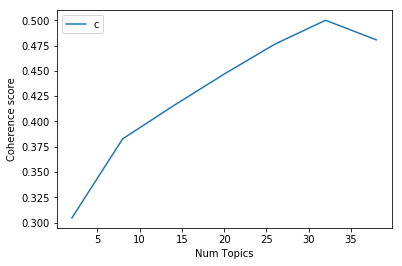

In [273]:
# Show graph
limit=40; start=2; step=6;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [274]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.3047
Num Topics = 8  has Coherence Value of 0.3828
Num Topics = 14  has Coherence Value of 0.4155
Num Topics = 20  has Coherence Value of 0.4468
Num Topics = 26  has Coherence Value of 0.4764
Num Topics = 32  has Coherence Value of 0.5
Num Topics = 38  has Coherence Value of 0.4806


In [275]:
# Select the model and print the topics
optimal_model = model_list[5]
model_topics = optimal_model.show_topics(formatted=False)
pprint(optimal_model.print_topics(num_words=10))

2019-12-07 20:01:17,417 : INFO : topic #17 (1.562): 0.060*"great" + 0.040*"build" + 0.040*"leave" + 0.030*"bad" + 0.027*"guess" + 0.020*"book" + 0.017*"similar" + 0.017*"online" + 0.015*"lie" + 0.015*"voltage"
2019-12-07 20:01:17,419 : INFO : topic #28 (1.562): 0.060*"make" + 0.054*"change" + 0.040*"back" + 0.037*"state" + 0.037*"video" + 0.023*"set" + 0.021*"power" + 0.019*"year_ago" + 0.019*"amount" + 0.017*"personally"
2019-12-07 20:01:17,421 : INFO : topic #22 (1.562): 0.069*"day" + 0.067*"fuck" + 0.058*"point" + 0.036*"top" + 0.031*"word" + 0.031*"research" + 0.024*"human" + 0.022*"mind" + 0.022*"bit" + 0.020*"black"
2019-12-07 20:01:17,423 : INFO : topic #23 (1.562): 0.091*"love" + 0.078*"put" + 0.027*"thing" + 0.027*"computer" + 0.023*"support" + 0.023*"read" + 0.021*"stay" + 0.021*"stop" + 0.021*"show" + 0.015*"respect"
2019-12-07 20:01:17,424 : INFO : topic #12 (1.562): 0.212*"people" + 0.033*"idea" + 0.027*"argument" + 0.027*"kind" + 0.022*"law" + 0.020*"choice" + 0.018*"soci

[(17,
  '0.060*"great" + 0.040*"build" + 0.040*"leave" + 0.030*"bad" + 0.027*"guess" '
  '+ 0.020*"book" + 0.017*"similar" + 0.017*"online" + 0.015*"lie" + '
  '0.015*"voltage"'),
 (28,
  '0.060*"make" + 0.054*"change" + 0.040*"back" + 0.037*"state" + '
  '0.037*"video" + 0.023*"set" + 0.021*"power" + 0.019*"year_ago" + '
  '0.019*"amount" + 0.017*"personally"'),
 (22,
  '0.069*"day" + 0.067*"fuck" + 0.058*"point" + 0.036*"top" + 0.031*"word" + '
  '0.031*"research" + 0.024*"human" + 0.022*"mind" + 0.022*"bit" + '
  '0.020*"black"'),
 (23,
  '0.091*"love" + 0.078*"put" + 0.027*"thing" + 0.027*"computer" + '
  '0.023*"support" + 0.023*"read" + 0.021*"stay" + 0.021*"stop" + 0.021*"show" '
  '+ 0.015*"respect"'),
 (12,
  '0.212*"people" + 0.033*"idea" + 0.027*"argument" + 0.027*"kind" + '
  '0.022*"law" + 0.020*"choice" + 0.018*"society" + 0.015*"worry" + '
  '0.013*"happiness" + 0.013*"free"'),
 (11,
  '0.150*"good" + 0.054*"experience" + 0.047*"base" + 0.022*"space" + '
  '0.018*"talk" 

### Find the dominant topic in each sentence 

In [280]:
def format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts=data):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row in enumerate(ldamodel[corpus]):
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=optimal_model, corpus=corpus, texts=data_processed_bigram)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

# Show
df_dominant_topic.head(10)

2019-12-07 20:07:09,273 : INFO : serializing temporary corpus to /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_corpus.txt
2019-12-07 20:07:09,303 : INFO : converting temporary corpus to MALLET format with ../../mallet-2.0.8/bin/mallet import-file --preserve-case --keep-sequence --remove-stopwords --token-regex "\S+" --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_corpus.txt --output /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_corpus.mallet.infer --use-pipe-from /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_corpus.mallet
2019-12-07 20:07:10,794 : INFO : inferring topics with MALLET LDA '../../mallet-2.0.8/bin/mallet infer-topics --input /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_corpus.mallet.infer --inferencer /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_inferencer.mallet --output-doc-topics /var/folders/pg/8fn4d8f953gg7wnwv3lsjck40000gn/T/e7e125_doctopics.txt.infer --num-iterations 100 --doc-topics-threshold 0.0 -

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,25.0,0.0630,"make, watch, character, kid, sound, drive, jok...","[talos, atom, watch]"
1,1,5.0,0.0587,"work, place, money, hear, answer, class, gover...","[awesome, job, dude, appreciate, hard, work]"
2,2,30.0,0.0639,"give, man, woman, estp, tend, family, accept, ...","[pick, one, shitty, gas, station, near, grand,..."
3,3,15.0,0.0784,"time, pay, hour, company, meet, access, servic...","[never, emotionally, manipulate, steer, people..."
4,4,25.0,0.0730,"make, watch, character, kid, sound, drive, jok...","[catch, mixture, tom, hanks, dicaprio, somethi..."
5,5,16.0,0.0567,"big, test, result, learn, question, interestin...","[even_though, also, browse, sub, fuck, make, s..."
6,6,1.0,0.0483,"understand, user, feeling, model, function, fi...","[play, hero, skill]"
7,7,1.0,0.0471,"understand, user, feeling, model, function, fi...","[understand, agree]"
8,8,11.0,0.0450,"good, experience, base, space, talk, drop, thr...","[ill, look, yeh]"
9,9,27.0,0.0475,"game, play, thing, lot, good, stuff, weird, pa...","[tactical, game, end, though, rollface, everyt..."


### The Most Representative Document for each topic

In [282]:
# Group top 5 sentences under each topic
sent_topics_sorteddf_mallet = pd.DataFrame()

sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=[0]).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]

# Show
sent_topics_sorteddf_mallet.head(20)

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,0.0,0.4461,"url, kind, edit, jpg, good, send, review, poor...","[usa, european, sunscreen, much, advanced, lim..."
1,1.0,0.5324,"understand, user, feeling, model, function, fi...","[additional, note, vs, subjective, function, w..."
2,2.0,0.2969,"run, issue, find, problem, sleep, break, fight...","[voice, hear, like, audible, voice, need, take..."
3,3.0,0.5362,"make, bring, great, song, idea, yeah, friend, ...","[yeah, think, know, much, say, flag, bring, st..."
4,4.0,0.3576,"lot, people, gt, reason, talk, hard, kill, rea...","[cold, uncomfortable, discipline, motivation, ..."
5,5.0,0.2743,"work, place, money, hear, answer, class, gover...","[art, institute, bad, short, answer, depend, g..."
6,6.0,0.3751,"year, time, friend, social, couple, crazy, fin...","[see, graduate, less, month, ago, paint, prett..."
7,7.0,0.1674,"turn, fun, plan, look_like, cash, remind, repl...","[raise, interesting, point, may, age, currentl..."
8,8.0,0.2642,"pretty, wait, normal, nope, wow, eye, feminist...","[dog, yellow, lab, ocd, hate, tile, sprint, ti..."
9,9.0,0.2818,"hate, nice, back, hurt, reddit, fair, head, la...","[provide, stability, sense, belong, sense, per..."


### Top distribution across documents

In [284]:
# Number of Documents for Each Topic
topic_counts = df_topic_sents_keywords['Dominant_Topic'].value_counts()

# Percentage of Documents for Each Topic
topic_contribution = round(topic_counts/topic_counts.sum(), 4)

# Topic Number and Keywords
topic_num_keywords = df_topic_sents_keywords[['Dominant_Topic', 'Topic_Keywords']]

# Concatenate Column wise
df_dominant_topics = pd.concat([topic_num_keywords, topic_counts, topic_contribution], axis=1)

# Change Column names
df_dominant_topics.columns = ['Dominant_Topic', 'Topic_Keywords', 'Num_Documents', 'Perc_Documents']

# Show
df_dominant_topics

,Dominant_Topic,Topic_Keywords,Num_Documents,Perc_Documents
0.0,25.0,"make, watch, character, kid, sound, drive, jok...",68.0,0.068
1.0,5.0,"work, place, money, hear, answer, class, gover...",28.0,0.028
2.0,30.0,"give, man, woman, estp, tend, family, accept, ...",36.0,0.036
3.0,15.0,"time, pay, hour, company, meet, access, servic...",28.0,0.028
4.0,25.0,"make, watch, character, kid, sound, drive, jok...",28.0,0.028
...,...,...,...,...
995.0,2.0,"run, issue, find, problem, sleep, break, fight...",NaN,NaN
996.0,2.0,"run, issue, find, problem, sleep, break, fight...",NaN,NaN
997.0,7.0,"turn, fun, plan, look_like, cash, remind, repl...",NaN,NaN
998.0,22.0,"day, fuck, point, top, word, research, human, ...",NaN,NaN


## SpaCy Text Categorizer

#### Prepare the data

In [105]:
import spacy
from spacy.util import minibatch, compounding

In [120]:
# resample the data
data_test = data.sample(n=10000)

# use SKlearn library to encode the labels 
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
data_test['label'] = label_encoder.fit_transform(data_test['MBTI'])

In [141]:
data_test

,MBTI,comments_lemma,label
220352,ENFJ,yeah really big deal battery suppose die year ...,0
91150,ISFP,fifth request deposit level female shroomish c...,13
148628,ENTJ,honorary american bring home,2
1783,ENFP,cute response type already decide click profil...,1
915707,ENTP,shit save comment bad idea,3
...,...,...,...
180951,ENFP,usa apparently sporting event,1
54600,ESTP,last good president besides trump,7
890513,INFJ,gt regressive describe distribution effect inc...,8
1118137,INTP,gt relatively vanilla past like choke choking ...,11


In [144]:
data_test['I/E'] = data_test['MBTI'].str[0]
data_test['N/S'] = data_test['MBTI'].str[1]
data_test['T/F'] = data_test['MBTI'].str[2]
data_test['J/P'] = data_test['MBTI'].str[3]

In [145]:
# convert strings to binary classes
IE = {'I':1, 'E':0}
NS = {'N':1, 'S':0}
TF = {'T':1, 'F':0}
JP = {'J':1, 'P':0}

data_test['I/E'] = data_test['I/E'].map(IE)
data_test['N/S'] = data_test['N/S'].map(NS)
data_test['T/F'] = data_test['T/F'].map(TF)
data_test['J/P'] = data_test['J/P'].map(JP)

In [147]:
data_test1 = data_test.drop(['MBTI','label'], axis=1 )

In [149]:
data_test1

,comments_lemma,I/E,N/S,T/F,J/P
220352,yeah really big deal battery suppose die year ...,0,1,0,1
91150,fifth request deposit level female shroomish c...,1,0,0,0
148628,honorary american bring home,0,1,1,1
1783,cute response type already decide click profil...,0,1,0,0
915707,shit save comment bad idea,0,1,1,0
...,...,...,...,...,...
180951,usa apparently sporting event,0,1,0,0
54600,last good president besides trump,0,0,1,0
890513,gt regressive describe distribution effect inc...,1,1,0,1
1118137,gt relatively vanilla past like choke choking ...,1,1,1,0


In [131]:
# get the list of encoding as dictionary
encode_name_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print(encode_name_mapping)

{'ENFJ': 0, 'ENFP': 1, 'ENTJ': 2, 'ENTP': 3, 'ESFJ': 4, 'ESFP': 5, 'ESTJ': 6, 'ESTP': 7, 'INFJ': 8, 'INFP': 9, 'INTJ': 10, 'INTP': 11, 'ISFJ': 12, 'ISFP': 13, 'ISTJ': 14, 'ISTP': 15}


In [124]:
X = data_test.comments_lemma
y = data_test.label



# split the data 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, stratify=y, random_state = 42)

# recombine train and test columns
train_df = pd.concat([y_train, X_train], axis = 1)
test_df = pd.concat([y_test, X_test], axis = 1)

In [126]:
# prepare the data the SpaCy way 
train_df['tuples'] = train_df.apply(lambda x: (x['comments_lemma'], x['label']), axis=1)
train = train_df['tuples'].tolist()
train[:1]

[('understand reference please explain', 2)]

#### Load SpaCy functions 

In [151]:
#nlp = spacy.load('en_core_web_sm') 

In [152]:
# add the text classifier to the pipeline if it doesn't exist
# nlp.create_pipe works for built-ins that are registered with spaCy
if 'textcat' not in nlp.pipe_names:
    textcat = nlp.create_pipe('textcat')
    nlp.add_pipe(textcat, last=True)
# otherwise, get it, so we can add labels to it
else:
    textcat = nlp.get_pipe('textcat')

# add label to text classifier
    textcat.add_label("I/E")
    textcat.add_label("N/S")
    textcat.add_label("T/F")
    textcat.add_label("J/P")


# load the dataset
print("Loading Reddit data...")
(train_texts, train_cats), (dev_texts, dev_cats) = load_data(limit=n_texts)
print("Using {} examples ({} training, {} evaluation)"
      .format(n_texts, len(train_texts), len(dev_texts)))
train_data = list(zip(train_texts,
                      [{'cats': cats} for cats in train_cats]))

ValueError: [E116] Cannot currently add labels to pre-trained text classifier. Add labels before training begins. This functionality was available in previous versions, but had significant bugs that led to poor performance.

In [138]:
# SpaCy functions 
def load_data(limit=0, split=0.8):
    train_data = data_test[:7000]
    test_data = data_test[7000:]
    train_data = train_data.comments_lemma.tolist()
    np.random.shuffle(train_data)
    train_data = train_data[-limit:]
    texts, labels = zip(*train_data)
    cats = [{'I/E': bool(y), "NEGATIVE": not bool(y)} for y in labels]
    split = int(len(train_data) * split)
    return (texts[:split], cats[:split]), (texts[split:], cats[split:])

def evaluate(tokenizer, textcat, texts, cats):
    docs = (tokenizer(text) for text in texts)
    tp = 1e-8  # True positives
    fp = 1e-8  # False positives
    fn = 1e-8  # False negatives
    tn = 1e-8  # True negatives
    for i, doc in enumerate(textcat.pipe(docs)):
        gold = cats[i]
        for label, score in doc.cats.items():
            if label not in gold:
                continue
            if score >= 0.5 and gold[label] >= 0.5:
                tp += 1.
            elif score >= 0.5 and gold[label] < 0.5:
                fp += 1.
            elif score < 0.5 and gold[label] < 0.5:
                tn += 1
            elif score < 0.5 and gold[label] >= 0.5:
                fn += 1
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f_score = 2 * (precision * recall) / (precision + recall)
    return {'textcat_p': precision, 'textcat_r': recall, 'textcat_f': f_score}

#("Number of texts to train from","t" , int)
n_texts=10000
#You can increase texts count if you have more computational power.

#("Number of training iterations", "n", int))
n_iter=2

#### Train Model 

In [139]:
# get names of other pipes to disable them during training
other_pipes = [pipe for pipe in nlp.pipe_names if pipe != 'textcat']
with nlp.disable_pipes(*other_pipes):  # only train textcat
    optimizer = nlp.begin_training()
    print("Training the model...")
    print('{:^5}\t{:^5}\t{:^5}\t{:^5}'.format('LOSS', 'P', 'R', 'F'))
    for i in range(n_iter):
        losses = {}
        # batch up the examples using spaCy's minibatch
        batches = minibatch(train_data, size=compounding(4., 32., 1.001))
        for batch in batches:
            texts, annotations = zip(*batch)
            nlp.update(texts, annotations, sgd=optimizer, drop=0.2,
                       losses=losses)
        with textcat.model.use_params(optimizer.averages):
            # evaluate on the dev data split off in load_data()
            scores = evaluate(nlp.tokenizer, textcat, dev_texts, dev_cats)
        print('{0:.3f}\t{1:.3f}\t{2:.3f}\t{3:.3f}'  # print a simple table
              .format(losses['textcat'], scores['textcat_p'],
                      scores['textcat_r'], scores['textcat_f']))

Training the model...
LOSS 	  P  	  R  	  F  
0.929	0.943	0.996	0.969
0.737	0.943	0.983	0.963


## FastText 

In [17]:
# load in data
data = pd.read_csv('../../clean_data/token_voc.csv', index_col=0)

/anaconda3/lib/python3.7/site-packages/numpy/lib/arraysetops.py:568: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [18]:
data = data.dropna()

In [19]:
data.isna().sum()

MBTI              0
comments_lemma    0
dtype: int64

In [20]:
data.shape

(2961190, 2)

In [21]:
# filter out single word lines 
data = data[data['comments_lemma'].str.len() > 4]

In [22]:
data.shape

(2881896, 2)

In [60]:
# create a smaller test set 
data_sample = data.sample(n=50000)

### FastText Classification model 

In [25]:
import fasttext

#### 1. Convert the data to FastText format

In [61]:
# convert input file to FastText format: __label__ sentence 1
from io import StringIO
import csv

col = ['MBTI', 'comments_lemma']

data_sample = data_sample[col]
data_sample['MBTI']=['__label__'+ s for s in data_sample['MBTI']]
#data_sample['comments_lemma']= data_sample['comments_lemma'].replace('\n',' ', regex=True).replace('\t',' ', regex=True)
data_sample.to_csv(r'fasttextsample.txt', index=False, sep=' ', header=False, quoting=csv.QUOTE_NONE, quotechar="", escapechar=" ")

In [31]:
data_sample.head()

,MBTI,comments_lemma
264497,__label__ISTP,yet see moon big remember without photo zoom p...
439434,__label__INFJ,well grandma would stop axe wield german cop
69782,__label__ISTP,pip pip cheerio big ben yellow tooth
16947,__label__ISFP,go comment situation declaw cat unquestionably...
28278,__label__ISTJ,believe watch angriest long time never complai...


In [32]:
data_sample.tail()

,MBTI,comments_lemma
462132,__label__INFJ,suggest poke adc provide lot benefit adc suppo...
931,__label__ENFJ,early year college
614180,__label__INFP,lepsy
7848,__label__ESFJ,sound like much skin irritate would suggest st...
9154,__label__ESFJ,type nostalgic sort thing maybe possible witho...


In [62]:
# split the data to two files
from sklearn.model_selection import train_test_split

X = data_sample.comments_lemma
y = data_sample.MBTI

X_rest, X_test, y_rest, y_test = train_test_split(X, y, test_size = 0.3, stratify = y, random_state = 42)
X_train, X_valid, y_train, y_valid = train_test_split(X_rest, y_rest, test_size = 0.3, stratify=y_rest, random_state=42)

In [63]:
train_df = pd.concat([y_train, X_train], axis = 1)
valid_df = pd.concat([y_valid, X_valid], axis = 1)
test_df = pd.concat([y_test, X_test], axis = 1)
train_df.to_csv(r'fasttextsample_train.txt', index=False, sep=' ', header=False, quoting=csv.QUOTE_NONE, quotechar="", escapechar=" ")
valid_df.to_csv(r'fasttextsample_valid.txt', index=False, sep=' ', header=False, quoting=csv.QUOTE_NONE, quotechar="", escapechar=" ")
test_df.to_csv(r'fasttextsample_test.txt', index=False, sep=' ', header=False, quoting=csv.QUOTE_NONE, quotechar="", escapechar=" ")

#### Input the data into the model

In [68]:
#  train the model 
# adjust epochs
epochs = range(1,51)
test_scores = []

for epoch in epochs: 
    model = fasttext.train_supervised(input='fasttextsample_train.txt', epoch = epoch, lr= 1.0, 
                                      wordNgrams = 2, bucket = 200000, dim=50, loss='hs')
    score = model.test('fasttextsample_valid.txt')[1]
    test_scores.append(score)

    

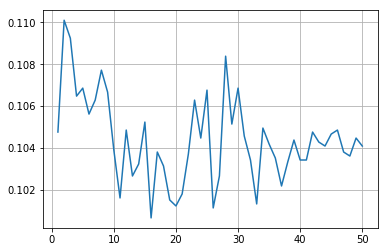

In [72]:
plt.figure()
plt.plot(epochs, test_scores)
plt.grid()
plt.show()

In [74]:
# adjust learning rate

learning_rates = np.arange(0.1,1.0,0.1)
test_scores = []

for learning_rate in learning_rates: 
    model = fasttext.train_supervised(input='fasttextsample_train.txt', epoch = 2, lr= learning_rate, 
                                      wordNgrams = 2, bucket = 200000, dim=50, loss='hs')
    score = model.test('fasttextsample_valid.txt')[1]
    test_scores.append(score)

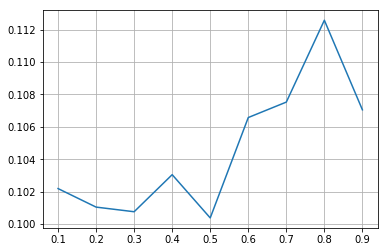

In [75]:
plt.figure()
plt.plot(learning_rates, test_scores)
plt.grid()
plt.show()

In [77]:
# final model 
model = fasttext.train_supervised(input='fasttextsample_train.txt', epoch = 2, lr= 0.8, 
                                      wordNgrams = 2, bucket = 200000, dim=50, loss='hs')
# save the model 
model.save_model('fasttext_model.bin')

In [78]:
# test on test set 
model.test('fasttextsample_test.txt')

(15000, 0.10786666666666667, 0.10786666666666667)

### Word Representation

In [80]:
# convert column to list 
documents = data_sample['comments_lemma'].tolist()
# tokenize the text
texts = [[text for text in doc.split()] for doc in documents]

In [91]:
# train word vectors
model1 = fasttext.train_unsupervised('fasttextsample_train.txt', 'skipgram', minn=2, maxn=10, dim=300)

In [90]:
model1.words

['</s>',
 'like',
 'get',
 'would',
 'think',
 'people',
 'go',
 'make',
 'one',
 'say',
 'know',
 'good',
 'thing',
 'time',
 'really',
 'well',
 'see',
 'want',
 'use',
 'way',
 'even',
 'also',
 'url',
 'much',
 'look',
 'take',
 'feel',
 'work',
 'could',
 'try',
 'something',
 'need',
 'may',
 'gt',
 'lot',
 'find',
 'mean',
 'still',
 'though',
 'come',
 'right',
 'give',
 'actually',
 'someone',
 'game',
 'year',
 'pretty',
 'love',
 'first',
 'never',
 'life',
 'sure',
 'day',
 'type',
 'bad',
 'point',
 'seem',
 'play',
 'friend',
 'back',
 'tell',
 'probably',
 'start',
 'talk',
 'help',
 'always',
 'person',
 'thank',
 'yeah',
 'great',
 'many',
 'anything',
 'keep',
 'guy',
 'around',
 'new',
 'kind',
 'happen',
 'read',
 'every',
 'maybe',
 'different',
 'post',
 'part',
 'problem',
 'man',
 'two',
 'change',
 'ask',
 'end',
 'since',
 'long',
 'sound',
 'idea',
 'shit',
 'little',
 'call',
 'put',
 'let',
 'show',
 'hard',
 'stuff',
 'high',
 'reason',
 'everyone',
 'watc

In [94]:
[model1.get_word_vector(x) for x in ['people', 'time']]

[array([-0.09537304,  0.3561909 , -0.08850993, -0.24127467,  0.11556696,
        -0.20370804,  0.11027719,  0.06987511,  0.02689176,  0.03246935,
        -0.02068891, -0.18130045,  0.04461755, -0.17109111, -0.19581634,
         0.11425466,  0.07769009,  0.02296423,  0.04413997, -0.13937744,
        -0.05166119, -0.04559472,  0.06833678, -0.14657412, -0.14957972,
         0.03565238, -0.06352694,  0.25479218, -0.09033816,  0.18298495,
        -0.04188045,  0.1409752 , -0.07972287,  0.20934802, -0.12069701,
        -0.06939403, -0.0254754 ,  0.03402642,  0.01115112,  0.18370035,
        -0.14062482,  0.01167719,  0.05063783,  0.02637454, -0.05648021,
        -0.08986854, -0.00140474, -0.02310129,  0.01793243,  0.01749393,
        -0.17947817,  0.0276182 , -0.00152708, -0.28967345, -0.0477215 ,
        -0.03293296,  0.06526383, -0.04880449,  0.1924236 , -0.04642263,
         0.10377389,  0.06817944,  0.04381724,  0.13850628, -0.06063931,
        -0.04906886, -0.20331122, -0.02131415, -0.0

## Improved Models

In [155]:
data_test = data_test[['MBTI','comments_lemma', 'label']].copy()

In [156]:
data_test

,MBTI,comments_lemma,label
220352,ENFJ,yeah really big deal battery suppose die year ...,0
91150,ISFP,fifth request deposit level female shroomish c...,13
148628,ENTJ,honorary american bring home,2
1783,ENFP,cute response type already decide click profil...,1
915707,ENTP,shit save comment bad idea,3
...,...,...,...
180951,ENFP,usa apparently sporting event,1
54600,ESTP,last good president besides trump,7
890513,INFJ,gt regressive describe distribution effect inc...,8
1118137,INTP,gt relatively vanilla past like choke choking ...,11


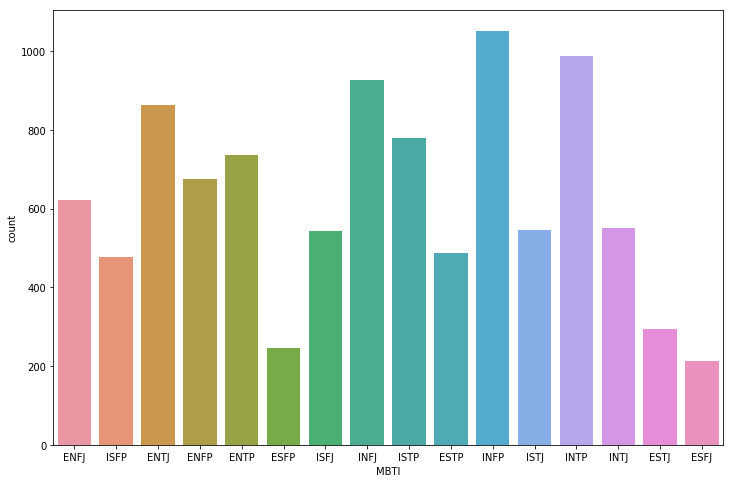

In [216]:
plt.figure(figsize=(12,8))
sns.countplot(data=data_test, x=data_test.MBTI)
plt.show()

In [217]:
data_test['comments_lemma'].apply(lambda x: len(x.split(' '))).sum()

199844

In [168]:
personality_id_df = data_test[['MBTI', 'label']].drop_duplicates().sort_values('label').reset_index(drop=True)

In [169]:
personality_id_df

,MBTI,label
0,ENFJ,0
1,ENFP,1
2,ENTJ,2
3,ENTP,3
4,ESFJ,4
5,ESFP,5
6,ESTJ,6
7,ESTP,7
8,INFJ,8
9,INFP,9


In [317]:
# TFIDF
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf = TfidfVectorizer(sublinear_tf=True, min_df=5, norm='l2', encoding='latin-1', ngram_range=(1, 2), stop_words='english')

features = tfidf.fit_transform(data_test.comments_lemma).toarray()

labels = data_test.label

features.shape

AttributeError: 'list' object has no attribute 'lower'

In [316]:
# Most Correlated terms of each MBTI

from sklearn.feature_selection import chi2

import numpy as np

N = 2
mbti_to_label = dict(personality_id_df.values)

for personality, lb in sorted(mbti_to_label.items()):
    features_chi2 = chi2(features, labels == lb)
    indices = np.argsort(features_chi2[0])
    
    feature_names = np.array(tfidf.get_feature_names())[indices]
    unigrams = [v for v in feature_names if len(v.split(' ')) == 1]
    bigrams = [v for v in feature_names if len(v.split(' ')) == 2]
    
    print("# '{}':".format(personality))
    
    print("  . Most correlated unigrams:\n. {}".format('\n. '.join(unigrams[-N:])))
    
    print("  . Most correlated bigrams:\n. {}".format('\n. '.join(bigrams[-N:])))

IndexError: index 4788 is out of bounds for axis 0 with size 3913

### Classifier 

#### Naive Bayes

In [199]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report


X_train, X_test, y_train, y_test = train_test_split(data_test['comments_lemma'], data_test['MBTI'], random_state = 42)
X_train_tfidf = tfidf.fit_transform(X_train)

mynb = MultinomialNB().fit(X_train_tfidf, y_train)

In [200]:
X_test_tfidf = tfidf.transform(X_test)

In [201]:
y_pred = mynb.predict(X_test_tfidf)

In [206]:
print('Accuracy Score: ', mynb.score(X_test_tfidf, y_test))
print(classification_report(y_test, y_pred))

Accuracy Score:  0.1176
              precision    recall  f1-score   support

        ENFJ       0.20      0.01      0.02       160
        ENFP       0.12      0.01      0.02       158
        ENTJ       0.09      0.09      0.09       223
        ENTP       0.17      0.03      0.05       199
        ESFJ       0.00      0.00      0.00        53
        ESFP       0.00      0.00      0.00        65
        ESTJ       0.00      0.00      0.00        66
        ESTP       0.00      0.00      0.00       119
        INFJ       0.11      0.20      0.15       239
        INFP       0.11      0.50      0.18       259
        INTJ       0.33      0.01      0.01       137
        INTP       0.12      0.26      0.16       243
        ISFJ       0.00      0.00      0.00       119
        ISFP       0.00      0.00      0.00       121
        ISTJ       1.00      0.01      0.01       150
        ISTP       0.21      0.12      0.15       189

   micro avg       0.12      0.12      0.12      2500
  

/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


#### Compare Different models 

In [207]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score

In [210]:
models = [
    RandomForestClassifier(n_estimators=200, max_depth=3, random_state=0),
    LinearSVC(),
    MultinomialNB(),
    LogisticRegression(random_state=42),
]

CV = 5
cv_df = pd.DataFrame(index=range(CV * len(models)))
entries = []

for model in models:
    model_name = model.__class__.__name__
    accuracies = cross_val_score(model, features, labels, scoring='accuracy', cv=CV)
    for fold_idx, accuracy in enumerate(accuracies):
        entries.append((model_name, fold_idx, accuracy))

cv_df = pd.DataFrame(entries, columns=['model_name', 'fold_idx', 'accuracy'])

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed

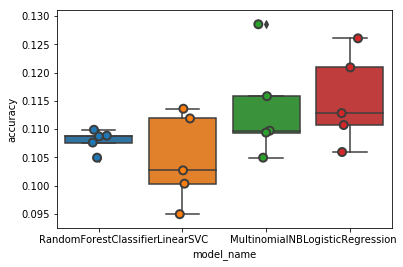

In [211]:
import seaborn as sns

sns.boxplot(x='model_name', y='accuracy', data=cv_df)
sns.stripplot(x='model_name', y='accuracy', data=cv_df, 
              size=8, jitter=True, edgecolor="gray", linewidth=2)
plt.show()

In [212]:
cv_df.groupby('model_name').accuracy.mean()

model_name
LinearSVC                 0.104700
LogisticRegression        0.115296
MultinomialNB             0.113685
RandomForestClassifier    0.108002
Name: accuracy, dtype: float64

In [297]:
# the best model 
model = LogisticRegression()

X_train, X_test, y_train, y_test, indices_train, indices_test = train_test_split(features, labels, data_test.index, test_size=0.3, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


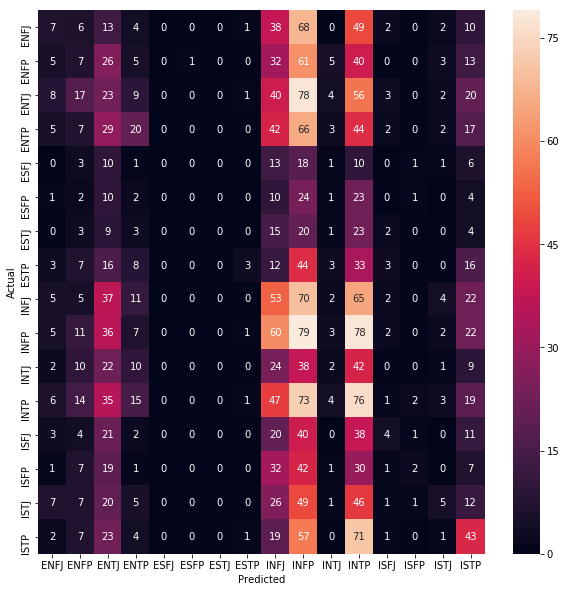

In [214]:
from sklearn.metrics import confusion_matrix

conf_mat = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(conf_mat, annot=True, fmt='d',
            xticklabels=personality_id_df.MBTI.values, yticklabels=personality_id_df.MBTI.values)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

## Doc2Vec

In [231]:
from tqdm import tqdm
tqdm.pandas(desc="progress-bar")


import gensim
from gensim.models import Doc2Vec
from gensim.models.doc2vec import TaggedDocument

/anaconda3/lib/python3.7/site-packages/tqdm/std.py:654: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


### Prepare and Tagging the data 

In [225]:
data_test['comments_lemma'] = [[text for text in doc.split()] for doc in data_test['comments_lemma']]

In [226]:
# use the above test set 
train, test = train_test_split(data_test, test_size=0.3, random_state=42)


In [241]:
# prepare the tagged data
train_tagged = train.apply(lambda x: TaggedDocument(words = x['comments_lemma'], tags = [x['MBTI']]), axis=1)

test_tagged = test.apply(lambda x: TaggedDocument(words = x['comments_lemma'], tags = [x['MBTI']]), axis=1)
train_tagged.values[100]

TaggedDocument(words=['another', 'cultural', 'difference', 'work', 'french', 'people', 'offend', 'swear', 'word', 'many', 'people', 'putain', 'equivalent', 'fuck', 'although', 'literal', 'translation', 'whore', 'basically', 'use', 'punctuation', 'mark', 'course', 'proper', 'improper', 'way', 'speak', 'use', 'many', 'swear', 'word', 'give', 'bad', 'impression', 'overall', 'sensitivity', 'less', 'america'], tags=['ISFP'])

### Set up Doc2Vec  training and evaluation models

#### DBOW model

In [236]:
import multiprocessing
cores = multiprocessing.cpu_count()

In [242]:
# building a vocabulary 
model_dbow = Doc2Vec(dm=0, vector_size=300, negative=5, hs=0, min_count=2, sample = 0, workers=cores)
model_dbow.build_vocab([x for x in tqdm(train_tagged.values)])

100%|██████████| 7000/7000 [00:00<00:00, 1394912.96it/s]


In [245]:
## Initialize the model and train for 30 epochs 
from sklearn import utils

for epoch in range(30):
    model_dbow.train(utils.shuffle([x for x in tqdm(train_tagged.values)]), total_examples=len(train_tagged.values), epochs=1)
    model_dbow.alpha -= 0.002
    model_dbow.min_alpha = model_dbow.alpha

100%|██████████| 7000/7000 [00:00<00:00, 1259010.63it/s]


In [247]:
# build the final vector feature for the classifier 

def vec_for_learning(model, tagged_docs):
    sents = tagged_docs.values
    targets, regressors = zip(*[(doc.tags[0], model.infer_vector(doc.words, steps=20)) for doc in sents])
    return targets, regressors

In [248]:
# train LogReg 
y_train, X_train = vec_for_learning(model_dbow, train_tagged)
y_test, X_test = vec_for_learning(model_dbow, test_tagged)

logreg = LogisticRegression(n_jobs=1, C=1e5)
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)

from sklearn.metrics import accuracy_score, f1_score

print('Testing accuracy %s' % accuracy_score(y_test, y_pred))
print('Testing F1 score: {}'.format(f1_score(y_test, y_pred, average='weighted')))

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Testing accuracy 0.07733333333333334
Testing F1 score: 0.07283090376591186


#### Distributed Memory 

In [249]:
model_dmm = Doc2Vec(dm=1, dm_mean=1, vector_size=300, window=10, negative=5, min_count=1, workers=5, alpha=0.065, min_alpha=0.065)
model_dmm.build_vocab([x for x in tqdm(train_tagged.values)])

100%|██████████| 7000/7000 [00:00<00:00, 1201511.21it/s]


In [250]:
for epoch in range(30):
    model_dmm.train(utils.shuffle([x for x in tqdm(train_tagged.values)]), total_examples=len(train_tagged.values), epochs=1)
    model_dmm.alpha -= 0.002
    model_dmm.min_alpha = model_dmm.alpha

100%|██████████| 7000/7000 [00:00<00:00, 1219882.33it/s]


In [251]:
# train the log reg 
y_train, X_train = vec_for_learning(model_dmm, train_tagged)
y_test, X_test = vec_for_learning(model_dmm, test_tagged)
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)
print('Testing accuracy %s' % accuracy_score(y_test, y_pred))
print('Testing F1 score: {}'.format(f1_score(y_test, y_pred, average='weighted')))

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Testing accuracy 0.07466666666666667
Testing F1 score: 0.07935427035202683


#### Model Pairing 


In [252]:
# delete temp training data to free up RAM

model_dbow.delete_temporary_training_data(keep_doctags_vectors=True, keep_inference=True)
model_dmm.delete_temporary_training_data(keep_doctags_vectors=True, keep_inference=True)

In [254]:
# Concat 2 models 
from gensim.test.test_doc2vec import ConcatenatedDoc2Vec
new_model = ConcatenatedDoc2Vec([model_dbow, model_dmm])

In [255]:
# Building Feature vectors 
def get_vectors(model, tagged_docs):
    sents = tagged_docs.values
    targets, regressors = zip(*[(doc.tags[0], model.infer_vector(doc.words, steps=20)) for doc in sents])
    return targets, regressors

In [256]:
# train log reg 
y_train, X_train = get_vectors(new_model, train_tagged)
y_test, X_test = get_vectors(new_model, test_tagged)
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)
print('Testing accuracy %s' % accuracy_score(y_test, y_pred))
print('Testing F1 score: {}'.format(f1_score(y_test, y_pred, average='weighted')))

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Testing accuracy 0.06766666666666667
Testing F1 score: 0.06728712147639444


/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:931: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


## LSTM Modelling

### Import Keras

In [276]:
# import Keras 

from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, Embedding, SpatialDropout1D, LSTM
from keras.preprocessing import text, sequence
from keras.callbacks import EarlyStopping
from keras import utils

### Prepare Data

In [262]:
# use the same test data above 


# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 50000
# Max number of words in each complaint.
MAX_SEQUENCE_LENGTH = 250
# This is fixed.
EMBEDDING_DIM = 100


tokenizer = text.Tokenizer(num_words=MAX_NB_WORDS, filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(data_test.comments_lemma.values)
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 21099 unique tokens.


In [265]:
# Truncate and pad the input sequenes 
X = tokenizer.texts_to_sequences(data_test.comments_lemma.values)
X = sequence.pad_sequences(X, maxlen=MAX_SEQUENCE_LENGTH)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (10000, 250)


In [266]:
# convert categorical labels to numbers 
Y = pd.get_dummies(data_test.MBTI).values
print('Shape of label tensor:', Y.shape)

Shape of label tensor: (10000, 16)


In [267]:
# train test split 

X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.10, random_state = 42)
print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

(9000, 250) (9000, 16)
(1000, 250) (1000, 16)


### Build Layers

In [277]:

model = Sequential()
# Embedded Layers, can use external library like GloVe
model.add(Embedding(MAX_NB_WORDS, EMBEDDING_DIM, input_length=X.shape[1])) 
# variational dropout
model.add(SpatialDropout1D(0.2))
# LSTM with 100 memory units
model.add(LSTM(100, dropout=0.2, recurrent_dropout=0.2))
# output layer, 16 total output, one for each class, activation is softmax
model.add(Dense(16, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

epochs = 5
batch_size = 64

history = model.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,validation_split=0.1,callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.0001)])

Instructions for updating:
Use tf.cast instead.
Train on 8100 samples, validate on 900 samples
Epoch 1/5
8100/8100 [==============================] - 113s 14ms/step - loss: 2.7052 - accuracy: 0.0994 - val_loss: 2.7019 - val_accuracy: 0.1122
Epoch 2/5
8100/8100 [==============================] - 139s 17ms/step - loss: 2.6704 - accuracy: 0.1279 - val_loss: 2.7035 - val_accuracy: 0.1022
Epoch 3/5
8100/8100 [==============================] - 109s 14ms/step - loss: 2.5121 - accuracy: 0.2302 - val_loss: 2.7685 - val_accuracy: 0.1011
Epoch 4/5
8100/8100 [==============================] - 124s 15ms/step - loss: 2.0167 - accuracy: 0.4052 - val_loss: 2.9713 - val_accuracy: 0.0944


In [278]:
# evaluate on the test set 

accr = model.evaluate(X_test,Y_test)
print('Test set\n  Loss: {:0.3f}\n  Accuracy: {:0.3f}'.format(accr[0],accr[1]))

1000/1000 [==============================] - 3s 3ms/step
Test set
  Loss: 2.996
  Accuracy: 0.096


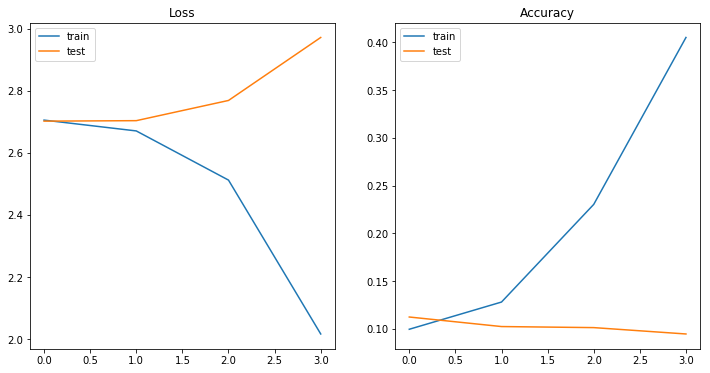

In [285]:
# Plot out the Loss 
plt.subplots(1,2, figsize=(12,6))

plt.subplot(1,2,1)
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()

plt.subplot(1,2,2)
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()

plt.show()

## Multiple Output

In [311]:
from sklearn.multioutput import MultiOutputClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import AdaBoostClassifier
import xgboost as xgb

# Split mbti personality into 4 letters and binarize
titles = ["Extraversion (E) - Introversion (I)",
          "Sensation (S) - INtuition (N)",
          "Thinking (T) - Feeling (F)",
          "Judgement (J) - Perception (P)"
         ] 

# convert MBTI to 4 binary classification 
b_Pers = {'I':0, 'E':1, 'N':0, 'S':1, 'F':0, 'T':1, 'J':0, 'P':1}
b_Pers_list = [{0:'I', 1:'E'}, {0:'N', 1:'S'}, {0:'F', 1:'T'}, {0:'J', 1:'P'}]

def translate_personality(personality):
    '''
    transform mbti to binary vector
    '''
    return [b_Pers[l] for l in personality]

def translate_back(personality):
    '''
    transform binary vector to mbti personality
    '''
    s = ""
    for i, l in enumerate(personality):
        s += b_Pers_list[i][l]
    return s

list_personality_bin = np.array([translate_personality(p) for p in data_test.MBTI])
print("Binarize MBTI list: \n%s" % list_personality_bin)


Binarize MBTI list: 
[[1 0 0 0]
 [0 1 0 1]
 [1 0 1 0]
 ...
 [0 0 0 0]
 [0 0 1 1]
 [0 0 0 0]]


In [312]:
# Feed classifier to MultiOutputCLassifier

clf = AdaBoostClassifier()
multi_target_classifier = MultiOutputClassifier(clf, n_jobs=-1)
multi_target_classifier.fit(X_tfidf, list_personality_bin)
preds = multi_target_classifier.predict(X_tfidf)

preds_t = [translate_back(p) for p in preds]
vec1 = data_test.MBTI ==  preds_t
for i in range(4):
    print("f1 score for %s:\n%s" % (titles[i],
                                    f1_score(np.array(list_personality_bin)[:,i], preds[:,i])))

f1 score for Extraversion (E) - Introversion (I):
0.0024102193299590257
f1 score for Sensation (S) - INtuition (N):
0.0
f1 score for Thinking (T) - Feeling (F):
0.6687806284231766
f1 score for Judgement (J) - Perception (P):
0.6919418019026302


/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


In [314]:
# Stratified cross val for multi-output
from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit

X = list_posts
y = np.array(list_personality_bin)

clf = AdaBoostClassifier()

kf = StratifiedShuffleSplit(n_splits=4)

list_score = []
list_score_per_class= []

# Stratified Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y)

X_train = tfidfizer.fit_transform(X_train).toarray()
X_test = tfidfizer.transform(X_test).toarray()

multi_target_classifier = MultiOutputClassifier(clf, n_jobs=-1)
multi_target_classifier.fit(X_train, y_train)
preds = multi_target_classifier.predict(X_test)

rev_preds = np.array([translate_back(p) for p in preds]) 
rev_test = np.array([translate_back(p) for p in y_test])
score = f1_score(rev_test,rev_preds, average='weighted')
list_score.append(score)
print('\nTotal score: %s' % f1_score(rev_test,rev_preds, average='weighted'))

list_temp =[]
for i in range(4):
    score_per_class = f1_score(y_test[:,i], preds[:,i])
    list_temp.append(score_per_class)
    print(score_per_class)
list_score_per_class.append(list_temp)



Total score: 0.03599502398248623
0.0
0.0
0.6463054187192119
0.6924961033177467


/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
